# 정부-의회(성별)-정당 분석

In [1]:
import pandas as pd
import numpy as np
import time
import matplotlib.pyplot as plt
import seaborn as sns
import re
from tqdm import tqdm
from gensim.models import Word2Vec
from sklearn.cluster import KMeans
import os
from gensim import models
import fasttext.util
from sklearn.cluster import AgglomerativeClustering
from konlpy.tag import Okt
import logging
import hanja
from krwordrank.hangle import normalize
import datetime
%matplotlib inline

In [2]:
# 한글폰트 설정
import matplotlib as mpl
import matplotlib.pyplot as plt
 
%config InlineBackend.figure_format = 'retina'
 
!apt -qq -y install fonts-nanum
 
import matplotlib.font_manager as fm
fontpath = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font = fm.FontProperties(fname=fontpath, size=9)
plt.rc('font', family='NanumBarunGothic') 
mpl.font_manager._rebuild()

Unable to locate an executable at "/Library/Java/JavaVirtualMachines/jdk-14.0.1.jdk/Contents/Home/bin/apt" (-1)


In [3]:
gender = pd.read_csv('whole-gender-bill-1320.csv', index_col=0,
                           parse_dates=['제안일자','의결일자'],encoding='utf-8-sig')
print(gender.shape)
gender.head(1)

(4295, 16)


,의안번호,의안명,제안일자,제안자구분,의결일자,의결결과,제안회기,제안이유,소관위원회,제안자,발의자,제안정당,성별,여성의원 수,정당성향,국회회기
0,131131,소득세법중개정법률안,1990-12-17,위원장,1990-12-18,원안가결,제13대 (1988~1992) 제151회,"정부제출,柳인학·강金식·금봉욱·林춘원·李경재·허만기·홍영기의원외64인 발의,1...",재무위원회,[],위원장,위원장,NaN,0,NaN,13


In [4]:
gender['제안일자'] = gender['제안일자'].dt.date
gender['의결일자'] = gender['의결일자'].dt.date

In [5]:
gender['제안일자'].unique()

array([datetime.date(1990, 12, 17), datetime.date(1990, 11, 20),
       datetime.date(1990, 10, 8), ..., datetime.date(2016, 6, 1),
       datetime.date(2016, 5, 31), datetime.date(2016, 5, 30)],
      dtype=object)

In [6]:
drop_list = [177919, 177064, 176854, 176797, 176796, 176795, 176794]

gender = gender[~gender['의안번호'].isin(drop_list)]
gender.shape

(4288, 16)

## 전체 성별-정권별 wordcloud

In [7]:
# 한글 전처리
def preprocessing(text): 
    text_pre1 = re.sub('[-=.#/:$}·,■?]', ' ', text)
    text_pre2 = re.sub('[^가-힣ㄱ-ㅎㅏ-ㅣa-zA-Z]', ' ', text_pre1)
    return str(text_pre2)

# 의미없는 단어 삭제 
def remove_stopword(text): 
    stopwords = ['사이','을','이','의','를','에','가','들','은','는','으로','한','도','항','관','정',
              '수','에서','로','것','그','과','제','입니다','할','하고','적','하는','로부터','면','관','항','이',
              '합니다','와','에게','고','인','하여','등','저','있습니다','말','까지','일명','보장하',
              '그리고','다','만','했습니다','안','된','못','일','더','위','최근','인한','있어'
              '있는','해','또한','명','하지','정말','물','많은','것임','류','줄','통해',
              '중','게','너무','자','이런','때','되지','위해','에는','없는','중','물이',
              '및','요','때문','관련','대한','전','라고','되었습니다','하기','나','후','같은','해서',
              '글','되어','주','차','하','내','없이','대해','잘','항','조','경우','함안','기간','하려는','일부',
              '마련','있도록','또는','함','하도록','개월','분','부터','제호','관','되고','년','월','및','등',\
              '안','바','이','것','부터','수','시','자','퍼센트',
            '조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출']

    text = [word for word in text if word not in stopwords]
    return text

In [8]:
gender['의안텍스트'] = (gender['의안명'] + ' ' + gender['제안이유']).str.strip()
gender['의안텍스트'] = gender['의안텍스트'].apply(lambda x:str(x).lower())

In [9]:
%time gender['의안텍스트'] = gender['의안텍스트'].apply(preprocessing)

CPU times: user 305 ms, sys: 4.51 ms, total: 310 ms
Wall time: 328 ms


In [10]:
from konlpy.tag import Mecab, Okt, Hannanum

# okt = Okt()
hannanum = Hannanum()

def get_tokens(x):
    try:
        return [i for i in hannanum.nouns(x) if len(i) > 1] if x else []
    except Exception as e:
        if str(x) == 'nan':
            return []
        print(e)
        print(str(x))
        raise e

In [11]:
# 단어에서 명사만 뽑아내기
# okt = Okt()
%time gender['tokens'] = gender['의안텍스트'].apply(get_tokens)
gender['tokens'][:3]

CPU times: user 2min 55s, sys: 1.57 s, total: 2min 57s
Wall time: 2min 48s


0    [소득세법중개정법률, 정부제출, 인학, 금봉욱, 춘원, 경재, 허만기, 홍영기의원외...
1    [특정범죄가중처벌등에관한법률중개정법률안, 정부, 제출, 각특정범죄가중처벌등에관한법률...
2    [유아의보호, 교육에관한법률안, 현대사회, 산업화, 여성, 사회참여, 가족구조, 핵...
Name: tokens, dtype: object

In [12]:
%time gender['tokens'] = gender['tokens'].apply(remove_stopword)

CPU times: user 1.42 s, sys: 7.31 ms, total: 1.43 s
Wall time: 1.46 s


In [13]:
%time gender['명사수'] = gender['tokens'].apply(len)

CPU times: user 2.15 ms, sys: 80 µs, total: 2.23 ms
Wall time: 2.17 ms


In [14]:
# 명사 수가 10개를 넘어가는 경우만 추출
#gender = gender[gender['명사수'] >= 10]
#gender = gender.reset_index(drop=True)
print(gender.shape)

(4288, 19)


## 정권 탐색 

### 노태우 정권 
- 1998.02.25 ~ 1993.02.24

In [18]:
notaewoo = gender[(gender['제안일자'] > datetime.date(1988,5,3)) & 
                        (gender['제안일자'] < datetime.date(1993,2,24))]
notaewoo.shape

(23, 19)

In [19]:
pd.DataFrame(notaewoo.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    4
     여성    4
진보   남성    3
     여성    2

In [26]:
pro_women = notaewoo[(notaewoo['성별'] == '여성') & (notaewoo['정당성향'] == '진보')]
pro_men = notaewoo[(notaewoo['성별'] == '남성') & (notaewoo['정당성향'] == '진보')]
con_women = notaewoo[(notaewoo['성별'] == '여성') & (notaewoo['정당성향'] == '보수')]
con_men = notaewoo[(notaewoo['성별'] == '남성') & (notaewoo['정당성향'] == '보수')]

In [18]:
# word2vec 모델 학습에 로그를 찍기
logging.basicConfig(
    format='%(asctime)s : %(levelname)s : %(message)s', 
    level=logging.INFO)

In [17]:
import nltk 
from wordcloud import WordCloud

def total_tokens(df): 
    gender_tokens = []
    for row in df: 
        for word in row: 
            gender_tokens.append(word)
    return gender_tokens

def frewords_vis(tokens): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    plt.figure(figsize=(12,6))
    ko.plot(50) # 상위 50 토큰를 정렬하여 보여줌 
    plt.show()
    
def wordcloud_vis(tokens, color): 
    ko = nltk.Text(tokens, name=f'{tokens}')
    data = ko.vocab().most_common(150)
    data2 = dict(data)
    font_path = '/usr/share/fonts/BlackHanSans-Regular.ttf'

    wordcloud = WordCloud(font_path=font_path,
                          width = 800, 
                          colormap = f'{color}',
                         height = 800)

    wordcloud = wordcloud.generate_from_frequencies(data2)
    plt.figure(figsize=(10,10))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

In [29]:
pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

In [30]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

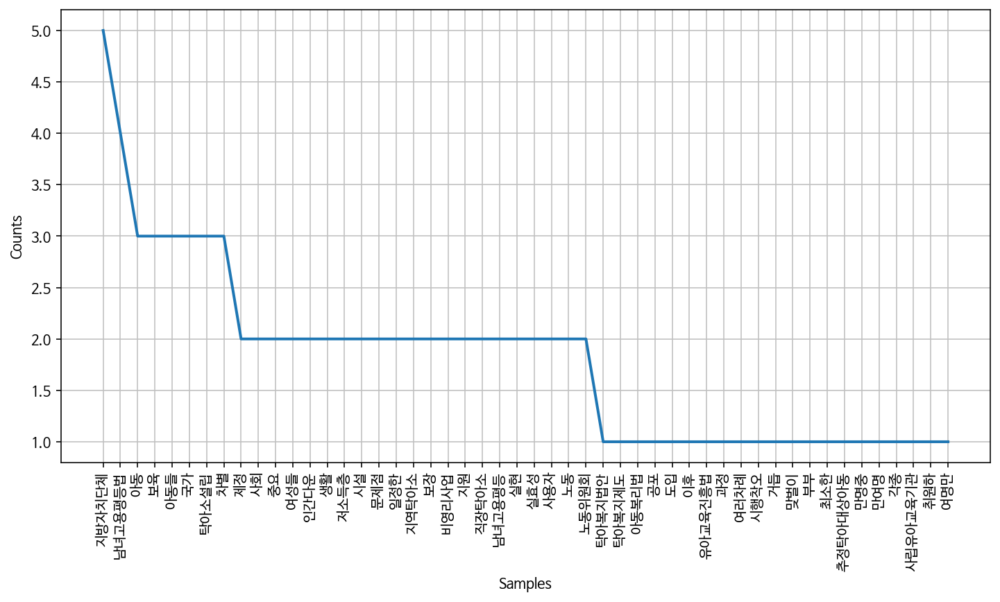

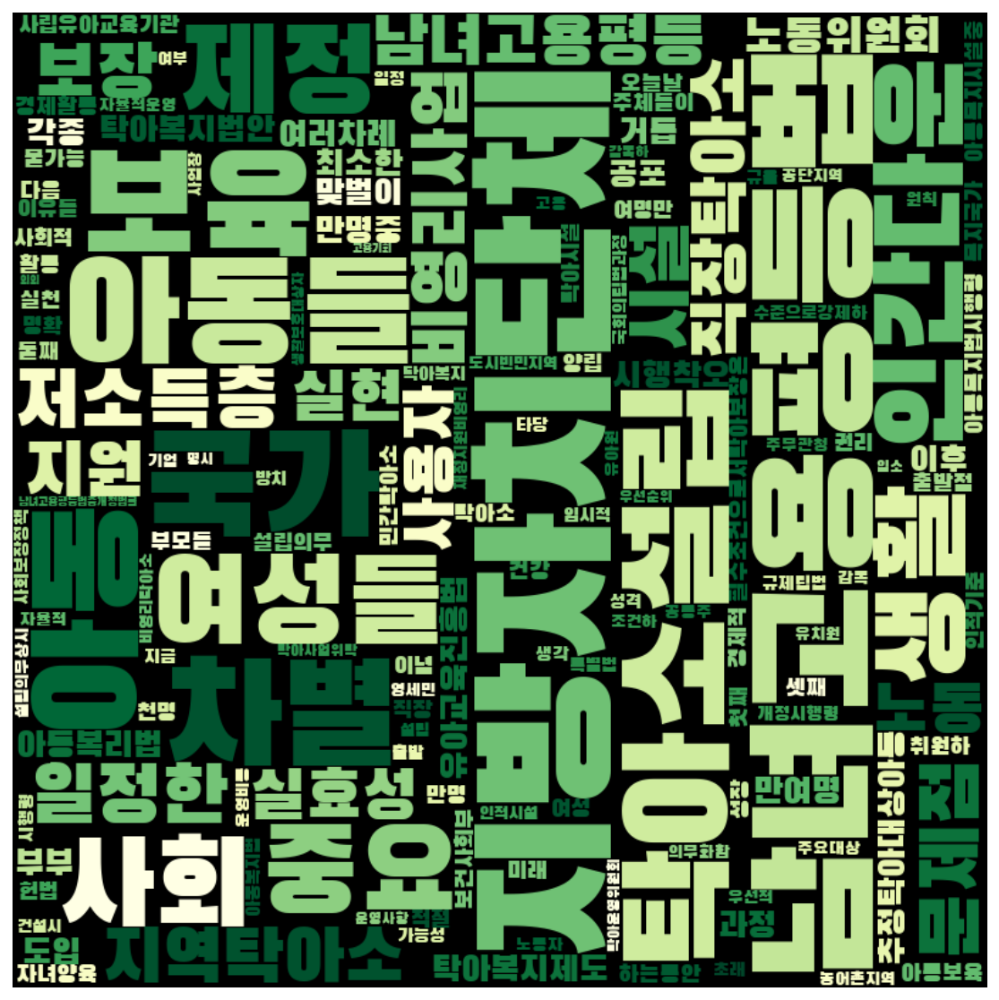

In [40]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

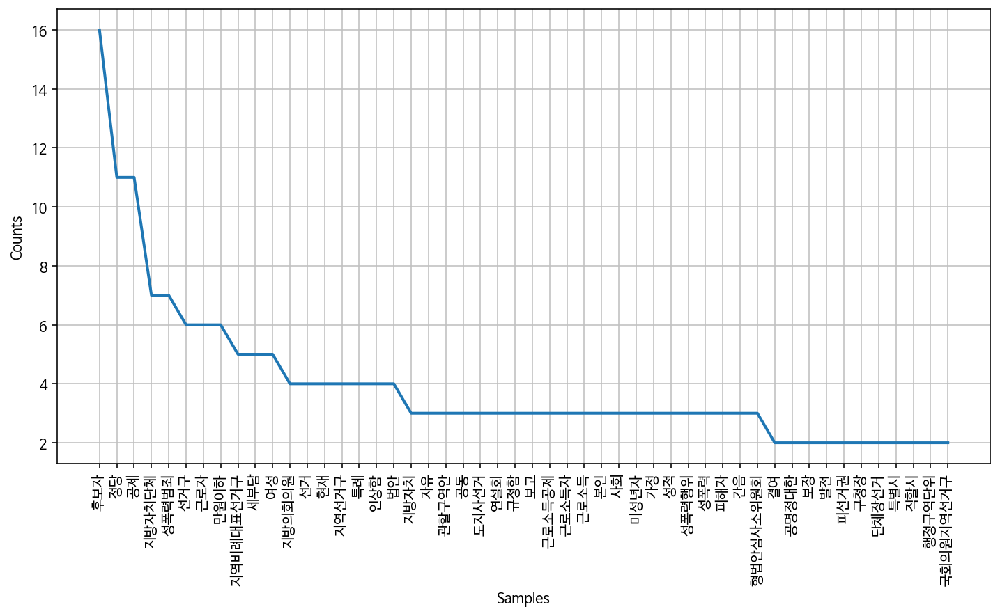

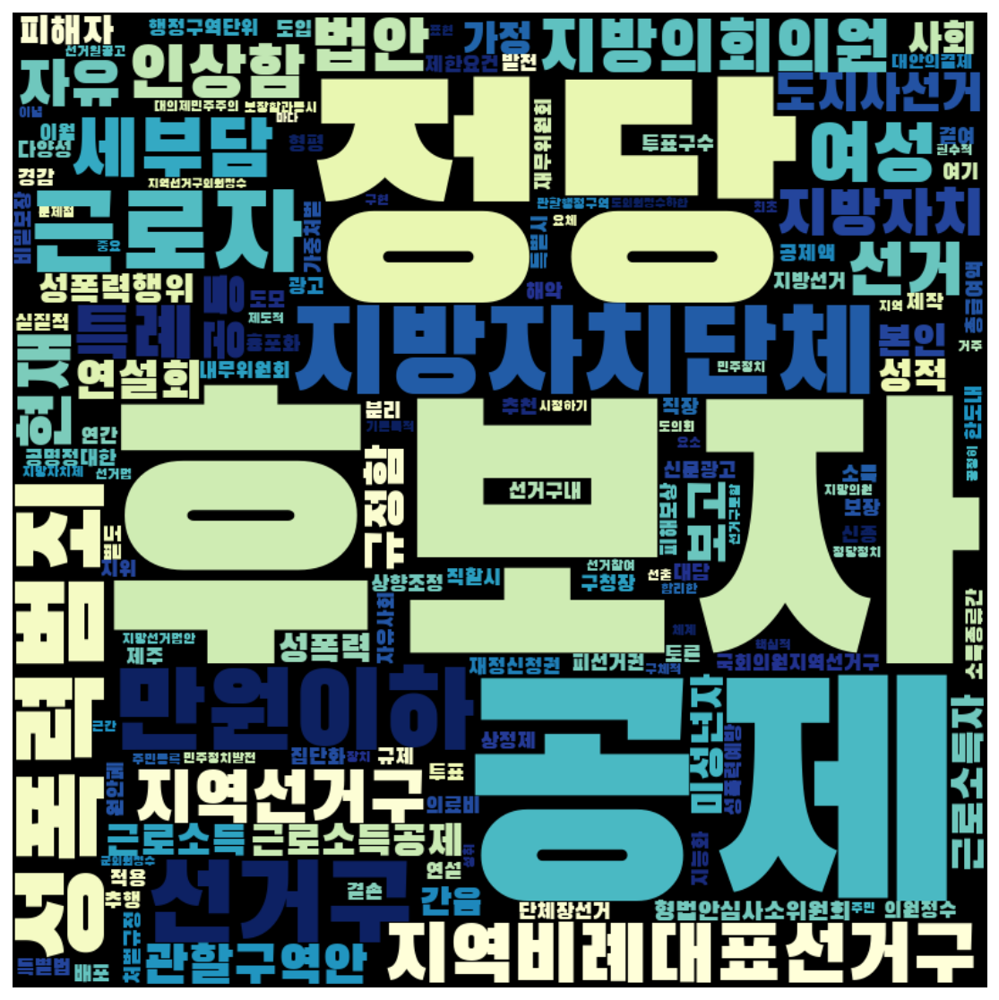

In [41]:
frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

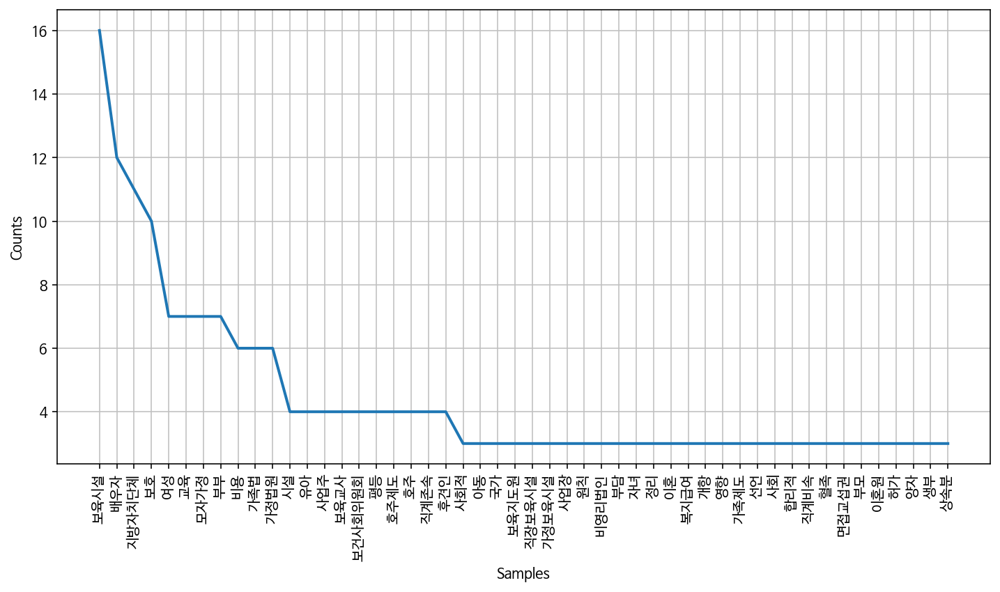

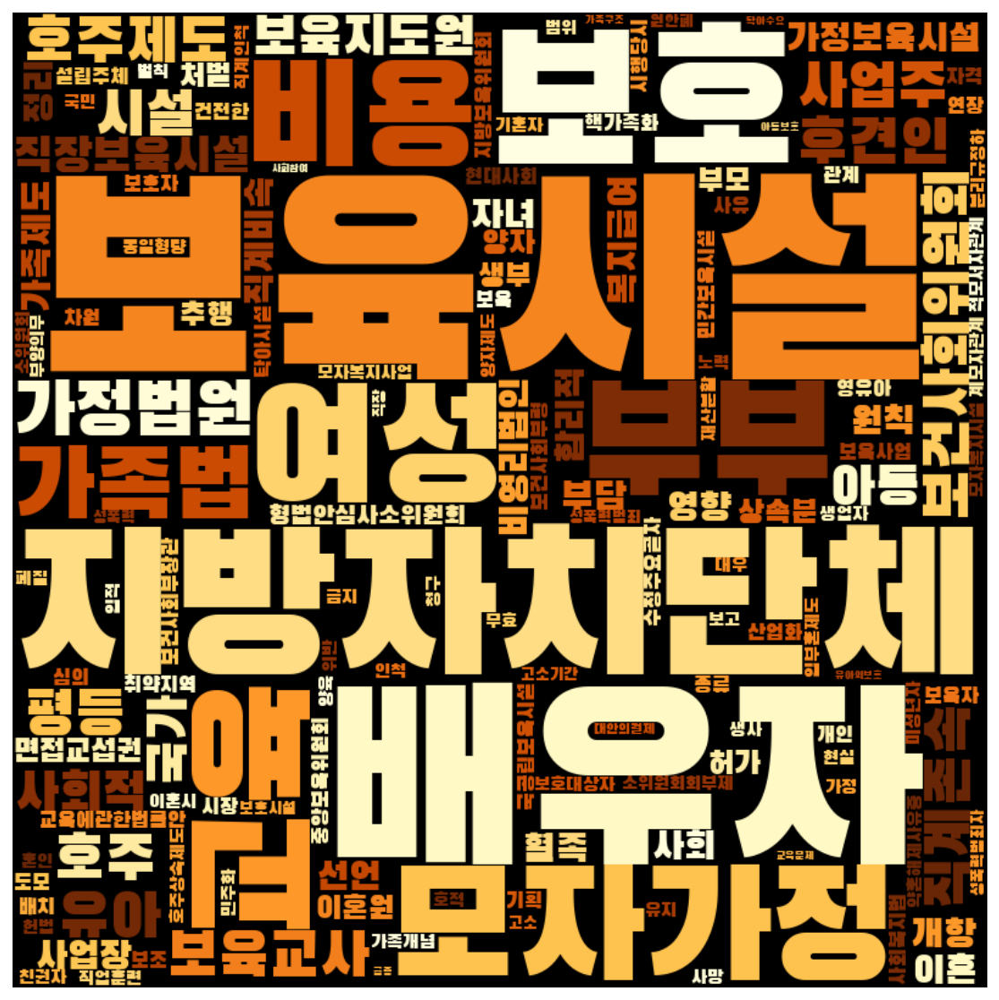

In [42]:
frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

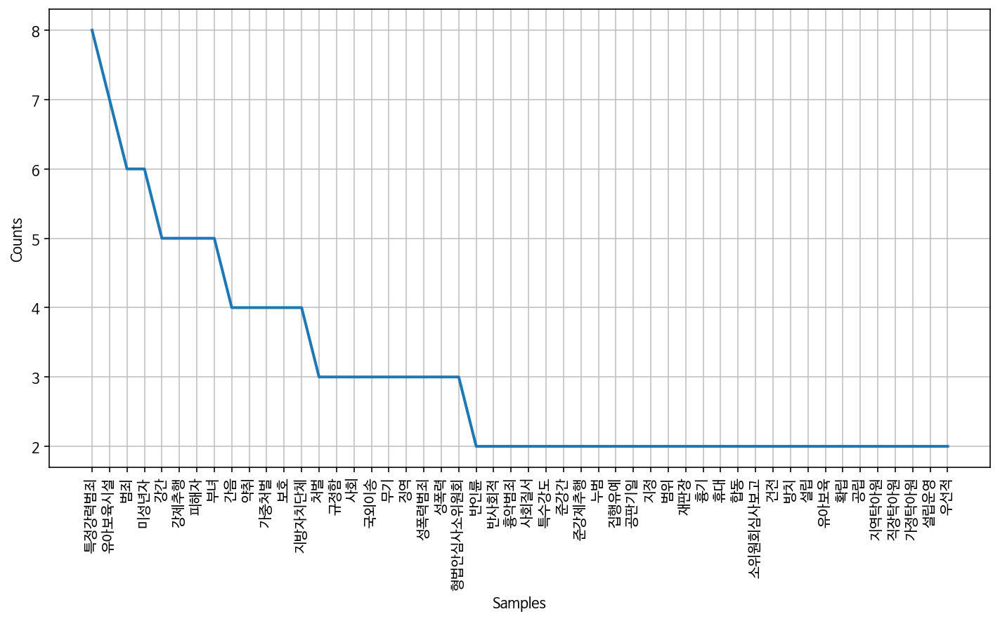

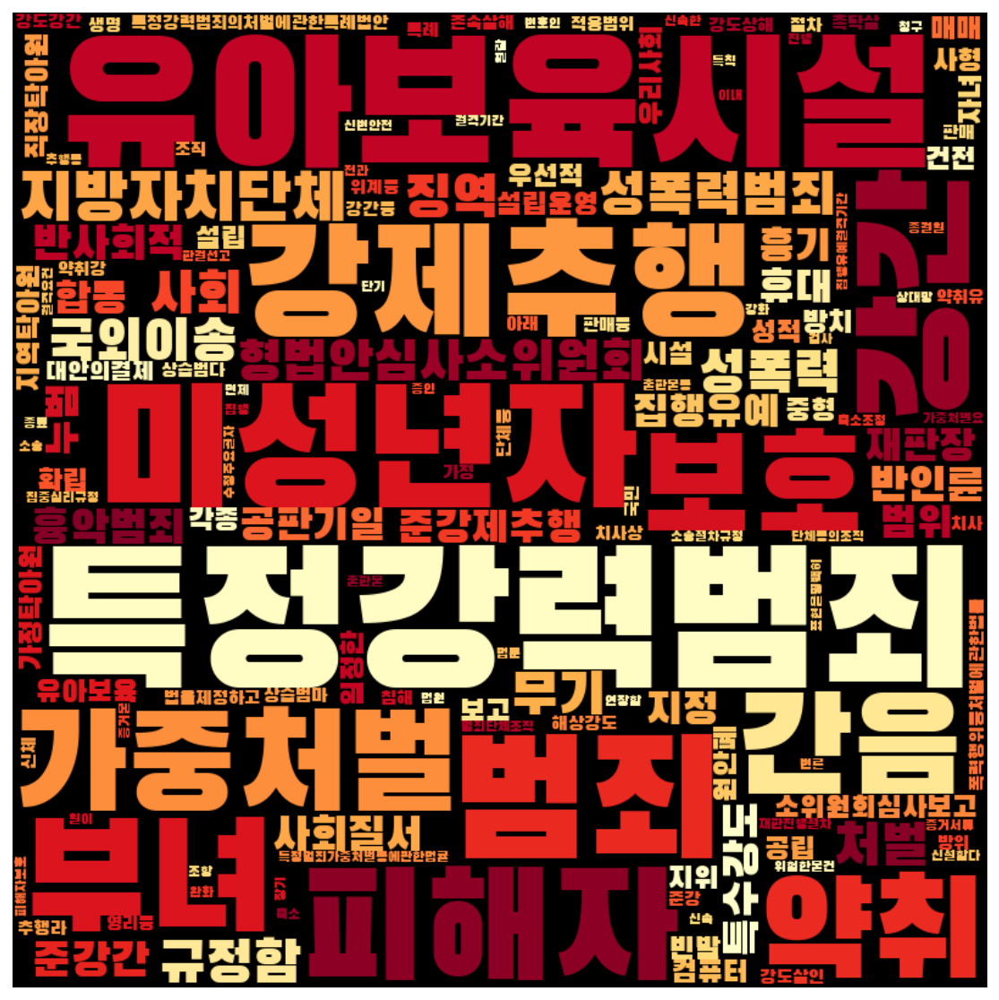

In [43]:
frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 김영삼 정권 
- 1993.02.25 ~ 1998.02.24

In [58]:
kimyoungsam = gender[(gender['제안일자'] > datetime.date(1993,2,25)) & 
                        (gender['제안일자'] < datetime.date(1998,2,24))]
kimyoungsam.shape

(62, 19)

In [59]:
kimyoungsam['성별'].value_counts()

남성    25
여성    15
Name: 성별, dtype: int64

In [60]:
pd.DataFrame(kimyoungsam.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성    9
     여성    9
진보   남성   16
     여성    6

In [54]:
pro_women = kimyoungsam[(kimyoungsam['성별'] == '여성') & (kimyoungsam['정당성향'] == '진보')]
pro_men = kimyoungsam[(kimyoungsam['성별'] == '남성') & (kimyoungsam['정당성향'] == '진보')]
con_women = kimyoungsam[(kimyoungsam['성별'] == '여성') & (kimyoungsam['정당성향'] == '보수')]
con_men = kimyoungsam[(kimyoungsam['성별'] == '남성') & (kimyoungsam['정당성향'] == '보수')]

In [55]:
pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

In [56]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

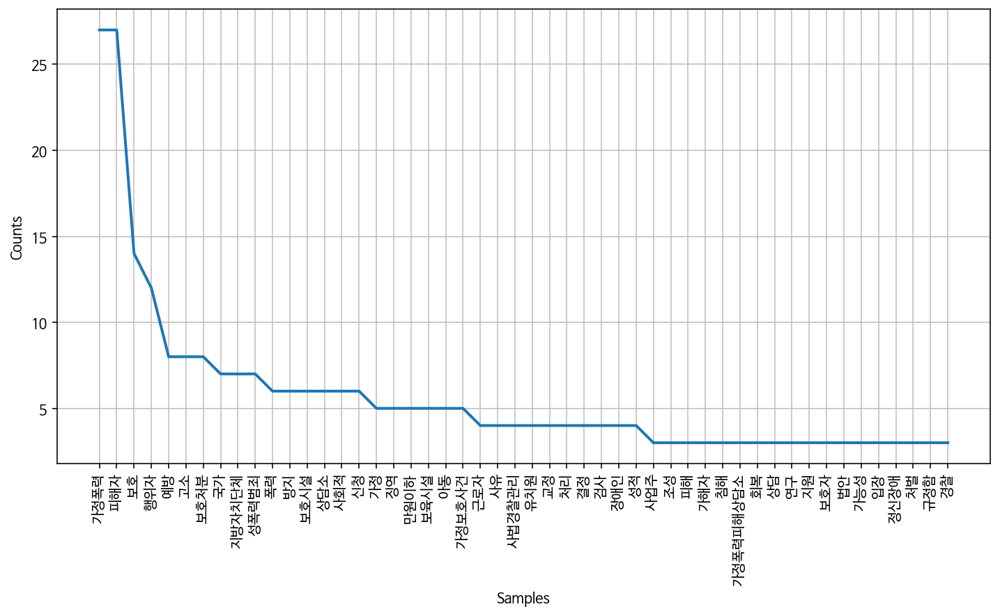

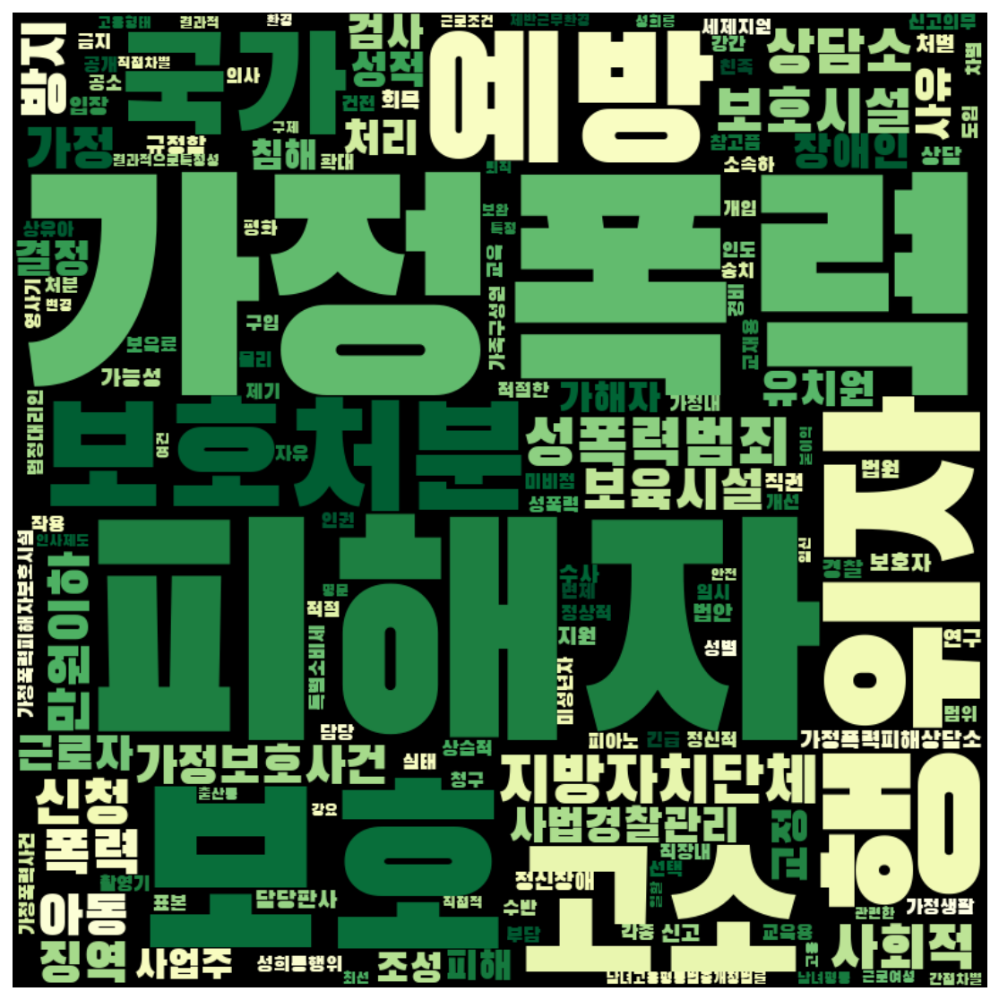

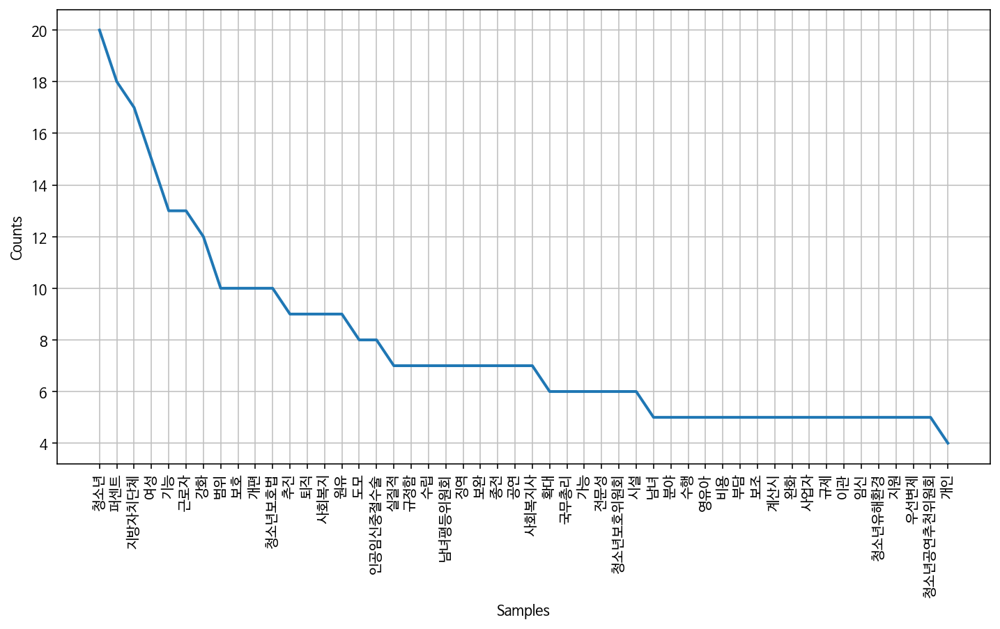

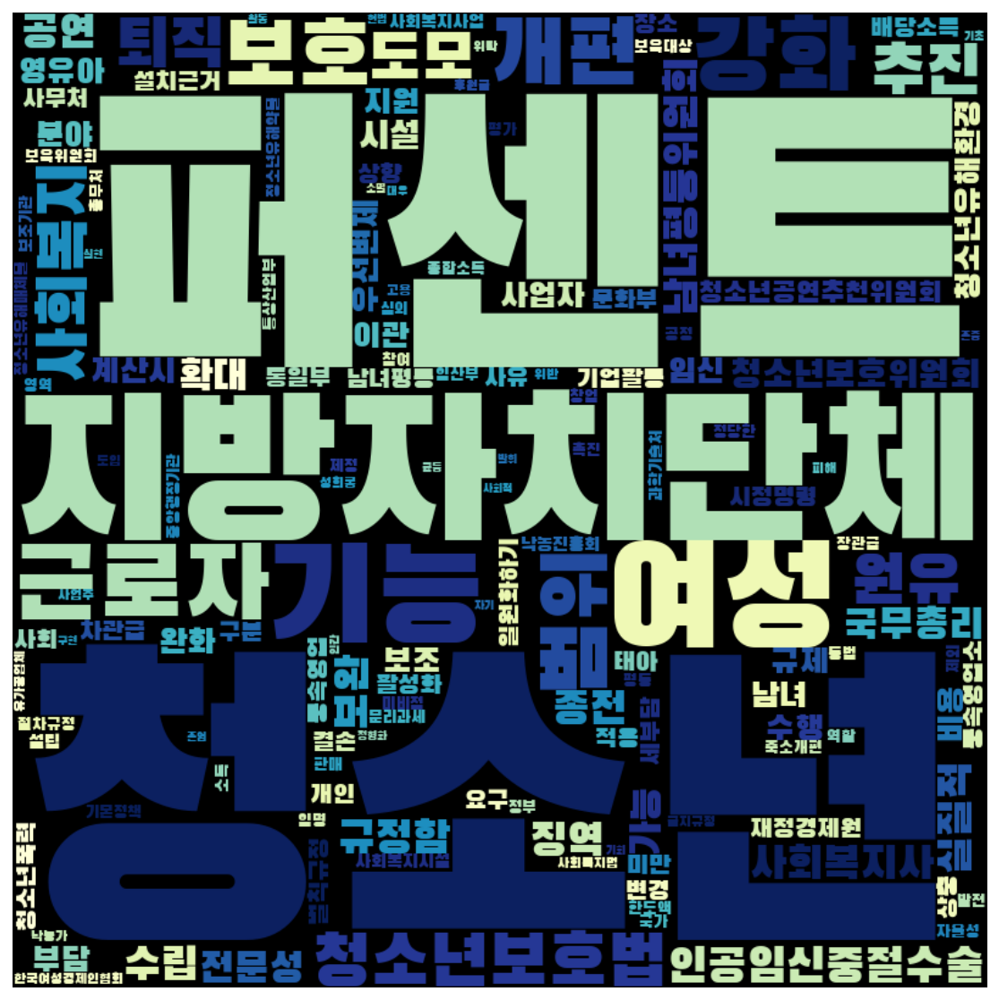

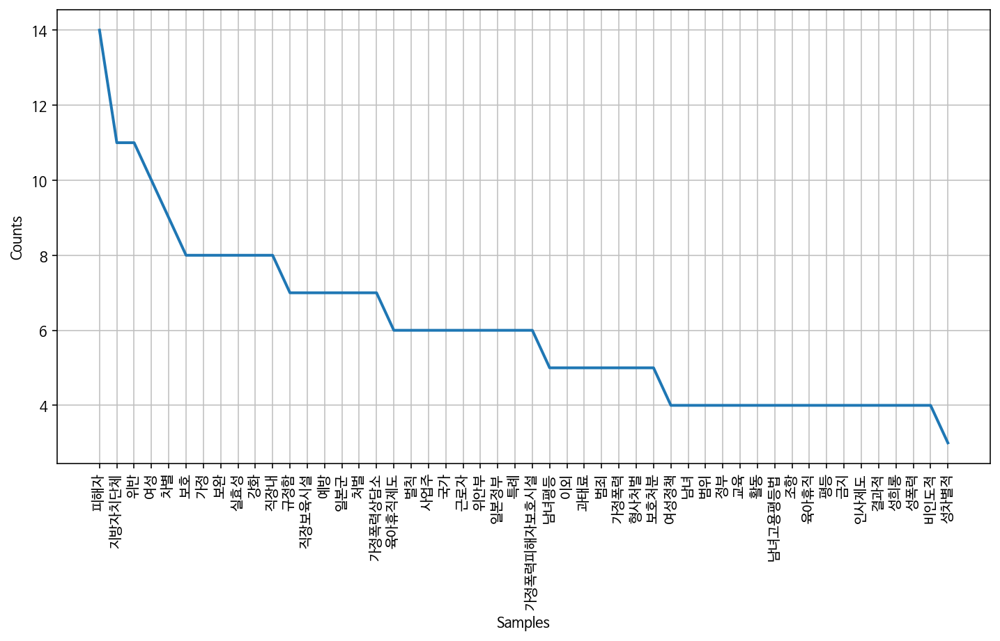

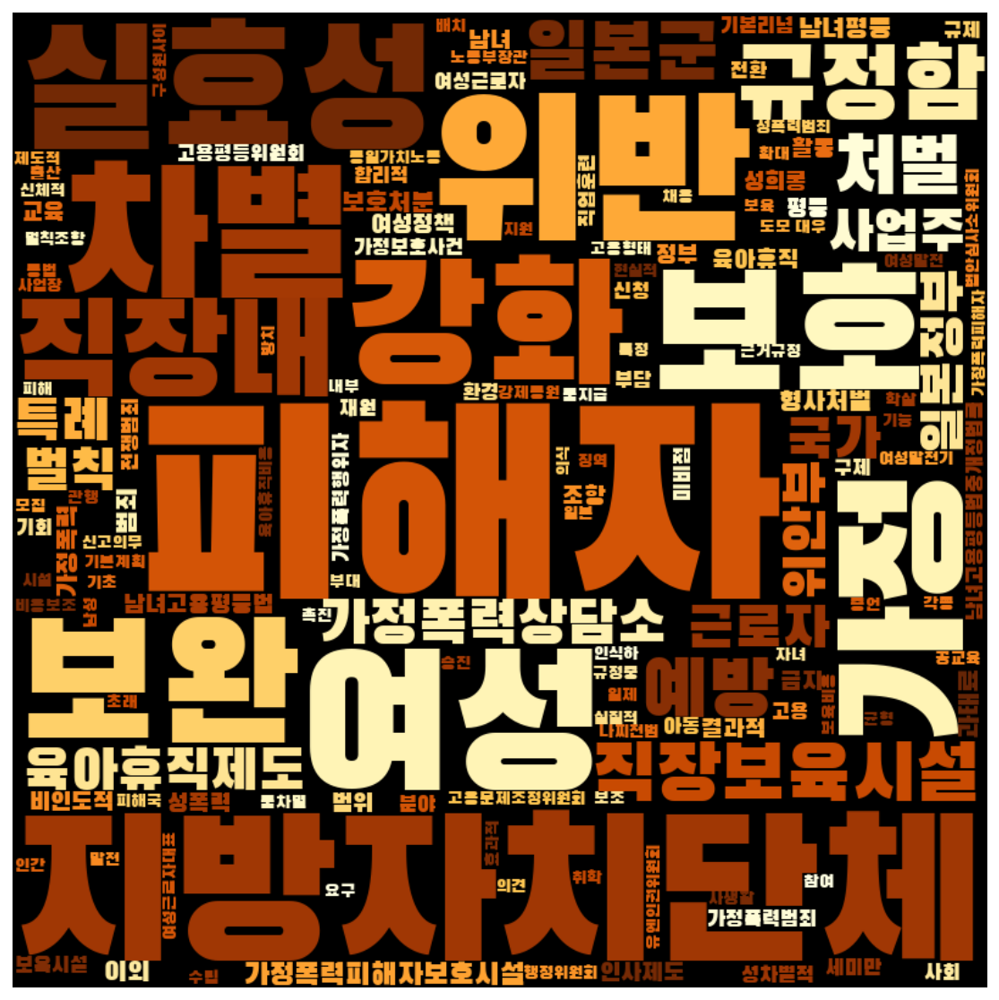

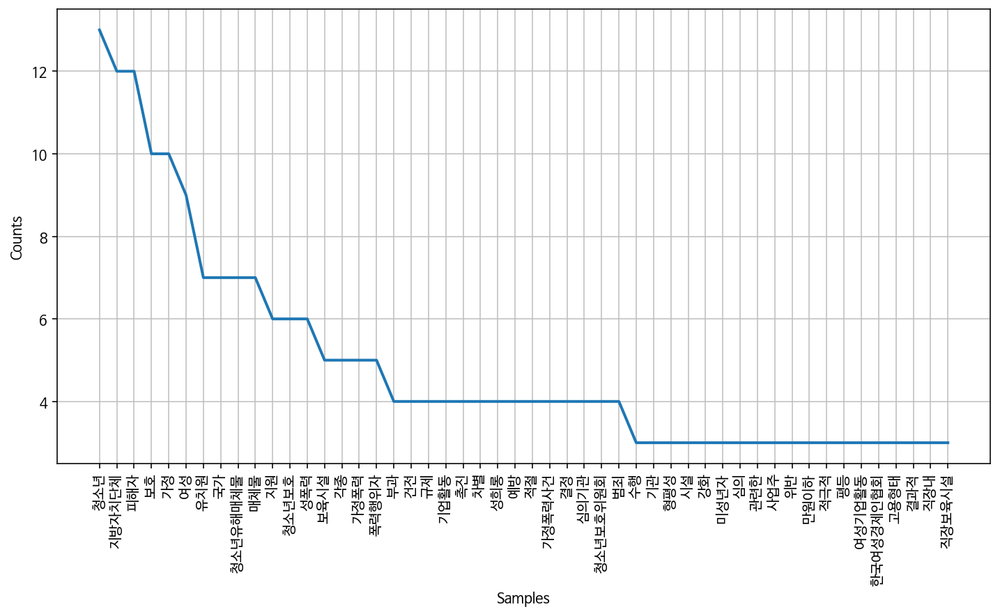

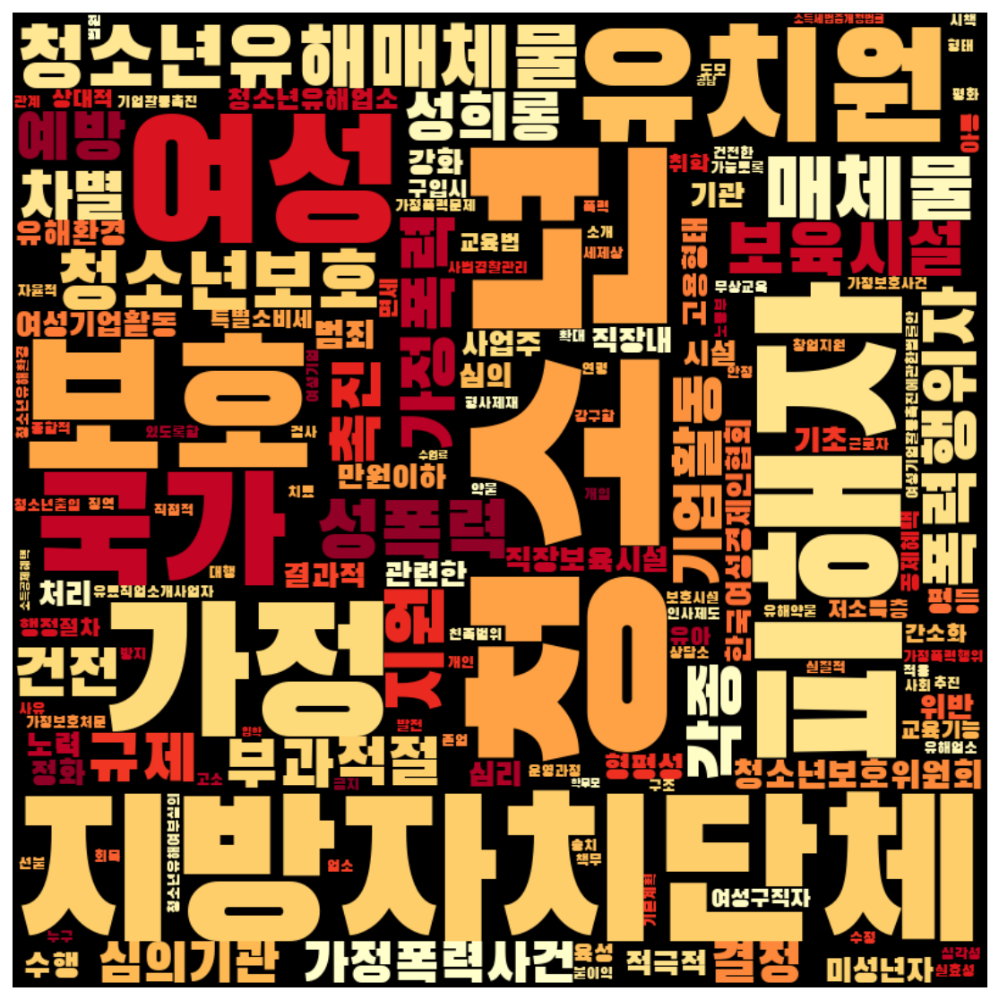

In [57]:
frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 김대중 정권 
- 1998.02.25 ~ 2003.02.24

In [61]:
kimdaejoong = gender[(gender['제안일자'] > datetime.date(1998,2,25)) & 
                        (gender['제안일자'] < datetime.date(2003,2,24))]
kimdaejoong.shape

(92, 19)

In [62]:
kimdaejoong['성별'].value_counts()

남성    31
여성    23
Name: 성별, dtype: int64

In [63]:
pd.DataFrame(kimdaejoong.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   22
     여성   16
진보   남성    7
     여성    7

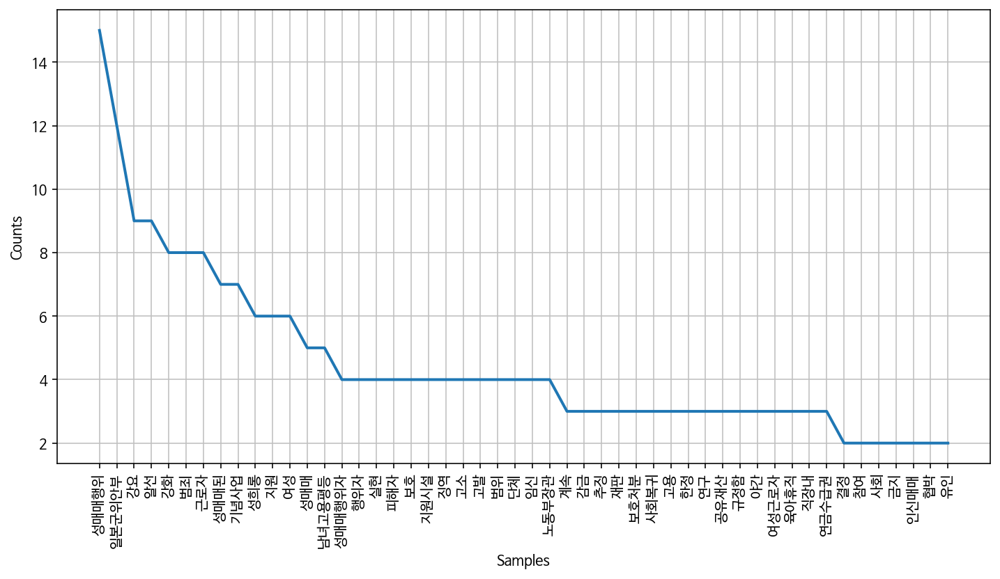

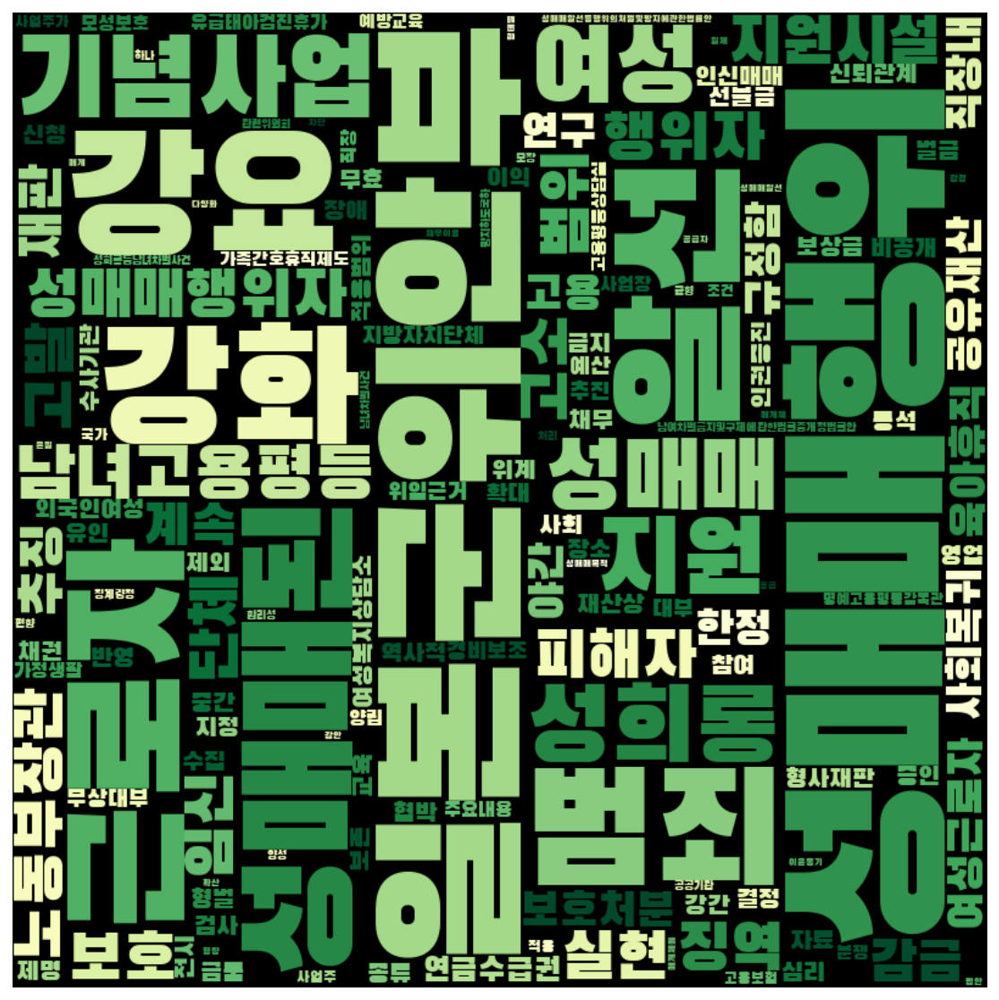

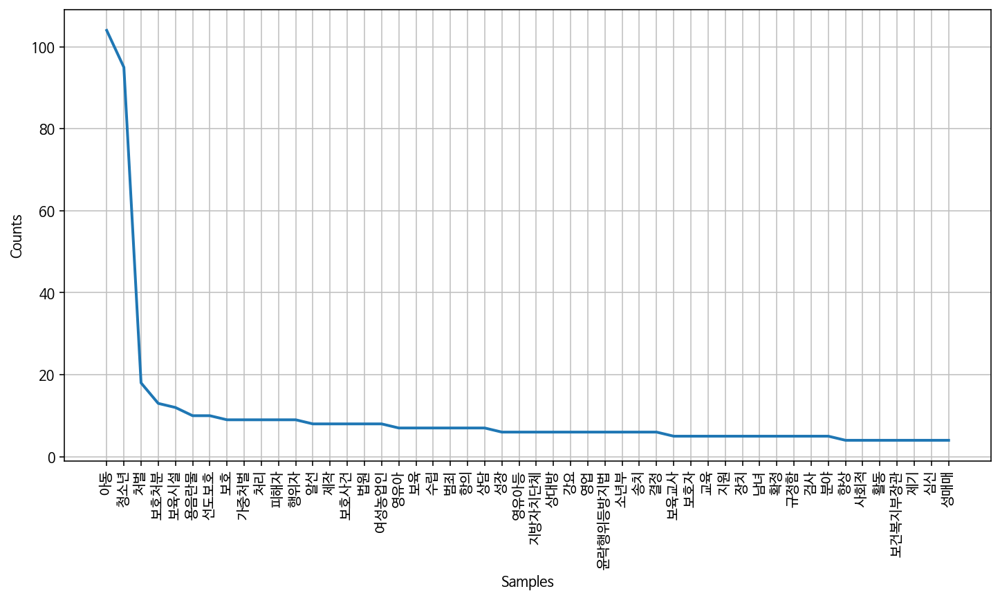

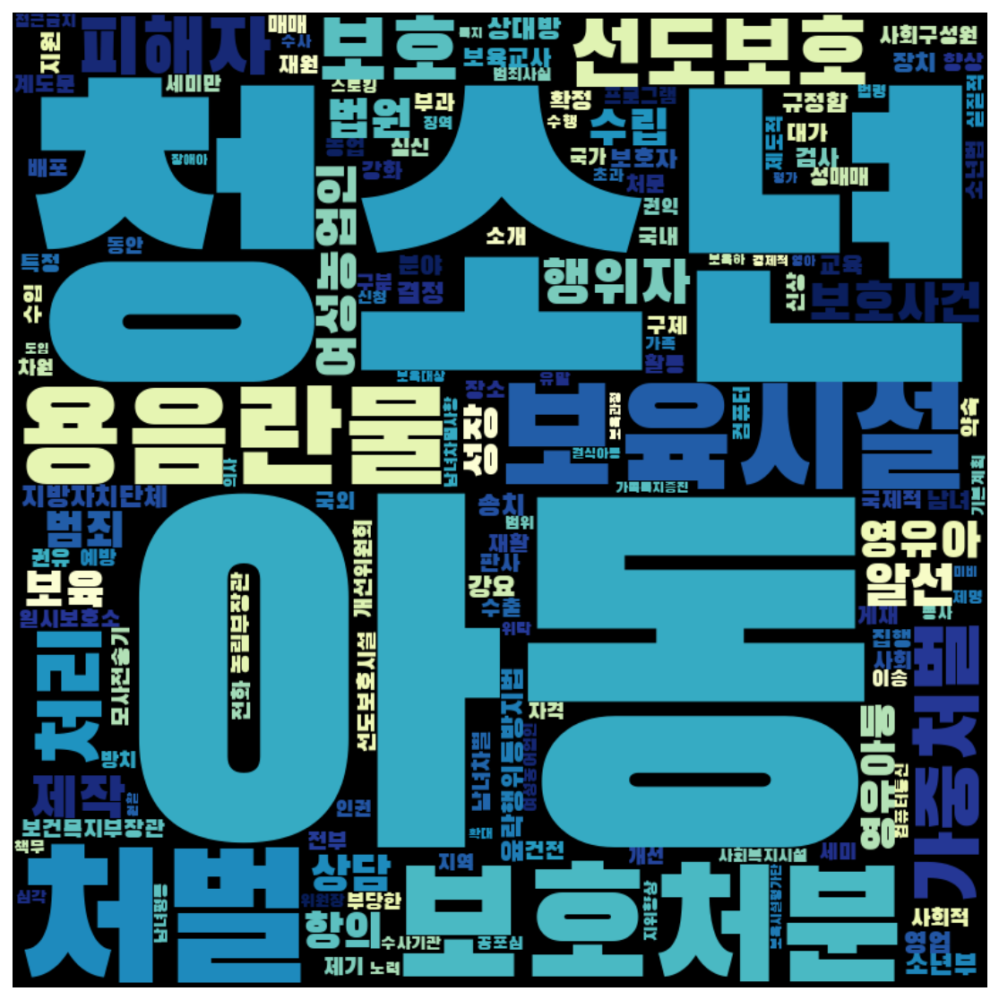

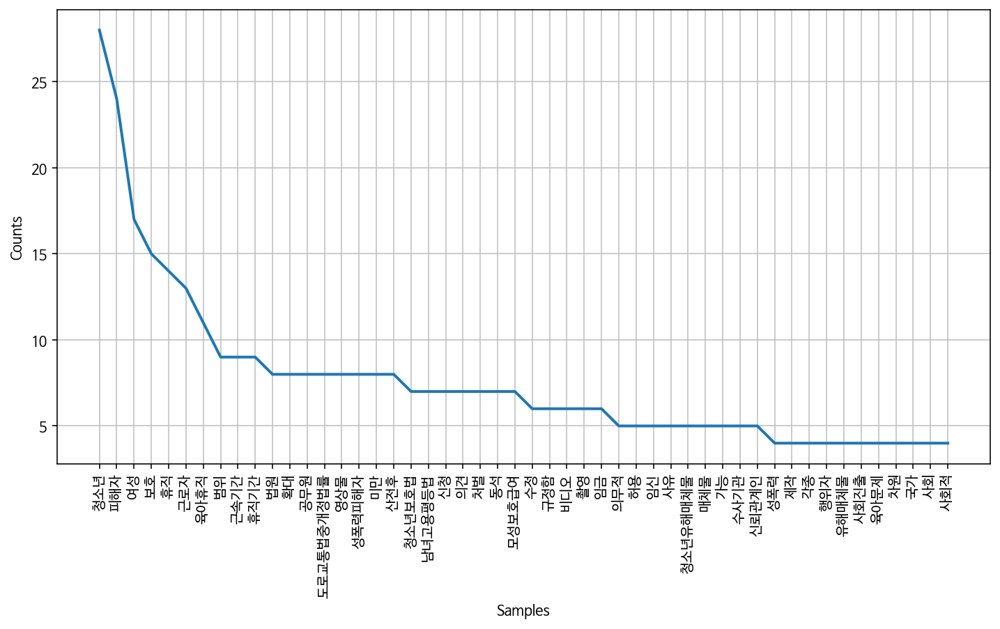

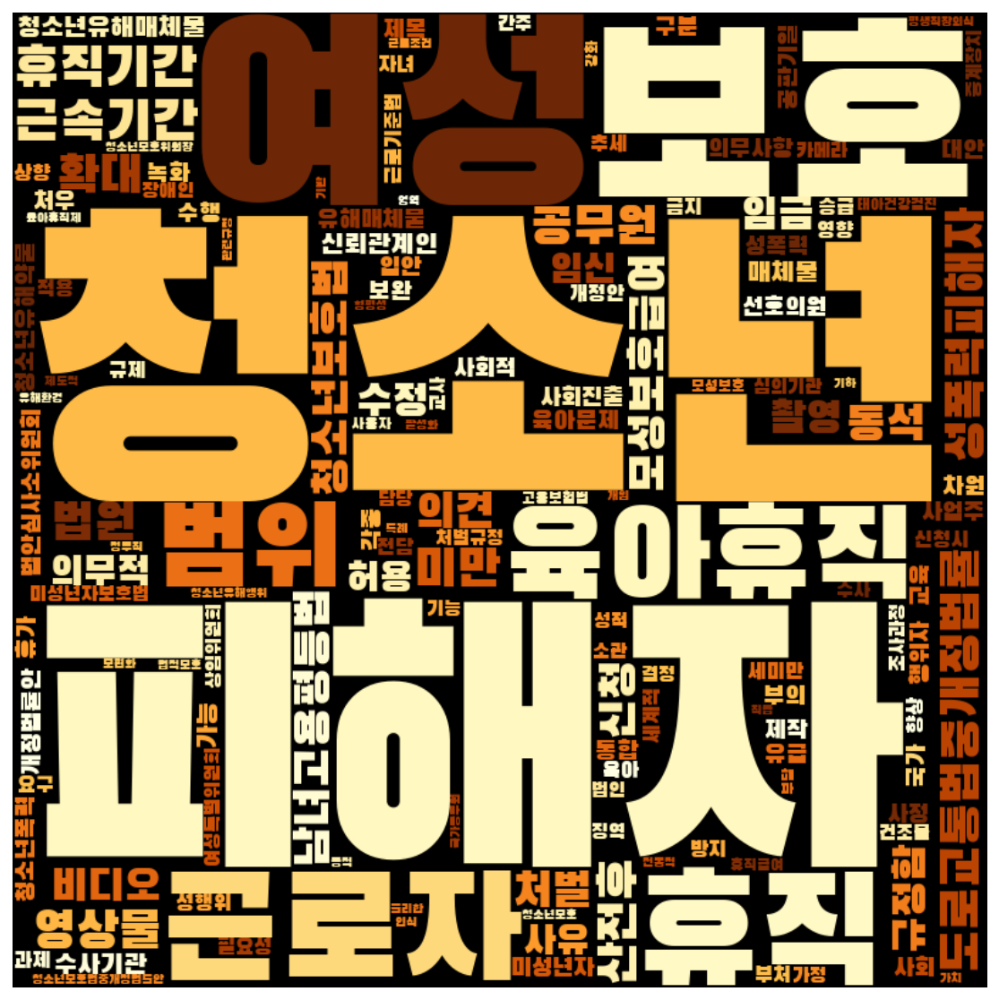

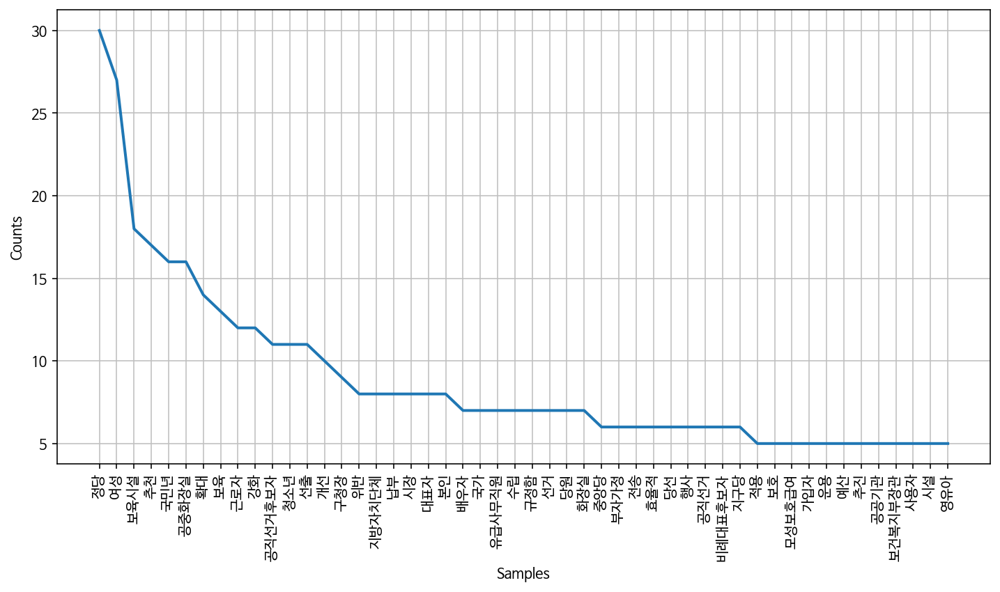

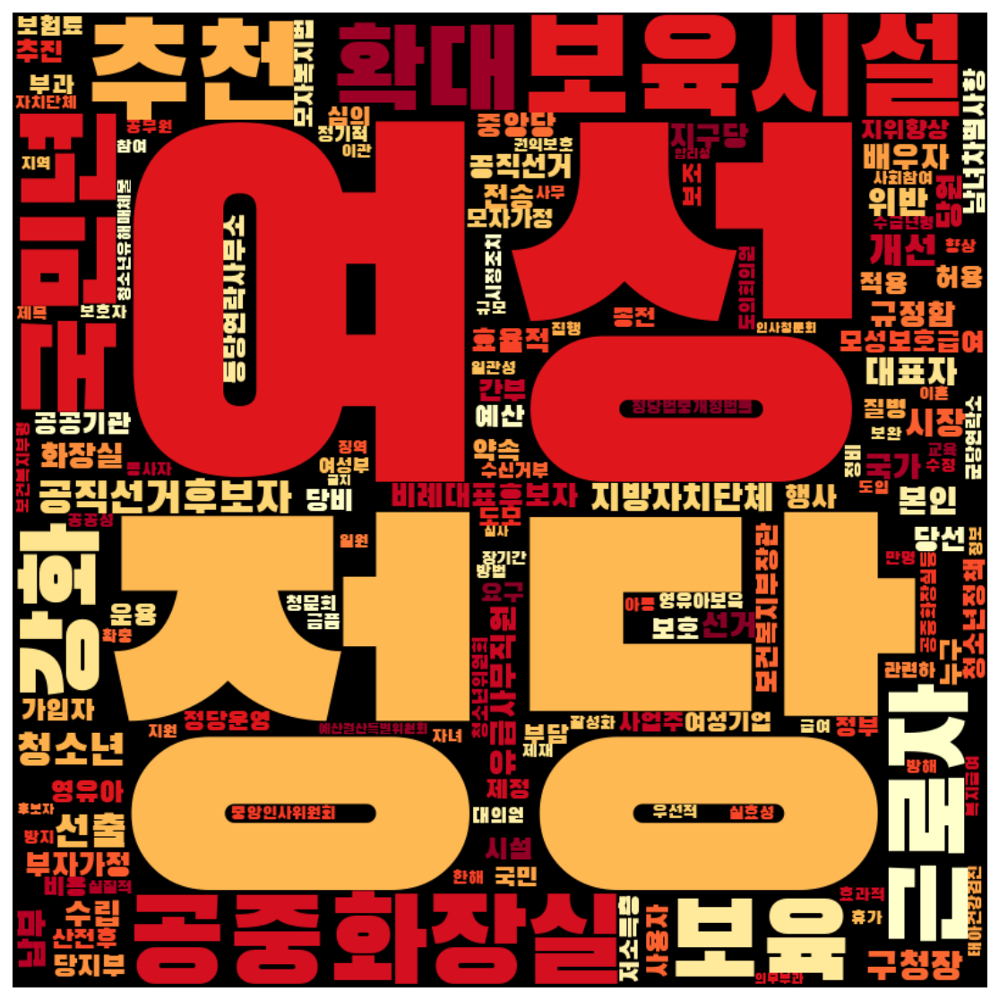

In [64]:
pro_women = kimdaejoong[(kimdaejoong['성별'] == '여성') & (kimdaejoong['정당성향'] == '진보')]
pro_men = kimdaejoong[(kimdaejoong['성별'] == '남성') & (kimdaejoong['정당성향'] == '진보')]
con_women = kimdaejoong[(kimdaejoong['성별'] == '여성') & (kimdaejoong['정당성향'] == '보수')]
con_men = kimdaejoong[(kimdaejoong['성별'] == '남성') & (kimdaejoong['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

## 노무현 정권  
- 2003.02.25 ~ 2004.04.14

In [65]:
romoohyun = gender[(gender['제안일자'] > datetime.date(2003,2,25)) & 
                        (gender['제안일자'] < datetime.date(2008,2,24))]
romoohyun.shape

(447, 19)

In [66]:
romoohyun['성별'].value_counts()

여성    182
남성    165
Name: 성별, dtype: int64

In [67]:
pd.DataFrame(romoohyun.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성   86
     여성   97
진보   남성   77
     여성   85

(85, 19)
(77, 19)
(97, 19)
(86, 19)


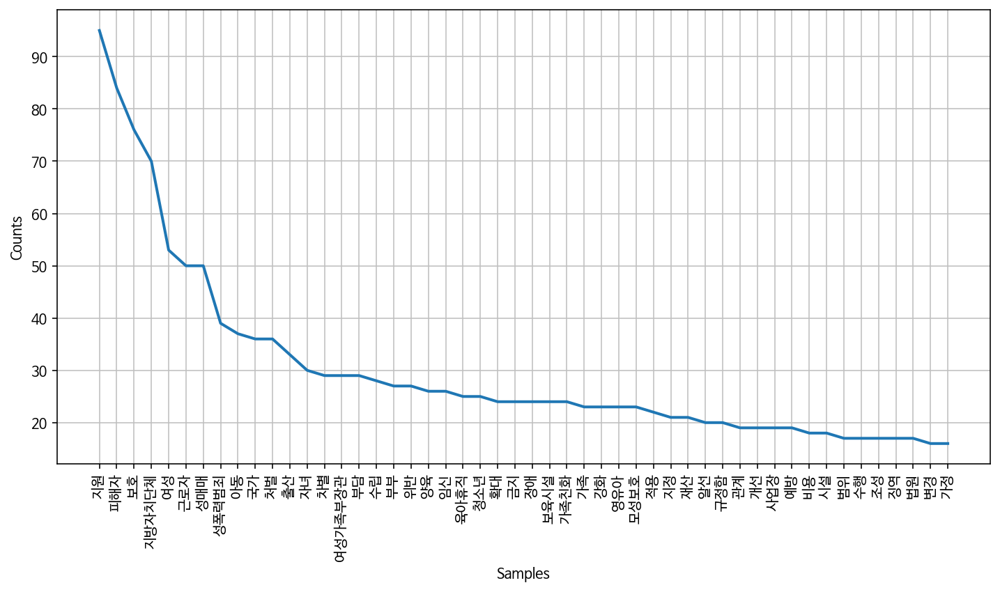

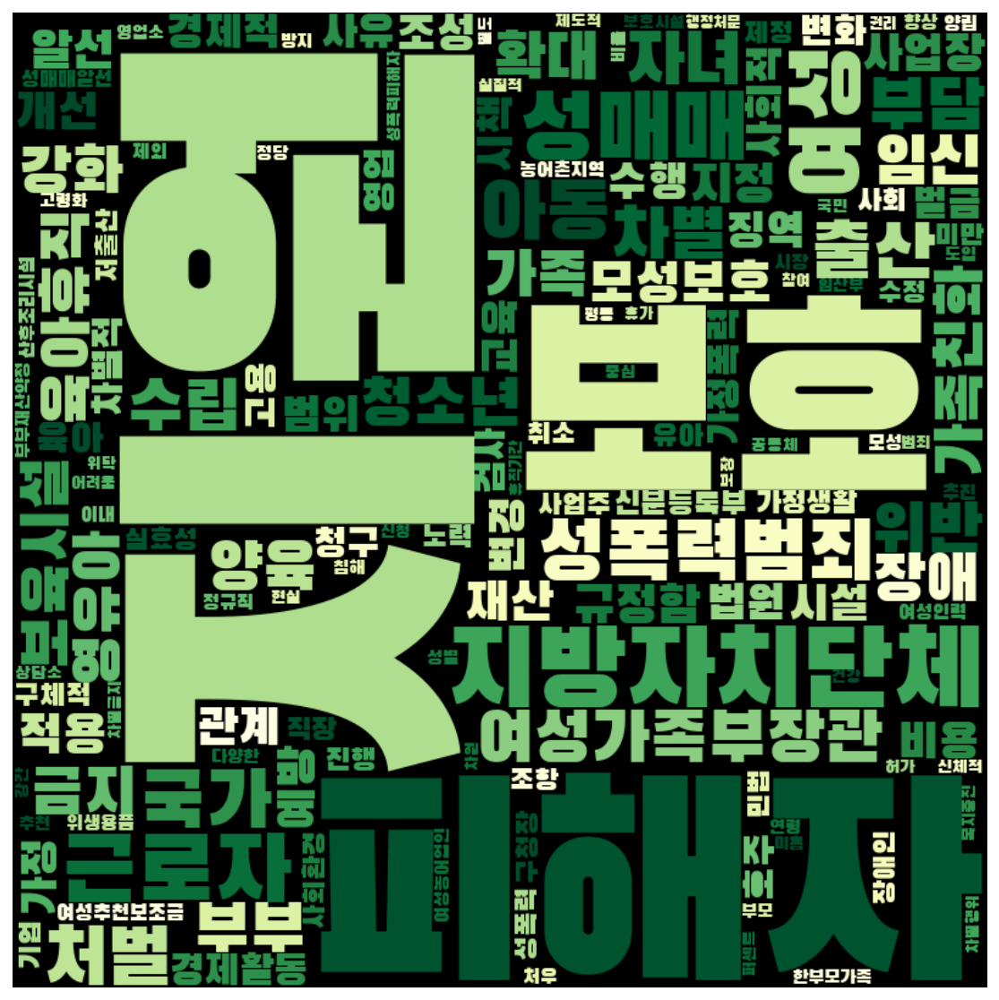

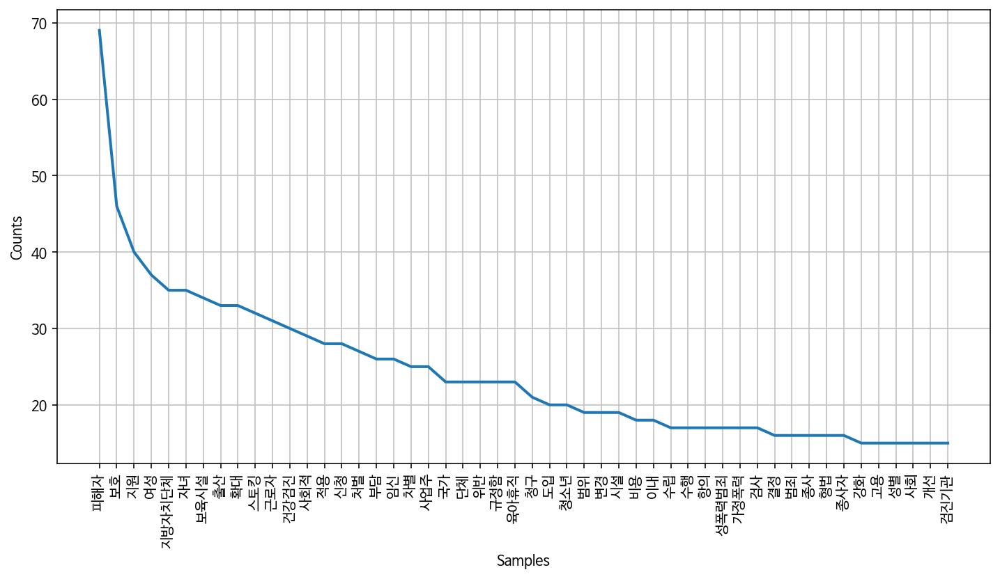

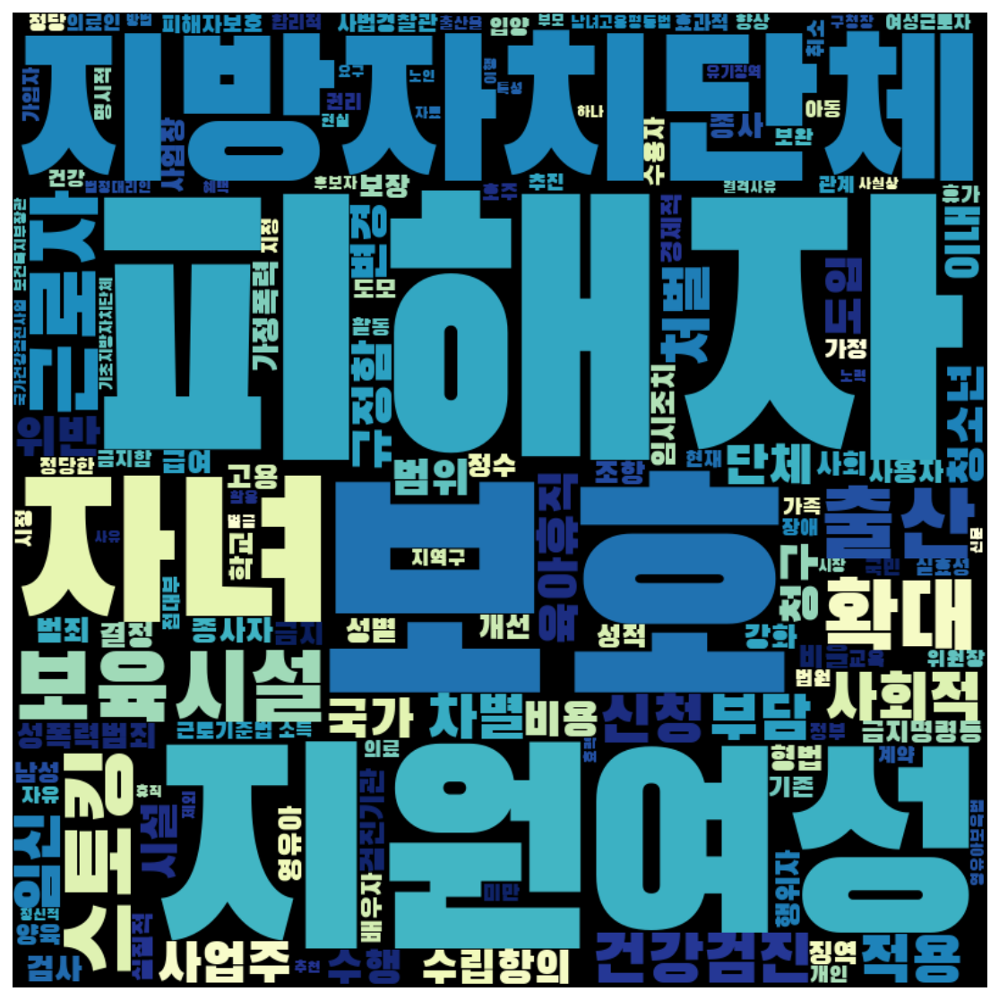

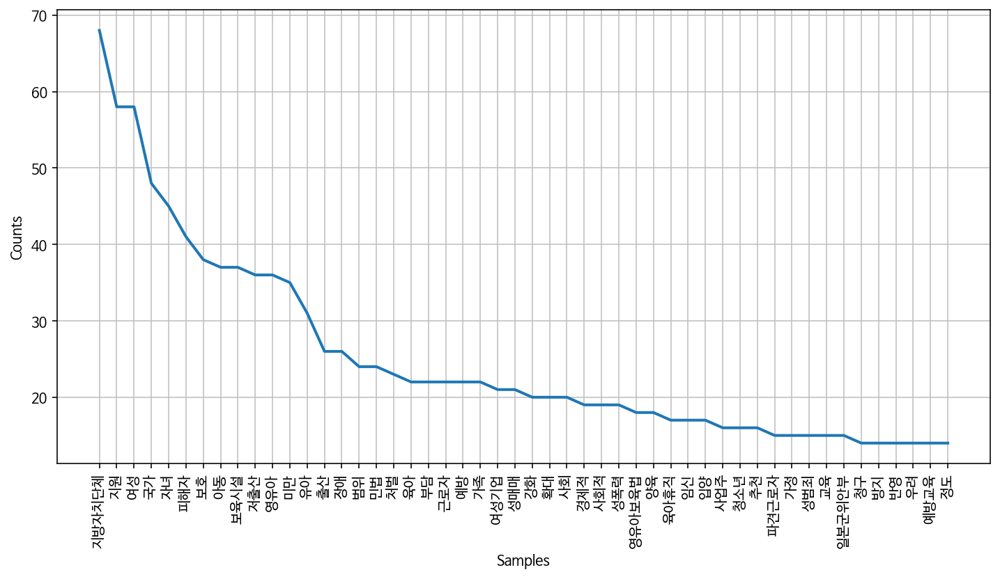

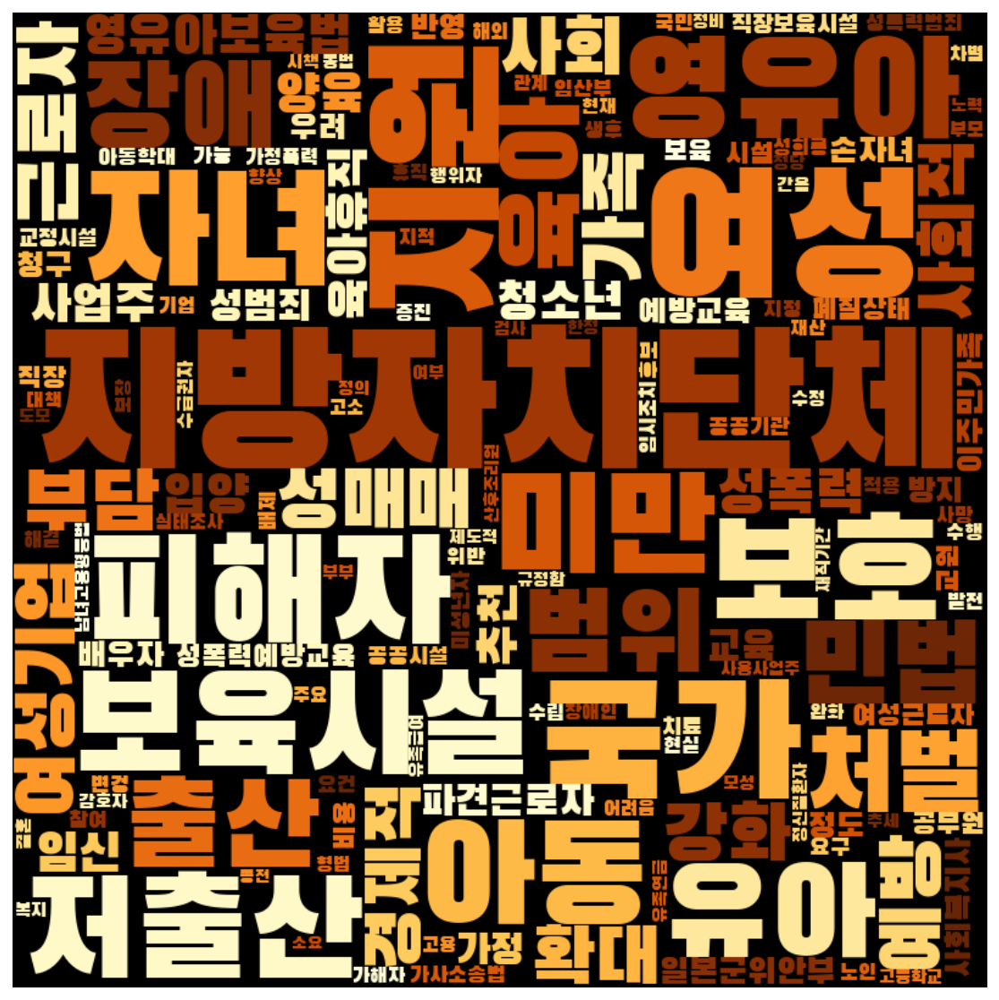

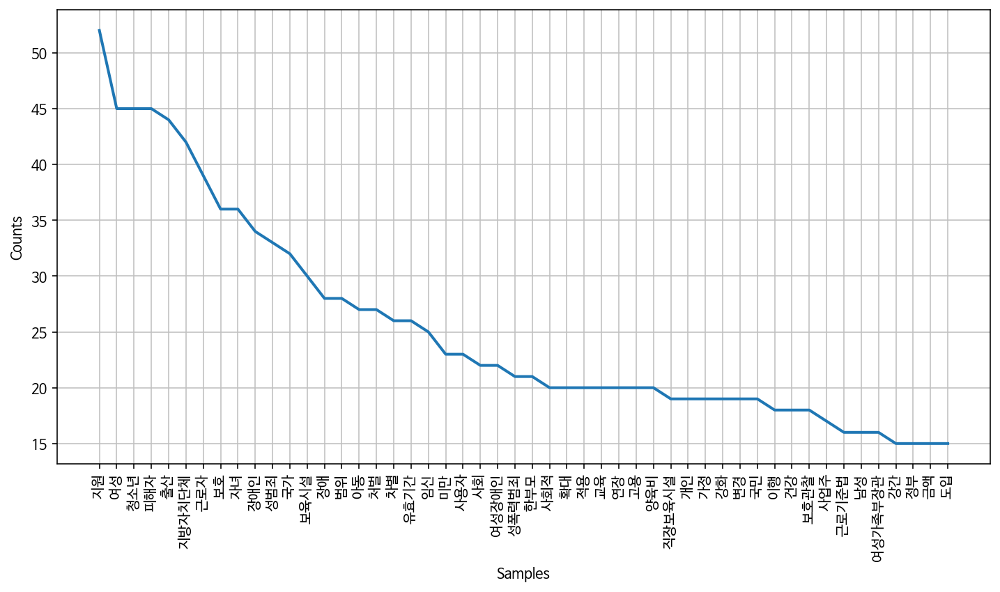

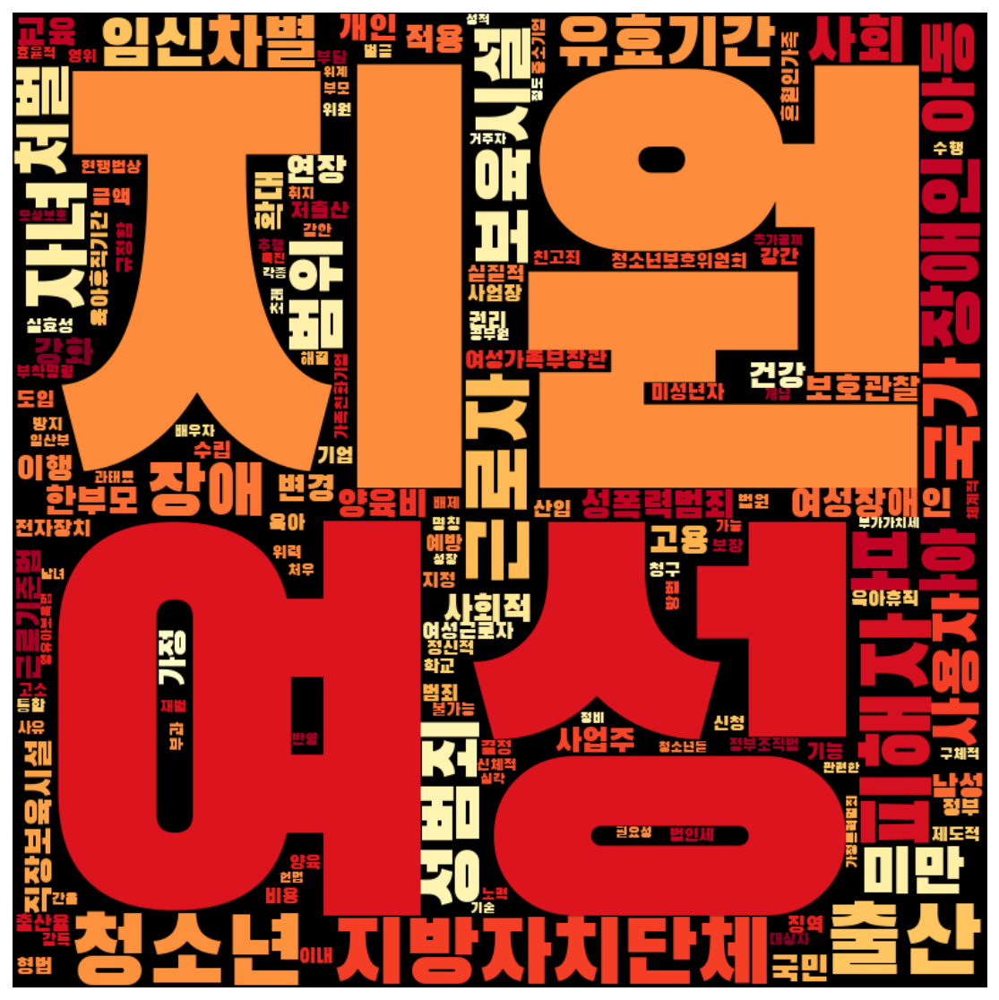

In [92]:
pro_women = romoohyun[(romoohyun['성별'] == '여성') & (romoohyun['정당성향'] == '진보')]
print(pro_women.shape)
pro_men = romoohyun[(romoohyun['성별'] == '남성') & (romoohyun['정당성향'] == '진보')]
print(pro_men.shape)
con_women = romoohyun[(romoohyun['성별'] == '여성') & (romoohyun['정당성향'] == '보수')]
print(con_women.shape)
con_men = romoohyun[(romoohyun['성별'] == '남성') & (romoohyun['정당성향'] == '보수')]
print(con_men.shape)

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [93]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 16:03:09,985 : INFO : collecting all words and their counts
2020-10-20 16:03:09,987 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 16:03:09,991 : INFO : collected 2689 word types from a corpus of 8315 raw words and 85 sentences
2020-10-20 16:03:09,992 : INFO : Loading a fresh vocabulary
2020-10-20 16:03:09,995 : INFO : effective_min_count=10 retains 156 unique words (5% of original 2689, drops 2533)
2020-10-20 16:03:09,996 : INFO : effective_min_count=10 leaves 3068 word corpus (36% of original 8315, drops 5247)
2020-10-20 16:03:09,999 : INFO : deleting the raw counts dictionary of 2689 items
2020-10-20 16:03:10,000 : INFO : sample=0.001 downsamples 156 most-common words
2020-10-20 16:03:10,001 : INFO : downsampling leaves estimated 1635 word corpus (53.3% of prior 3068)
2020-10-20 16:03:10,003 : INFO : estimated required memory for 156 words and 100 dimensions: 202800 bytes
2020-10-20 16:03:10,004 : INFO : resetting layer weights
2020-

2020-10-20 16:03:10,327 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:10,329 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:10,331 : INFO : EPOCH - 15 : training on 8315 raw words (1669 effective words) took 0.0s, 111606 effective words/s
2020-10-20 16:03:10,335 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:10,344 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:10,346 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:10,348 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:10,349 : INFO : EPOCH - 16 : training on 8315 raw words (1619 effective words) took 0.0s, 110533 effective words/s
2020-10-20 16:03:10,355 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:10,360 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-

2020-10-20 16:03:10,668 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:10,672 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:10,678 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:10,681 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:10,682 : INFO : EPOCH - 32 : training on 8315 raw words (1621 effective words) took 0.0s, 102061 effective words/s
2020-10-20 16:03:10,695 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:10,697 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:10,700 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:10,701 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:10,702 : INFO : EPOCH - 33 : training on 8315 raw words (1668 effective words) took 0.0s, 223243 effective words/s
2020-10-

2020-10-20 16:03:11,023 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:11,025 : INFO : EPOCH - 48 : training on 8315 raw words (1686 effective words) took 0.0s, 96396 effective words/s
2020-10-20 16:03:11,031 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:11,040 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,042 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:11,044 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:11,046 : INFO : EPOCH - 49 : training on 8315 raw words (1584 effective words) took 0.0s, 91783 effective words/s
2020-10-20 16:03:11,057 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:11,058 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,060 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20

2020-10-20 16:03:11,395 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,398 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:11,400 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:11,401 : INFO : EPOCH - 65 : training on 8315 raw words (1640 effective words) took 0.0s, 124479 effective words/s
2020-10-20 16:03:11,409 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:11,412 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,413 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:11,420 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:11,423 : INFO : EPOCH - 66 : training on 8315 raw words (1627 effective words) took 0.0s, 119888 effective words/s
2020-10-20 16:03:11,428 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-20 16:03:11,694 : INFO : EPOCH - 81 : training on 8315 raw words (1610 effective words) took 0.0s, 95199 effective words/s
2020-10-20 16:03:11,700 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:11,709 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,711 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:11,712 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:11,714 : INFO : EPOCH - 82 : training on 8315 raw words (1613 effective words) took 0.0s, 117273 effective words/s
2020-10-20 16:03:11,718 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:11,724 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:11,732 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:11,733 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-2

2020-10-20 16:03:12,029 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,030 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,032 : INFO : EPOCH - 98 : training on 8315 raw words (1588 effective words) took 0.0s, 103448 effective words/s
2020-10-20 16:03:12,041 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,048 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,050 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,053 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,057 : INFO : EPOCH - 99 : training on 8315 raw words (1609 effective words) took 0.0s, 87072 effective words/s
2020-10-20 16:03:12,061 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,062 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-2

2020-10-20 16:03:12,345 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,349 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,350 : INFO : EPOCH - 12 : training on 7813 raw words (1151 effective words) took 0.0s, 121660 effective words/s
2020-10-20 16:03:12,358 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,363 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,364 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,366 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,368 : INFO : EPOCH - 13 : training on 7813 raw words (1178 effective words) took 0.0s, 122079 effective words/s
2020-10-20 16:03:12,373 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,378 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-

2020-10-20 16:03:12,668 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,670 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,675 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,678 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,679 : INFO : EPOCH - 29 : training on 7813 raw words (1126 effective words) took 0.0s, 99605 effective words/s
2020-10-20 16:03:12,685 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,692 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,694 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,695 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,696 : INFO : EPOCH - 30 : training on 7813 raw words (1154 effective words) took 0.0s, 87482 effective words/s
2020-10-20

2020-10-20 16:03:12,972 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,974 : INFO : EPOCH - 45 : training on 7813 raw words (1124 effective words) took 0.0s, 61902 effective words/s
2020-10-20 16:03:12,978 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,981 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,984 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:12,986 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:12,988 : INFO : EPOCH - 46 : training on 7813 raw words (1124 effective words) took 0.0s, 105445 effective words/s
2020-10-20 16:03:12,994 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:12,996 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:12,999 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-2

2020-10-20 16:03:13,255 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:13,257 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,258 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:13,259 : INFO : EPOCH - 62 : training on 7813 raw words (1110 effective words) took 0.0s, 104185 effective words/s
2020-10-20 16:03:13,265 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:13,272 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:13,276 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,280 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:13,285 : INFO : EPOCH - 63 : training on 7813 raw words (1120 effective words) took 0.0s, 54766 effective words/s
2020-10-20 16:03:13,294 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-2

2020-10-20 16:03:13,571 : INFO : EPOCH - 78 : training on 7813 raw words (1166 effective words) took 0.0s, 84511 effective words/s
2020-10-20 16:03:13,580 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:13,587 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:13,589 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,590 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:13,591 : INFO : EPOCH - 79 : training on 7813 raw words (1106 effective words) took 0.0s, 91587 effective words/s
2020-10-20 16:03:13,596 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:13,598 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:13,603 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,605 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20

2020-10-20 16:03:13,880 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,882 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:13,883 : INFO : EPOCH - 95 : training on 7813 raw words (1150 effective words) took 0.0s, 82607 effective words/s
2020-10-20 16:03:13,889 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:13,896 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:13,898 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:13,899 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:13,900 : INFO : EPOCH - 96 : training on 7813 raw words (1164 effective words) took 0.0s, 87544 effective words/s
2020-10-20 16:03:13,903 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:13,906 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20

2020-10-20 16:03:14,211 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,212 : INFO : EPOCH - 9 : training on 6640 raw words (957 effective words) took 0.0s, 57666 effective words/s
2020-10-20 16:03:14,217 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:14,223 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,224 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:14,226 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,227 : INFO : EPOCH - 10 : training on 6640 raw words (940 effective words) took 0.0s, 88234 effective words/s
2020-10-20 16:03:14,235 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:14,237 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,239 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16

2020-10-20 16:03:14,490 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,492 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:14,492 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,493 : INFO : EPOCH - 26 : training on 6640 raw words (965 effective words) took 0.0s, 122961 effective words/s
2020-10-20 16:03:14,502 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:14,507 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,511 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:14,513 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,514 : INFO : EPOCH - 27 : training on 6640 raw words (946 effective words) took 0.0s, 64287 effective words/s
2020-10-20 16:03:14,520 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 

2020-10-20 16:03:14,766 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:14,769 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,772 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:14,774 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,777 : INFO : EPOCH - 43 : training on 6640 raw words (938 effective words) took 0.0s, 75331 effective words/s
2020-10-20 16:03:14,781 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:14,783 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:14,787 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:14,789 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:14,793 : INFO : EPOCH - 44 : training on 6640 raw words (932 effective words) took 0.0s, 73765 effective words/s
2020-10-20 1

2020-10-20 16:03:15,051 : INFO : EPOCH - 59 : training on 6640 raw words (952 effective words) took 0.0s, 102815 effective words/s
2020-10-20 16:03:15,056 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,058 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,060 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,062 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,065 : INFO : EPOCH - 60 : training on 6640 raw words (987 effective words) took 0.0s, 94938 effective words/s
2020-10-20 16:03:15,079 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,084 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,085 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,089 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 

2020-10-20 16:03:15,286 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,289 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,290 : INFO : EPOCH - 76 : training on 6640 raw words (966 effective words) took 0.0s, 155173 effective words/s
2020-10-20 16:03:15,295 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,295 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,297 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,299 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,300 : INFO : EPOCH - 77 : training on 6640 raw words (946 effective words) took 0.0s, 142652 effective words/s
2020-10-20 16:03:15,304 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,305 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20

2020-10-20 16:03:15,566 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,569 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,572 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,572 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,573 : INFO : EPOCH - 93 : training on 6640 raw words (968 effective words) took 0.0s, 114247 effective words/s
2020-10-20 16:03:15,577 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,579 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,582 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,583 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,584 : INFO : EPOCH - 94 : training on 6640 raw words (954 effective words) took 0.0s, 141026 effective words/s
2020-10-20

2020-10-20 16:03:15,863 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,864 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,869 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,871 : INFO : EPOCH - 7 : training on 7823 raw words (1134 effective words) took 0.0s, 68312 effective words/s
2020-10-20 16:03:15,874 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:15,876 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:15,878 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:15,882 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:15,883 : INFO : EPOCH - 8 : training on 7823 raw words (1131 effective words) took 0.0s, 114118 effective words/s
2020-10-20 16:03:15,887 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 

2020-10-20 16:03:16,086 : INFO : EPOCH - 23 : training on 7823 raw words (1147 effective words) took 0.0s, 130835 effective words/s
2020-10-20 16:03:16,092 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,093 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:16,097 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,099 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:16,104 : INFO : EPOCH - 24 : training on 7823 raw words (1108 effective words) took 0.0s, 86367 effective words/s
2020-10-20 16:03:16,116 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,119 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:16,122 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,125 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-2

2020-10-20 16:03:16,412 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,414 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:16,415 : INFO : EPOCH - 40 : training on 7823 raw words (1113 effective words) took 0.0s, 85756 effective words/s
2020-10-20 16:03:16,419 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,426 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:16,432 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,433 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:16,435 : INFO : EPOCH - 41 : training on 7823 raw words (1152 effective words) took 0.0s, 70223 effective words/s
2020-10-20 16:03:16,450 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,451 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20

2020-10-20 16:03:16,683 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,694 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:16,703 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,705 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:16,709 : INFO : EPOCH - 57 : training on 7823 raw words (1134 effective words) took 0.0s, 44459 effective words/s
2020-10-20 16:03:16,711 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:16,717 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:16,718 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:16,721 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:16,725 : INFO : EPOCH - 58 : training on 7823 raw words (1148 effective words) took 0.0s, 84358 effective words/s
2020-10-20

2020-10-20 16:03:17,003 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:17,004 : INFO : EPOCH - 73 : training on 7823 raw words (1103 effective words) took 0.0s, 140108 effective words/s
2020-10-20 16:03:17,010 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:17,011 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:17,014 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:17,016 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:17,017 : INFO : EPOCH - 74 : training on 7823 raw words (1129 effective words) took 0.0s, 109133 effective words/s
2020-10-20 16:03:17,022 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:17,026 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:17,028 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-

2020-10-20 16:03:17,305 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:17,306 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:17,310 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:17,310 : INFO : EPOCH - 90 : training on 7823 raw words (1100 effective words) took 0.0s, 122731 effective words/s
2020-10-20 16:03:17,314 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:03:17,315 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:03:17,316 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:03:17,321 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:03:17,322 : INFO : EPOCH - 91 : training on 7823 raw words (1154 effective words) took 0.0s, 151295 effective words/s
2020-10-20 16:03:17,326 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

In [94]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-20 16:03:17,439 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:03:17,441 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:03:17,444 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:03:17,446 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('고령화', 0.486911803483963), ('출산', 0.438591867685318), ('비율', 0.424527645111084), ('위생용품', 0.3894011378288269), ('노력', 0.383190780878067), ('경제활동', 0.382323682308197), ('여성인력', 0.37493473291397095), ('부부재산약정', 0.3710130751132965), ('방지', 0.3630833029747009), ('저출산', 0.35107213258743286)]
진보 남성: [('사용자', 0.6029461622238159), ('임신', 0.5939512252807617), ('육아휴직', 0.5731704235076904), ('보장', 0.5705320239067078), ('근로자', 0.5552725195884705), ('성별', 0.5227668285369873), ('출산', 0.519508421421051), ('배우자', 0.5144790410995483), ('휴가', 0.5104453563690186), ('남성', 0.5029717683792114)]
보수 여성: [('추천', 0.7155396938323975), ('후보', 0.7129553556442261), ('가정', 0.5712304711341858), ('기업', 0.5460231304168701), ('항제', 0.5318225622177124), ('배우자', 0.4453932046890259), ('임신', 0.4235832393169403), ('반영', 0.42342138290405273), ('참여', 0.4215671122074127), ('가족', 0.4155779480934143)]
보수 남성: [('남성', 0.7368390560150146), ('유효기간', 0.5304878950119019), ('정부', 0.5194699764251709), ('출산율', 0.5123794078826904)

In [19]:
# 문장 벡터 생성
def get_sentence_mean_vector(morphs, model):
    vector = []
    for i in morphs:
        try:
            vector.append(model.wv[i])
        except:
            pass
    try:
        return np.mean(vector, axis=0)
    except:
        pass
    
# 엘보우 함수
def elbow(X):
    sse = []
    for i in tqdm(range(1,15), desc = '엘보우'):
        km = KMeans(init='k-means++', n_clusters = i, random_state=0)
        km.fit(X)
        sse.append(km.inertia_)
        
    plt.plot(range(1,15), sse, marker='o')
    plt.xlabel("number of cluster")
    plt.ylabel("SSE")
    plt.show()

In [96]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-96-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-96-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-96-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [97]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [99]:
pro_women['category'].value_counts()

1    59
0    26
Name: category, dtype: int64

In [101]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

In [102]:
pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

In [103]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

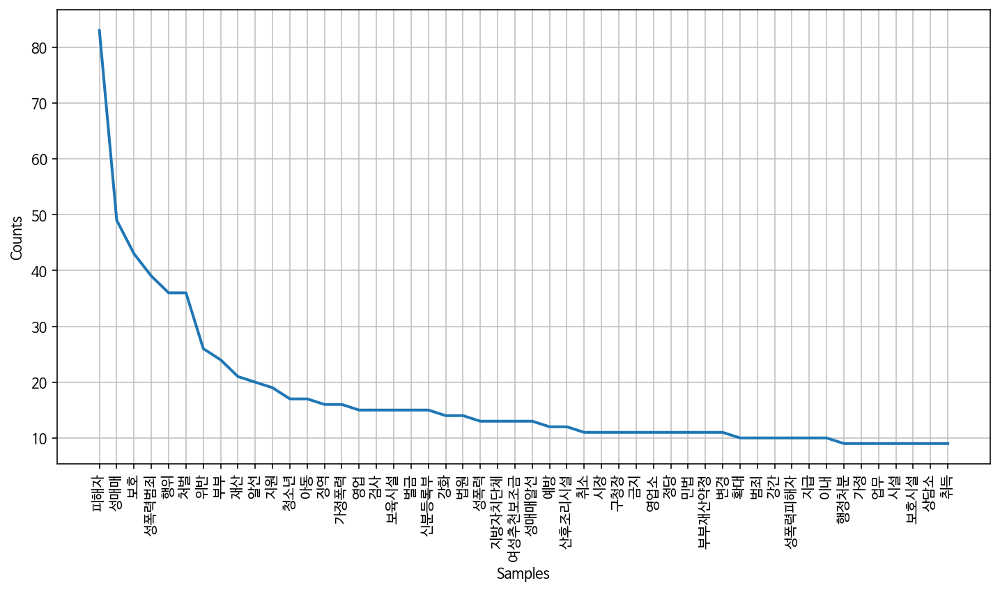

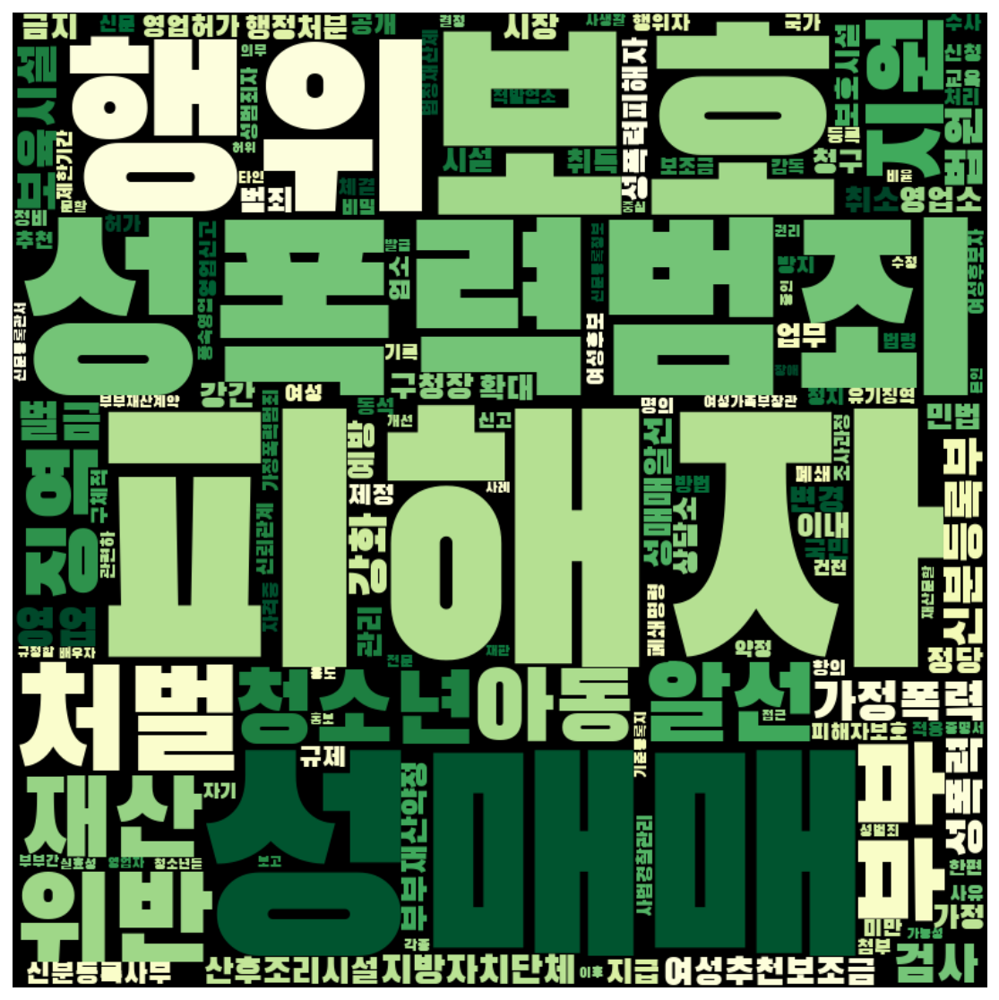

In [104]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

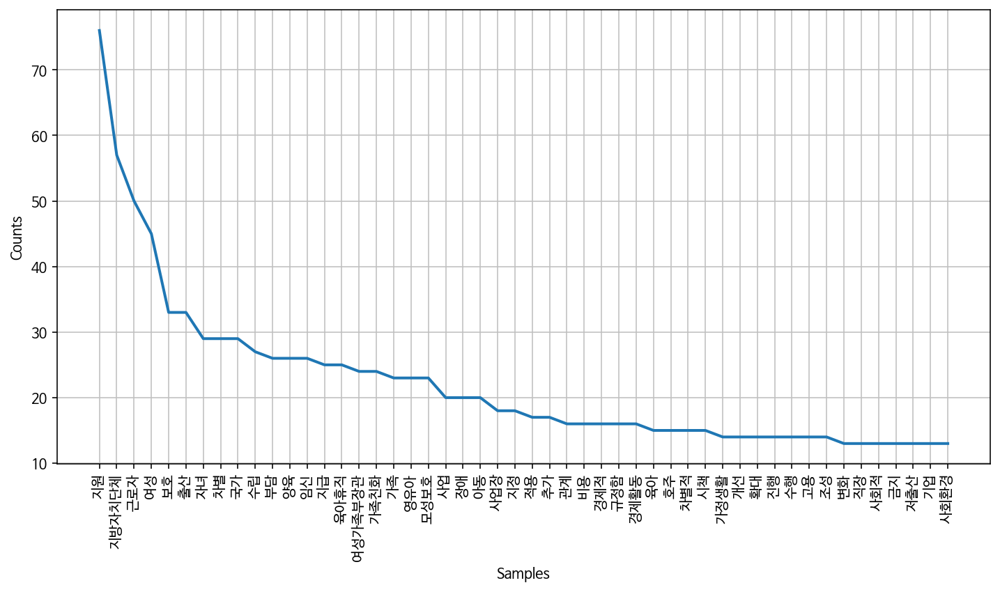

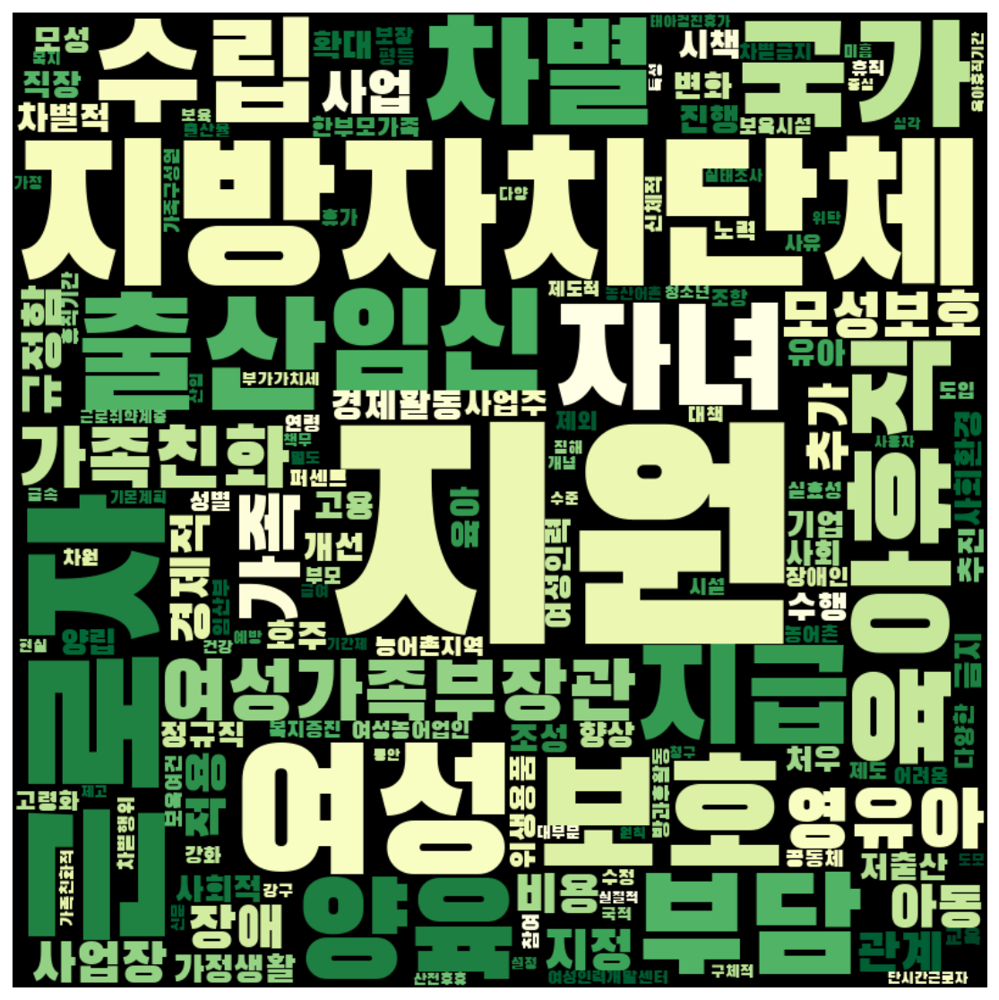

In [106]:
frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens, 'YlGn')

In [107]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

1    58
0    19
Name: category, dtype: int64


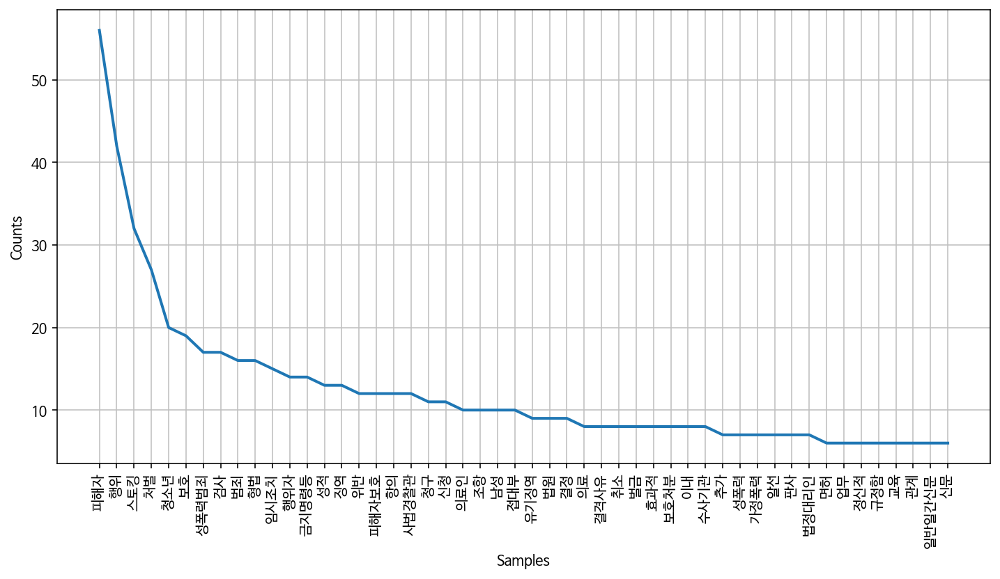

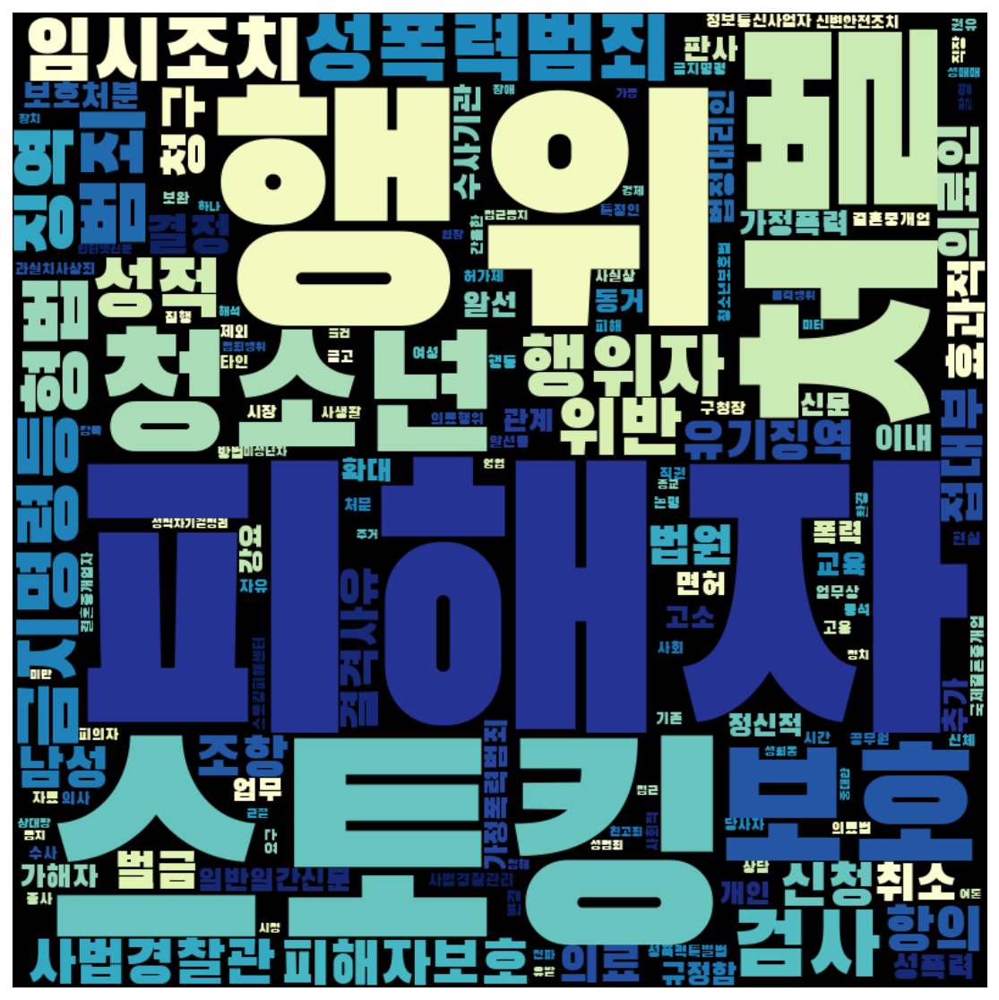

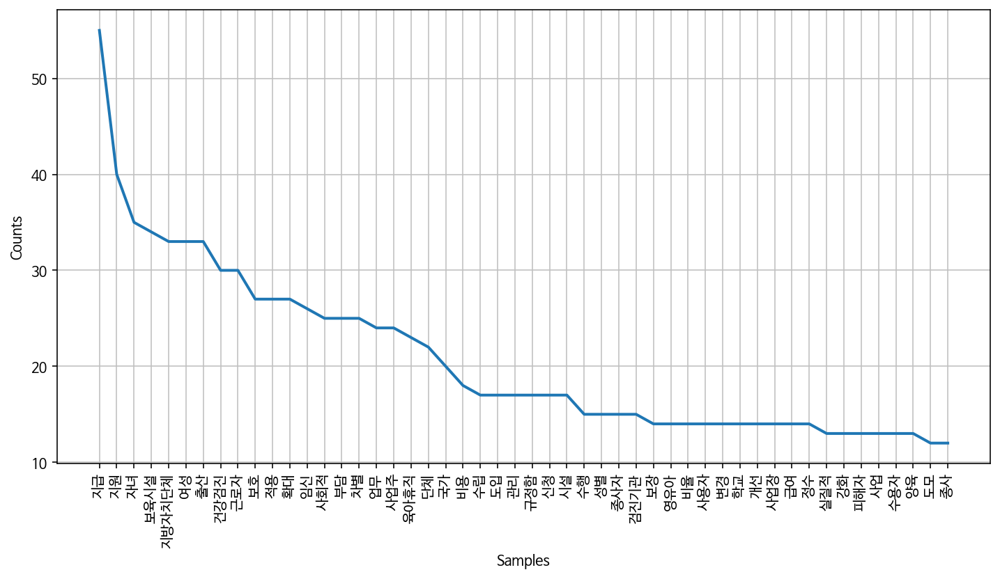

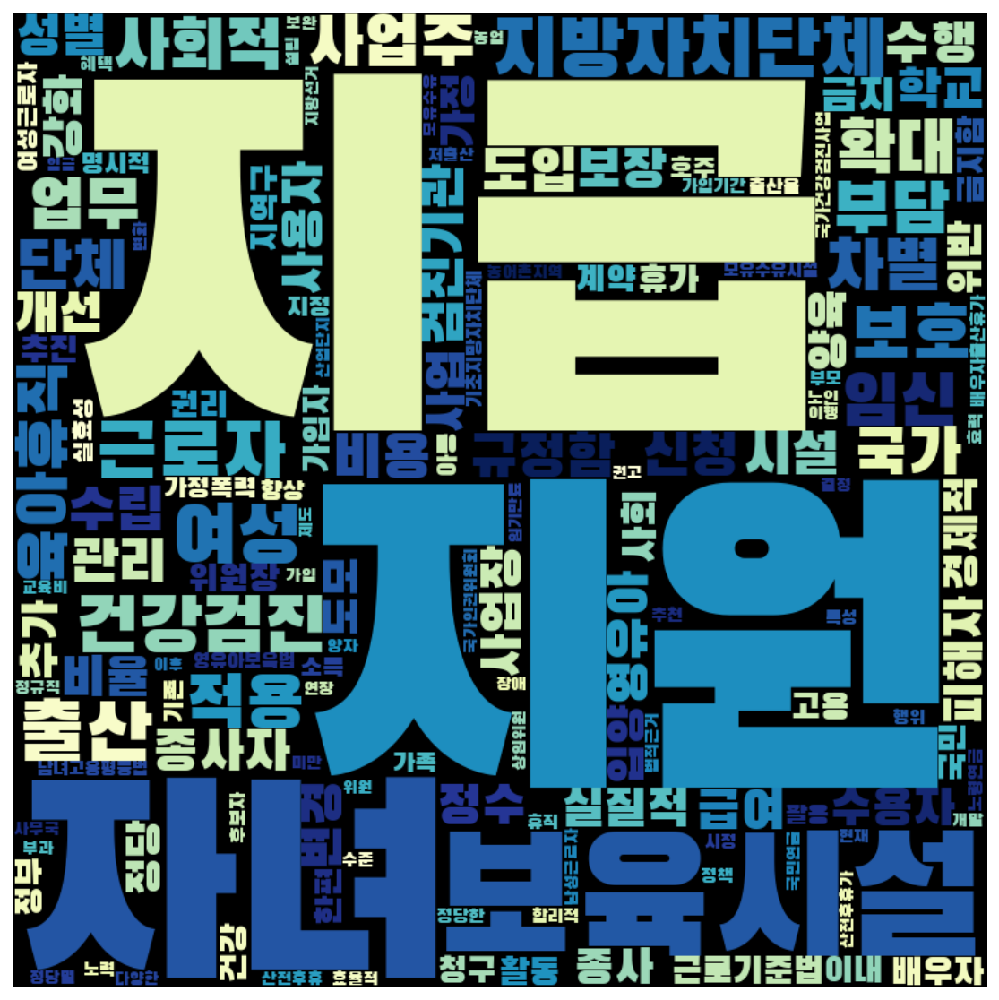

In [108]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

In [110]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

0    71
1    26
Name: category, dtype: int64


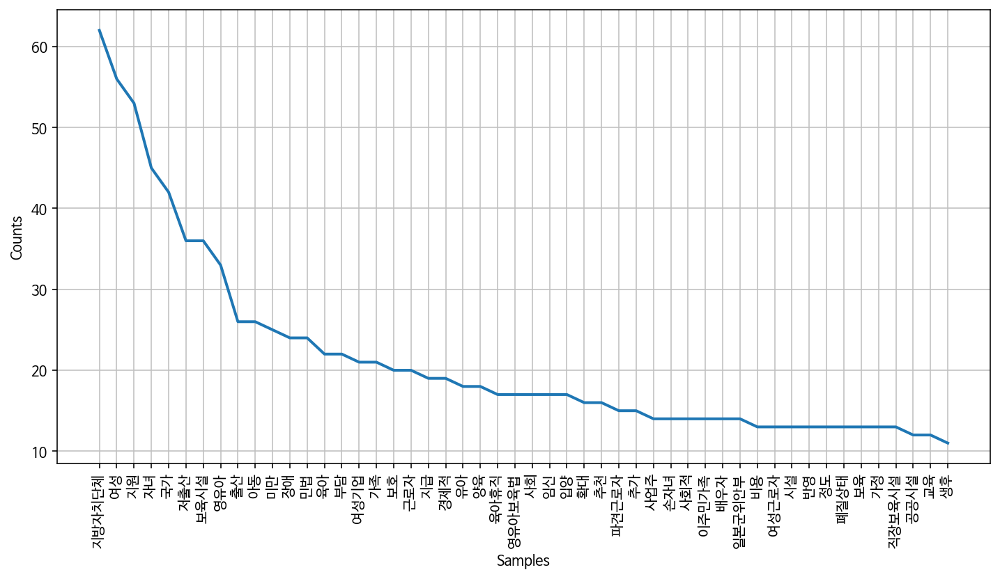

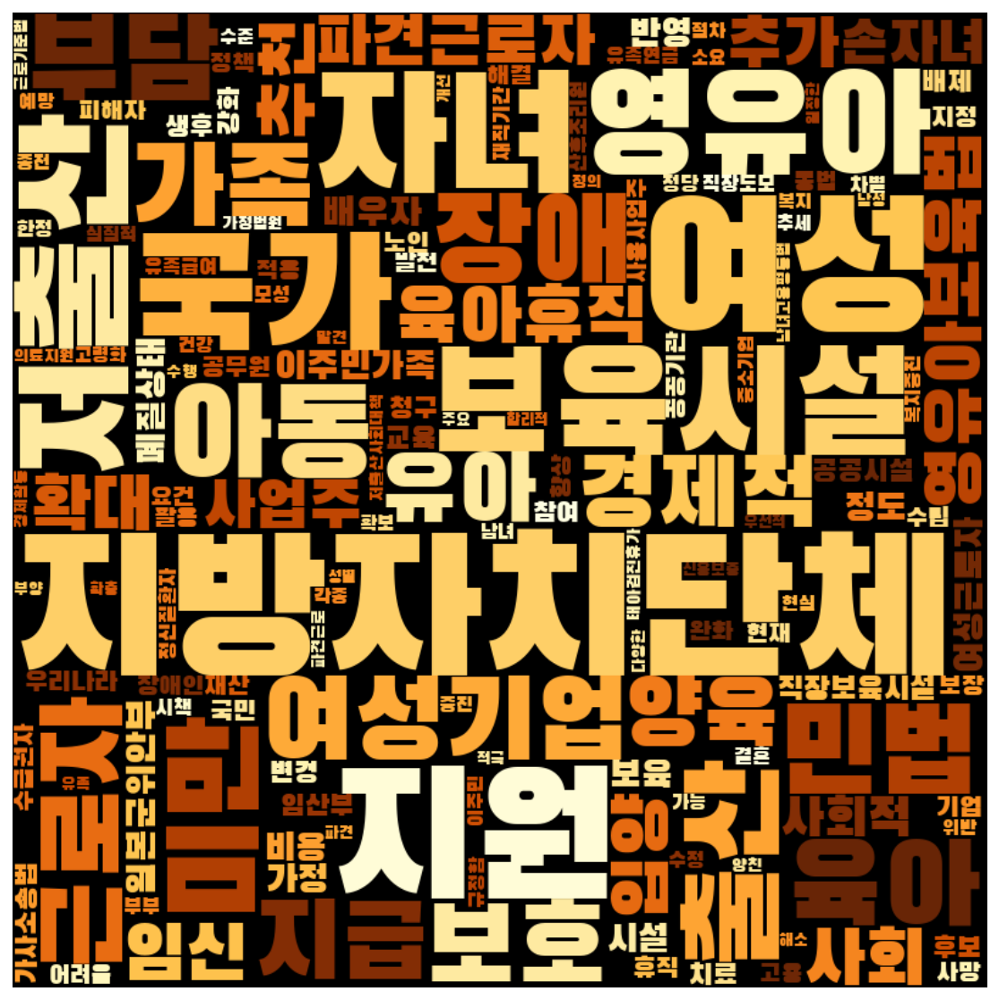

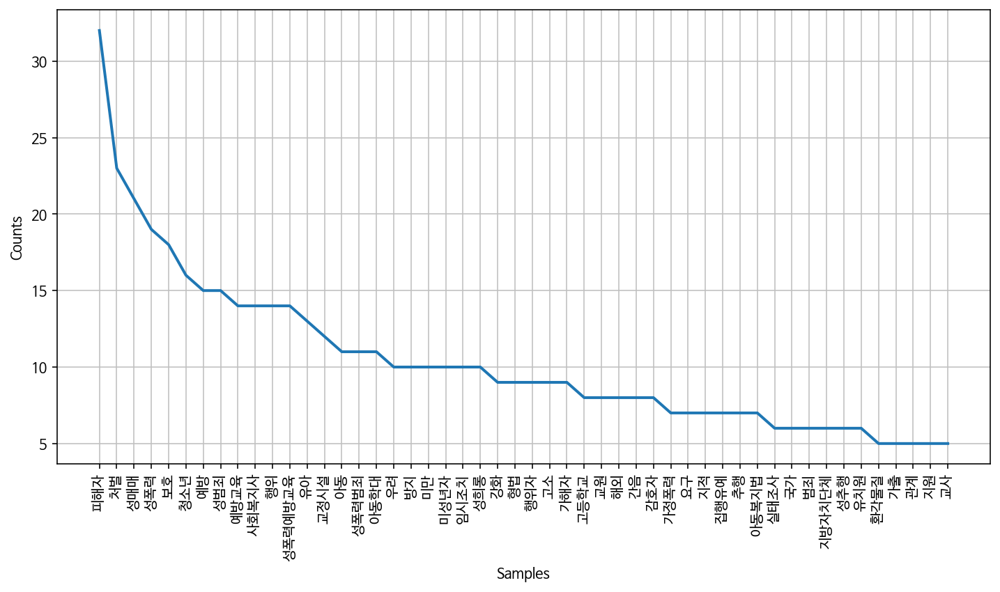

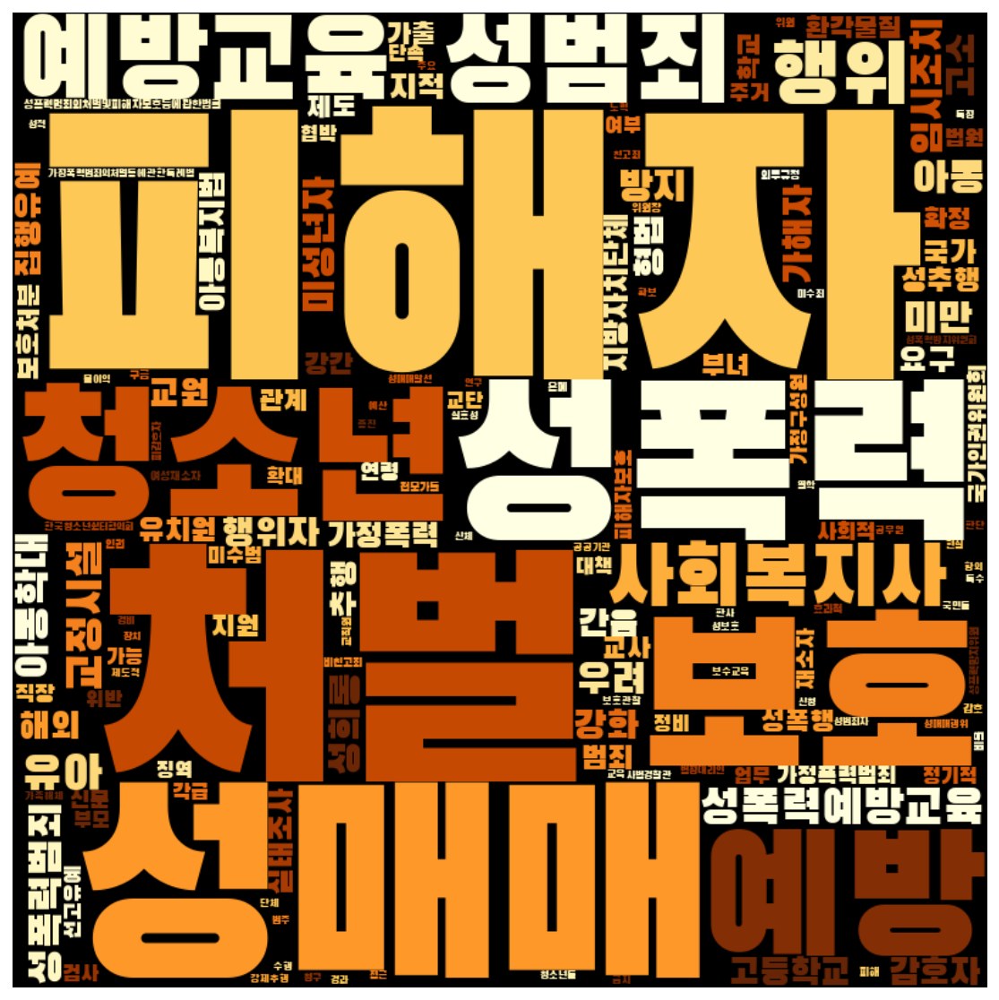

In [112]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

In [109]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 2

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
#women_g3 = women[women['category'] == 2]
#women_g4 = women[women['category'] == 3]
#women_g5 = women[women['category'] == 4]
#women_g6 = women[women['category'] == 5]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
#women_g3_tokens = total_tokens(women_g3['tokens'])
#women_g4_tokens = total_tokens(women_g4['tokens'])
#women_g5_tokens = total_tokens(women_g5['tokens'])
#women_g6_tokens = total_tokens(women_g6['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
#women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
#women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
#women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
#women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

0    62
1    24
Name: category, dtype: int64


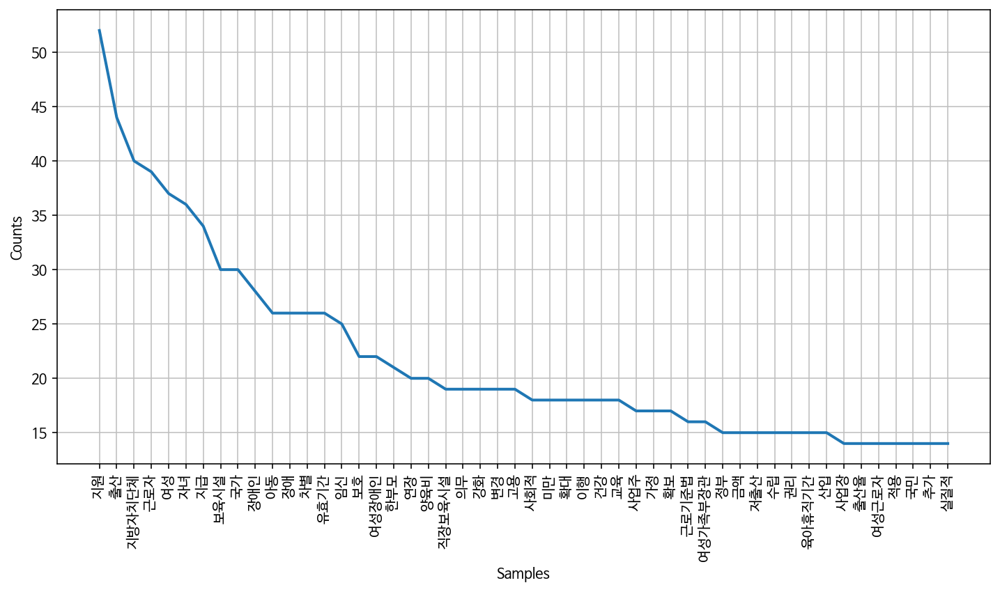

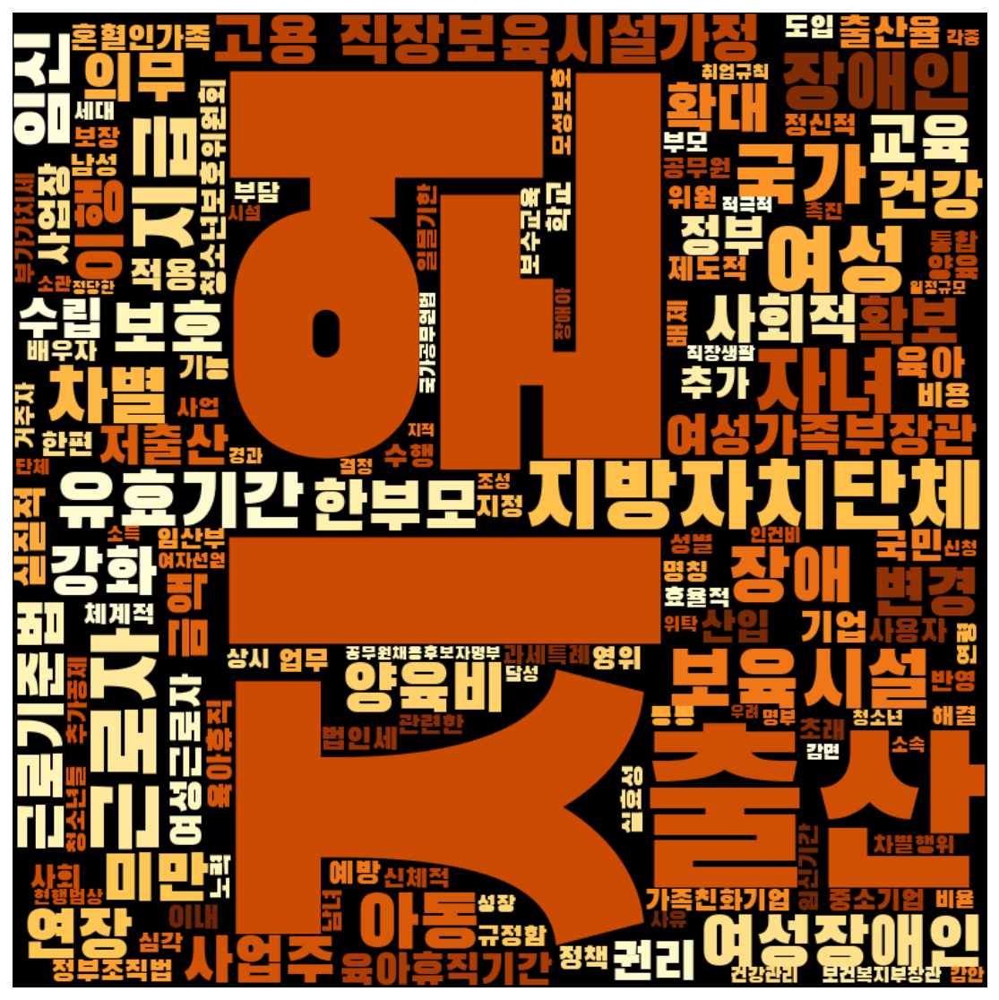

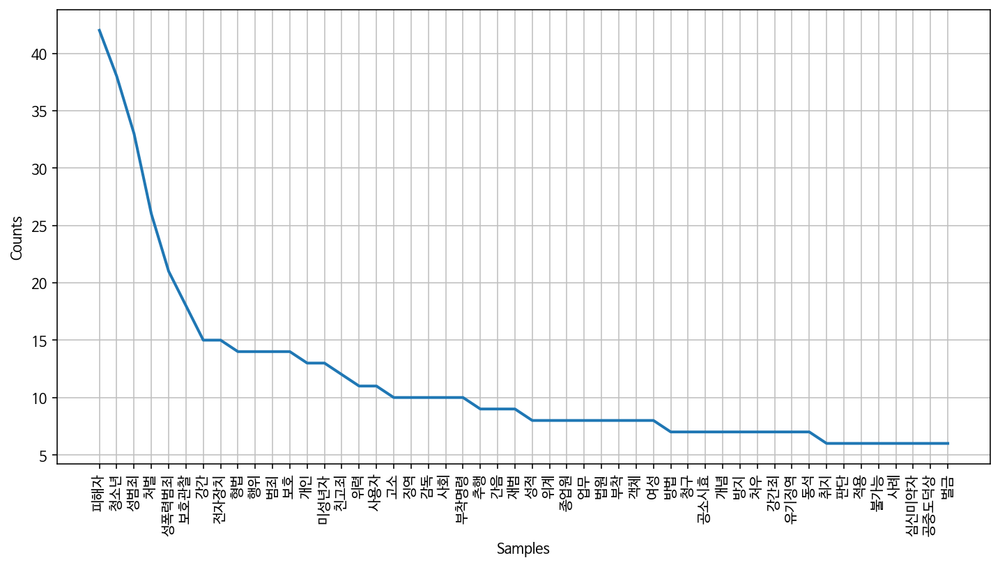

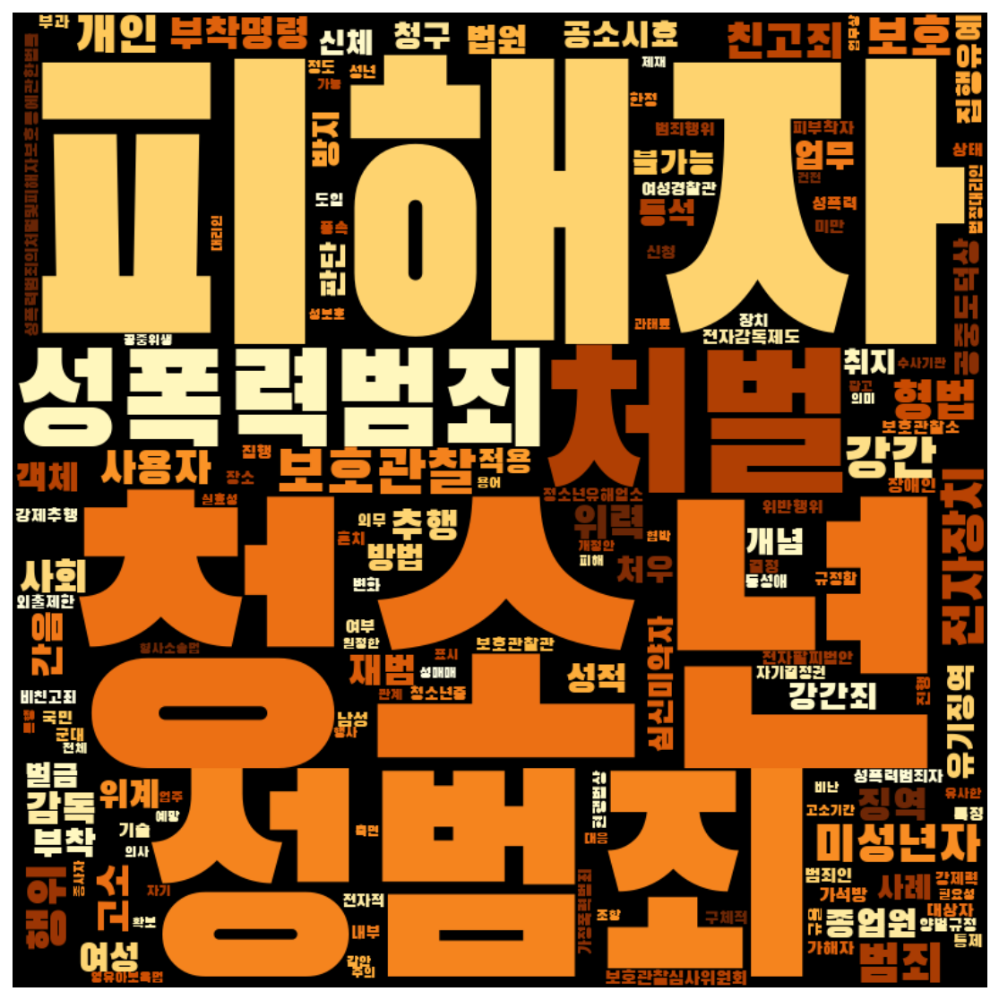

In [113]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrBr')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrBr')

## 이명박 정권
- 2008.02.25 ~ 2013.02.24

In [114]:
leemyungbak = gender[(gender['제안일자'] > datetime.date(2008,2,25)) & 
                        (gender['제안일자'] < datetime.date(2013,2,24))]
leemyungbak.shape

(1131, 19)

In [115]:
leemyungbak['성별'].value_counts()

남성    590
여성    412
Name: 성별, dtype: int64

In [116]:
pd.DataFrame(leemyungbak.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  321
     여성  242
진보   남성  244
     여성  169

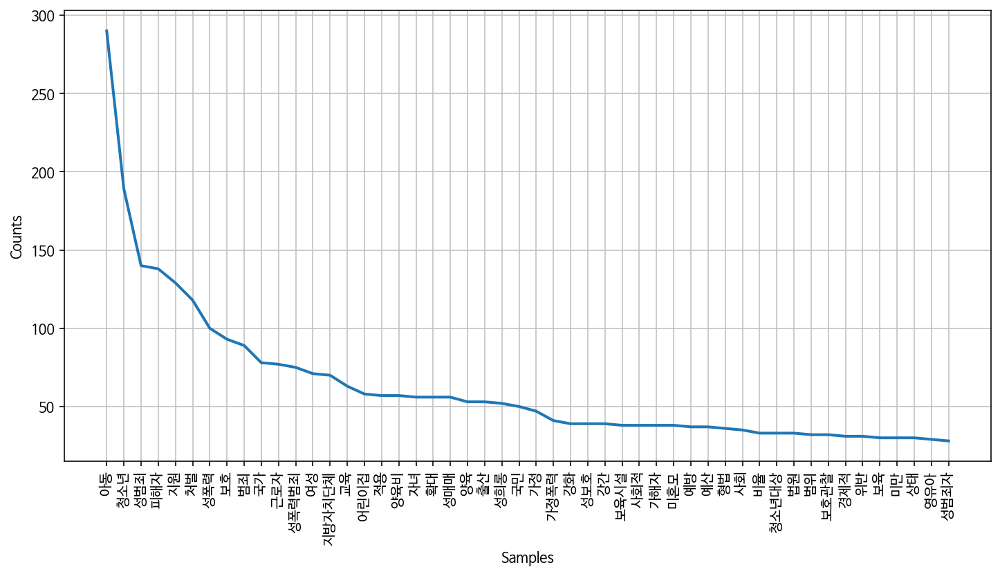

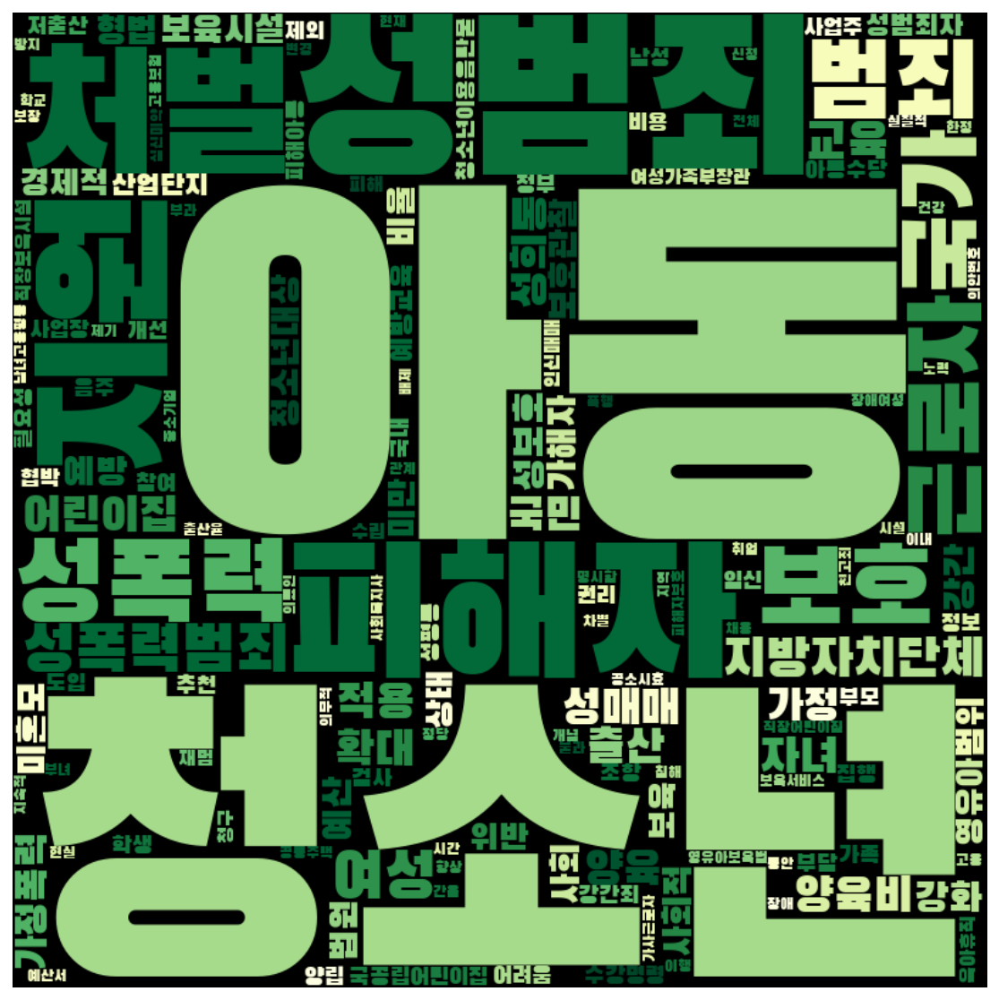

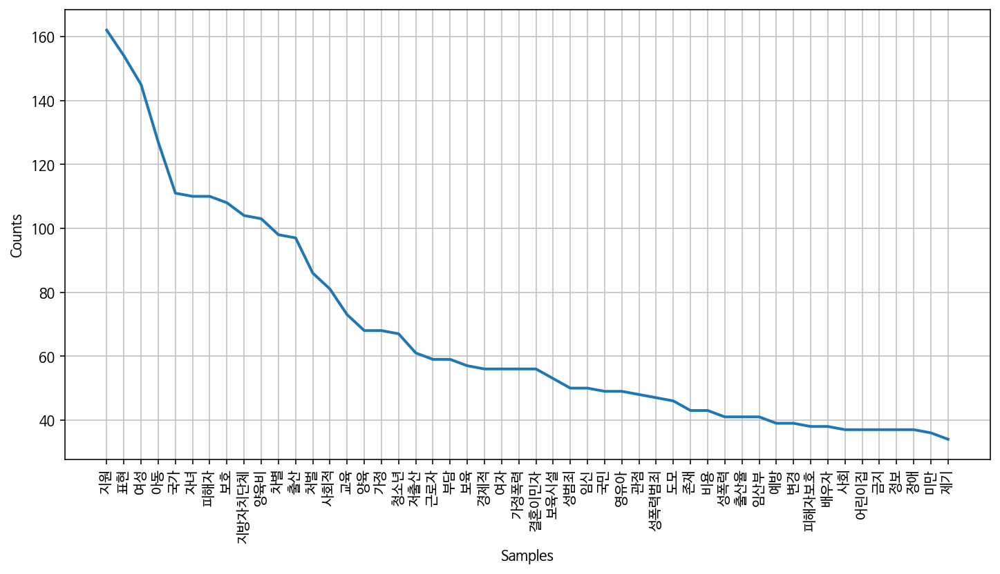

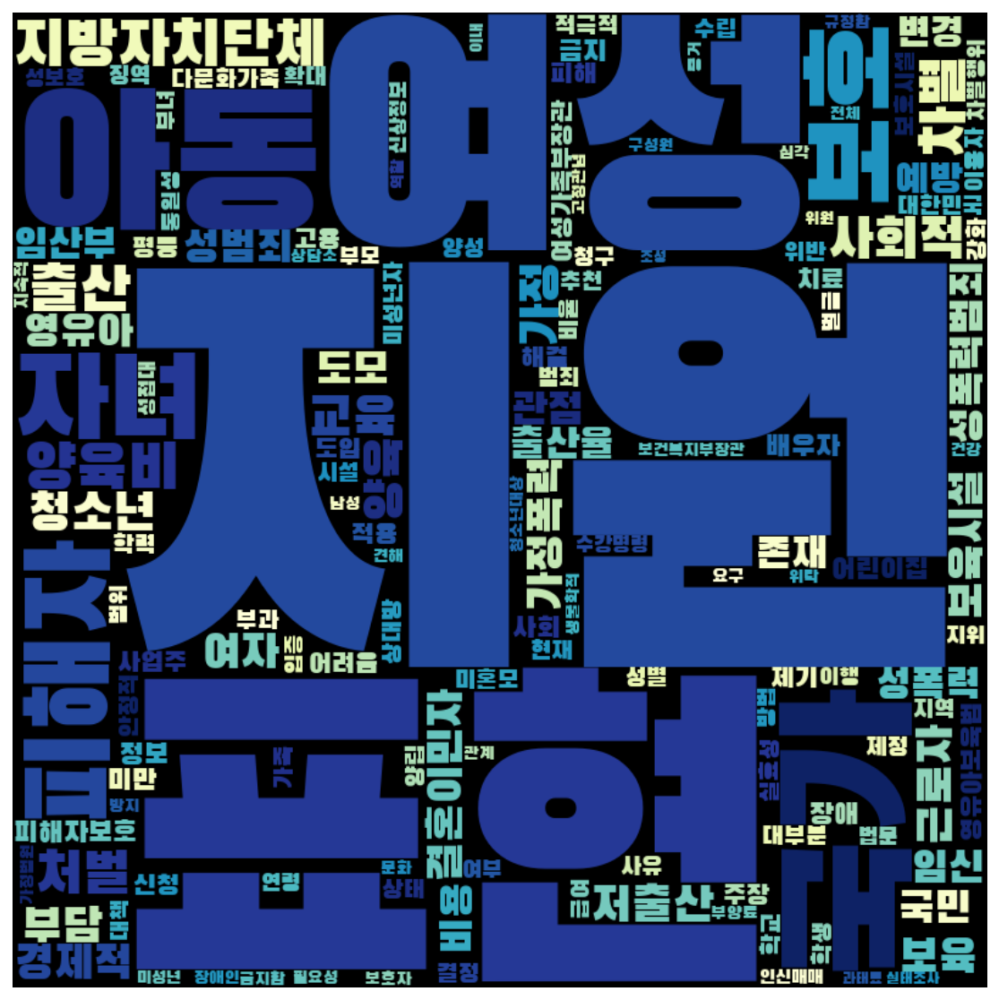

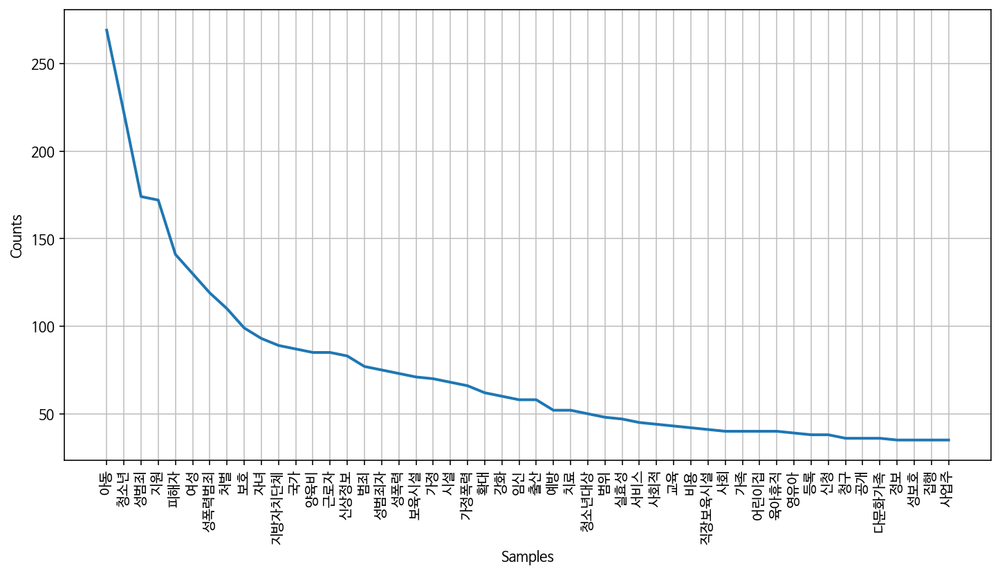

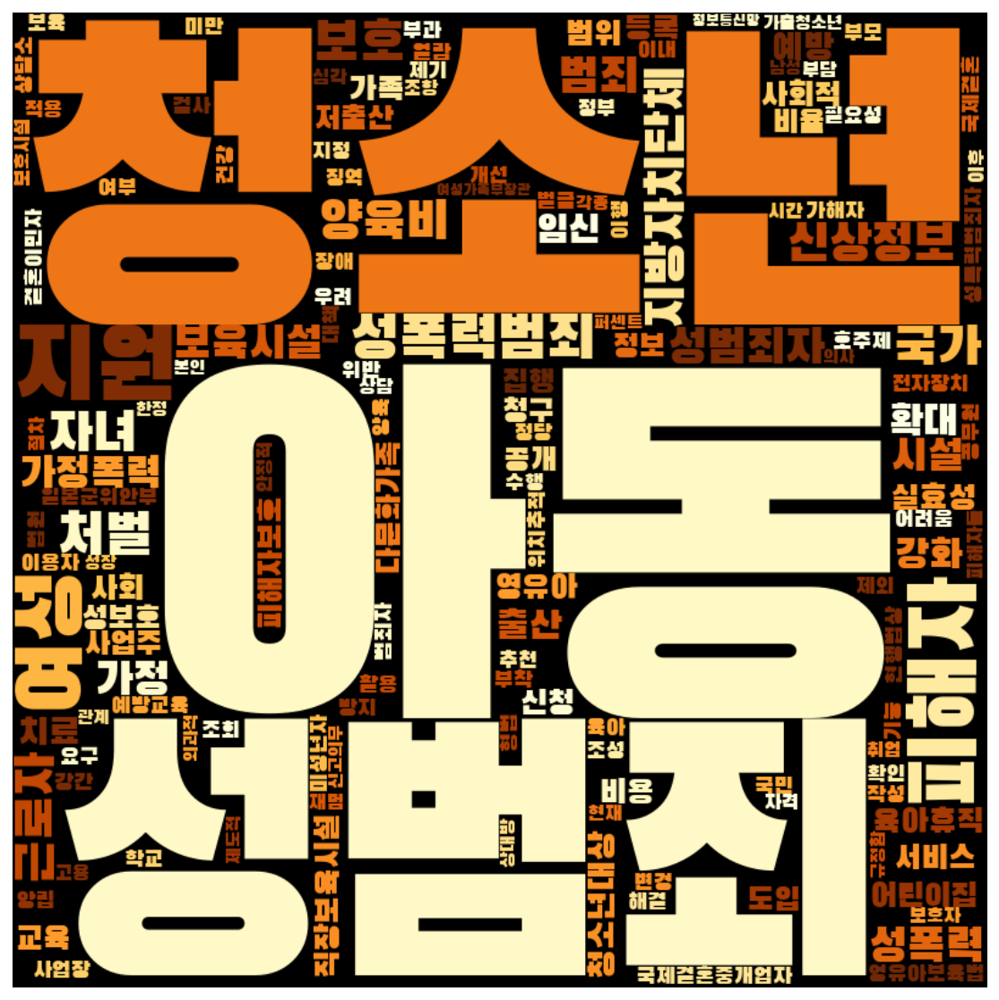

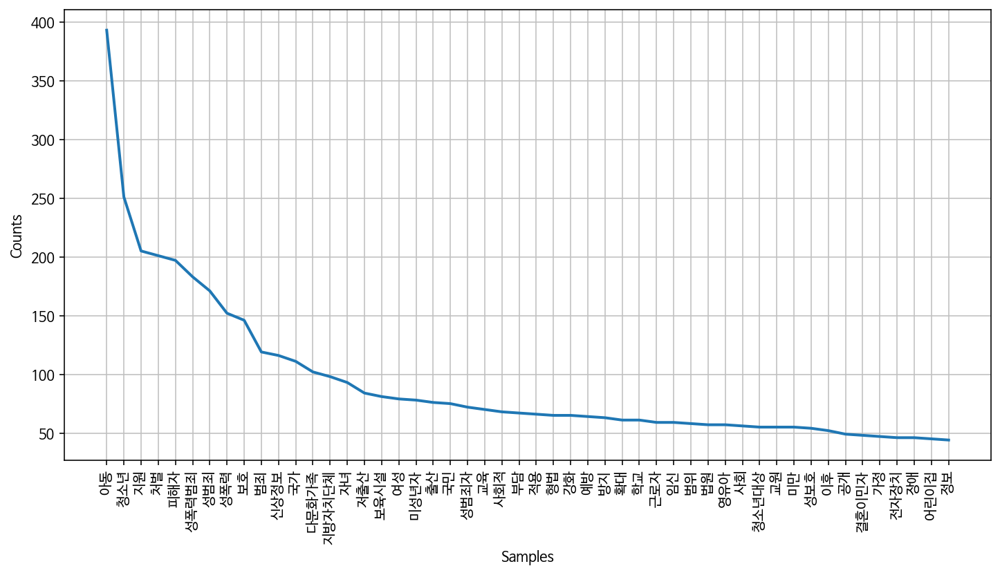

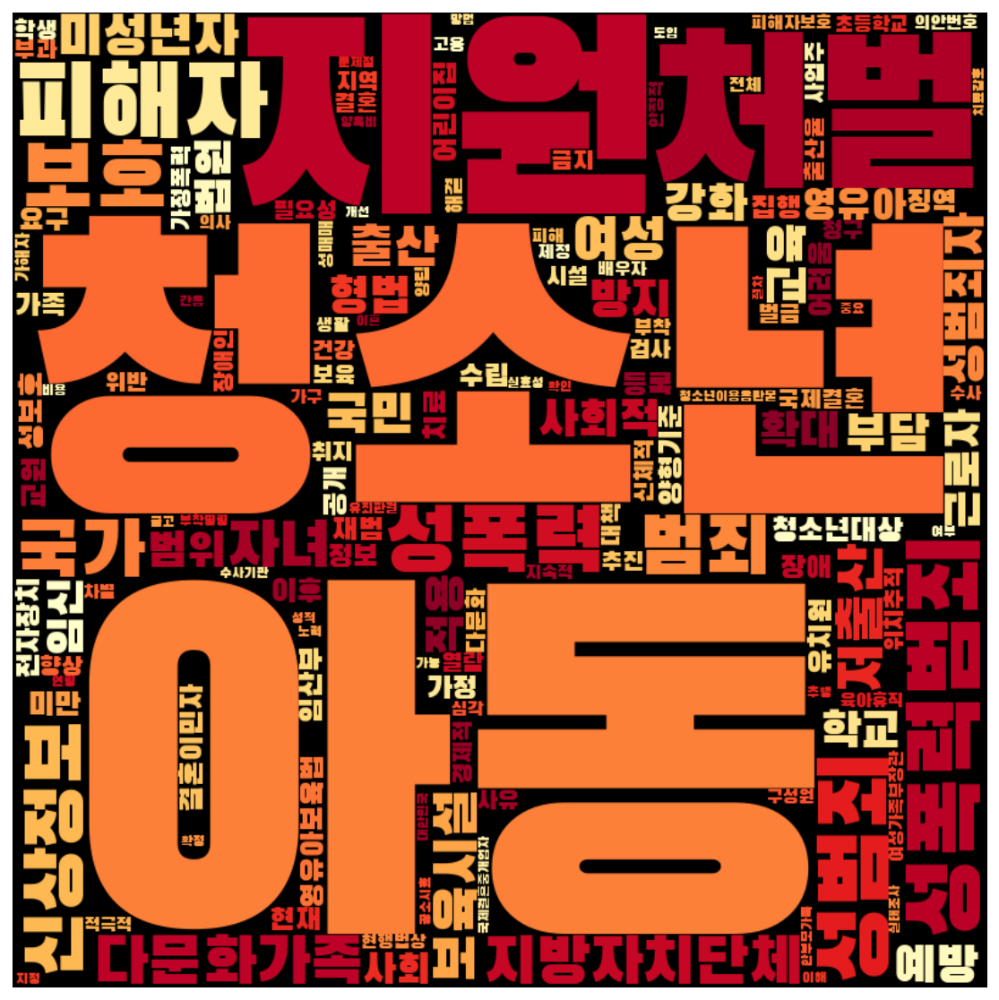

In [117]:
pro_women = leemyungbak[(leemyungbak['성별'] == '여성') & (leemyungbak['정당성향'] == '진보')]
pro_men = leemyungbak[(leemyungbak['성별'] == '남성') & (leemyungbak['정당성향'] == '진보')]
con_women = leemyungbak[(leemyungbak['성별'] == '여성') & (leemyungbak['정당성향'] == '보수')]
con_men = leemyungbak[(leemyungbak['성별'] == '남성') & (leemyungbak['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [118]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 16:14:14,370 : INFO : collecting all words and their counts
2020-10-20 16:14:14,374 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 16:14:14,380 : INFO : collected 3477 word types from a corpus of 14852 raw words and 169 sentences
2020-10-20 16:14:14,383 : INFO : Loading a fresh vocabulary
2020-10-20 16:14:14,388 : INFO : effective_min_count=10 retains 305 unique words (8% of original 3477, drops 3172)
2020-10-20 16:14:14,389 : INFO : effective_min_count=10 leaves 7684 word corpus (51% of original 14852, drops 7168)
2020-10-20 16:14:14,391 : INFO : deleting the raw counts dictionary of 3477 items
2020-10-20 16:14:14,393 : INFO : sample=0.001 downsamples 111 most-common words
2020-10-20 16:14:14,394 : INFO : downsampling leaves estimated 5443 word corpus (70.8% of prior 7684)
2020-10-20 16:14:14,397 : INFO : estimated required memory for 305 words and 100 dimensions: 396500 bytes
2020-10-20 16:14:14,398 : INFO : resetting layer weights
20

2020-10-20 16:14:15,059 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:15,069 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:15,072 : INFO : EPOCH - 15 : training on 14852 raw words (5460 effective words) took 0.0s, 190902 effective words/s
2020-10-20 16:14:15,083 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:15,084 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:15,099 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:15,109 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:15,110 : INFO : EPOCH - 16 : training on 14852 raw words (5416 effective words) took 0.0s, 166888 effective words/s
2020-10-20 16:14:15,115 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:15,121 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:15,681 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:15,691 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:15,703 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:15,709 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:15,710 : INFO : EPOCH - 32 : training on 14852 raw words (5428 effective words) took 0.0s, 175750 effective words/s
2020-10-20 16:14:15,717 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:15,721 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:15,738 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:15,748 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:15,749 : INFO : EPOCH - 33 : training on 14852 raw words (5441 effective words) took 0.0s, 154403 effective words/s
2020-1

2020-10-20 16:14:16,288 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:16,289 : INFO : EPOCH - 48 : training on 14852 raw words (5440 effective words) took 0.0s, 203872 effective words/s
2020-10-20 16:14:16,297 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:16,302 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:16,318 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:16,327 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:16,327 : INFO : EPOCH - 49 : training on 14852 raw words (5476 effective words) took 0.0s, 178994 effective words/s
2020-10-20 16:14:16,334 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:16,342 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:16,358 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-20 16:14:16,909 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:16,924 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:16,931 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:16,931 : INFO : EPOCH - 65 : training on 14852 raw words (5457 effective words) took 0.0s, 175474 effective words/s
2020-10-20 16:14:16,937 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:16,942 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:16,954 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:16,967 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:16,972 : INFO : EPOCH - 66 : training on 14852 raw words (5485 effective words) took 0.0s, 153094 effective words/s
2020-10-20 16:14:16,979 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-20 16:14:17,505 : INFO : EPOCH - 81 : training on 14852 raw words (5421 effective words) took 0.0s, 176222 effective words/s
2020-10-20 16:14:17,515 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:17,517 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:17,532 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:17,539 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:17,540 : INFO : EPOCH - 82 : training on 14852 raw words (5423 effective words) took 0.0s, 189881 effective words/s
2020-10-20 16:14:17,546 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:17,550 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:17,565 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:17,573 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-20 16:14:18,105 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:18,114 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:18,114 : INFO : EPOCH - 98 : training on 14852 raw words (5427 effective words) took 0.0s, 183244 effective words/s
2020-10-20 16:14:18,127 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:18,134 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:18,143 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:18,152 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:18,153 : INFO : EPOCH - 99 : training on 14852 raw words (5456 effective words) took 0.0s, 188818 effective words/s
2020-10-20 16:14:18,161 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:18,169 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:18,898 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:18,903 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:18,904 : INFO : EPOCH - 12 : training on 18310 raw words (7160 effective words) took 0.0s, 179127 effective words/s
2020-10-20 16:14:18,915 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:18,921 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:18,944 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:18,949 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:18,950 : INFO : EPOCH - 13 : training on 18310 raw words (7183 effective words) took 0.0s, 193343 effective words/s
2020-10-20 16:14:18,964 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:18,966 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:19,636 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:19,644 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:19,666 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:19,672 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:19,673 : INFO : EPOCH - 29 : training on 18310 raw words (7211 effective words) took 0.0s, 165422 effective words/s
2020-10-20 16:14:19,682 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:19,684 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:19,711 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:19,717 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:19,718 : INFO : EPOCH - 30 : training on 18310 raw words (7223 effective words) took 0.0s, 180853 effective words/s
2020-1

2020-10-20 16:14:20,402 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:20,404 : INFO : EPOCH - 45 : training on 18310 raw words (7193 effective words) took 0.0s, 178919 effective words/s
2020-10-20 16:14:20,412 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:20,417 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:20,444 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:20,447 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:20,449 : INFO : EPOCH - 46 : training on 18310 raw words (7166 effective words) took 0.0s, 174966 effective words/s
2020-10-20 16:14:20,456 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:20,463 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:20,490 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-20 16:14:21,077 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:21,097 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:21,098 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:21,099 : INFO : EPOCH - 62 : training on 18310 raw words (7211 effective words) took 0.0s, 202247 effective words/s
2020-10-20 16:14:21,110 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:21,112 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:21,137 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:21,138 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:21,141 : INFO : EPOCH - 63 : training on 18310 raw words (7255 effective words) took 0.0s, 188656 effective words/s
2020-10-20 16:14:21,149 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-20 16:14:21,777 : INFO : EPOCH - 78 : training on 18310 raw words (7186 effective words) took 0.0s, 218779 effective words/s
2020-10-20 16:14:21,782 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:21,787 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:21,812 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:21,813 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:21,815 : INFO : EPOCH - 79 : training on 18310 raw words (7196 effective words) took 0.0s, 204704 effective words/s
2020-10-20 16:14:21,820 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:21,824 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:21,850 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:21,855 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-20 16:14:22,483 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:22,485 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:22,486 : INFO : EPOCH - 95 : training on 18310 raw words (7215 effective words) took 0.0s, 227789 effective words/s
2020-10-20 16:14:22,493 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:22,497 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:22,521 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:22,527 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:22,528 : INFO : EPOCH - 96 : training on 18310 raw words (7172 effective words) took 0.0s, 189862 effective words/s
2020-10-20 16:14:22,536 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:22,537 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:23,323 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:23,325 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:23,328 : INFO : EPOCH - 9 : training on 19764 raw words (8061 effective words) took 0.0s, 177674 effective words/s
2020-10-20 16:14:23,336 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:23,342 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:23,370 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:23,374 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:23,378 : INFO : EPOCH - 10 : training on 19764 raw words (7938 effective words) took 0.0s, 170526 effective words/s
2020-10-20 16:14:23,386 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:23,391 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10

2020-10-20 16:14:24,149 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:24,153 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:24,182 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:24,188 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:24,190 : INFO : EPOCH - 26 : training on 19764 raw words (8034 effective words) took 0.0s, 181664 effective words/s
2020-10-20 16:14:24,196 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:24,200 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:24,230 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:24,232 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:24,234 : INFO : EPOCH - 27 : training on 19764 raw words (8052 effective words) took 0.0s, 198343 effective words/s
2020-1

2020-10-20 16:14:24,962 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:24,965 : INFO : EPOCH - 42 : training on 19764 raw words (8039 effective words) took 0.0s, 166515 effective words/s
2020-10-20 16:14:24,972 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:24,980 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:25,007 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:25,011 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:25,013 : INFO : EPOCH - 43 : training on 19764 raw words (8002 effective words) took 0.0s, 193008 effective words/s
2020-10-20 16:14:25,022 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:25,031 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:25,057 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-20 16:14:25,751 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:25,779 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:25,782 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:25,786 : INFO : EPOCH - 59 : training on 19764 raw words (8082 effective words) took 0.0s, 170785 effective words/s
2020-10-20 16:14:25,804 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:25,808 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:25,840 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:25,840 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:25,841 : INFO : EPOCH - 60 : training on 19764 raw words (8023 effective words) took 0.0s, 181704 effective words/s
2020-10-20 16:14:25,848 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-20 16:14:26,587 : INFO : EPOCH - 75 : training on 19764 raw words (8002 effective words) took 0.0s, 190713 effective words/s
2020-10-20 16:14:26,597 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:26,604 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:26,634 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:26,637 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:26,639 : INFO : EPOCH - 76 : training on 19764 raw words (7984 effective words) took 0.0s, 181832 effective words/s
2020-10-20 16:14:26,652 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:26,654 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:26,683 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:26,684 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-20 16:14:27,397 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:27,407 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:27,407 : INFO : EPOCH - 92 : training on 19764 raw words (8020 effective words) took 0.0s, 185155 effective words/s
2020-10-20 16:14:27,422 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:27,424 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:27,448 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:27,455 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:27,456 : INFO : EPOCH - 93 : training on 19764 raw words (8023 effective words) took 0.0s, 179850 effective words/s
2020-10-20 16:14:27,469 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:27,474 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:28,432 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:28,433 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:28,434 : INFO : EPOCH - 6 : training on 24938 raw words (11744 effective words) took 0.0s, 253423 effective words/s
2020-10-20 16:14:28,444 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:28,474 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:28,489 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:28,492 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:28,492 : INFO : EPOCH - 7 : training on 24938 raw words (11797 effective words) took 0.0s, 238509 effective words/s
2020-10-20 16:14:28,498 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:28,527 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-20 16:14:29,384 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:29,416 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:29,427 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:29,432 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:29,433 : INFO : EPOCH - 23 : training on 24938 raw words (11826 effective words) took 0.1s, 225793 effective words/s
2020-10-20 16:14:29,440 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:29,470 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:29,484 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:29,489 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:29,489 : INFO : EPOCH - 24 : training on 24938 raw words (11759 effective words) took 0.0s, 241190 effective words/s
2020

2020-10-20 16:14:30,361 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:30,362 : INFO : EPOCH - 39 : training on 24938 raw words (11724 effective words) took 0.1s, 217849 effective words/s
2020-10-20 16:14:30,368 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:30,405 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:30,415 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:30,421 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:30,422 : INFO : EPOCH - 40 : training on 24938 raw words (11798 effective words) took 0.1s, 204585 effective words/s
2020-10-20 16:14:30,429 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:30,465 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:30,481 : INFO : worker thread finished; awaiting finish of 1 more threads
2020

2020-10-20 16:14:31,350 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:31,382 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:31,401 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:31,403 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:31,405 : INFO : EPOCH - 56 : training on 24938 raw words (11789 effective words) took 0.1s, 204389 effective words/s
2020-10-20 16:14:31,415 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:31,451 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:31,462 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:31,466 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:31,467 : INFO : EPOCH - 57 : training on 24938 raw words (11856 effective words) took 0.1s, 210092 effective words/s
2020

2020-10-20 16:14:32,441 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:32,442 : INFO : EPOCH - 72 : training on 24938 raw words (11764 effective words) took 0.1s, 226761 effective words/s
2020-10-20 16:14:32,450 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:32,480 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:32,500 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:32,502 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:32,504 : INFO : EPOCH - 73 : training on 24938 raw words (11812 effective words) took 0.1s, 220467 effective words/s
2020-10-20 16:14:32,518 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:32,546 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:32,558 : INFO : worker thread finished; awaiting finish of 1 more threads
2020

2020-10-20 16:14:33,426 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:33,458 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:33,466 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:33,471 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:33,472 : INFO : EPOCH - 89 : training on 24938 raw words (11792 effective words) took 0.0s, 248084 effective words/s
2020-10-20 16:14:33,476 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 16:14:33,504 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 16:14:33,515 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 16:14:33,516 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 16:14:33,517 : INFO : EPOCH - 90 : training on 24938 raw words (11752 effective words) took 0.0s, 273611 effective words/s
2020

In [119]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-20 16:15:41,746 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:15:41,750 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:15:41,753 : INFO : precomputing L2-norms of word weight vectors
2020-10-20 16:15:41,755 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('추천', 0.36456480622291565), ('육아휴직', 0.3462943434715271), ('정책', 0.3371275067329407), ('정부', 0.3349493145942688), ('제도', 0.3343423008918762), ('가사사용인', 0.32038596272468567), ('정당', 0.3128705620765686), ('추진', 0.304882287979126), ('기금', 0.3047701120376587), ('후보자', 0.30204612016677856)]
진보 남성: [('관념', 0.4800448715686798), ('여성비하적', 0.4500962495803833), ('고정관념', 0.4457741379737854), ('관점', 0.434245765209198), ('남성', 0.43338635563850403), ('우리나라', 0.42422154545783997), ('내포', 0.4226039946079254), ('역할', 0.4142622947692871), ('표현', 0.41352468729019165), ('견해', 0.408998042345047)]
보수 여성: [('남성', 0.42520445585250854), ('출산', 0.417283833026886), ('모자보건법', 0.403844952583313), ('저출산', 0.39981889724731445), ('여성조합원', 0.3938458561897278), ('임원', 0.3926484286785126), ('비율', 0.3764859735965729), ('추천', 0.3621605634689331), ('여성근로자', 0.3538393974304199), ('임신', 0.35023435950279236)]
보수 남성: [('보호휴가', 0.42043161392211914), ('세계', 0.38480889797210693), ('산후', 0.381674200296402), ('유산', 0.37042

In [121]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-121-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-121-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-121-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

In [124]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [125]:
pro_women['category'].value_counts()

0    76
2    69
1    24
Name: category, dtype: int64

In [127]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
pro_women_g3 = pro_women[pro_women['category'] == 2]

pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
pro_women_g3_tokens = total_tokens(pro_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
pro_women_g3_tokens = [each_word for each_word in pro_women_g3_tokens if each_word not in stopwords]

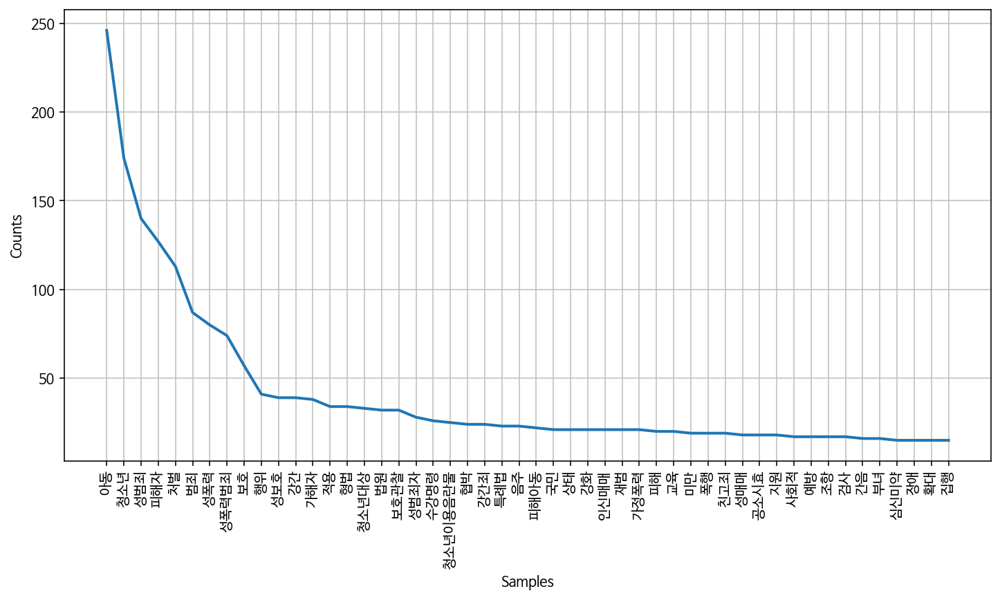

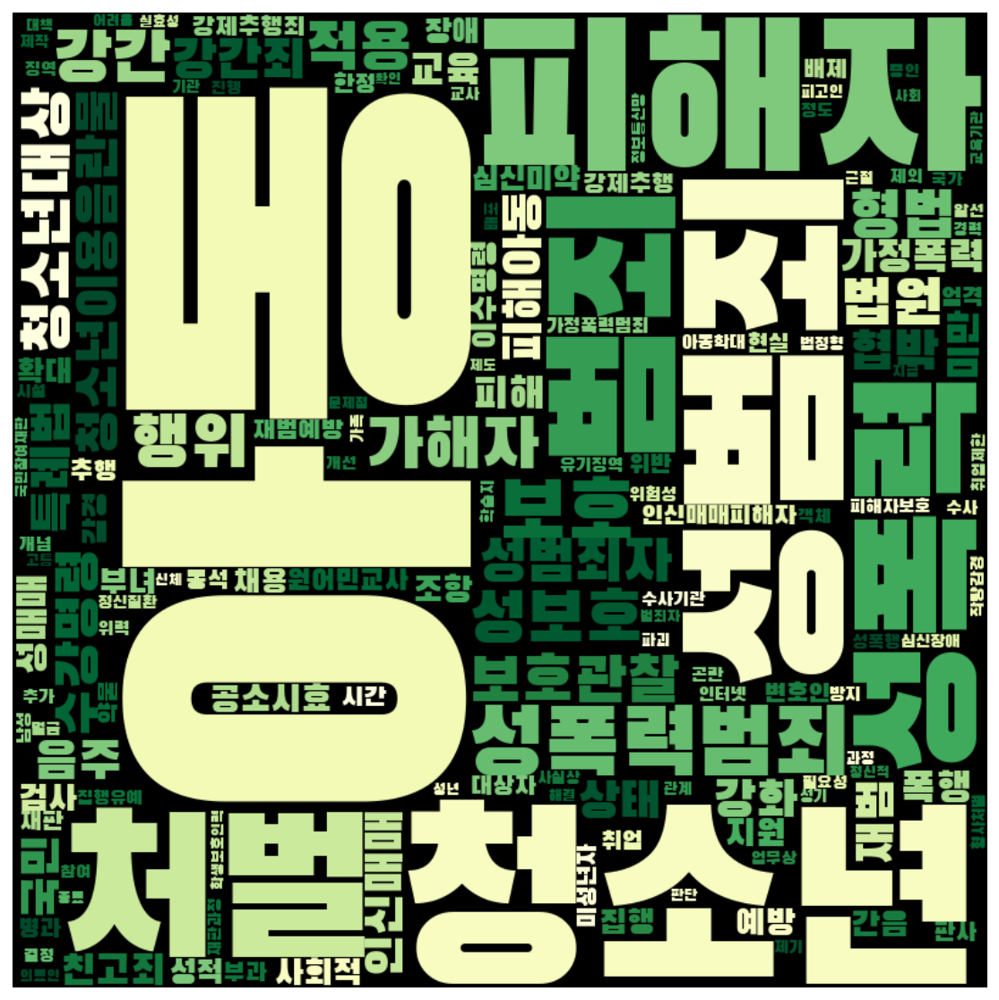

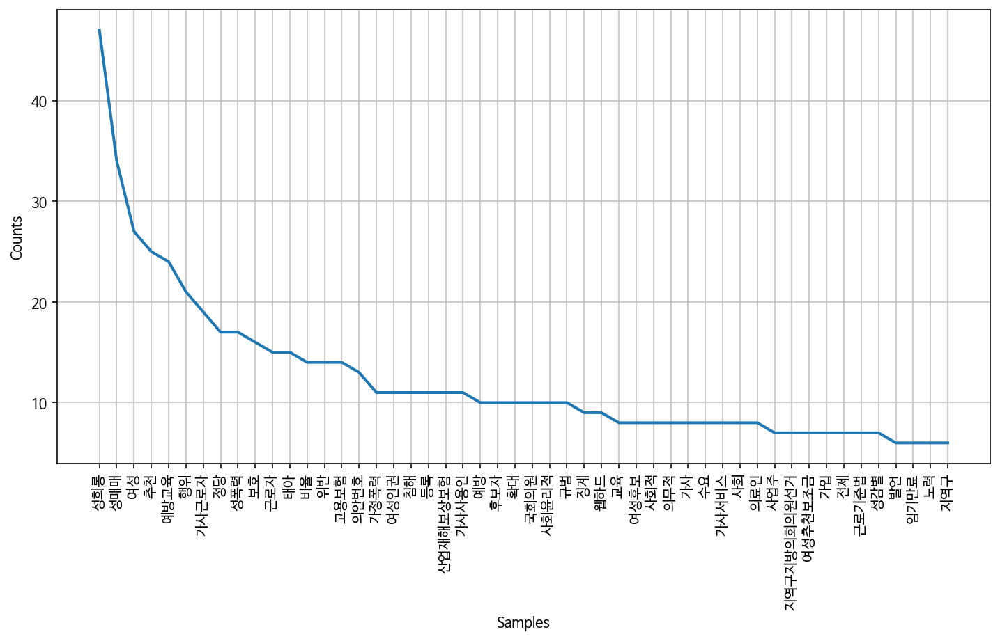

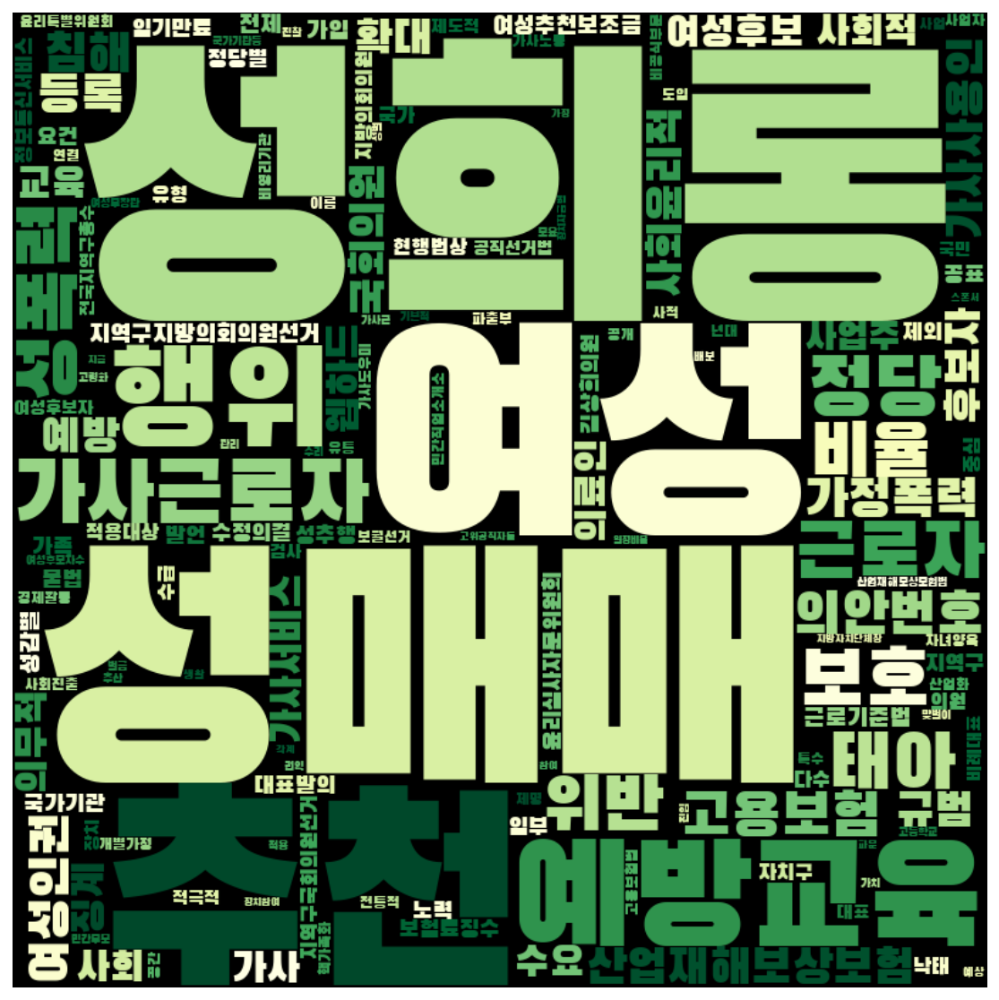

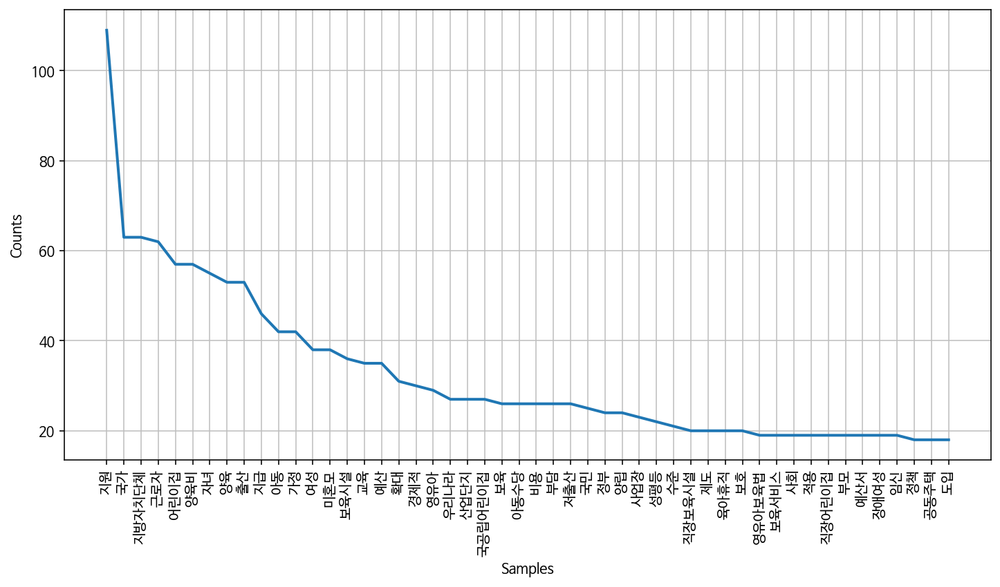

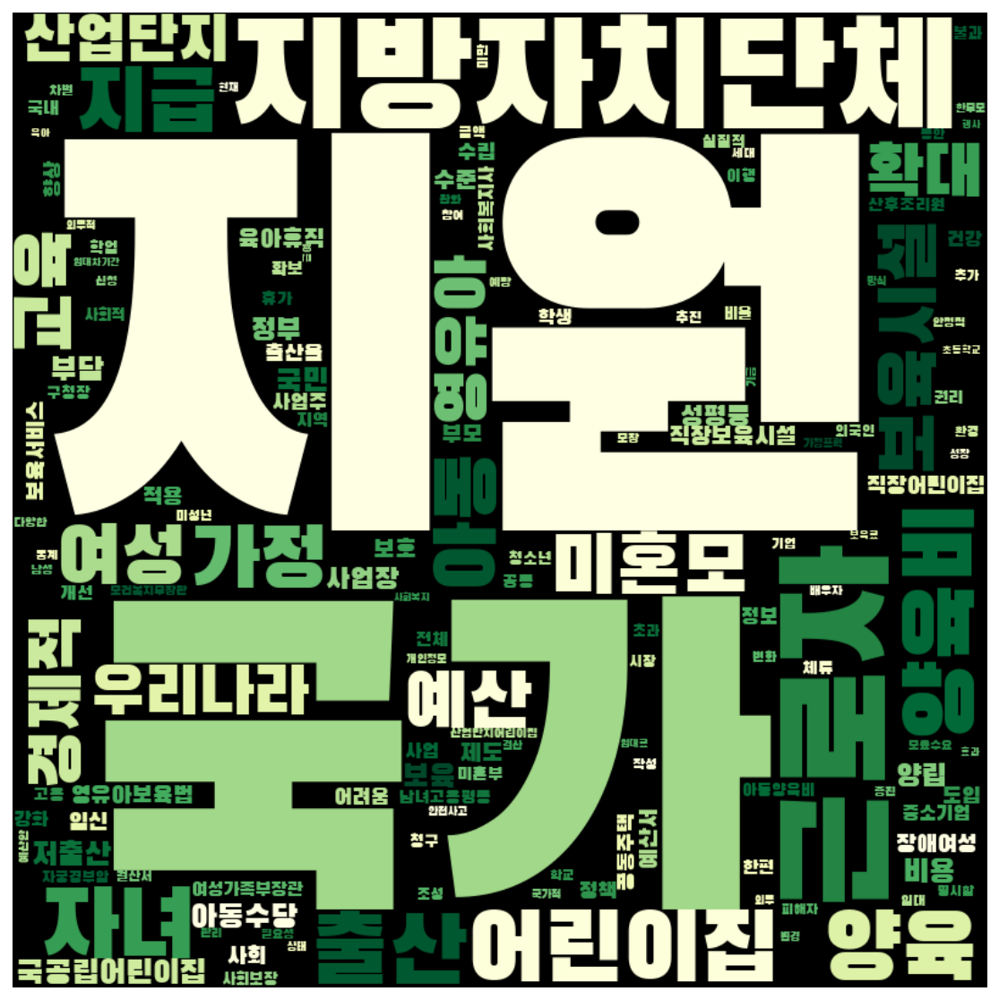

In [128]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens,'YlGn')

frewords_vis(pro_women_g3_tokens)
wordcloud_vis(pro_women_g3_tokens,'YlGn')

In [129]:
pro_men = pro_men[pro_men['명사수'] > 1]

# K means 수행 
word_vectors_pro_men = pro_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_men)
pro_men['category'] = idx

print(pro_men['category'].value_counts())

pro_men_g1 = pro_men[pro_men['category'] == 0]
pro_men_g2 = pro_men[pro_men['category'] == 1]
pro_men_g3 = pro_men[pro_men['category'] == 2]

pro_men_g1_tokens = total_tokens(pro_men_g1['tokens'])
pro_men_g2_tokens = total_tokens(pro_men_g2['tokens'])
pro_men_g3_tokens = total_tokens(pro_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_men_g1_tokens = [each_word for each_word in pro_men_g1_tokens if each_word not in stopwords]
pro_men_g2_tokens = [each_word for each_word in pro_men_g2_tokens if each_word not in stopwords]
pro_men_g3_tokens = [each_word for each_word in pro_men_g3_tokens if each_word not in stopwords]

1    153
0     63
2     28
Name: category, dtype: int64


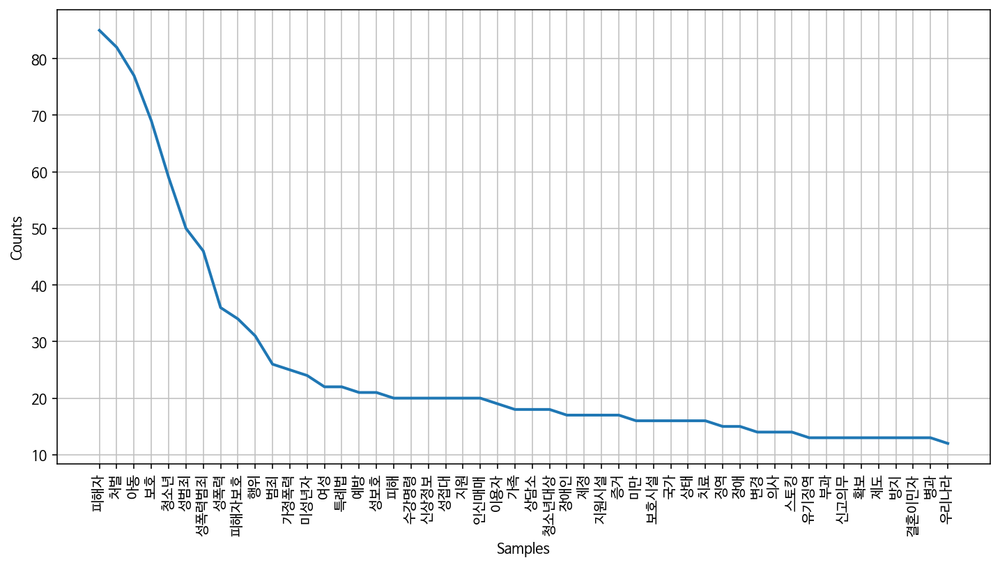

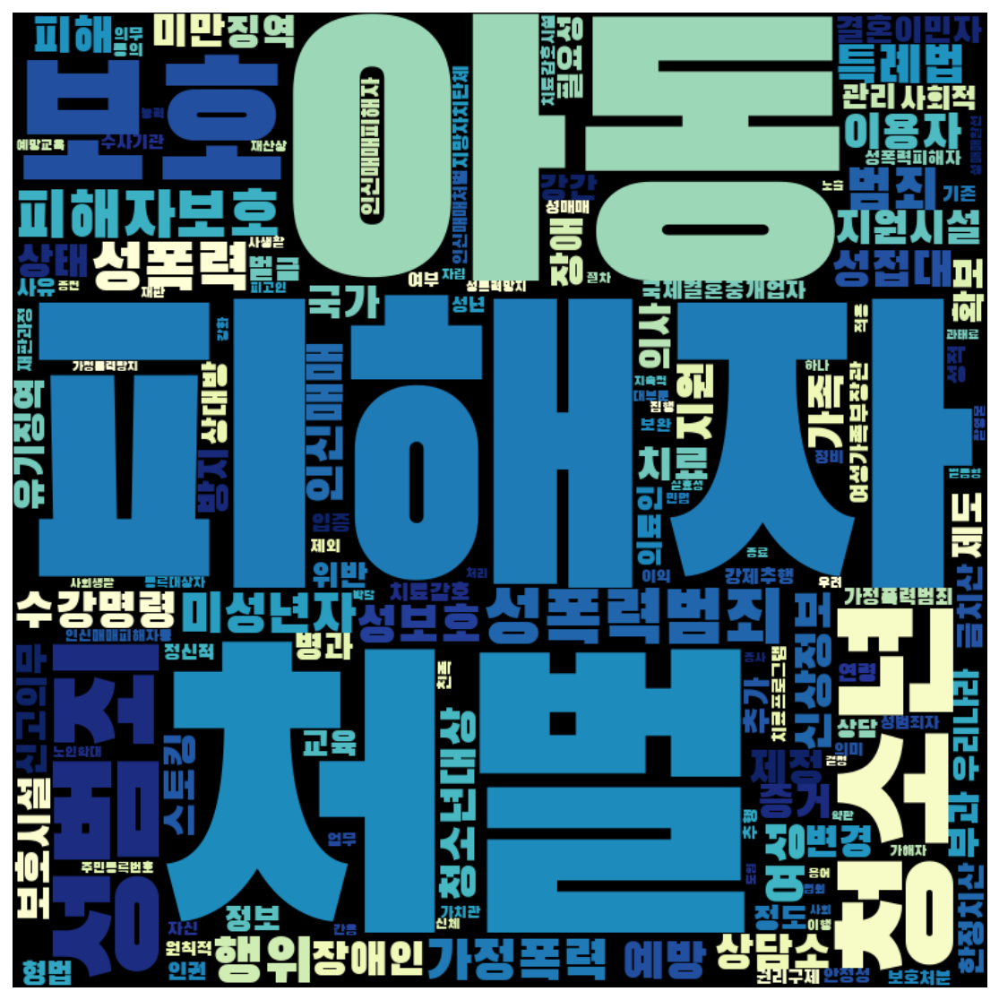

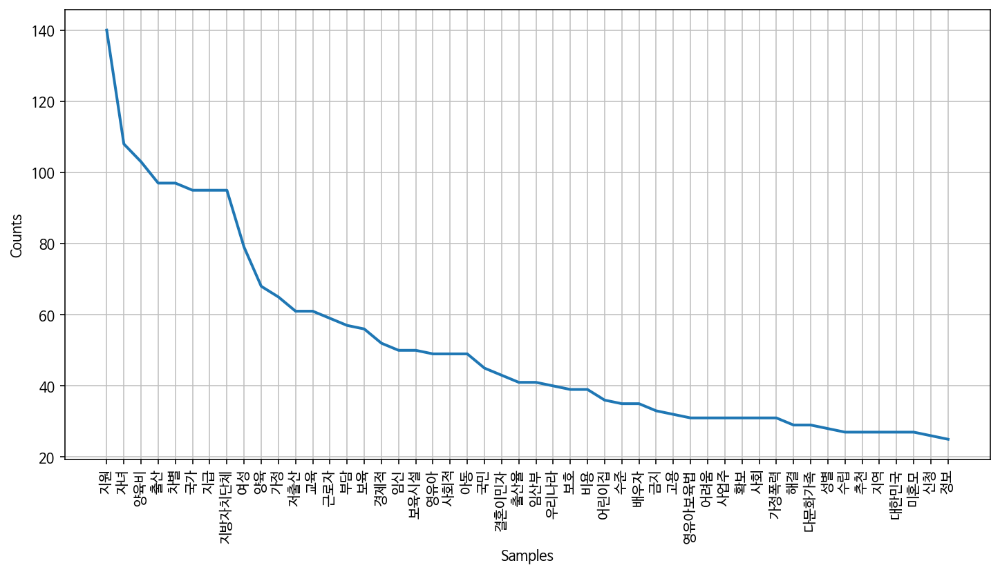

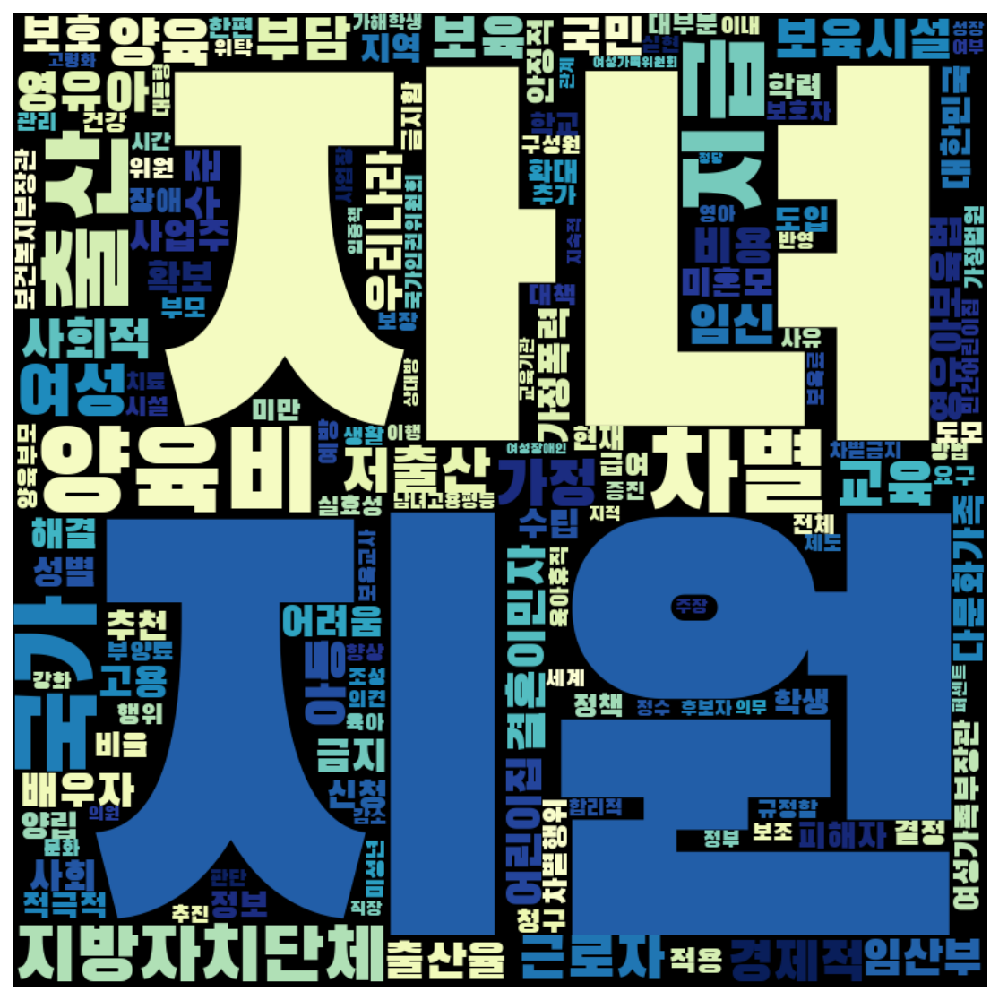

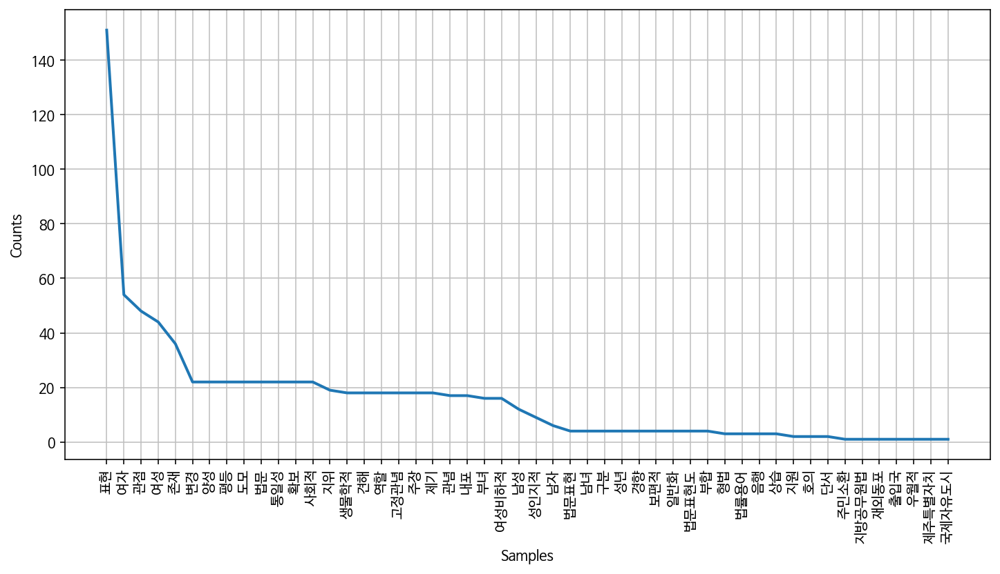

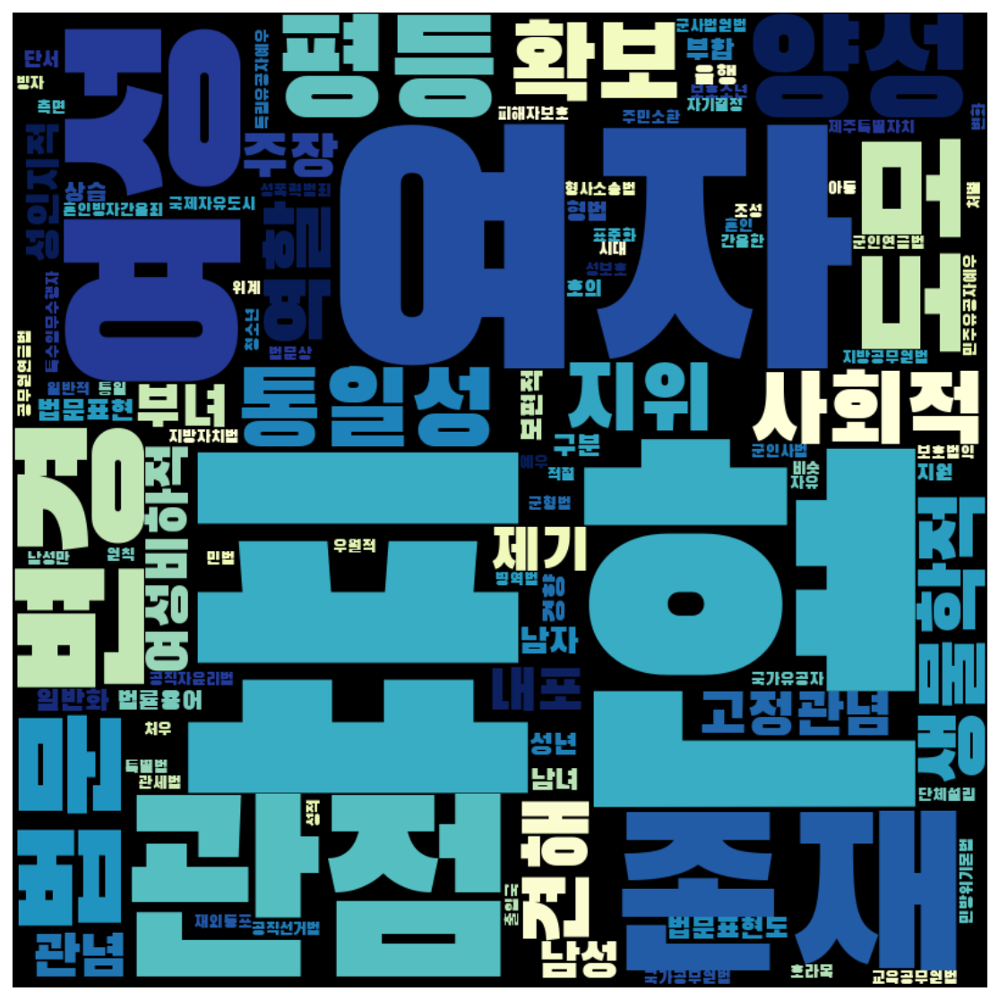

In [130]:
frewords_vis(pro_men_g1_tokens)
wordcloud_vis(pro_men_g1_tokens, 'YlGnBu')

frewords_vis(pro_men_g2_tokens)
wordcloud_vis(pro_men_g2_tokens, 'YlGnBu')

frewords_vis(pro_men_g3_tokens)
wordcloud_vis(pro_men_g3_tokens, 'YlGnBu')

In [131]:
con_women = con_women[con_women['명사수'] > 1]

# K means 수행 
word_vectors_con_women = con_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_women)
con_women['category'] = idx

print(con_women['category'].value_counts())

con_women_g1 = con_women[con_women['category'] == 0]
con_women_g2 = con_women[con_women['category'] == 1]
con_women_g3 = con_women[con_women['category'] == 2]

con_women_g1_tokens = total_tokens(con_women_g1['tokens'])
con_women_g2_tokens = total_tokens(con_women_g2['tokens'])
con_women_g3_tokens = total_tokens(con_women_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_women_g1_tokens = [each_word for each_word in con_women_g1_tokens if each_word not in stopwords]
con_women_g2_tokens = [each_word for each_word in con_women_g2_tokens if each_word not in stopwords]
con_women_g3_tokens = [each_word for each_word in con_women_g3_tokens if each_word not in stopwords]

0    121
1    108
2     13
Name: category, dtype: int64


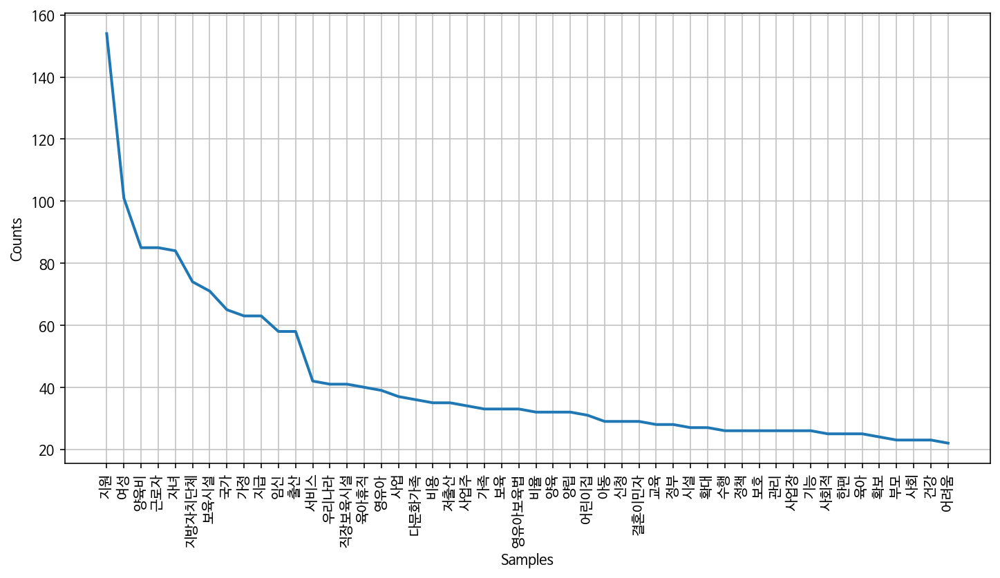

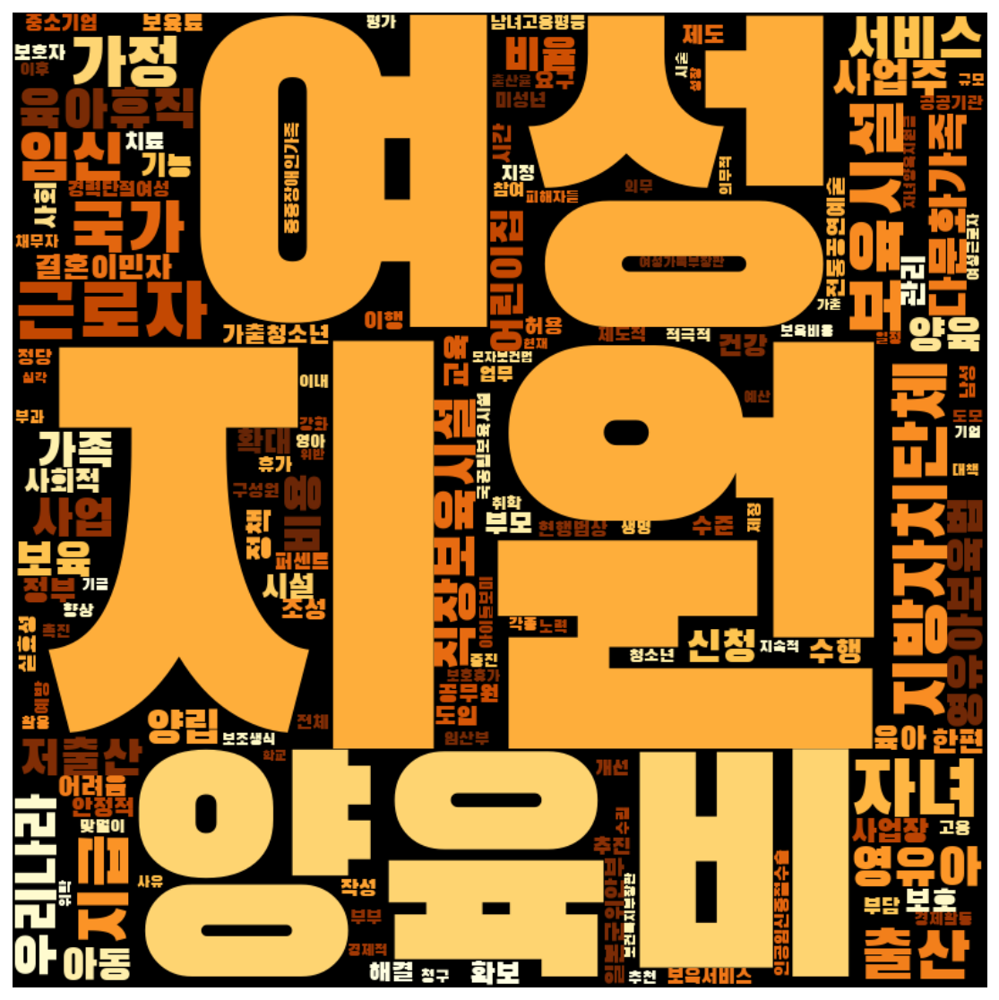

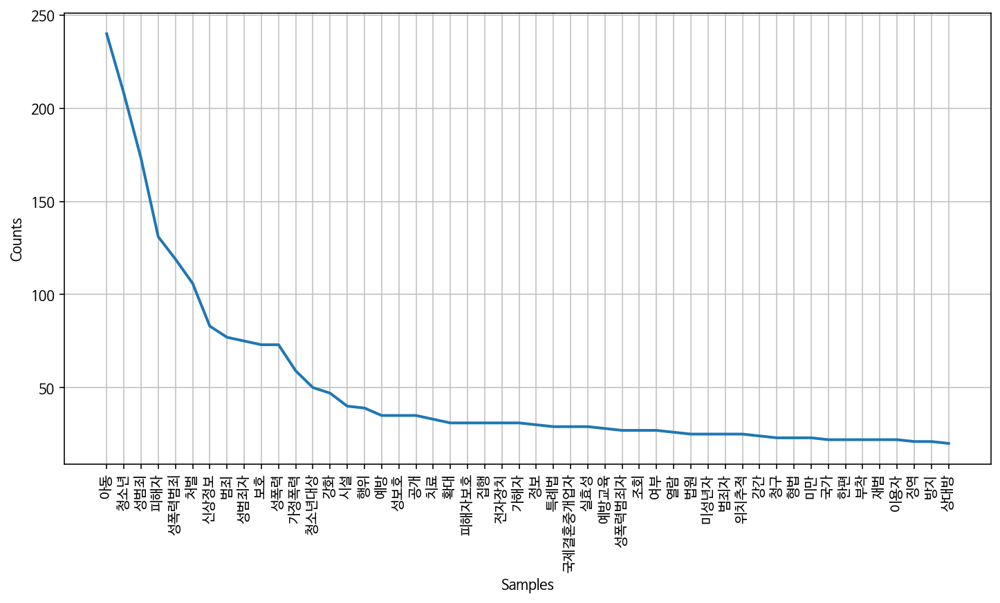

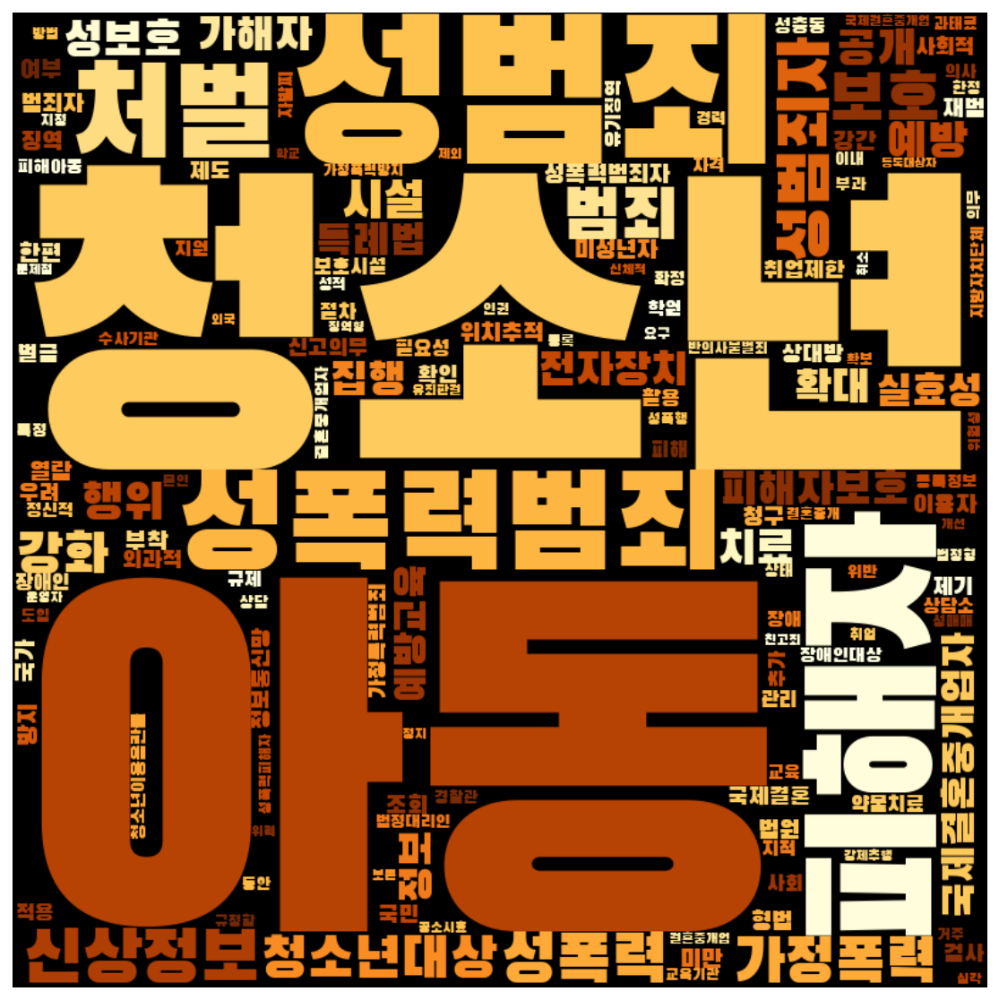

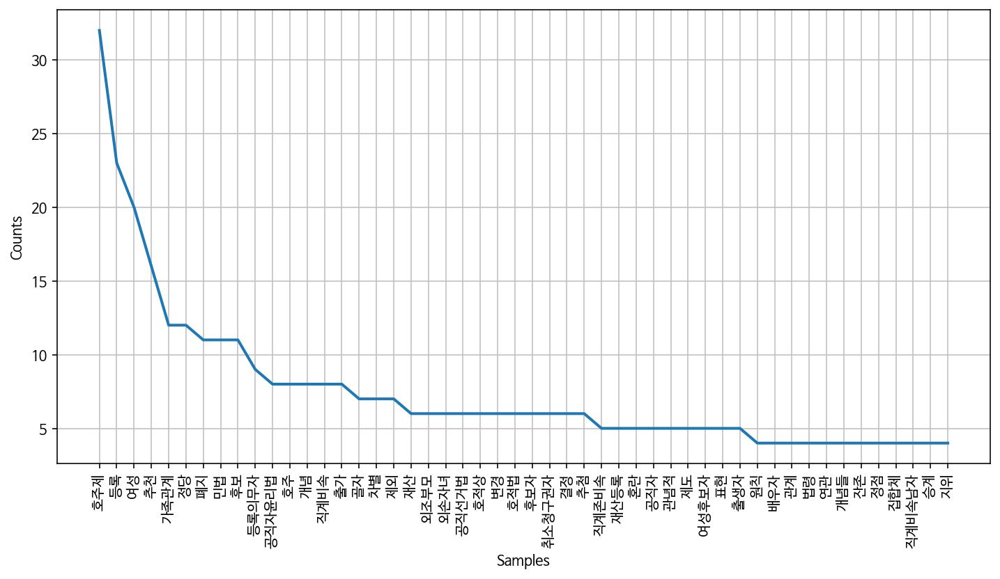

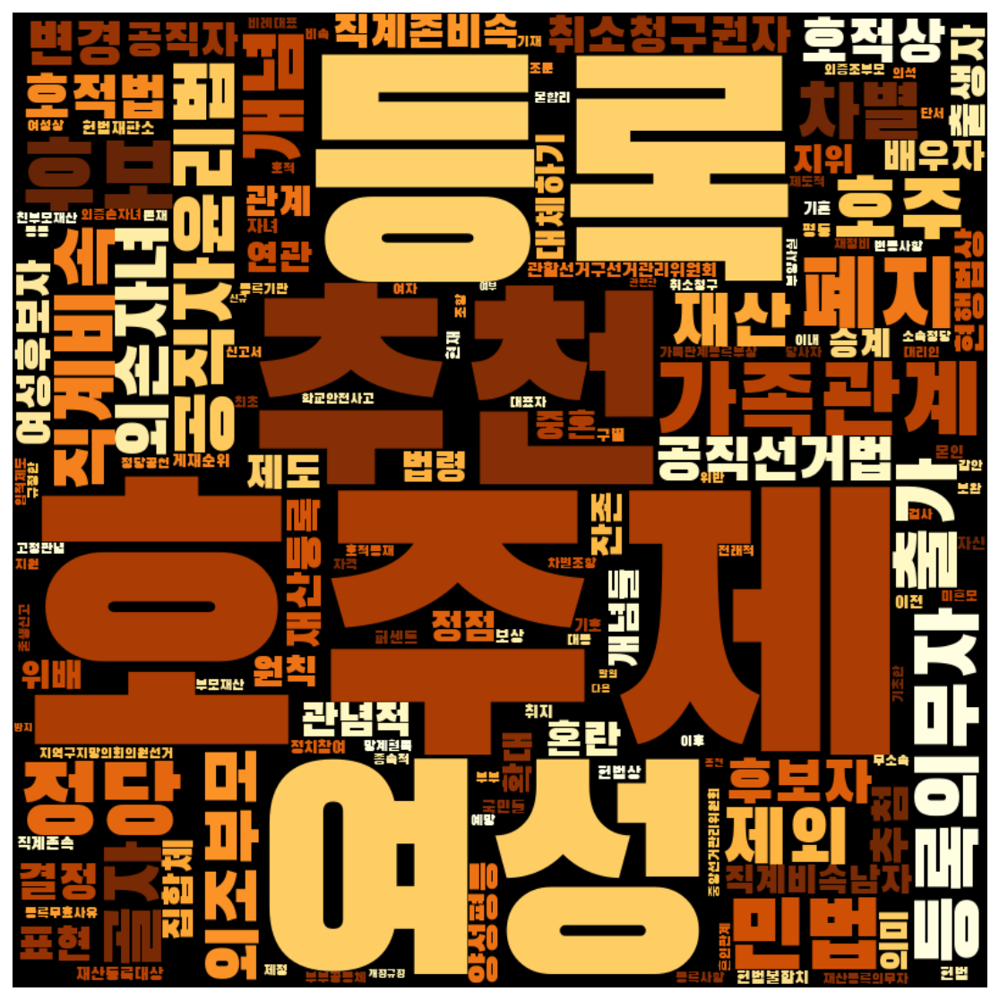

In [132]:
frewords_vis(con_women_g1_tokens)
wordcloud_vis(con_women_g1_tokens, 'YlOrBr')

frewords_vis(con_women_g2_tokens)
wordcloud_vis(con_women_g2_tokens, 'YlOrBr')

frewords_vis(con_women_g3_tokens)
wordcloud_vis(con_women_g3_tokens, 'YlOrBr')

In [133]:
con_men = con_men[con_men['명사수'] > 1]

# K means 수행 
word_vectors_con_men = con_men['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_con_men)
con_men['category'] = idx

print(con_men['category'].value_counts())

con_men_g1 = con_men[con_men['category'] == 0]
con_men_g2 = con_men[con_men['category'] == 1]
con_men_g3 = con_men[con_men['category'] == 2]

con_men_g1_tokens = total_tokens(con_men_g1['tokens'])
con_men_g2_tokens = total_tokens(con_men_g2['tokens'])
con_men_g3_tokens = total_tokens(con_men_g3['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
con_men_g1_tokens = [each_word for each_word in con_men_g1_tokens if each_word not in stopwords]
con_men_g2_tokens = [each_word for each_word in con_men_g2_tokens if each_word not in stopwords]
con_men_g3_tokens = [each_word for each_word in con_men_g3_tokens if each_word not in stopwords]

2    169
1    128
0     24
Name: category, dtype: int64


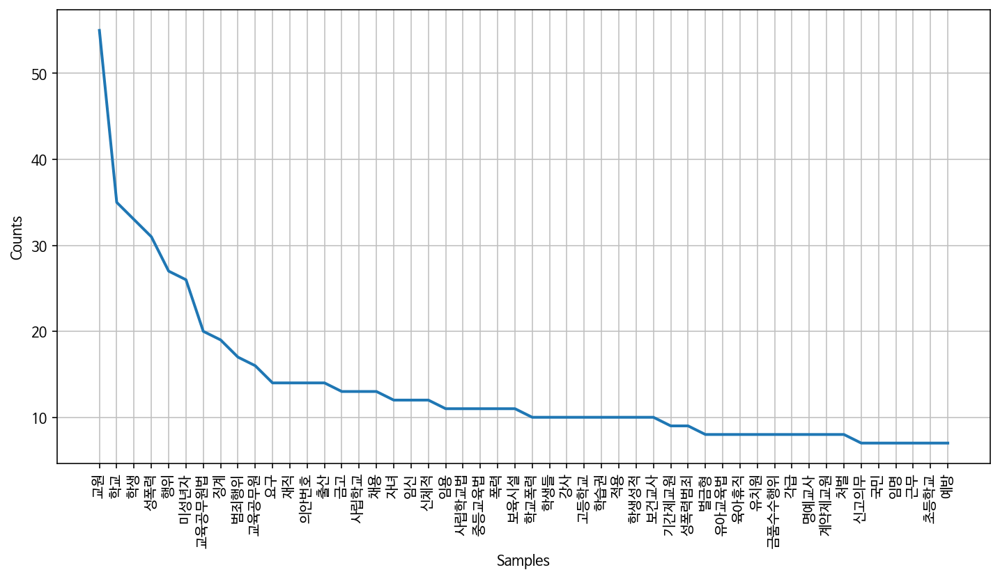

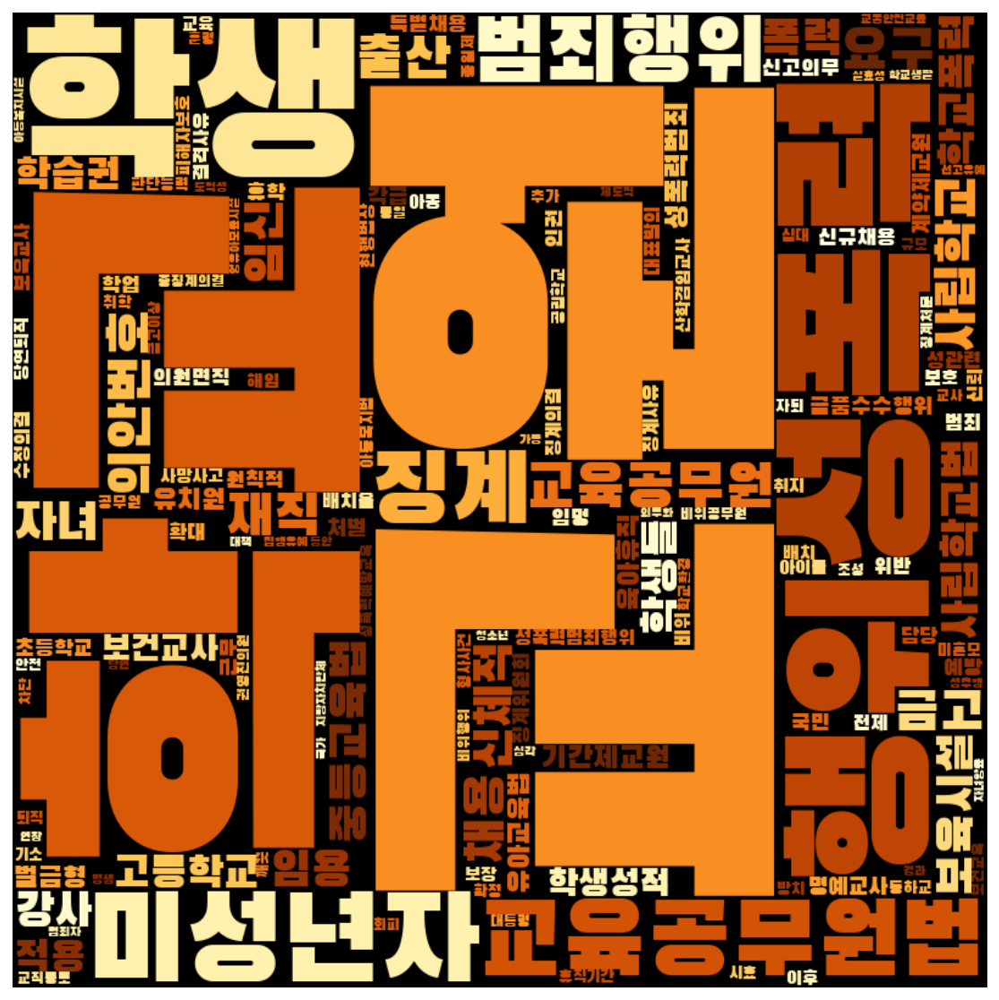

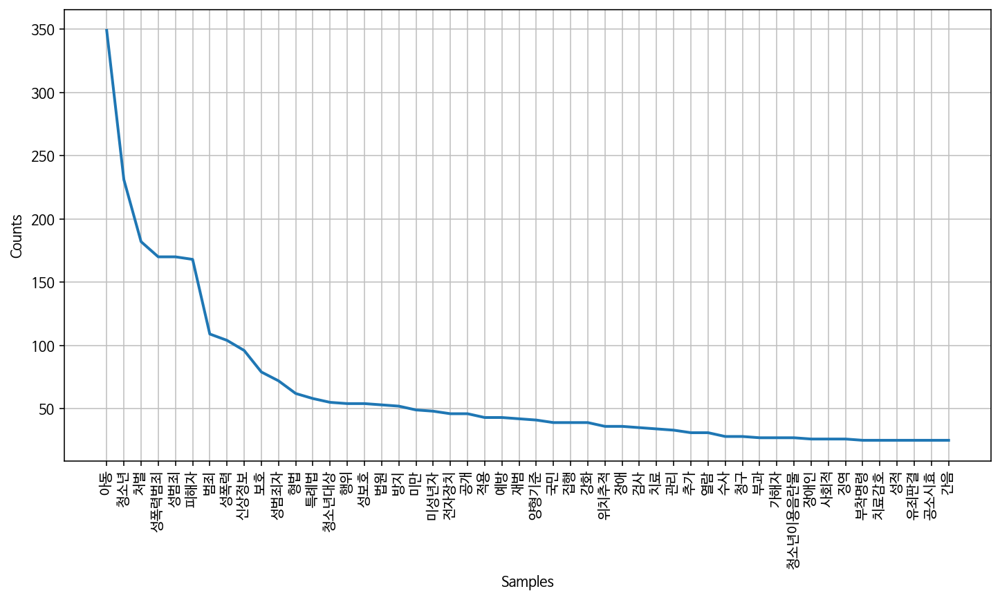

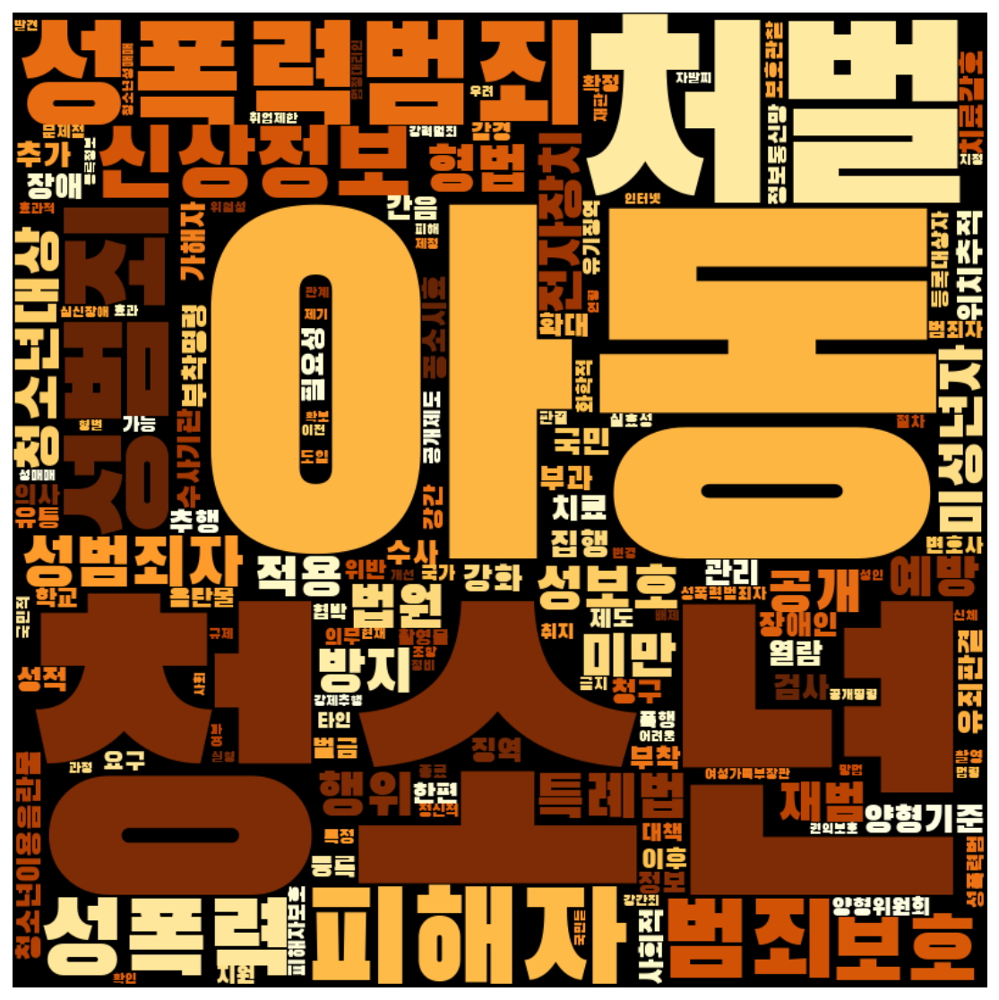

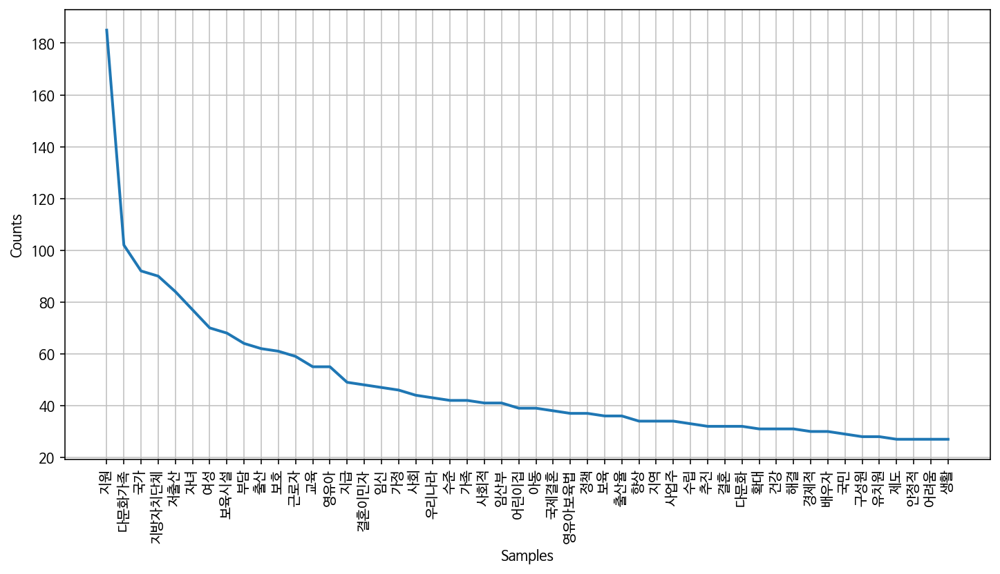

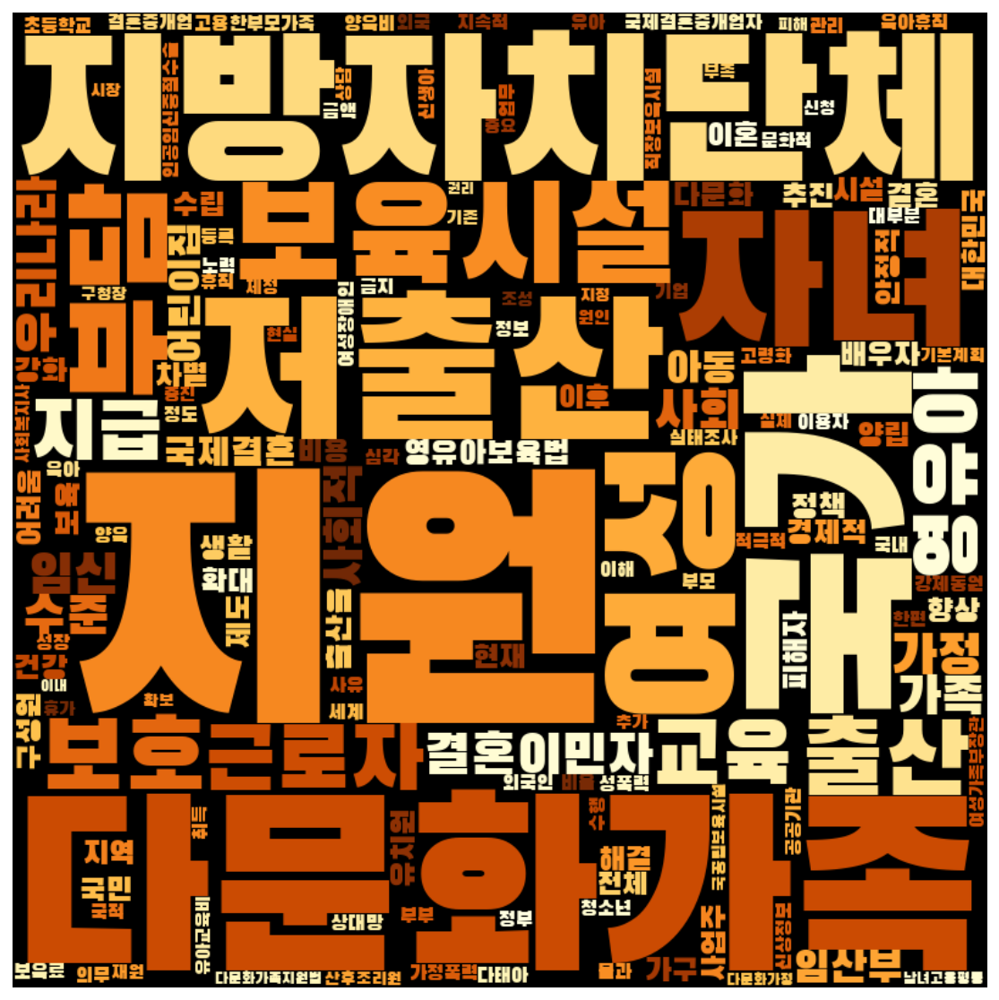

In [134]:
frewords_vis(con_men_g1_tokens)
wordcloud_vis(con_men_g1_tokens, 'YlOrBr')

frewords_vis(con_men_g2_tokens)
wordcloud_vis(con_men_g2_tokens, 'YlOrBr')

frewords_vis(con_men_g3_tokens)
wordcloud_vis(con_men_g3_tokens, 'YlOrBr')

## 박근혜 정권
- 2013.02.25 ~ 2017.03.13

In [15]:
parkkeunhye = gender[(gender['제안일자'] > datetime.date(2013,2,25)) & 
                        (gender['제안일자'] < datetime.date(2017,5,10))]
parkkeunhye.shape

(1121, 19)

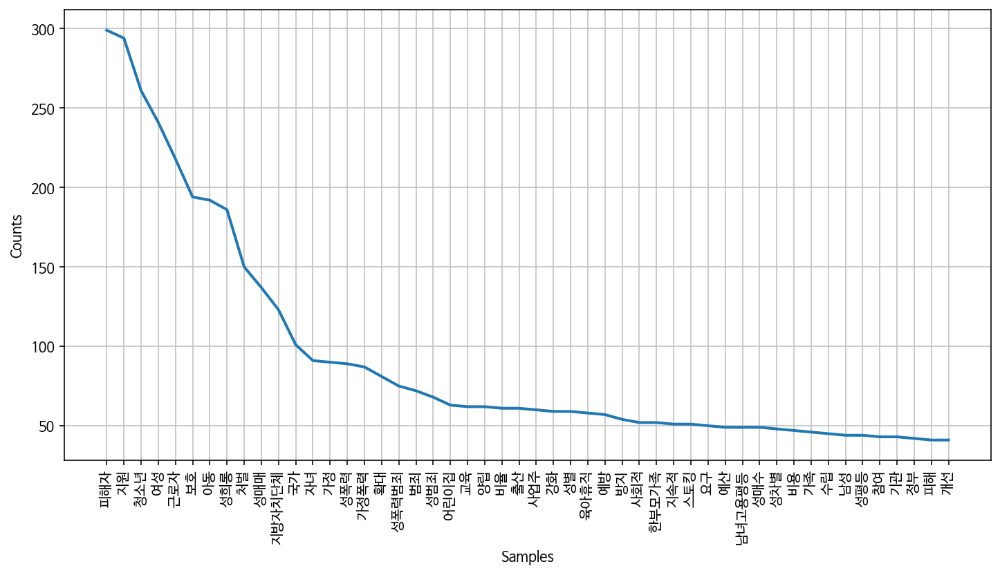

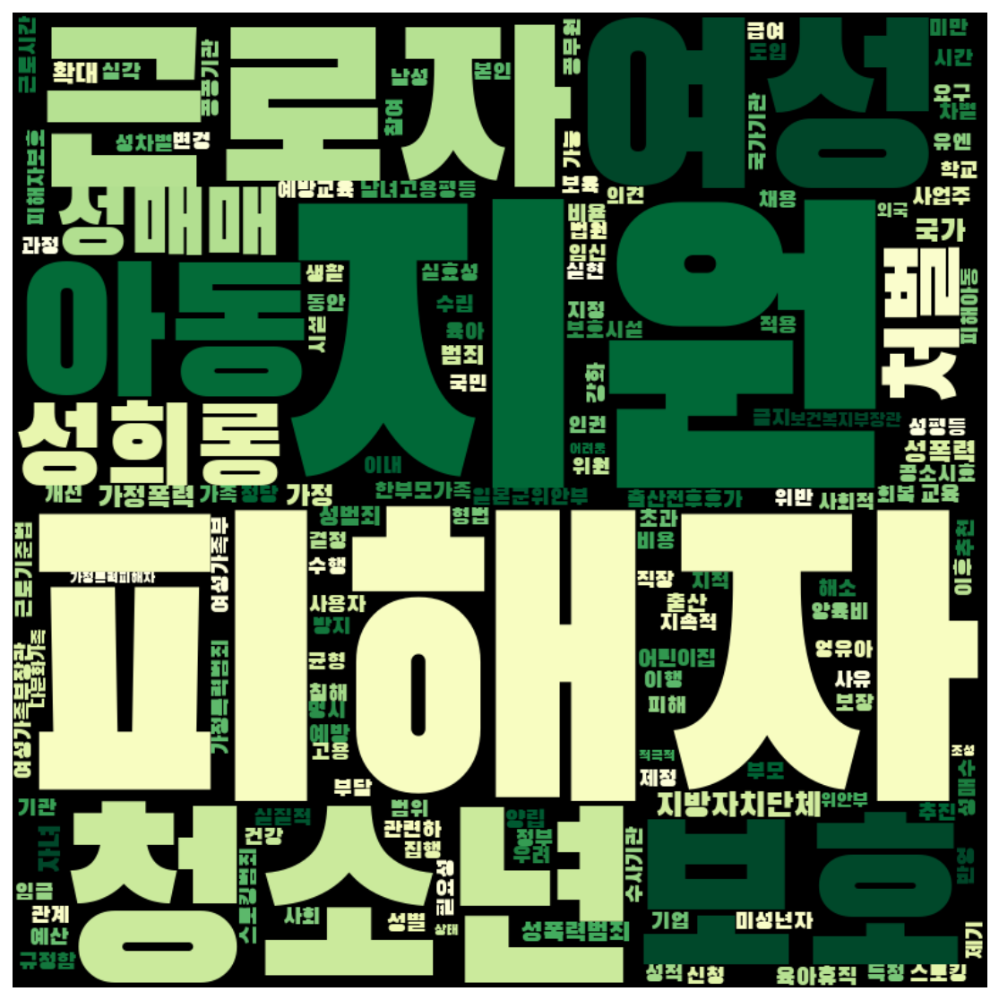

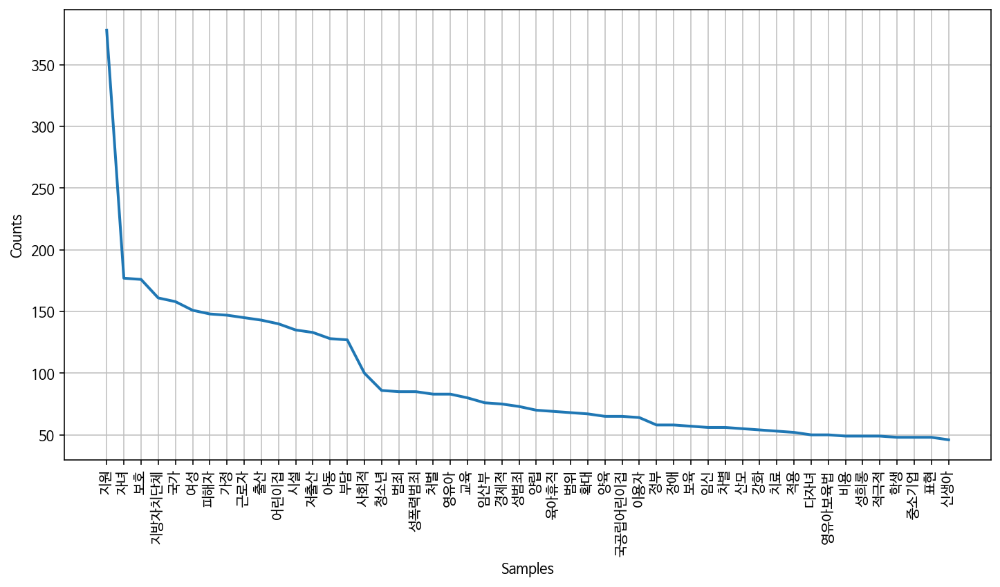

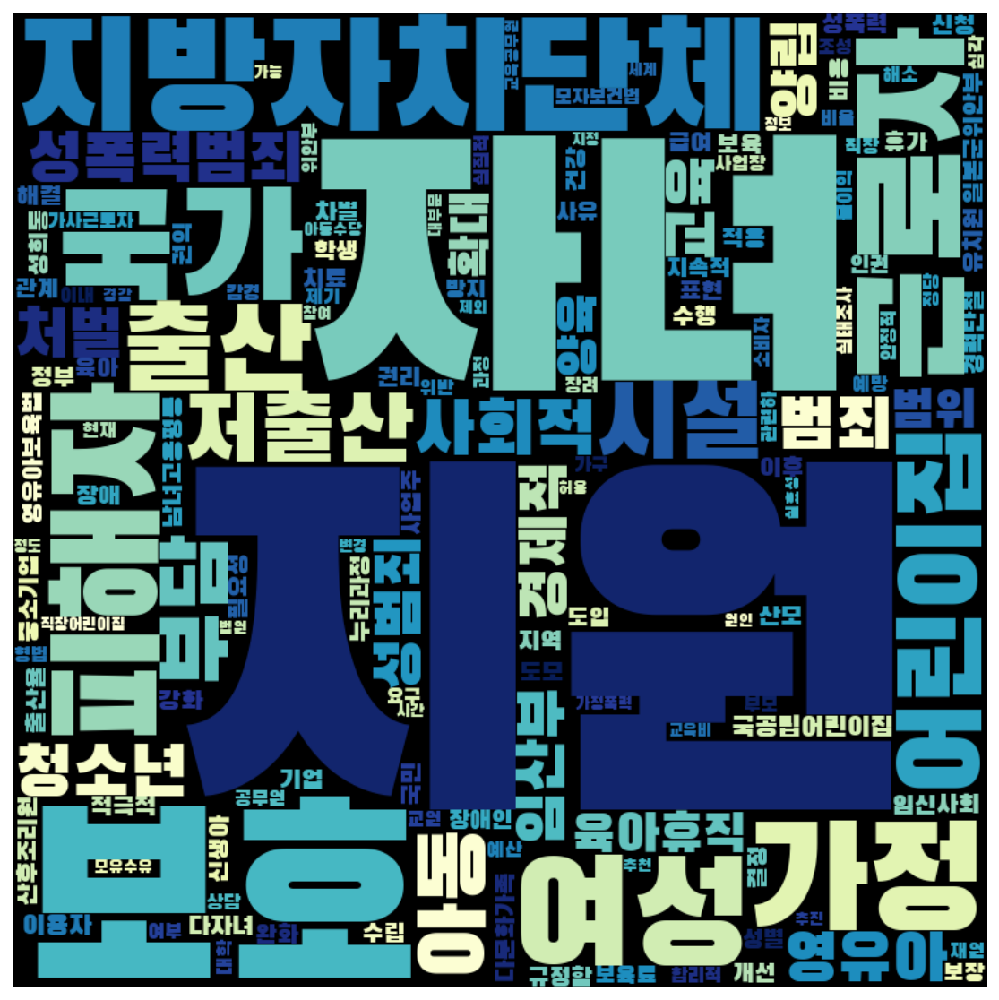

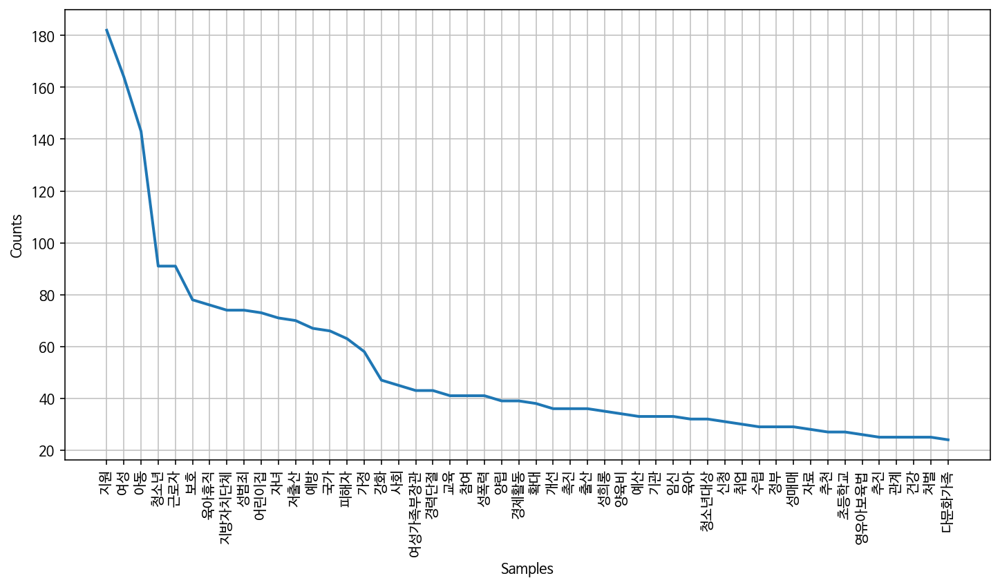

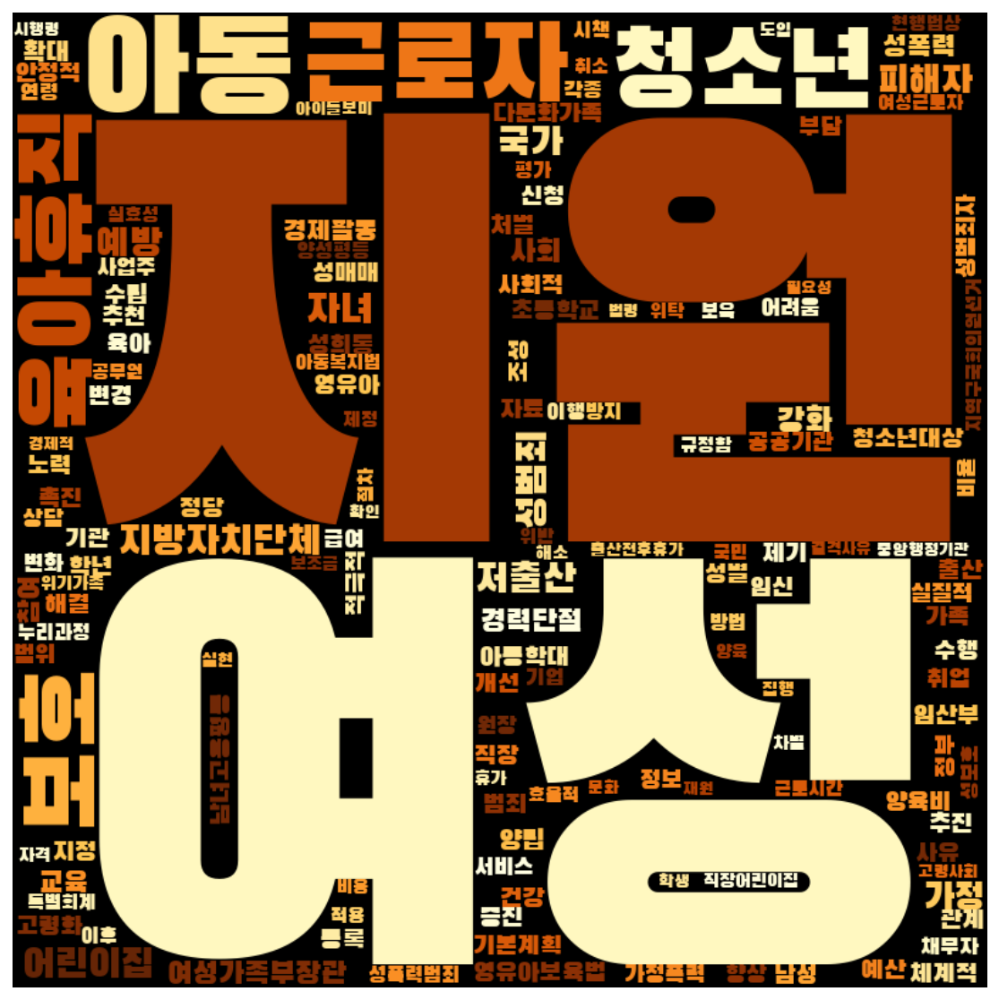

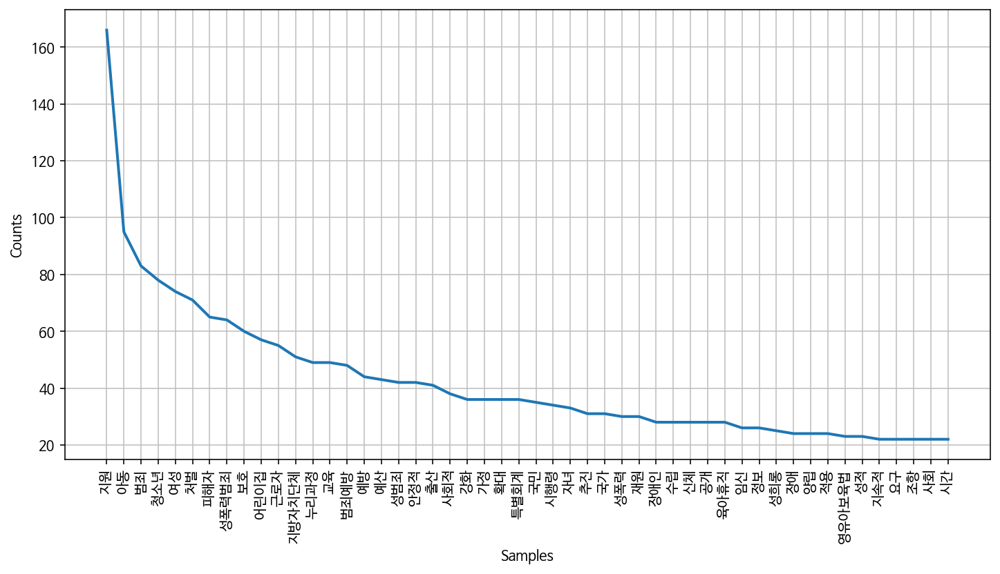

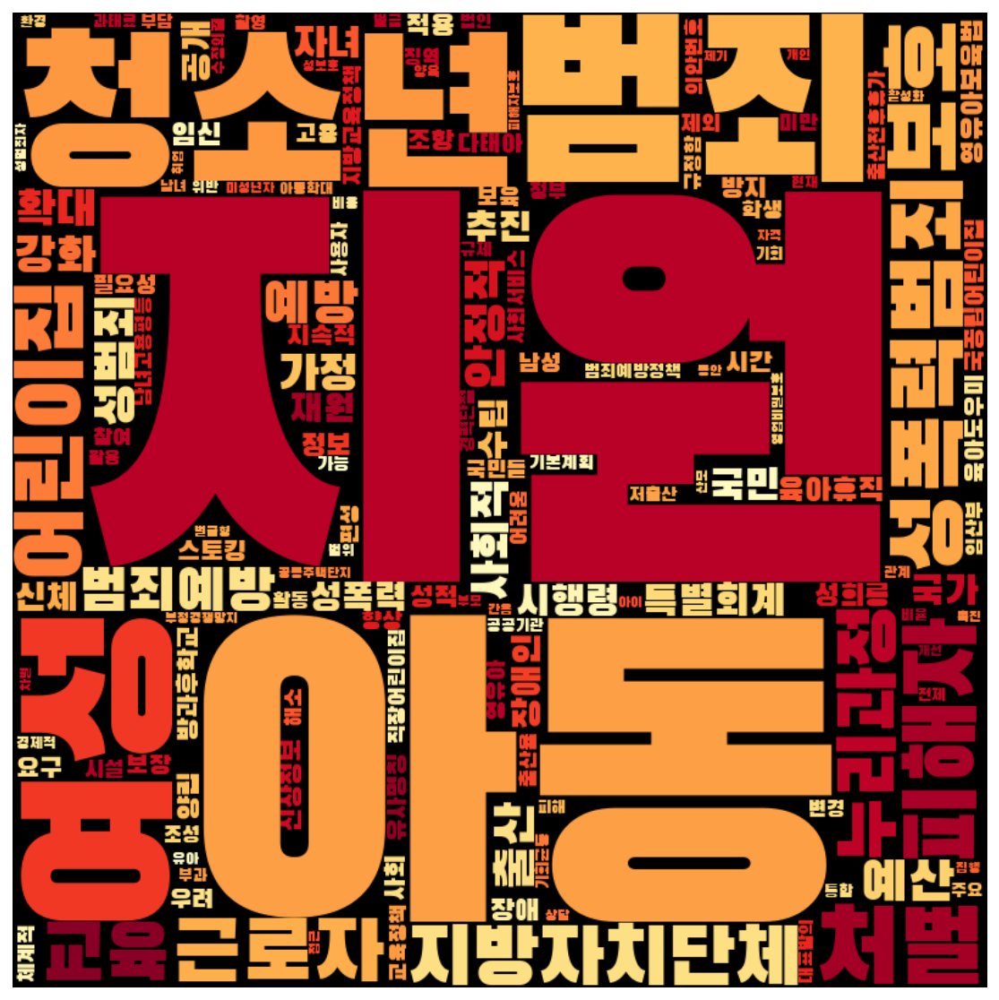

In [20]:
pro_women = parkkeunhye[(parkkeunhye['성별'] == '여성') & (parkkeunhye['정당성향'] == '진보')]
pro_men = parkkeunhye[(parkkeunhye['성별'] == '남성') & (parkkeunhye['정당성향'] == '진보')]
con_women = parkkeunhye[(parkkeunhye['성별'] == '여성') & (parkkeunhye['정당성향'] == '보수')]
con_men = parkkeunhye[(parkkeunhye['성별'] == '남성') & (parkkeunhye['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [21]:
model_pro_women = Word2Vec(pro_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_pro_men = Word2Vec(pro_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_women = Word2Vec(con_women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_con_men = Word2Vec(con_men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-21 10:27:28,467 : INFO : collecting all words and their counts
2020-10-21 10:27:28,469 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-21 10:27:28,477 : INFO : collected 4538 word types from a corpus of 22897 raw words and 284 sentences
2020-10-21 10:27:28,479 : INFO : Loading a fresh vocabulary
2020-10-21 10:27:28,484 : INFO : effective_min_count=10 retains 503 unique words (11% of original 4538, drops 4035)
2020-10-21 10:27:28,485 : INFO : effective_min_count=10 leaves 13586 word corpus (59% of original 22897, drops 9311)
2020-10-21 10:27:28,489 : INFO : deleting the raw counts dictionary of 4538 items
2020-10-21 10:27:28,490 : INFO : sample=0.001 downsamples 85 most-common words
2020-10-21 10:27:28,492 : INFO : downsampling leaves estimated 10820 word corpus (79.6% of prior 13586)
2020-10-21 10:27:28,494 : INFO : estimated required memory for 503 words and 100 dimensions: 653900 bytes
2020-10-21 10:27:28,495 : INFO : resetting layer weights

2020-10-21 10:27:29,623 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:29,630 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:29,647 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:29,648 : INFO : EPOCH - 15 : training on 22897 raw words (10791 effective words) took 0.1s, 172265 effective words/s
2020-10-21 10:27:29,656 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:29,679 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:29,700 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:29,702 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:29,703 : INFO : EPOCH - 16 : training on 22897 raw words (10813 effective words) took 0.1s, 212075 effective words/s
2020-10-21 10:27:29,714 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:30,622 : INFO : EPOCH - 31 : training on 22897 raw words (10798 effective words) took 0.1s, 190320 effective words/s
2020-10-21 10:27:30,630 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:30,653 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:30,672 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:30,679 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:30,684 : INFO : EPOCH - 32 : training on 22897 raw words (10845 effective words) took 0.1s, 203516 effective words/s
2020-10-21 10:27:30,701 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:30,712 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:30,733 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:30,736 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:31,626 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:31,641 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:31,650 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:31,651 : INFO : EPOCH - 48 : training on 22897 raw words (10832 effective words) took 0.1s, 194477 effective words/s
2020-10-21 10:27:31,659 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:31,687 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:31,703 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:31,712 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:31,714 : INFO : EPOCH - 49 : training on 22897 raw words (10825 effective words) took 0.1s, 185260 effective words/s
2020-10-21 10:27:31,724 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:32,605 : INFO : EPOCH - 64 : training on 22897 raw words (10765 effective words) took 0.1s, 211280 effective words/s
2020-10-21 10:27:32,613 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:32,642 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:32,653 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:32,664 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:32,666 : INFO : EPOCH - 65 : training on 22897 raw words (10806 effective words) took 0.1s, 190503 effective words/s
2020-10-21 10:27:32,676 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:32,695 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:32,720 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:32,722 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:33,563 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:33,574 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:33,584 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:33,585 : INFO : EPOCH - 81 : training on 22897 raw words (10859 effective words) took 0.1s, 194626 effective words/s
2020-10-21 10:27:33,592 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:33,615 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:33,633 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:33,640 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:33,641 : INFO : EPOCH - 82 : training on 22897 raw words (10842 effective words) took 0.0s, 221930 effective words/s
2020-10-21 10:27:33,649 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:34,489 : INFO : EPOCH - 97 : training on 22897 raw words (10790 effective words) took 0.0s, 216344 effective words/s
2020-10-21 10:27:34,497 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:34,523 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:34,540 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:34,549 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:34,551 : INFO : EPOCH - 98 : training on 22897 raw words (10815 effective words) took 0.1s, 194467 effective words/s
2020-10-21 10:27:34,561 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:34,579 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:34,611 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:34,612 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:35,578 : INFO : EPOCH - 11 : training on 25671 raw words (12441 effective words) took 0.1s, 241591 effective words/s
2020-10-21 10:27:35,595 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:35,621 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:35,630 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:35,631 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:35,633 : INFO : EPOCH - 12 : training on 25671 raw words (12416 effective words) took 0.0s, 278842 effective words/s
2020-10-21 10:27:35,643 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:35,680 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:35,688 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:35,695 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:36,613 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:36,617 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:36,630 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:36,631 : INFO : EPOCH - 28 : training on 25671 raw words (12435 effective words) took 0.1s, 197566 effective words/s
2020-10-21 10:27:36,639 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:36,673 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:36,686 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:36,687 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:36,689 : INFO : EPOCH - 29 : training on 25671 raw words (12468 effective words) took 0.1s, 223816 effective words/s
2020-10-21 10:27:36,703 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:37,572 : INFO : EPOCH - 44 : training on 25671 raw words (12386 effective words) took 0.1s, 204233 effective words/s
2020-10-21 10:27:37,589 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:37,618 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:37,620 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:37,635 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:37,638 : INFO : EPOCH - 45 : training on 25671 raw words (12449 effective words) took 0.1s, 199804 effective words/s
2020-10-21 10:27:37,652 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:37,675 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:37,693 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:37,701 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:38,586 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:38,601 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:38,602 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:38,603 : INFO : EPOCH - 61 : training on 25671 raw words (12416 effective words) took 0.1s, 243668 effective words/s
2020-10-21 10:27:38,616 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:38,645 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:38,649 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:38,655 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:38,656 : INFO : EPOCH - 62 : training on 25671 raw words (12422 effective words) took 0.1s, 247991 effective words/s
2020-10-21 10:27:38,664 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:39,565 : INFO : EPOCH - 77 : training on 25671 raw words (12461 effective words) took 0.0s, 257958 effective words/s
2020-10-21 10:27:39,571 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:39,610 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:39,612 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:39,617 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:39,619 : INFO : EPOCH - 78 : training on 25671 raw words (12448 effective words) took 0.1s, 245499 effective words/s
2020-10-21 10:27:39,640 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:39,670 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:39,675 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:39,683 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-21 10:27:40,543 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:40,551 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:40,564 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:40,566 : INFO : EPOCH - 94 : training on 25671 raw words (12468 effective words) took 0.1s, 203047 effective words/s
2020-10-21 10:27:40,577 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:40,615 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:40,622 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:40,636 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:40,637 : INFO : EPOCH - 95 : training on 25671 raw words (12480 effective words) took 0.1s, 189080 effective words/s
2020-10-21 10:27:40,644 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-21 10:27:41,377 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:41,381 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:41,393 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:41,395 : INFO : EPOCH - 8 : training on 12329 raw words (4354 effective words) took 0.0s, 192254 effective words/s
2020-10-21 10:27:41,409 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:41,413 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:41,419 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:41,436 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:41,440 : INFO : EPOCH - 9 : training on 12329 raw words (4316 effective words) took 0.0s, 139739 effective words/s
2020-10-21 10:27:41,449 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-21 10:27:41,944 : INFO : EPOCH - 24 : training on 12329 raw words (4312 effective words) took 0.0s, 130019 effective words/s
2020-10-21 10:27:41,949 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:41,956 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:41,961 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:41,974 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:41,977 : INFO : EPOCH - 25 : training on 12329 raw words (4289 effective words) took 0.0s, 139309 effective words/s
2020-10-21 10:27:41,986 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:41,988 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:41,995 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:42,010 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-21 10:27:42,499 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:42,515 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:42,516 : INFO : EPOCH - 41 : training on 12329 raw words (4338 effective words) took 0.0s, 161021 effective words/s
2020-10-21 10:27:42,527 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:42,529 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:42,537 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:42,548 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:42,550 : INFO : EPOCH - 42 : training on 12329 raw words (4339 effective words) took 0.0s, 140737 effective words/s
2020-10-21 10:27:42,556 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:42,558 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-21 10:27:43,049 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:43,051 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:43,057 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:43,076 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:43,077 : INFO : EPOCH - 58 : training on 12329 raw words (4380 effective words) took 0.0s, 145245 effective words/s
2020-10-21 10:27:43,087 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:43,091 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:43,096 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:43,113 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:43,113 : INFO : EPOCH - 59 : training on 12329 raw words (4315 effective words) took 0.0s, 140022 effective words/s
2020-1

2020-10-21 10:27:43,620 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:43,623 : INFO : EPOCH - 74 : training on 12329 raw words (4269 effective words) took 0.0s, 143119 effective words/s
2020-10-21 10:27:43,632 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:43,636 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:43,642 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:43,656 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:43,657 : INFO : EPOCH - 75 : training on 12329 raw words (4343 effective words) took 0.0s, 158472 effective words/s
2020-10-21 10:27:43,668 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:43,670 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:43,676 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-21 10:27:44,172 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:44,178 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:44,197 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:44,201 : INFO : EPOCH - 91 : training on 12329 raw words (4350 effective words) took 0.0s, 131326 effective words/s
2020-10-21 10:27:44,211 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:44,214 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:44,220 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:44,237 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:44,238 : INFO : EPOCH - 92 : training on 12329 raw words (4363 effective words) took 0.0s, 143912 effective words/s
2020-10-21 10:27:44,246 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

2020-10-21 10:27:44,743 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:44,748 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:44,762 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:44,763 : INFO : EPOCH - 5 : training on 12008 raw words (3866 effective words) took 0.0s, 149367 effective words/s
2020-10-21 10:27:44,771 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:44,772 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:44,779 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:44,791 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:44,793 : INFO : EPOCH - 6 : training on 12008 raw words (3831 effective words) took 0.0s, 142832 effective words/s
2020-10-21 10:27:44,801 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-

2020-10-21 10:27:45,260 : INFO : EPOCH - 21 : training on 12008 raw words (3846 effective words) took 0.0s, 188461 effective words/s
2020-10-21 10:27:45,266 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:45,271 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:45,274 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:45,285 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:45,287 : INFO : EPOCH - 22 : training on 12008 raw words (3856 effective words) took 0.0s, 172038 effective words/s
2020-10-21 10:27:45,296 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:45,303 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:45,305 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:45,316 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-1

2020-10-21 10:27:45,771 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:45,777 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:45,778 : INFO : EPOCH - 38 : training on 12008 raw words (3822 effective words) took 0.0s, 157922 effective words/s
2020-10-21 10:27:45,785 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:45,792 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:45,795 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:45,806 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:45,808 : INFO : EPOCH - 39 : training on 12008 raw words (3874 effective words) took 0.0s, 150661 effective words/s
2020-10-21 10:27:45,813 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:45,816 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-1

2020-10-21 10:27:46,256 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:46,259 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:46,262 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:46,276 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:46,279 : INFO : EPOCH - 55 : training on 12008 raw words (3859 effective words) took 0.0s, 159466 effective words/s
2020-10-21 10:27:46,285 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:46,290 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:46,296 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:46,305 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:46,305 : INFO : EPOCH - 56 : training on 12008 raw words (3810 effective words) took 0.0s, 184636 effective words/s
2020-1

2020-10-21 10:27:46,744 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:46,745 : INFO : EPOCH - 71 : training on 12008 raw words (3865 effective words) took 0.0s, 140546 effective words/s
2020-10-21 10:27:46,751 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:46,754 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:46,759 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:46,771 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:46,774 : INFO : EPOCH - 72 : training on 12008 raw words (3893 effective words) took 0.0s, 148349 effective words/s
2020-10-21 10:27:46,783 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:46,786 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:46,792 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-1

2020-10-21 10:27:47,246 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:47,251 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:47,264 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:47,264 : INFO : EPOCH - 88 : training on 12008 raw words (3855 effective words) took 0.0s, 163550 effective words/s
2020-10-21 10:27:47,273 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-21 10:27:47,276 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-21 10:27:47,279 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-21 10:27:47,293 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-21 10:27:47,294 : INFO : EPOCH - 89 : training on 12008 raw words (3831 effective words) took 0.0s, 157047 effective words/s
2020-10-21 10:27:47,299 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-1

In [22]:
print('진보 여성:', model_pro_women.wv.most_similar('여성'))
print('진보 남성:', model_pro_men.wv.most_similar('여성'))
print('보수 여성:', model_con_women.wv.most_similar('여성'))
print('보수 남성:', model_con_men.wv.most_similar('여성'))

2020-10-21 10:27:47,621 : INFO : precomputing L2-norms of word weight vectors
2020-10-21 10:27:47,626 : INFO : precomputing L2-norms of word weight vectors
2020-10-21 10:27:47,628 : INFO : precomputing L2-norms of word weight vectors
2020-10-21 10:27:47,631 : INFO : precomputing L2-norms of word weight vectors


진보 여성: [('남성', 0.49944597482681274), ('정치참여', 0.485796719789505), ('참여', 0.46641141176223755), ('지역구', 0.44526880979537964), ('추천', 0.43988755345344543), ('공직선거법', 0.43883687257766724), ('실현', 0.41415488719940186), ('경제활동', 0.3875688314437866), ('양성평등', 0.3867533802986145), ('경력단절', 0.3806361258029938)]
진보 남성: [('재고용', 0.4423025846481323), ('경제활동', 0.43768903613090515), ('기혼여성', 0.4360431432723999), ('평등', 0.4200090169906616), ('경력단절', 0.41374585032463074), ('결혼', 0.3987506031990051), ('관점', 0.3931129574775696), ('추천', 0.38243722915649414), ('신체적', 0.3795926868915558), ('선거', 0.35511118173599243)]
보수 여성: [('경제활동', 0.5835460424423218), ('정수', 0.5616167783737183), ('경력단절여성등', 0.5084623694419861), ('확대', 0.4858383238315582), ('촉진', 0.45766857266426086), ('경력단절', 0.4462699592113495), ('후보자', 0.4425889253616333), ('확산', 0.44139206409454346), ('촉진법', 0.4401319622993469), ('성별', 0.42361247539520264)]
보수 남성: [('육아', 0.505726158618927), ('경제활동', 0.47208383679389954), ('출산', 0.46726194024086), (

In [23]:
pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
con_women['문장벡터'] = con_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_women))
con_men['문장벡터'] = con_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_con_men))

<ipython-input-23-4fb28107e7ed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_women['문장벡터'] = pro_women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_women))
<ipython-input-23-4fb28107e7ed>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pro_men['문장벡터'] = pro_men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_pro_men))
<ipython-input-23-4fb28107e7ed>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [24]:
pro_women = pro_women[pro_women['명사수'] > 1]

# K means 수행 
word_vectors_pro_women = pro_women['문장벡터'].to_list()
num_clusters = 3

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_pro_women)
pro_women['category'] = idx

In [25]:
pro_women['category'].value_counts()

2    132
0     95
1     57
Name: category, dtype: int64

In [26]:
pro_women_g1 = pro_women[pro_women['category'] == 0]
pro_women_g2 = pro_women[pro_women['category'] == 1]
pro_women_g3 = pro_women[pro_women['category'] == 2]

In [27]:
pro_women_g1_tokens = total_tokens(pro_women_g1['tokens'])
pro_women_g2_tokens = total_tokens(pro_women_g2['tokens'])
pro_women_g3_tokens = total_tokens(pro_women_g3['tokens'])

In [28]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
pro_women_g1_tokens = [each_word for each_word in pro_women_g1_tokens if each_word not in stopwords]
pro_women_g2_tokens = [each_word for each_word in pro_women_g2_tokens if each_word not in stopwords]
pro_women_g3_tokens = [each_word for each_word in pro_women_g3_tokens if each_word not in stopwords]

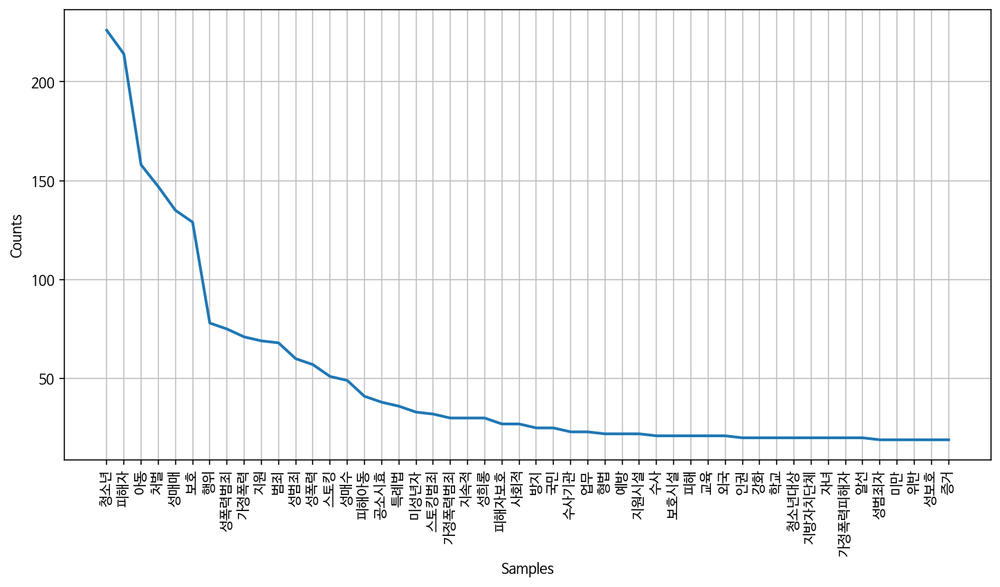

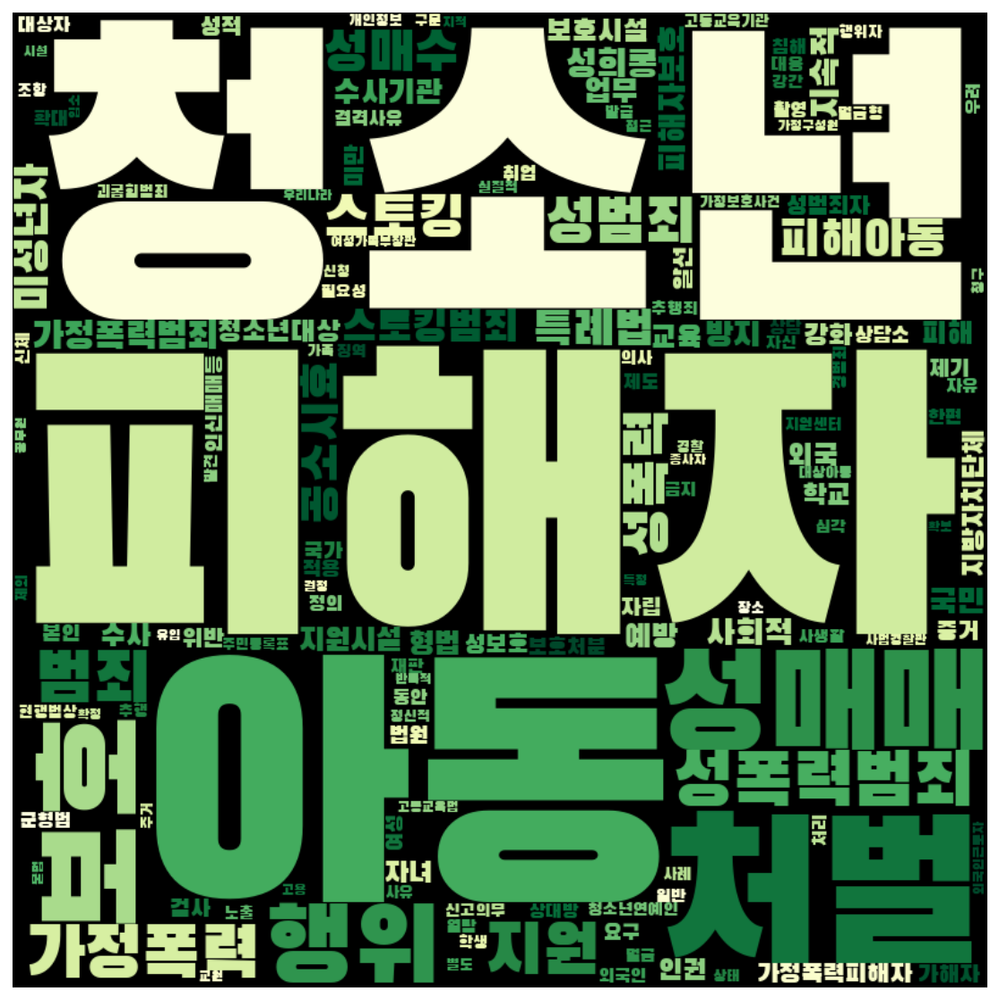

In [29]:
frewords_vis(pro_women_g1_tokens)
wordcloud_vis(pro_women_g1_tokens,'YlGn')

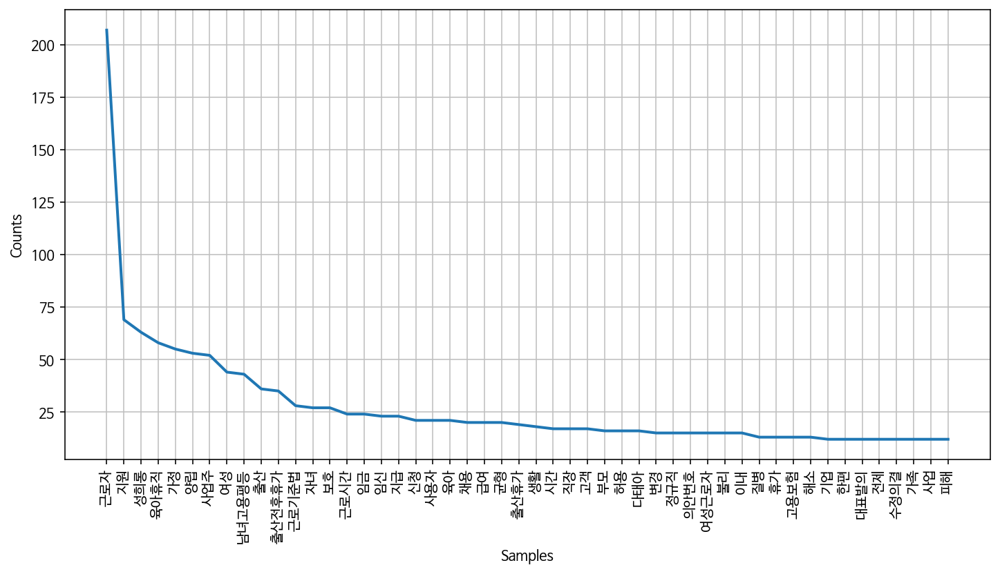

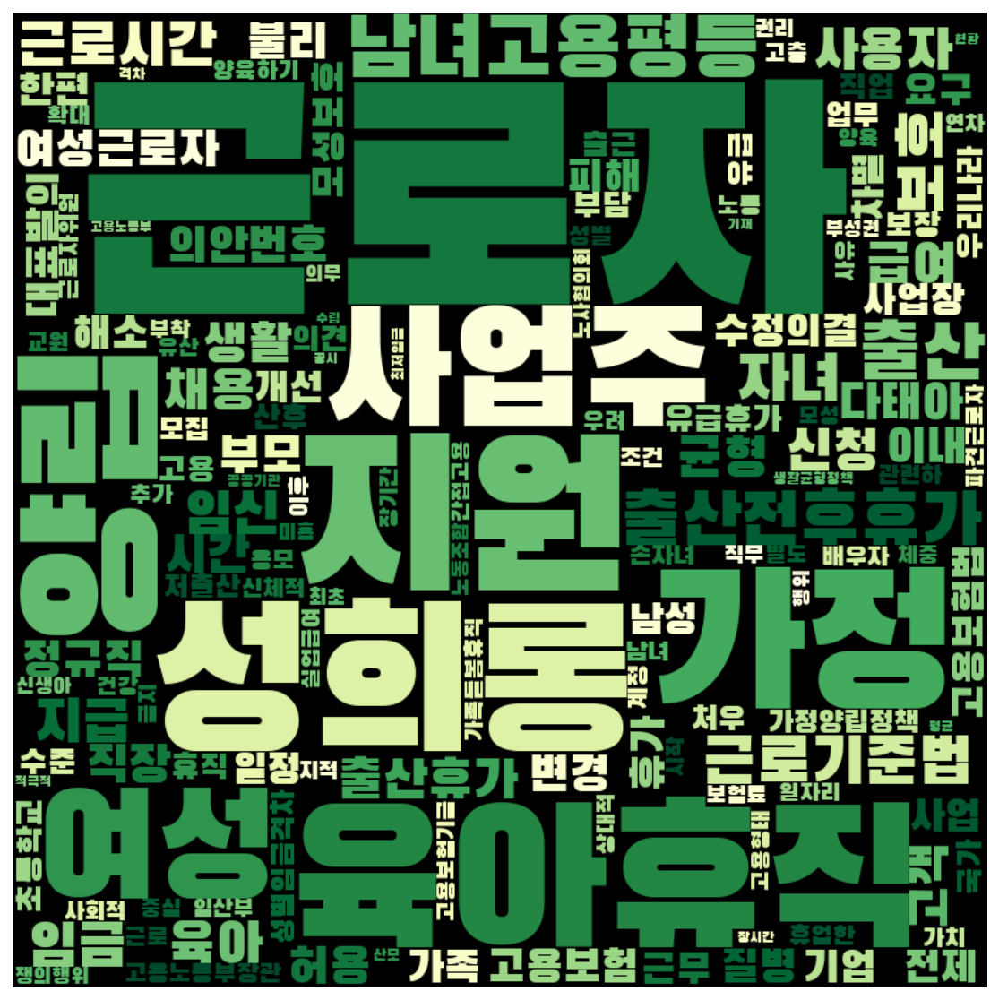

In [30]:
frewords_vis(pro_women_g2_tokens)
wordcloud_vis(pro_women_g2_tokens,'YlGn')

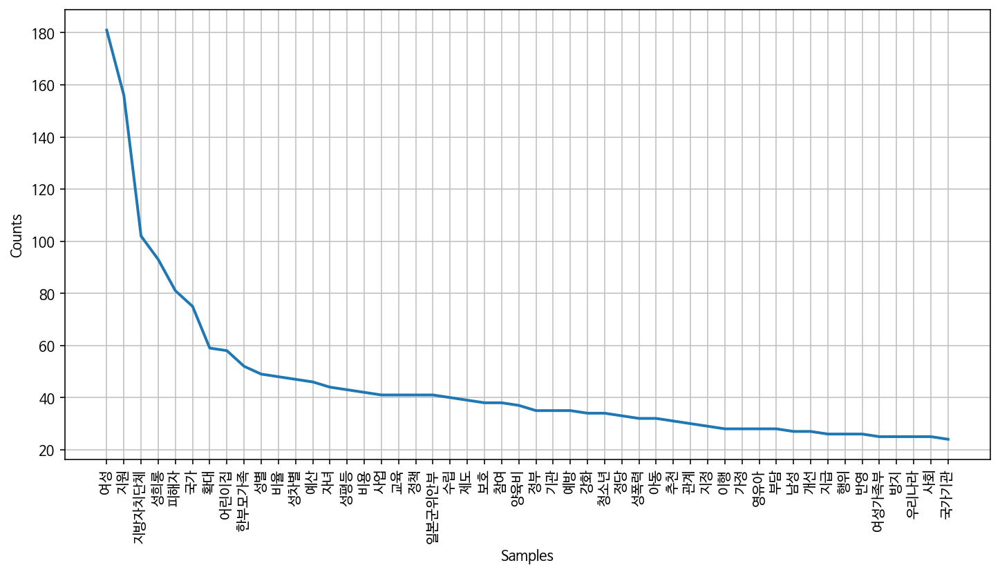

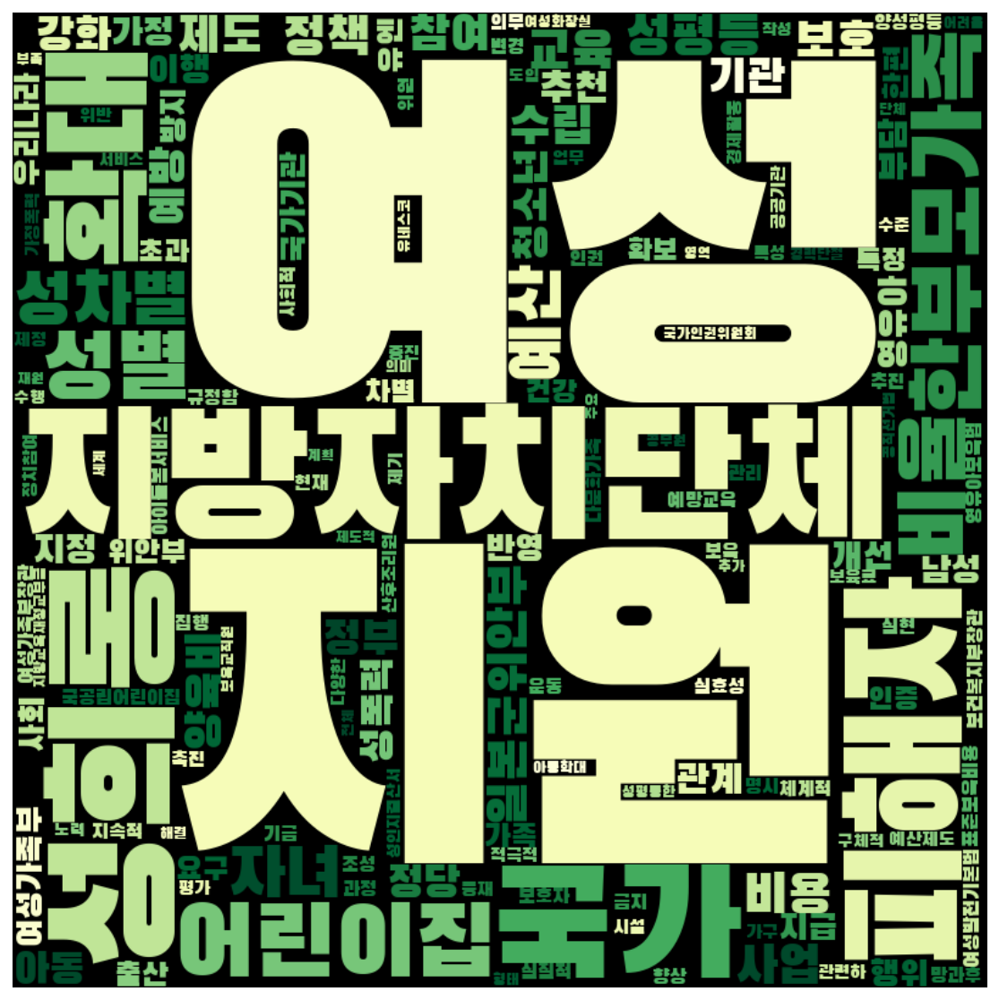

In [31]:
frewords_vis(pro_women_g3_tokens)
wordcloud_vis(pro_women_g3_tokens,'YlGn')

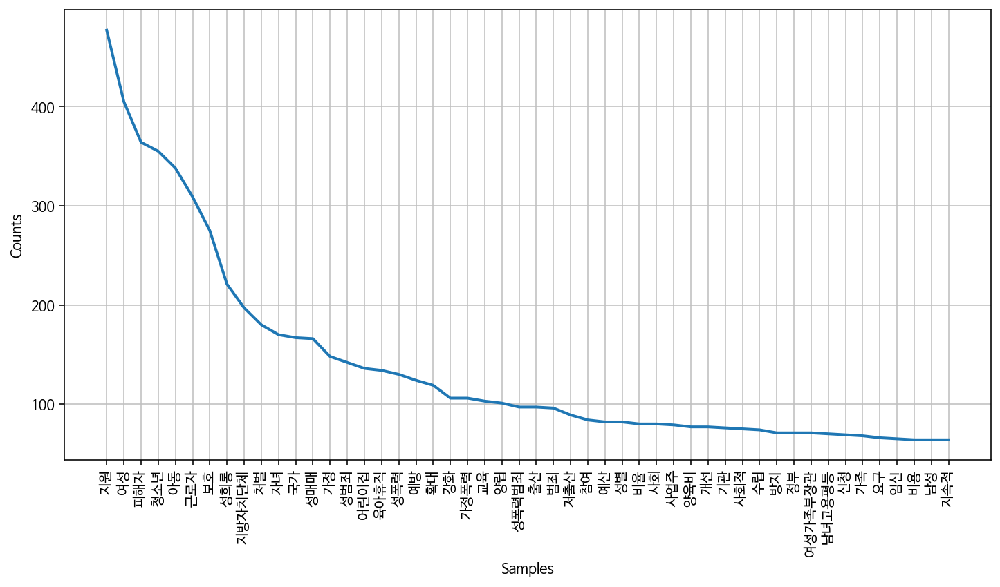

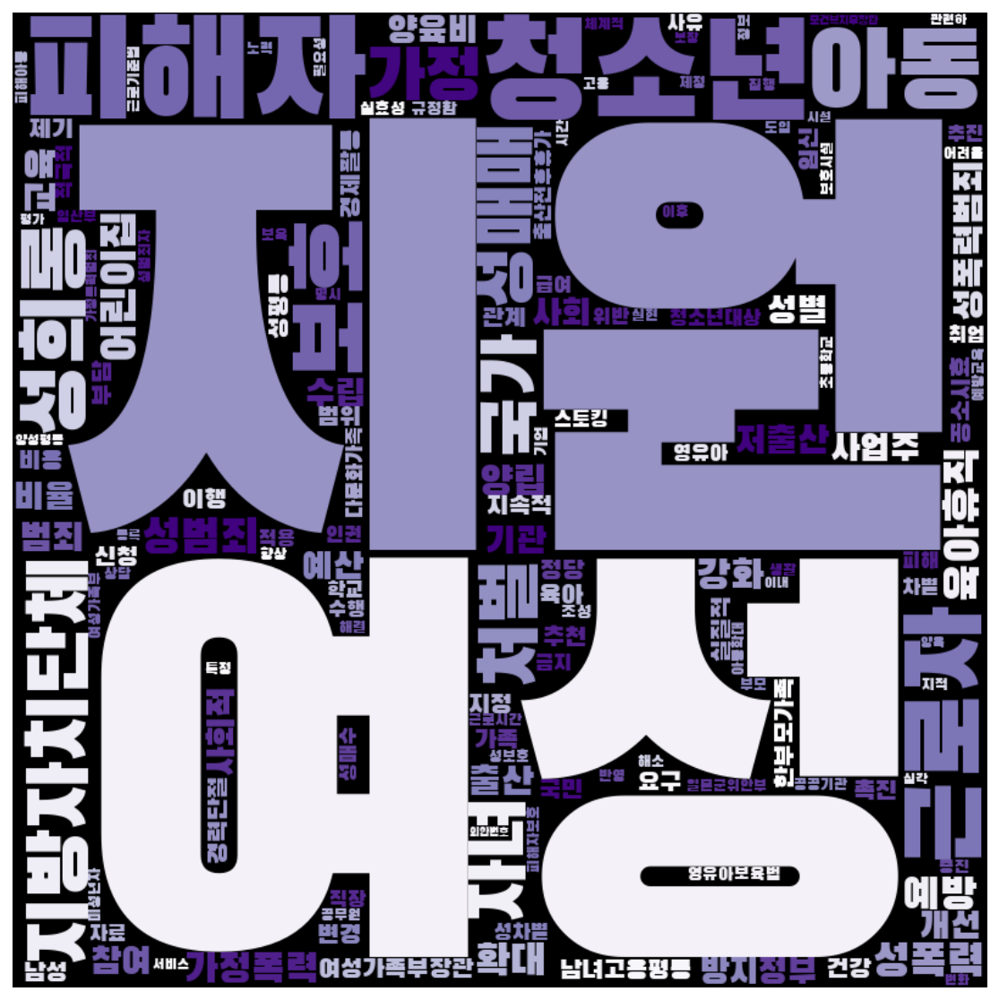

In [158]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

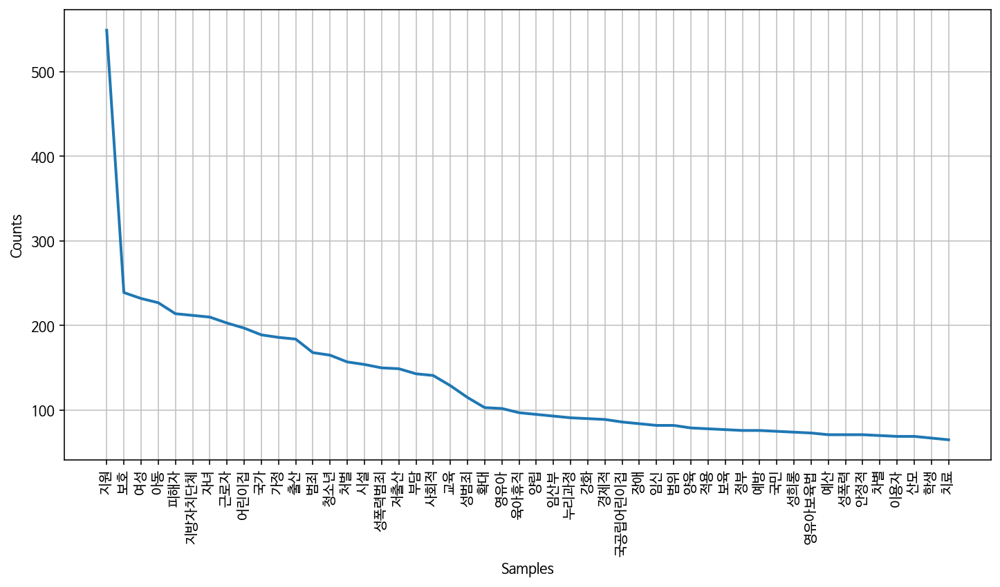

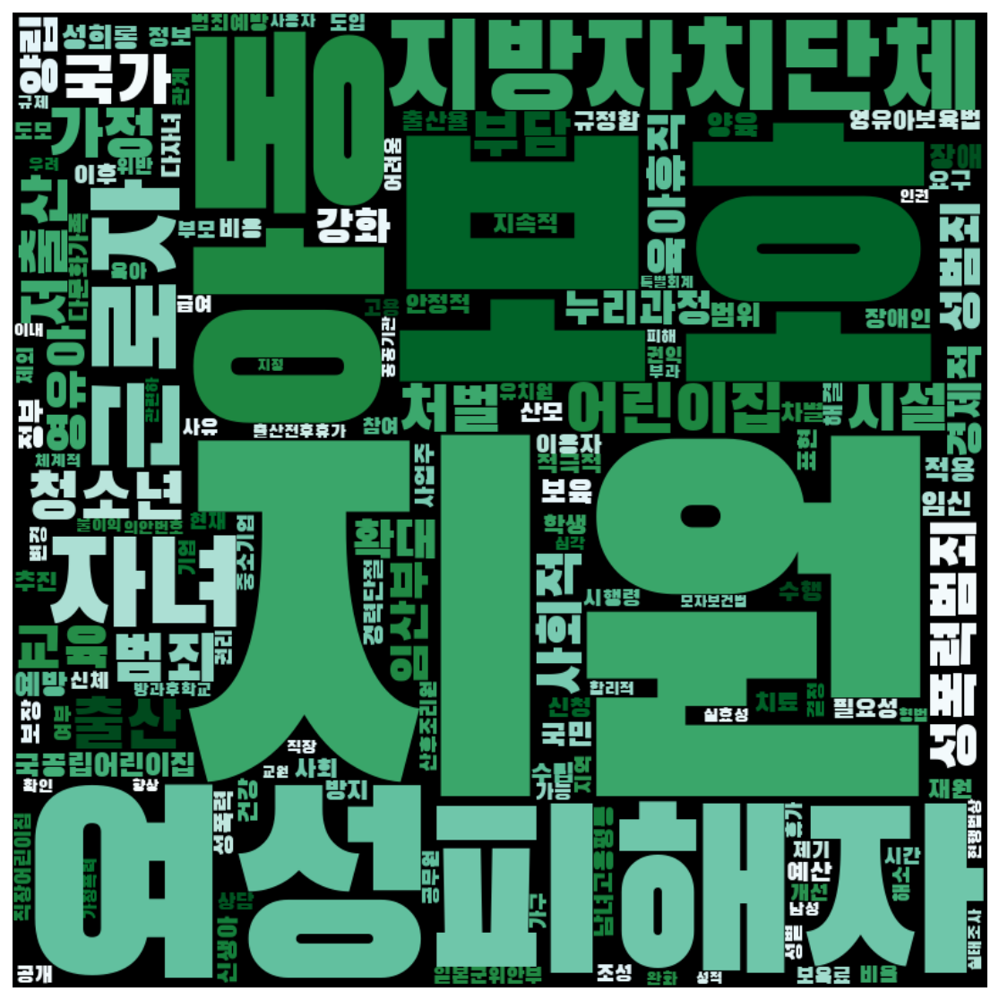

In [161]:
frewords_vis(men_word)
wordcloud_vis(men_word, 'coolwarm')

In [162]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

<ipython-input-162-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-162-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


In [163]:
# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-163-758a1e279dd2>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [164]:
women['category'].value_counts()

2    125
3    100
5     86
4     67
0     62
1     16
Name: category, dtype: int64

In [165]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [166]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [167]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

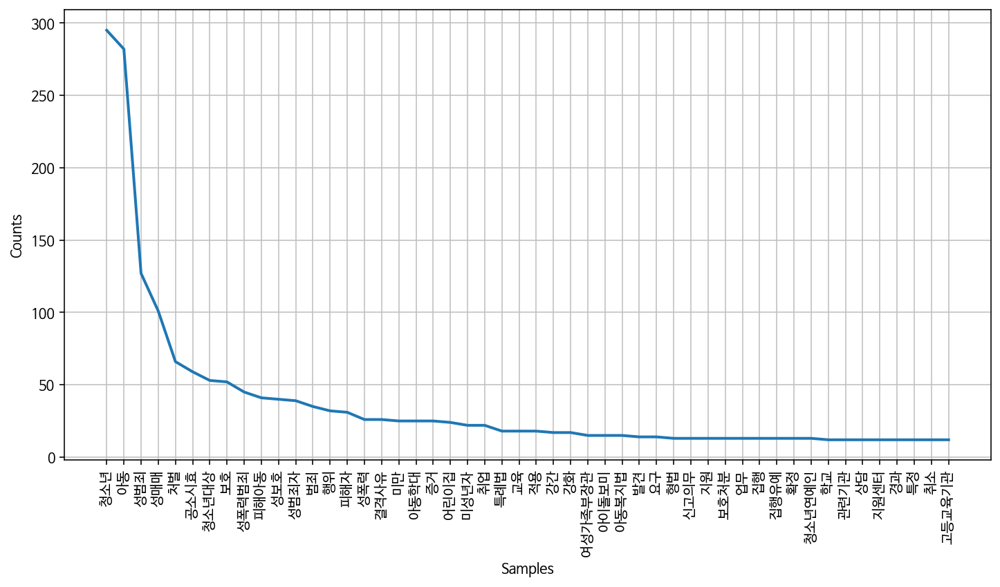

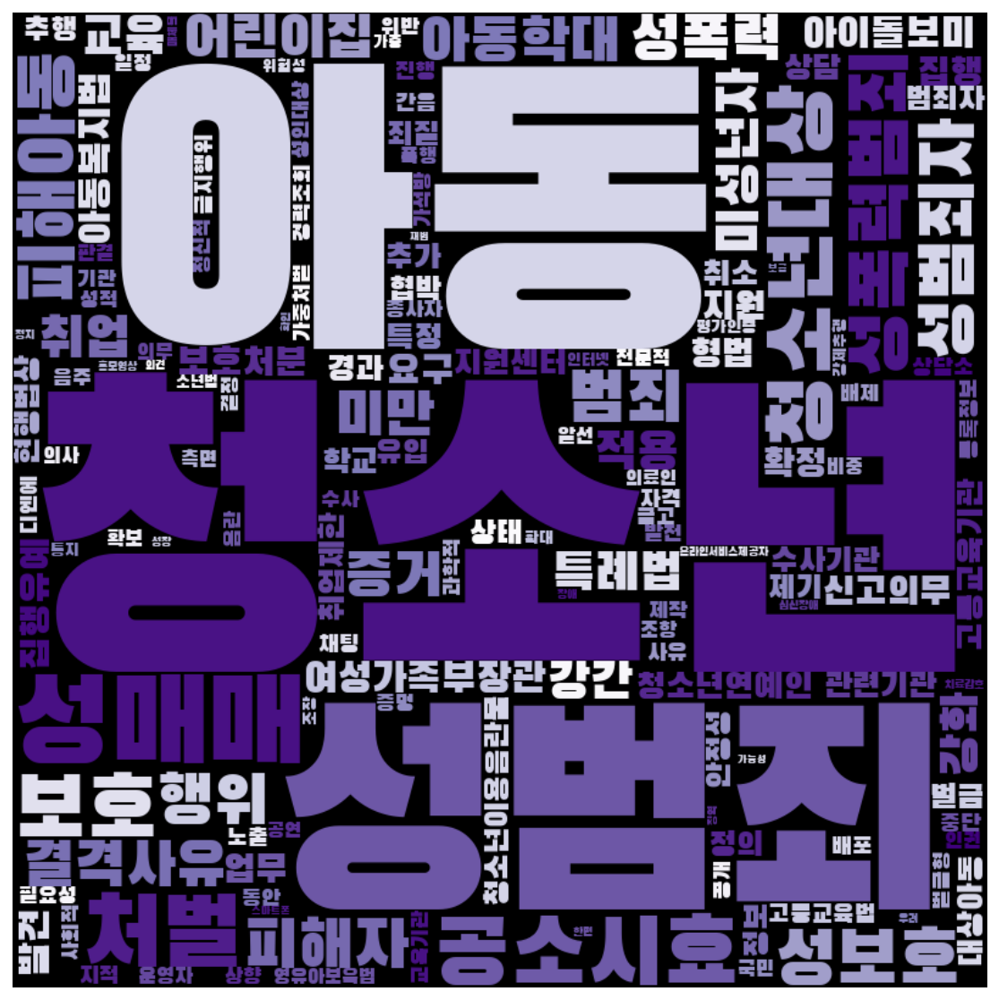

In [168]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens, 'Accent')

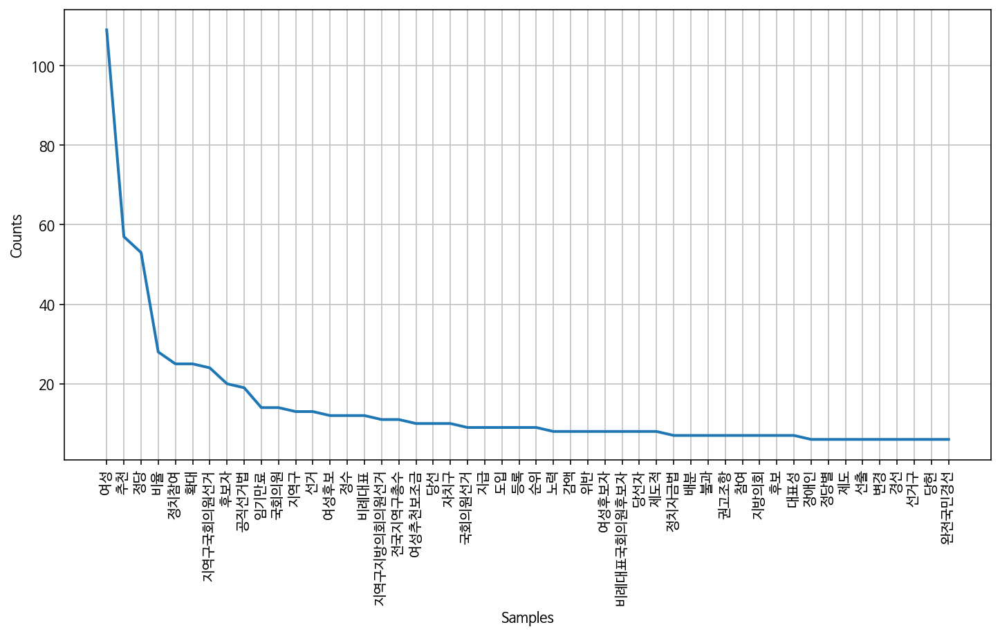

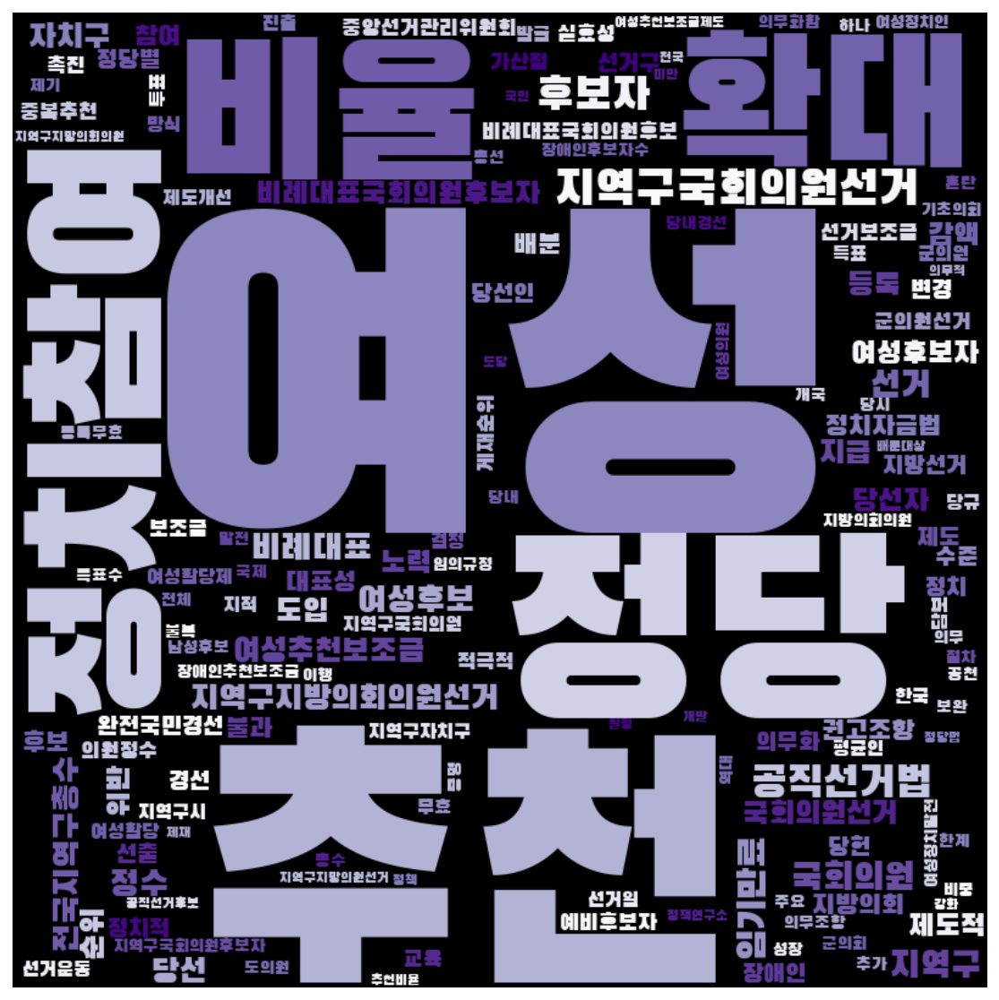

In [169]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens, 'Accent')

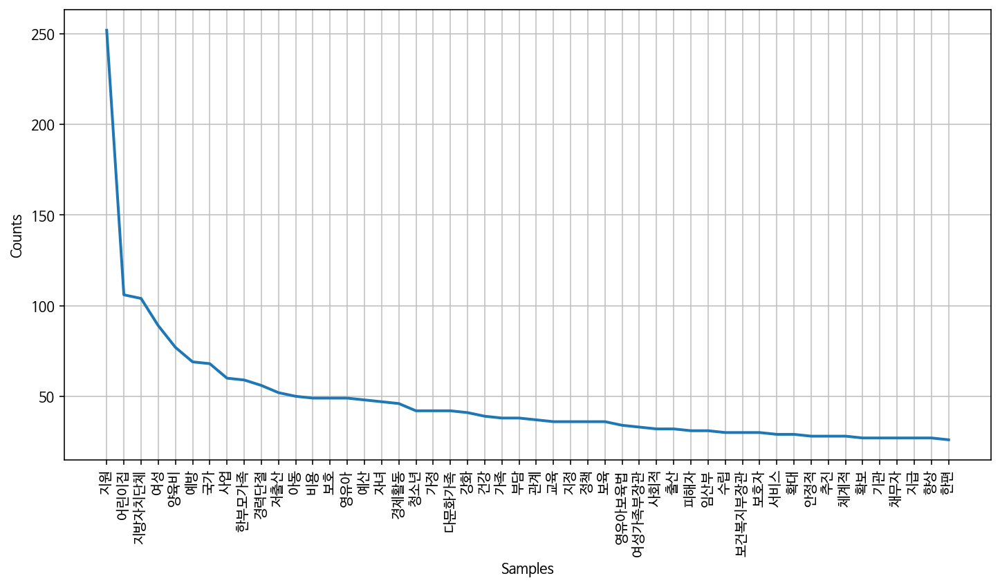

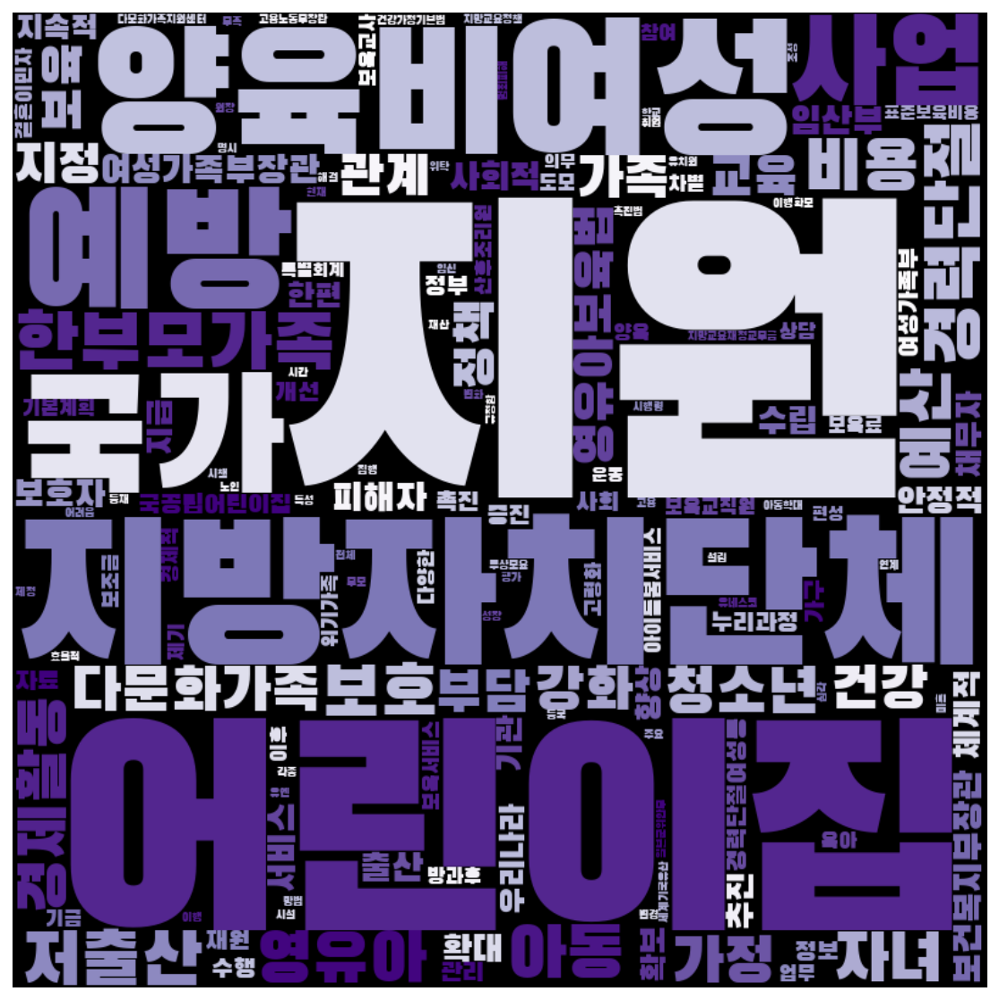

In [170]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens,'Accent')

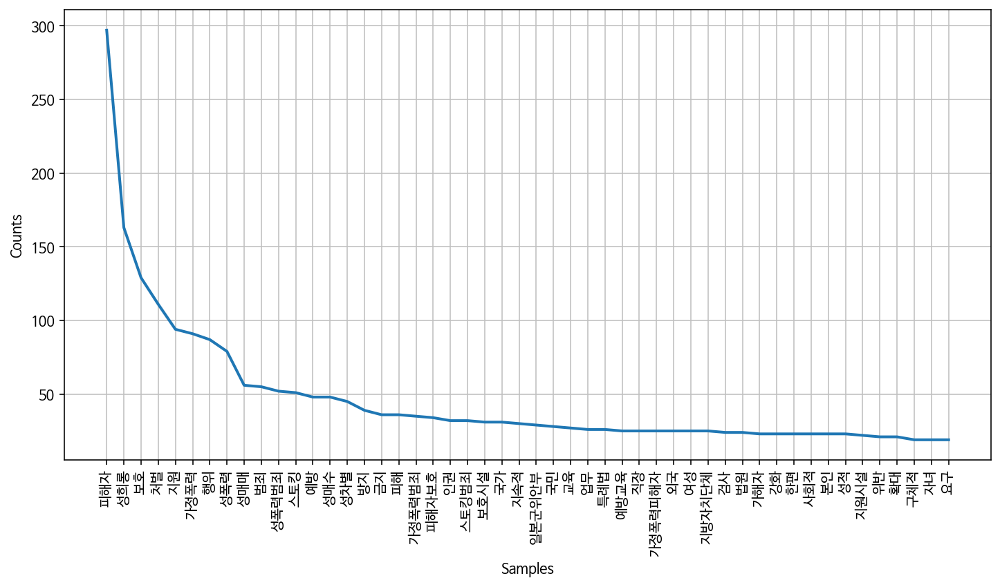

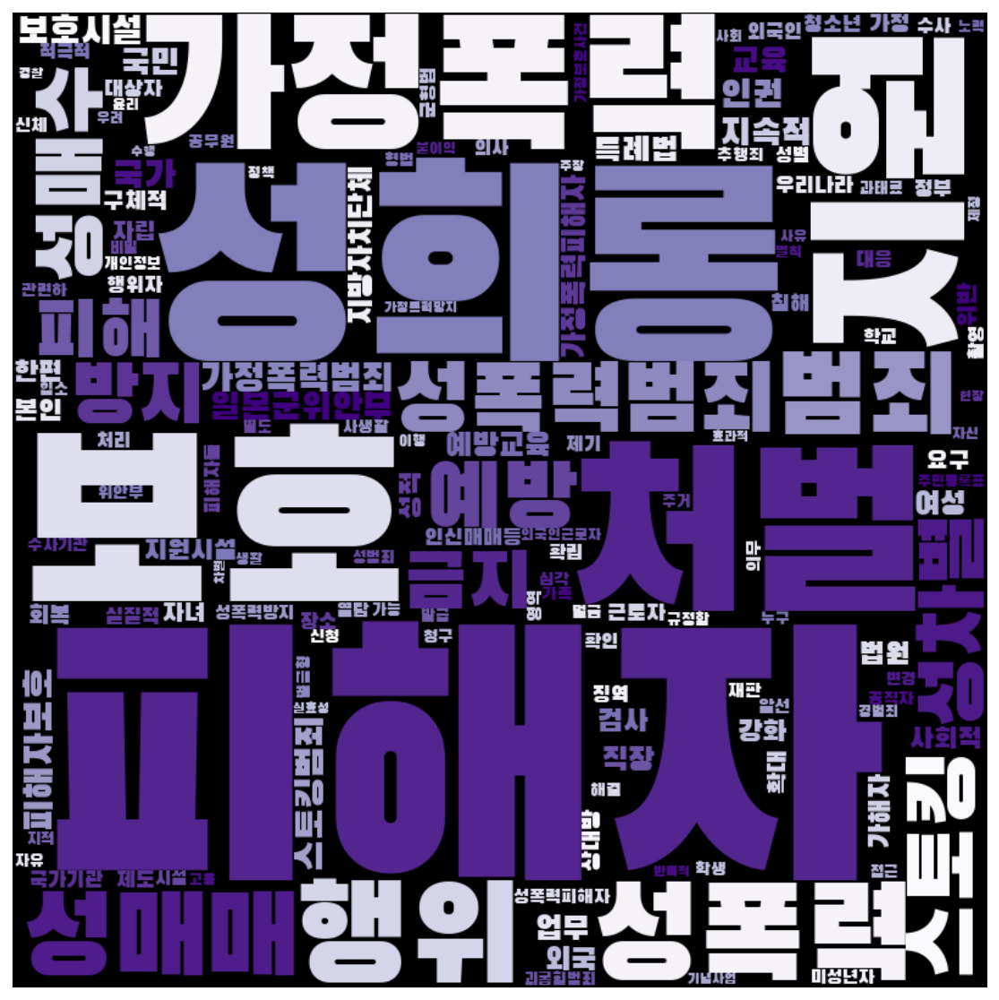

In [171]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

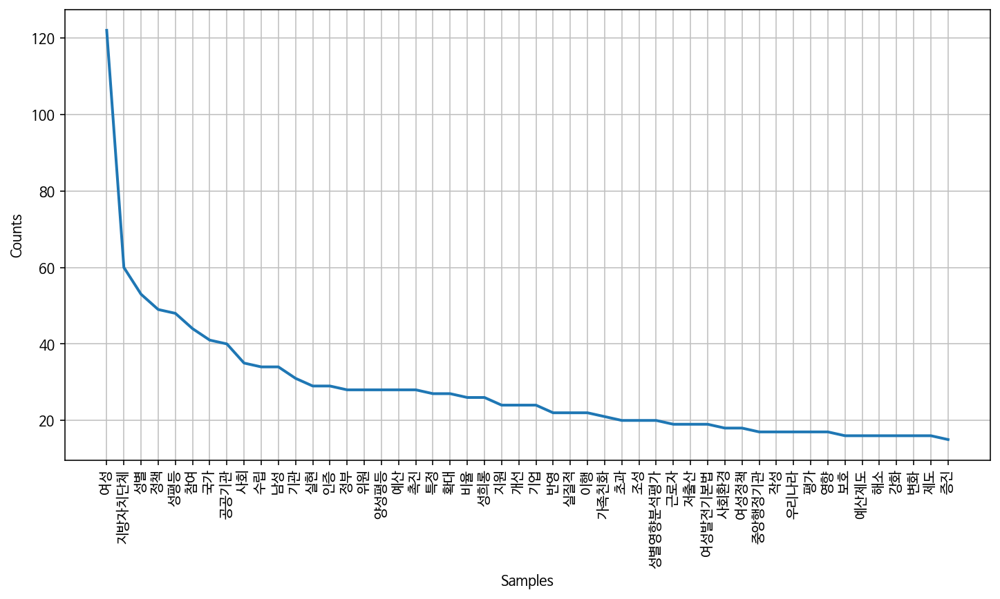

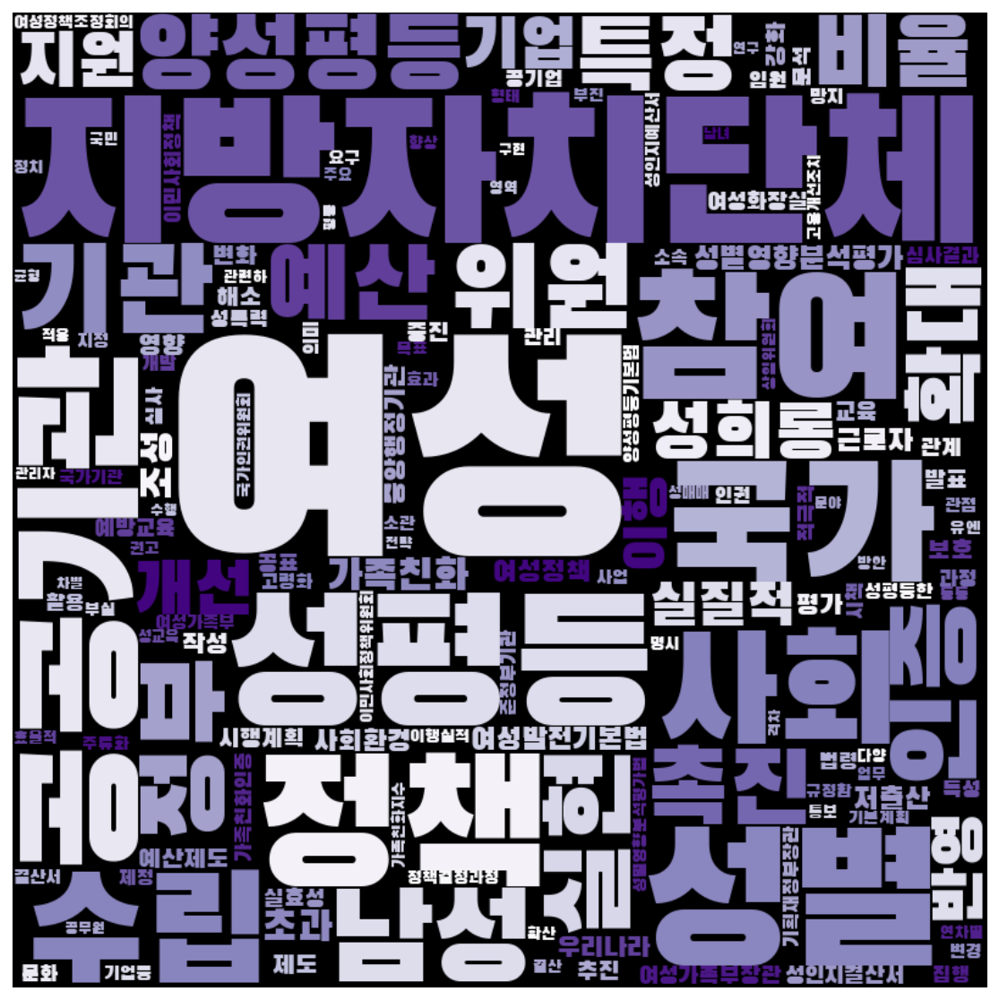

In [172]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens,'Accent')

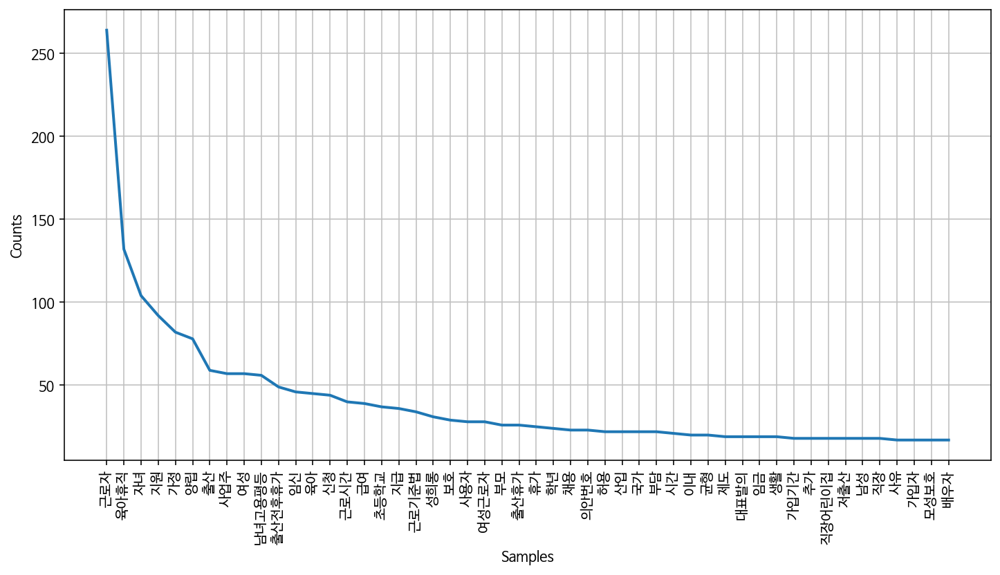

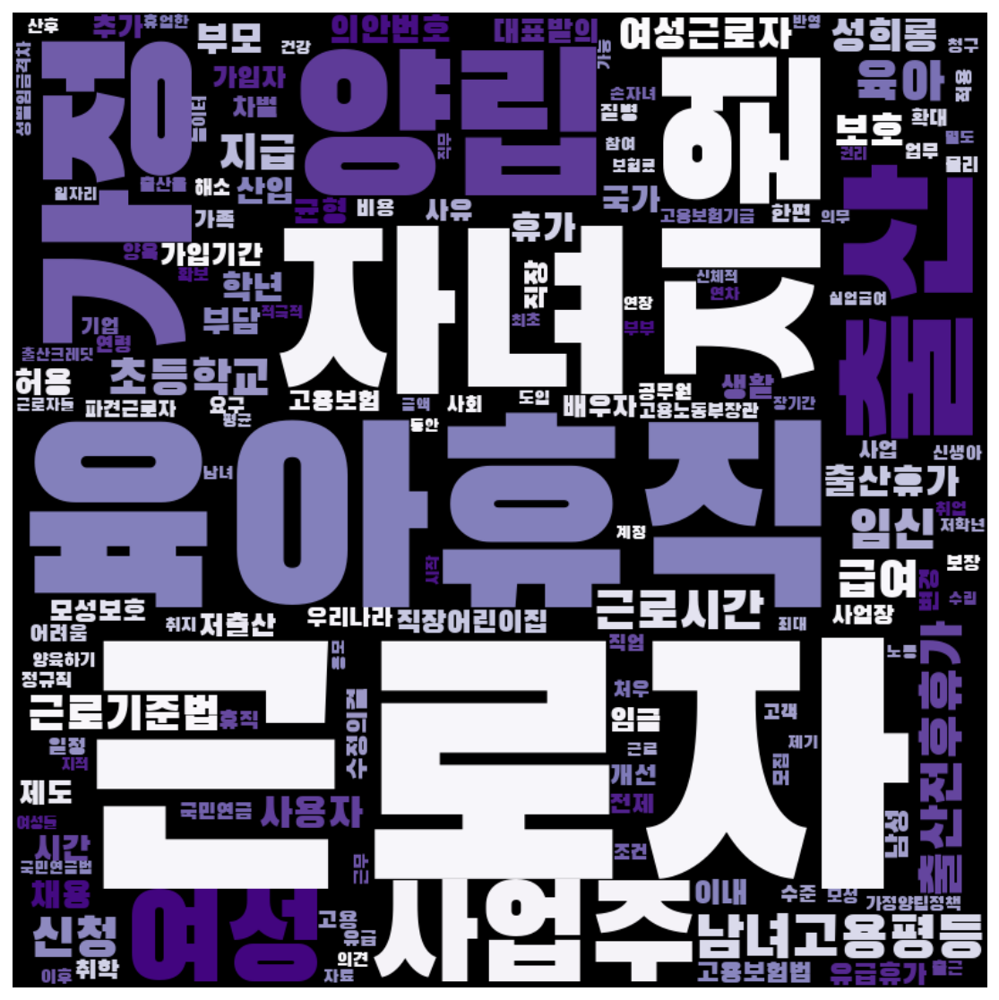

In [173]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

In [174]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-174-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [175]:
men['category'].value_counts()

4    191
3    142
5    119
2     54
1     52
0      8
Name: category, dtype: int64

In [176]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [177]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [178]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

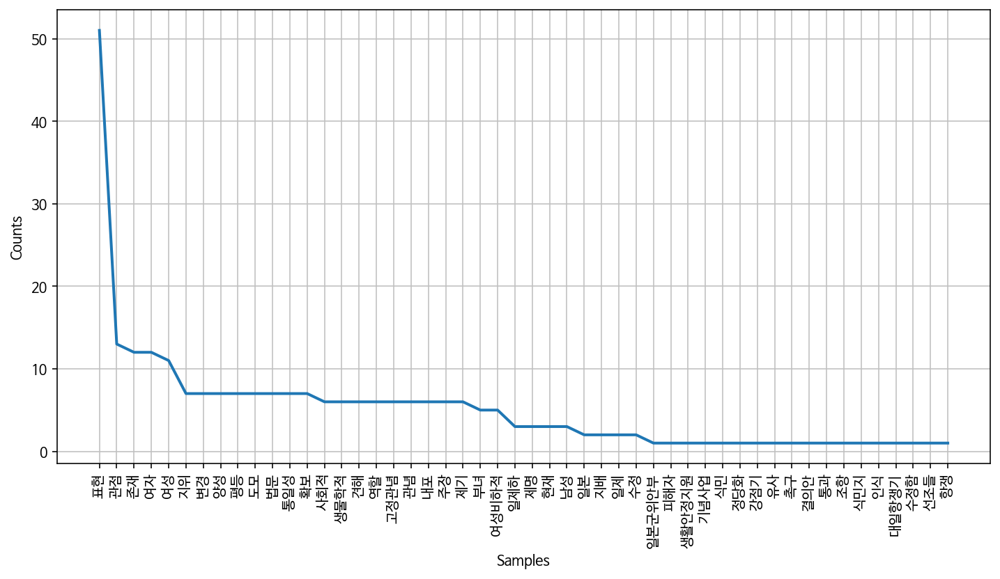

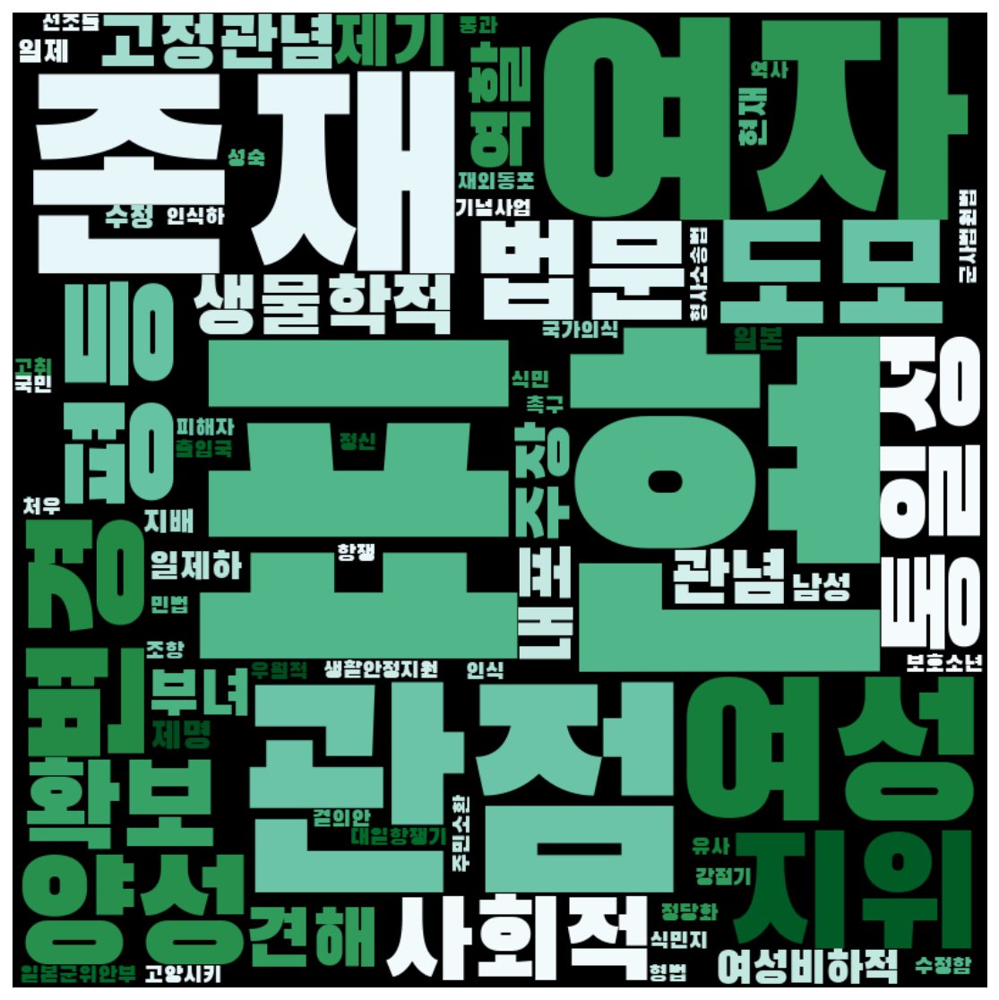

In [179]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens,'coolwarm')

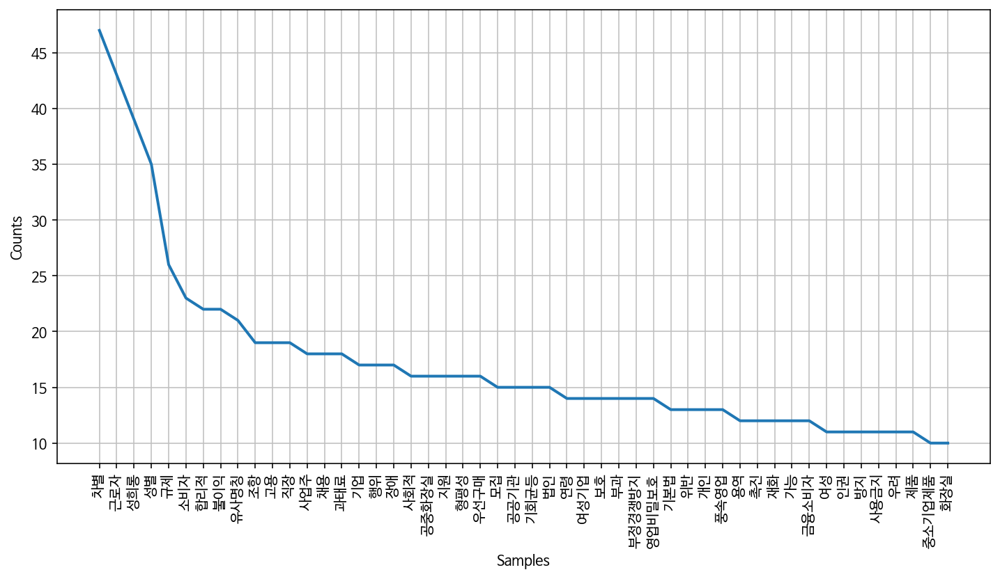

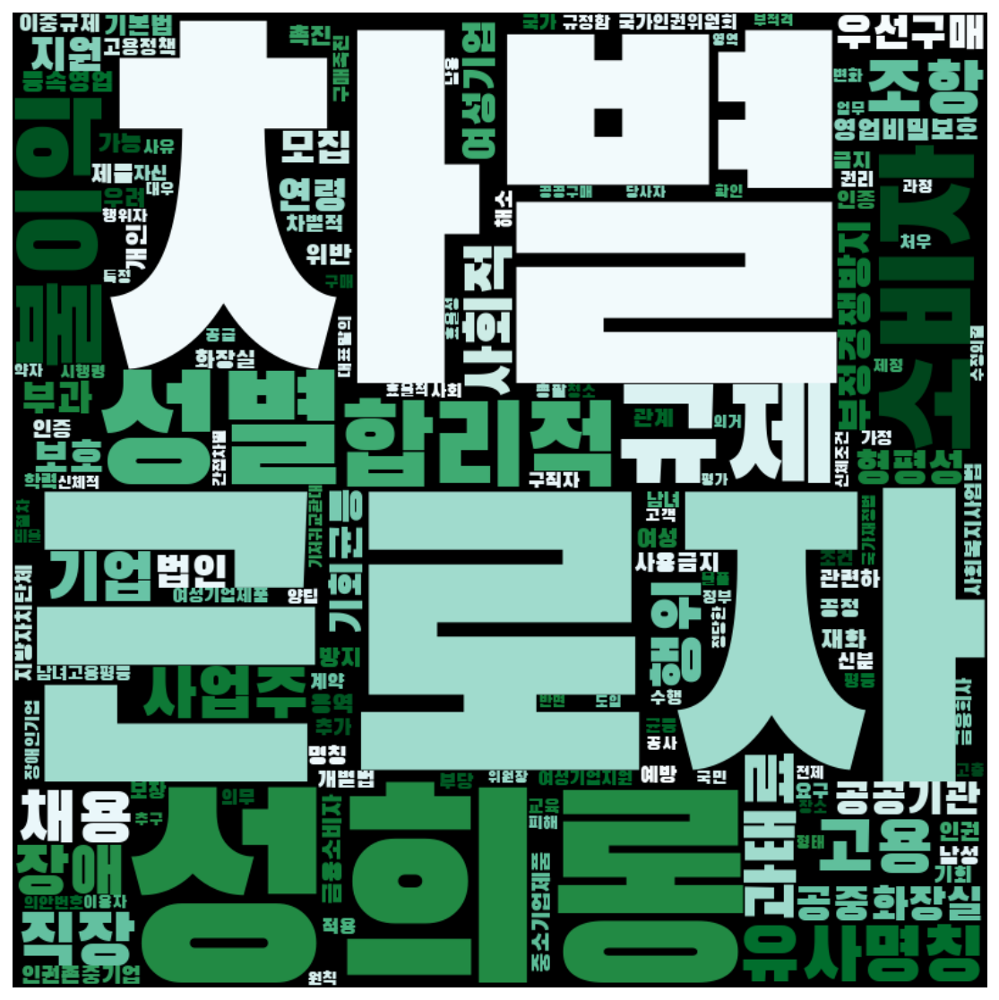

In [180]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

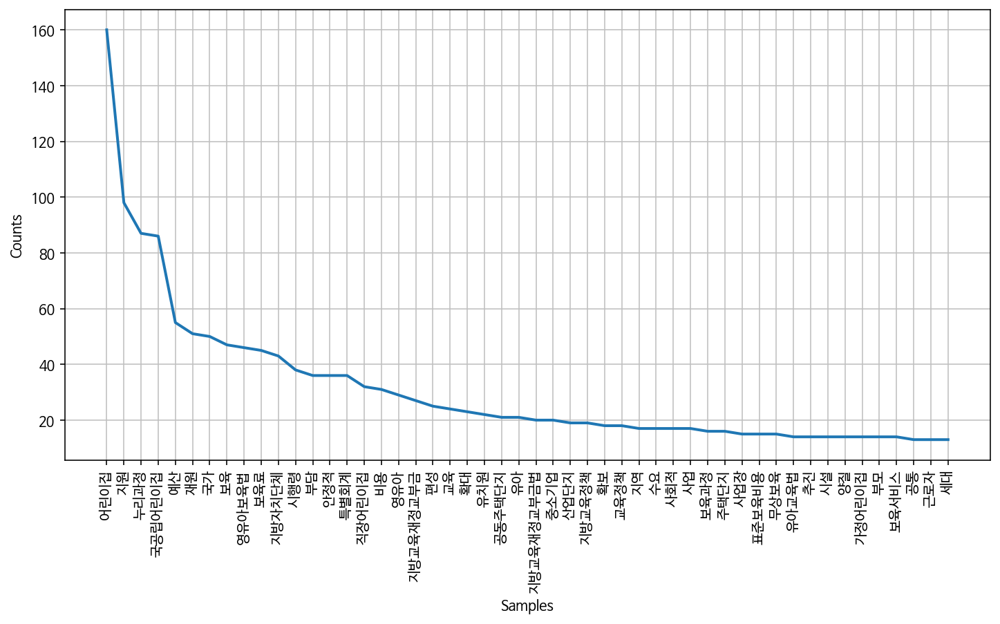

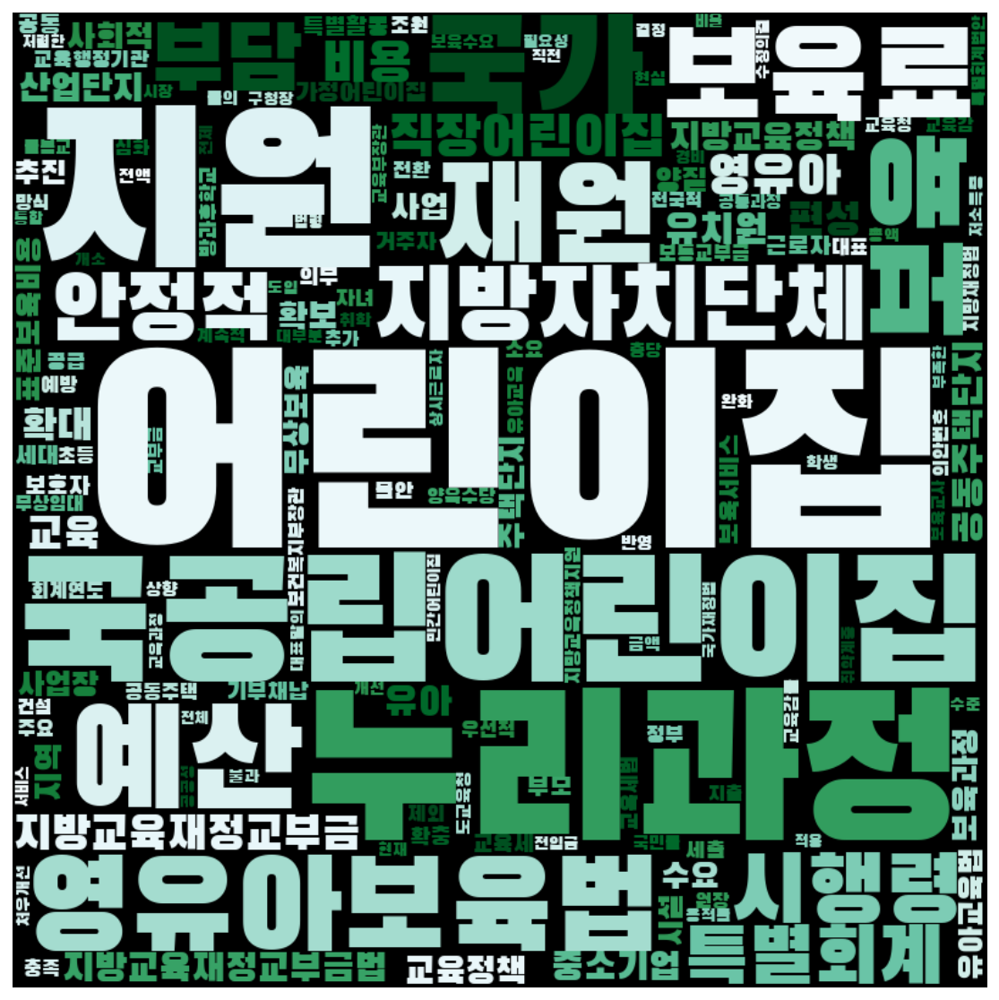

In [181]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

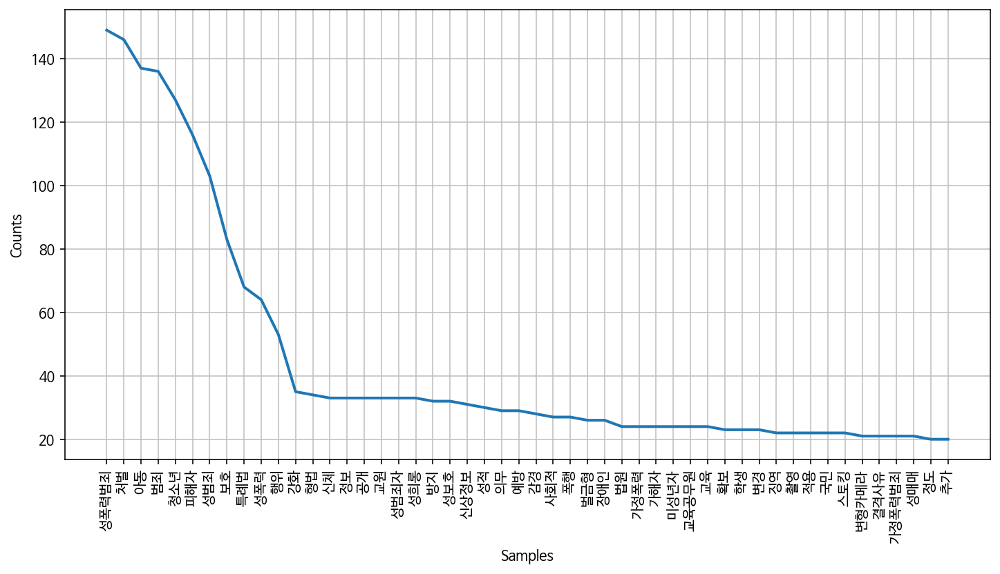

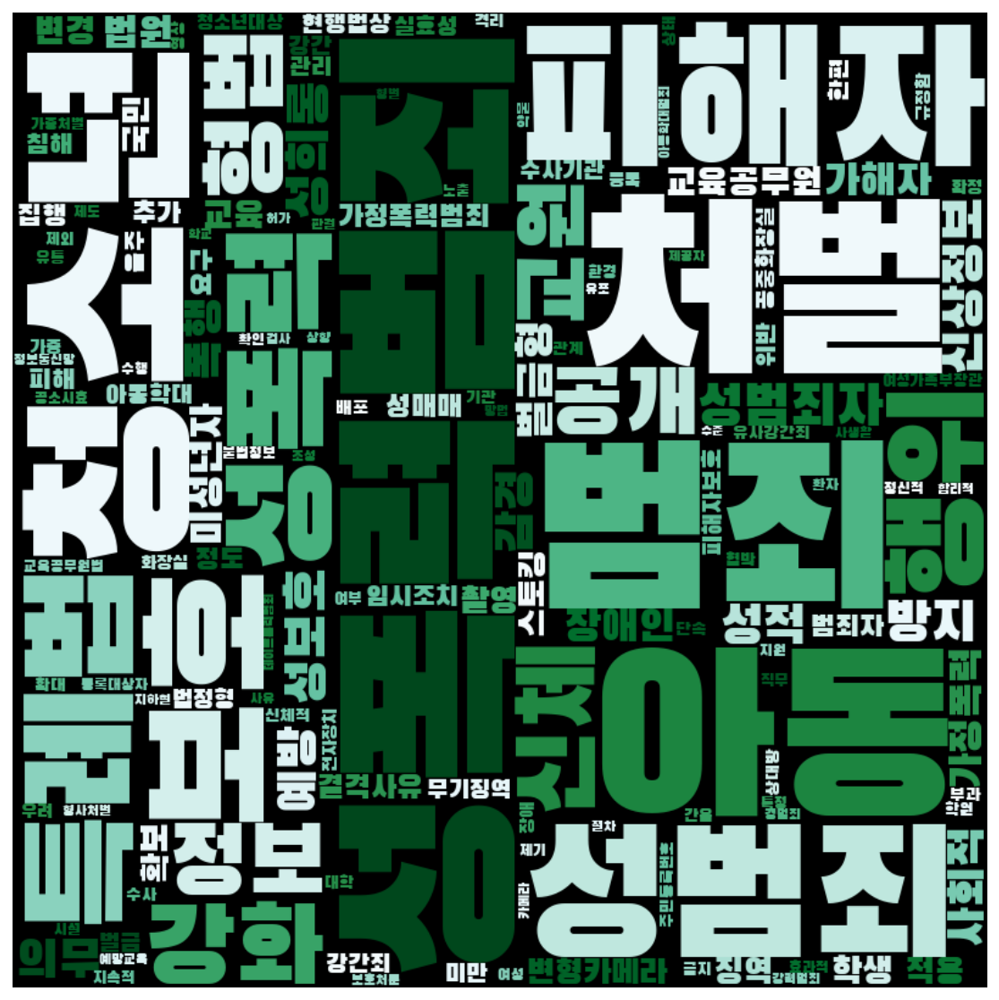

In [182]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

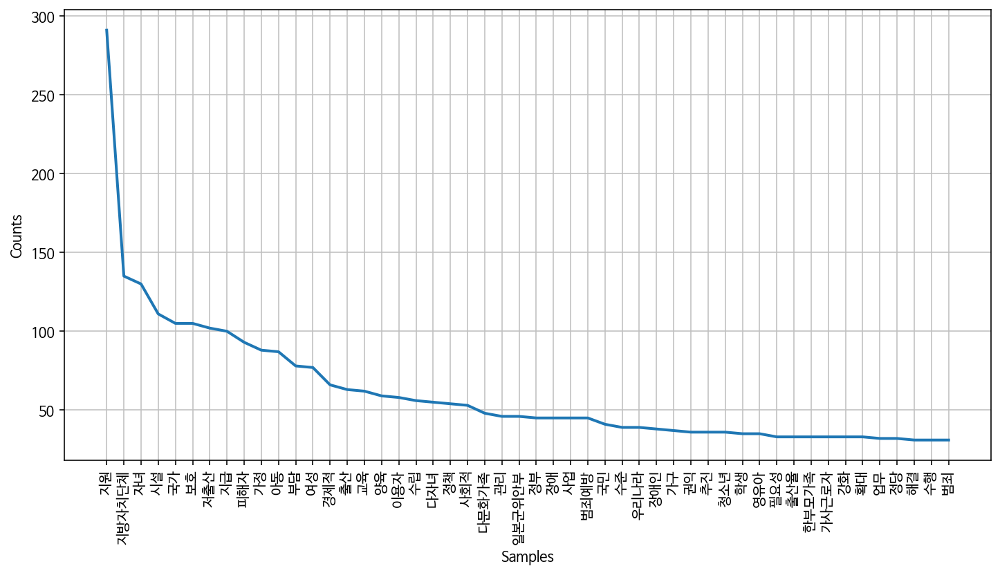

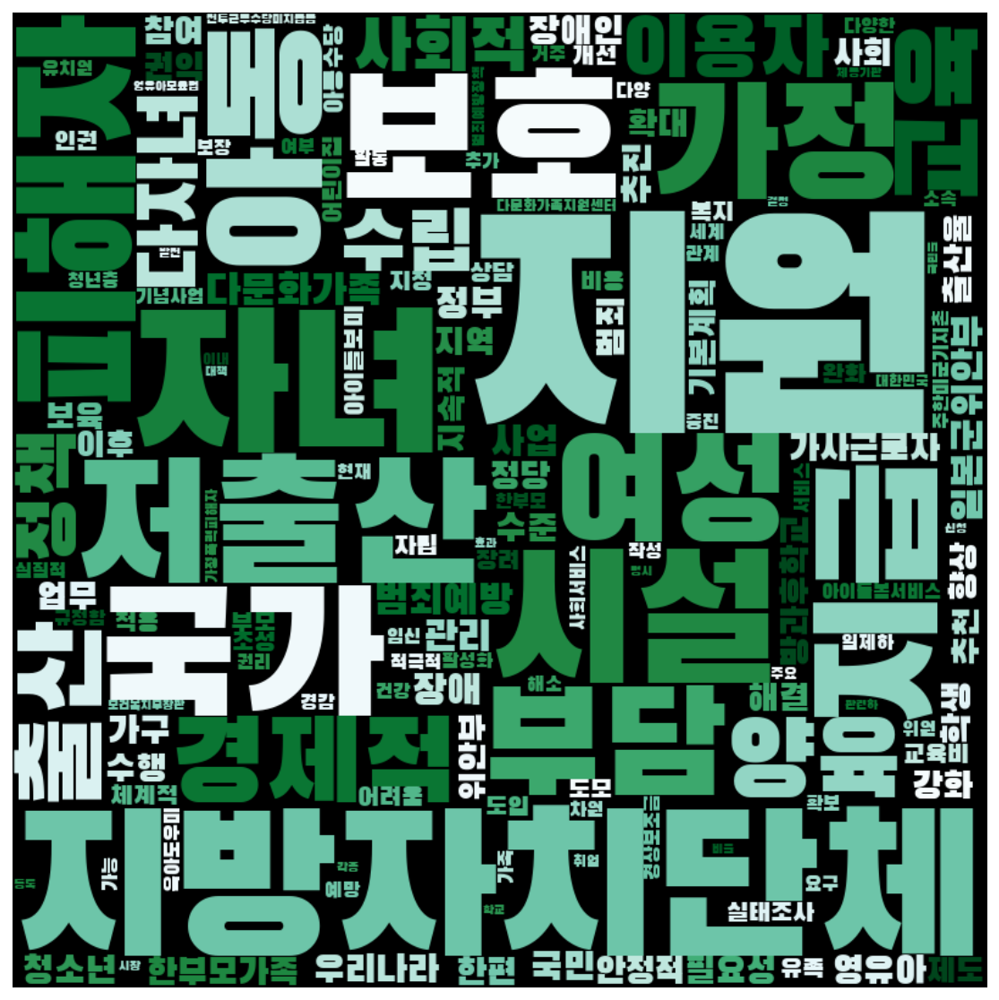

In [183]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

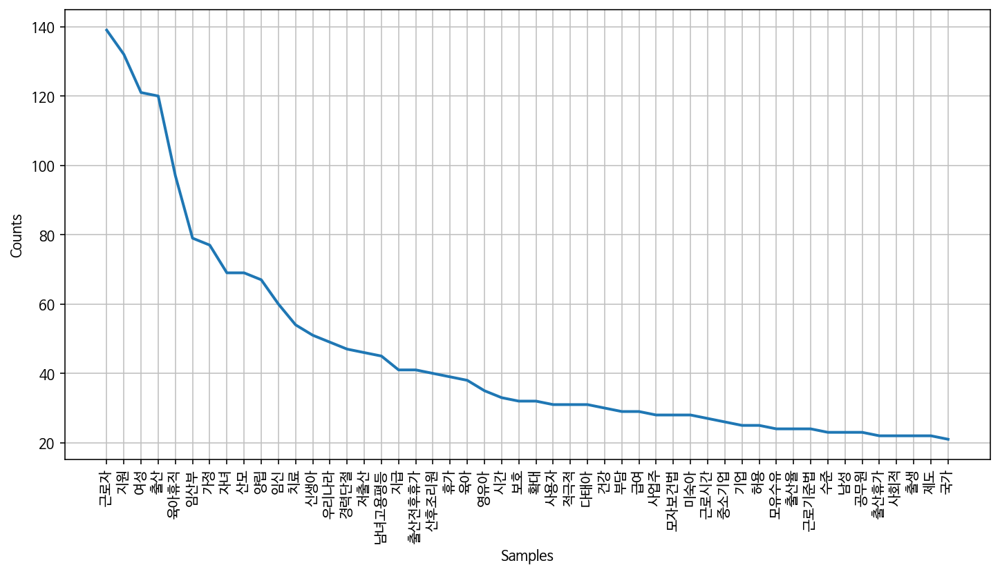

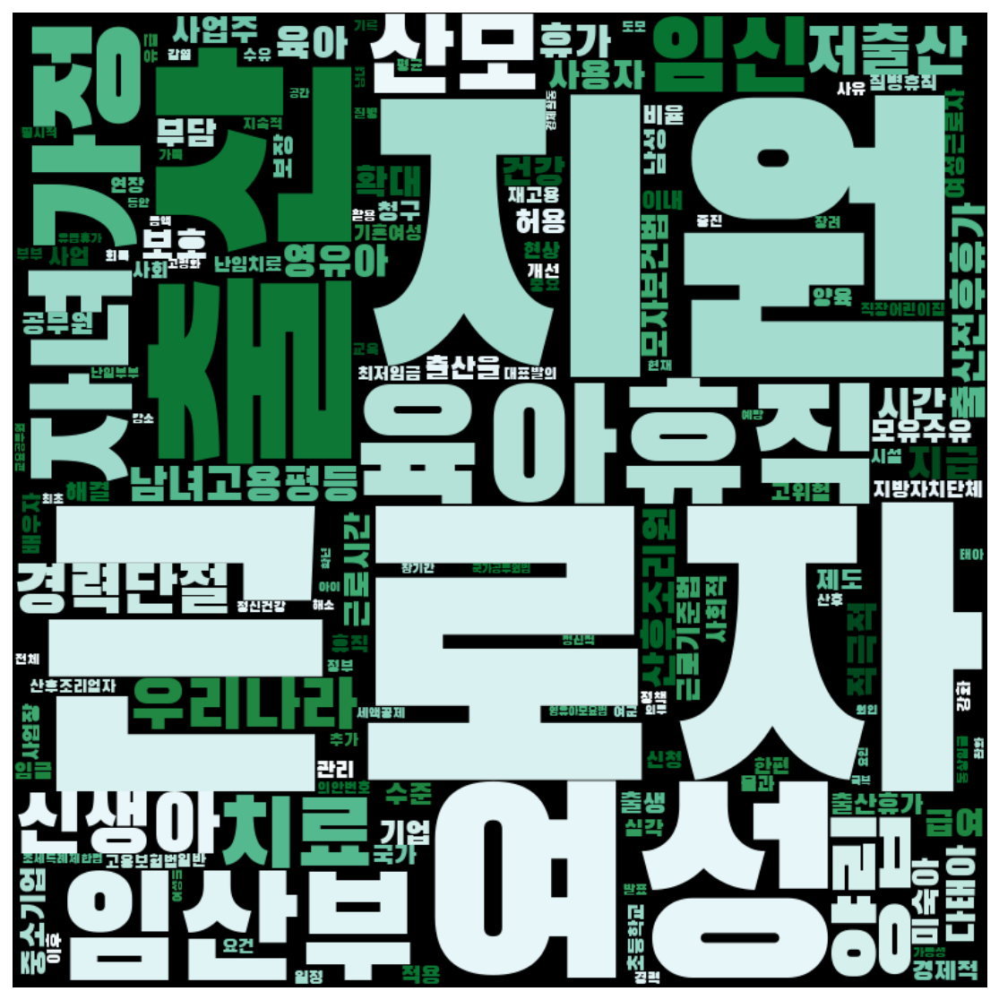

In [184]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')

## 문재인 정권 
- 2017.05.10 ~

In [79]:
moonjaein = gender[(gender['제안일자'] > datetime.date(2017,5,10))]
moonjaein.shape

(1410, 19)

In [80]:
moonjaein['성별'].value_counts()

남성    760
여성    526
Name: 성별, dtype: int64

In [81]:
pd.DataFrame(moonjaein.groupby(['정당성향','성별'])['발의자'].count())

발의자
정당성향 성별     
보수   남성  234
     여성  176
진보   남성  510
     여성  349

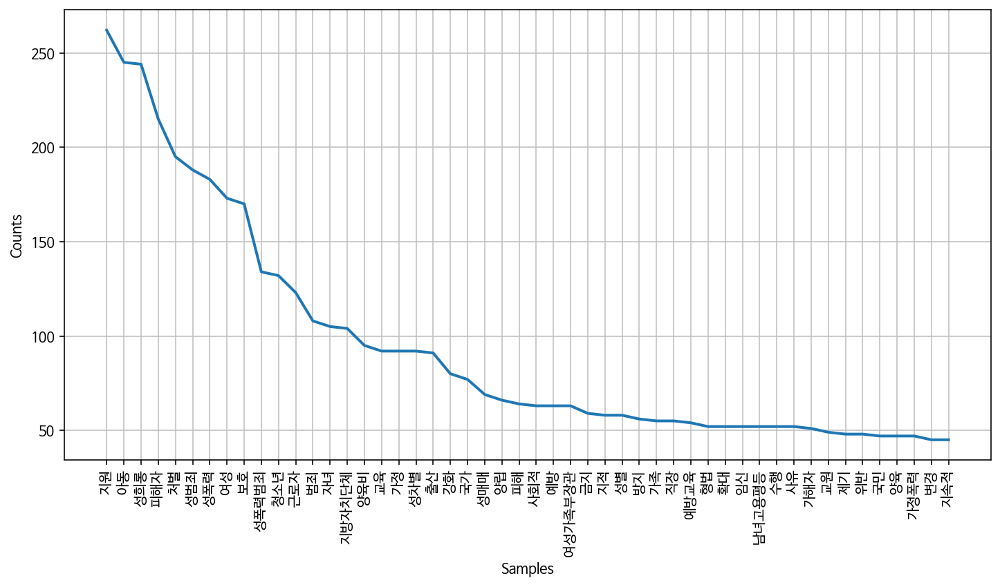

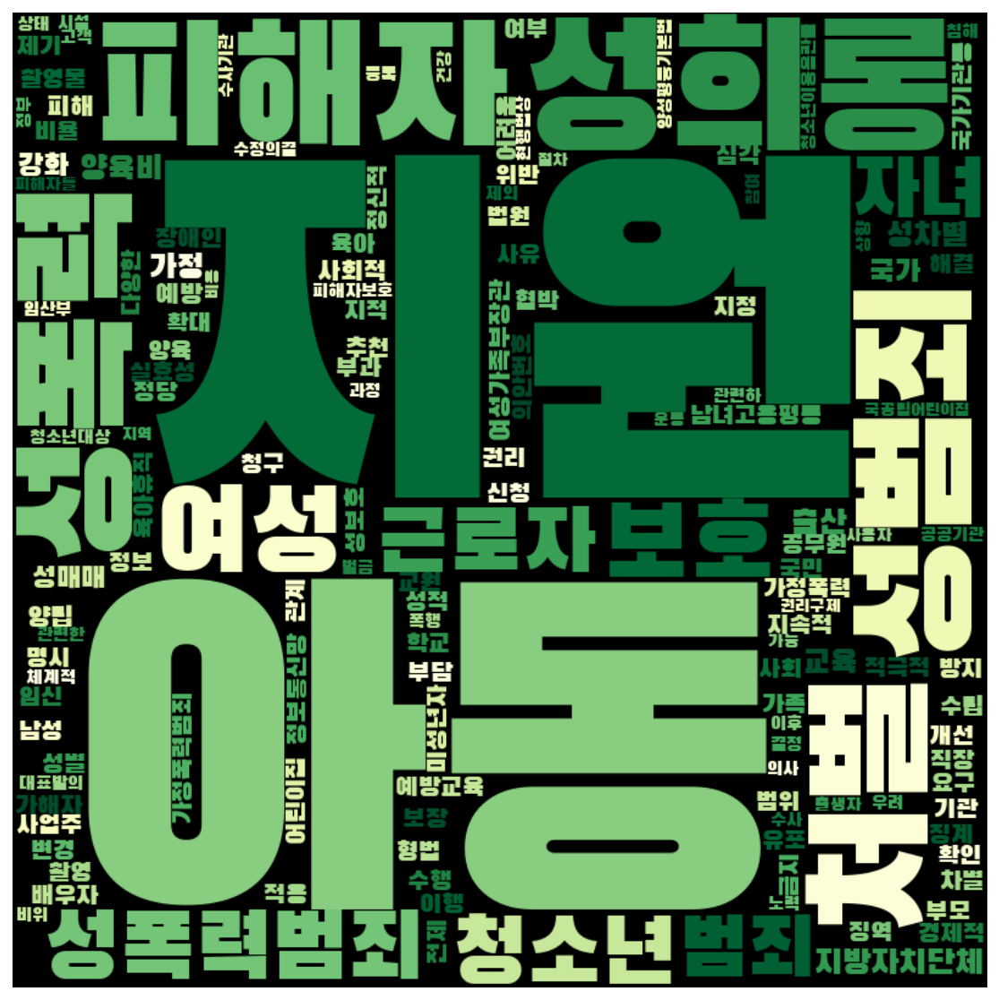

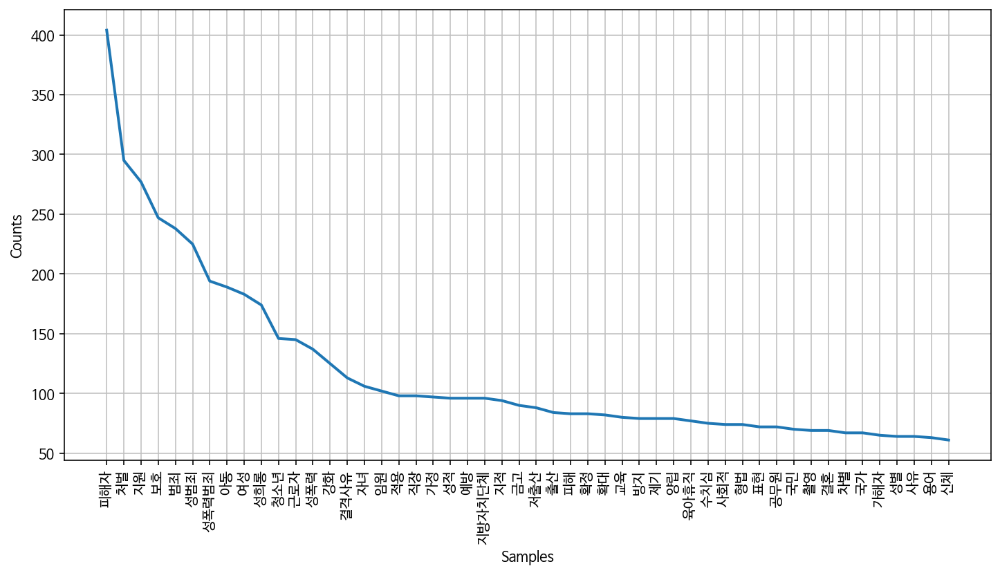

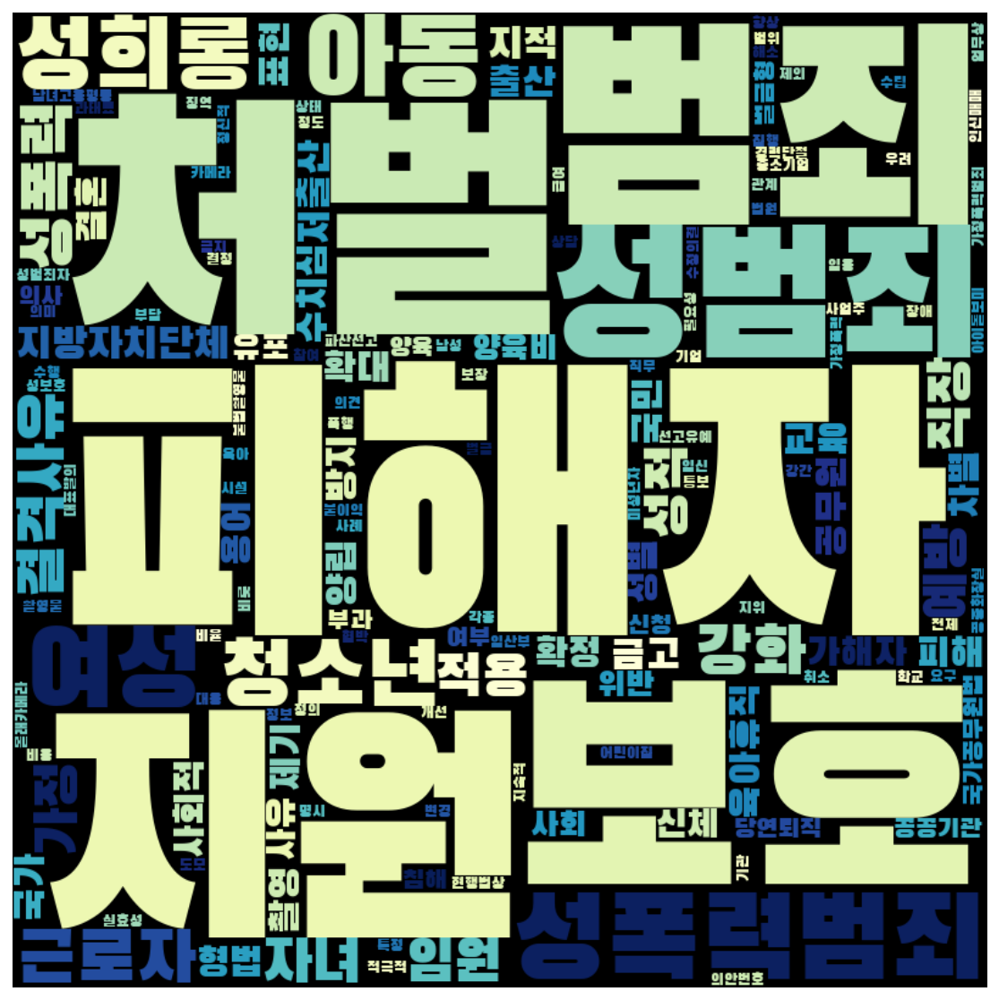

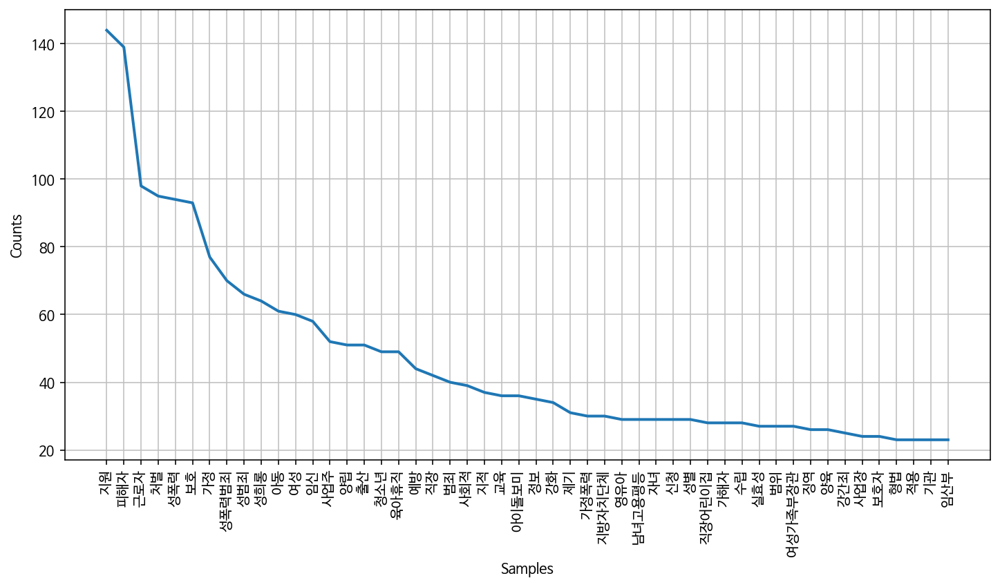

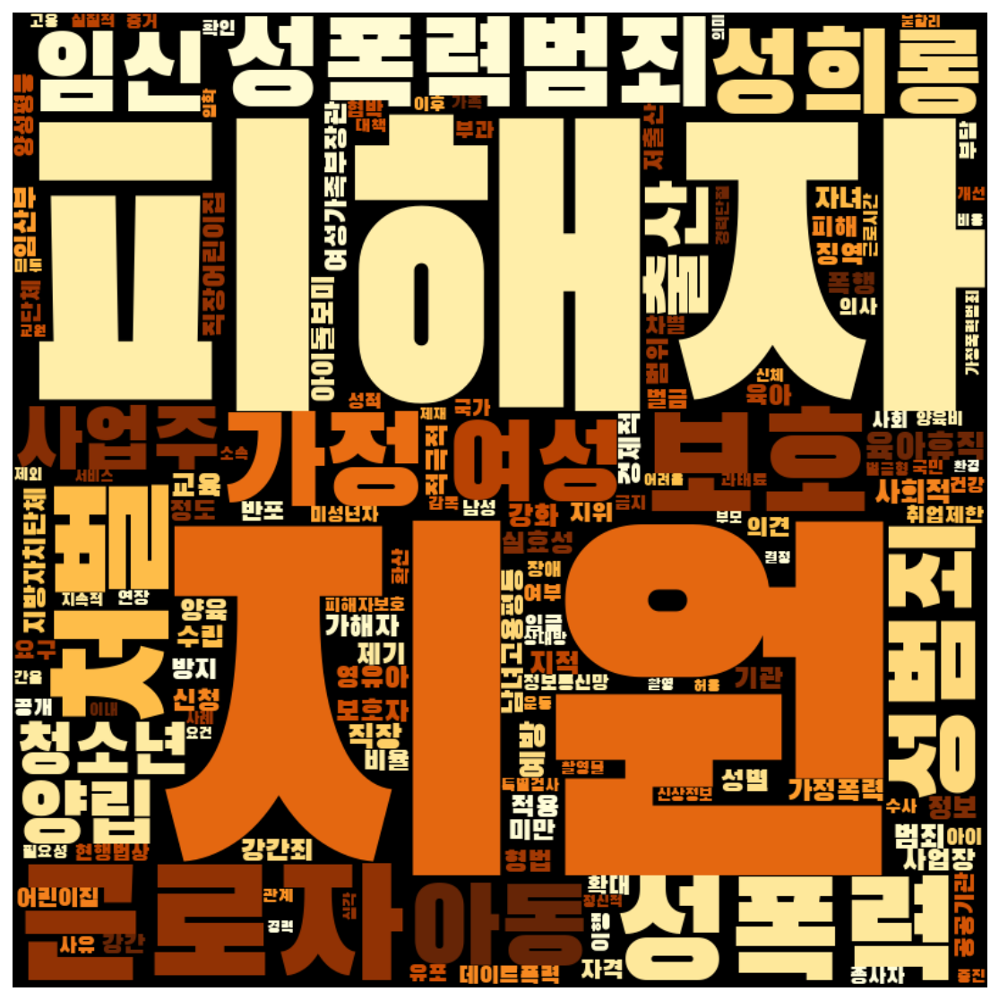

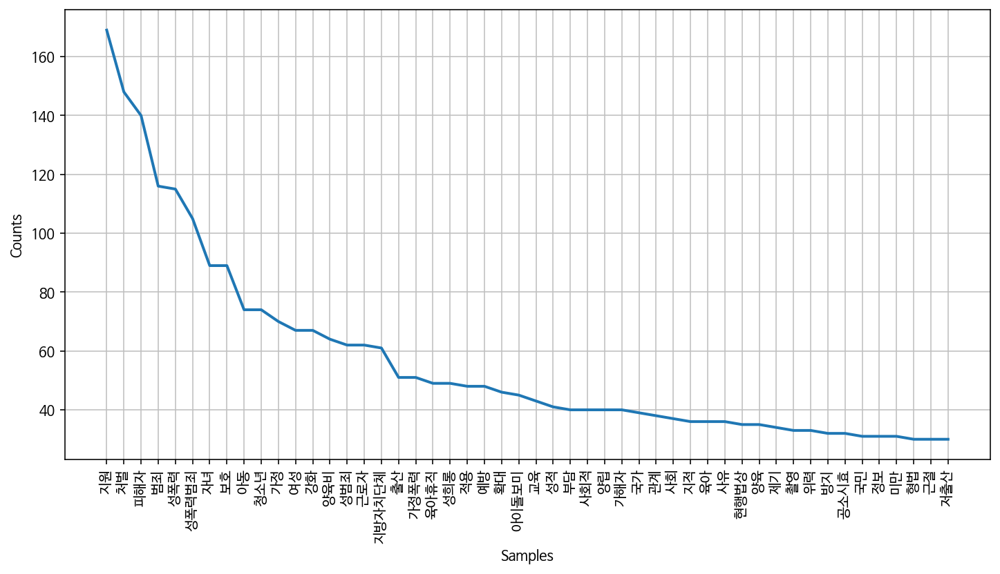

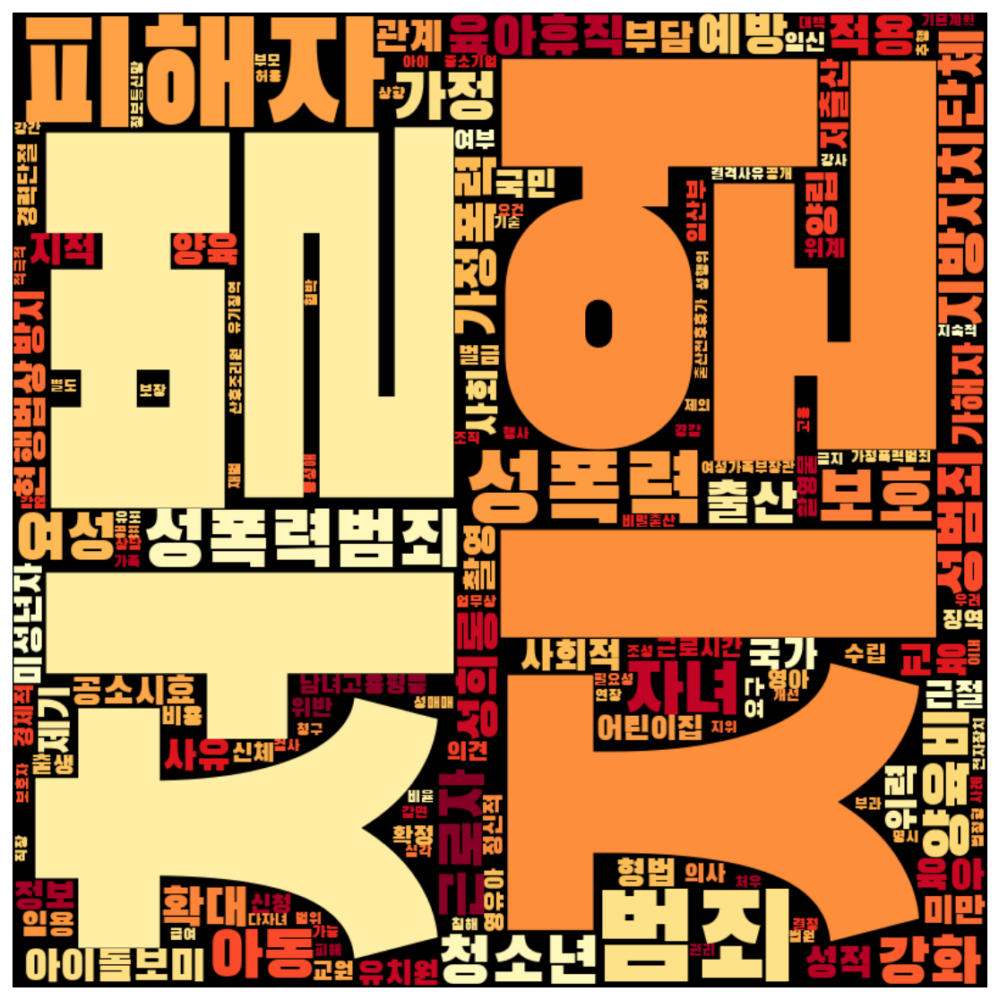

In [82]:
pro_women = moonjaein[(moonjaein['성별'] == '여성') & (moonjaein['정당성향'] == '진보')]
pro_men = moonjaein[(moonjaein['성별'] == '남성') & (moonjaein['정당성향'] == '진보')]
con_women = moonjaein[(moonjaein['성별'] == '여성') & (moonjaein['정당성향'] == '보수')]
con_men = moonjaein[(moonjaein['성별'] == '남성') & (moonjaein['정당성향'] == '보수')]

pro_women_word = total_tokens(pro_women['tokens'])
pro_men_word = total_tokens(pro_men['tokens'])
con_women_word = total_tokens(con_women['tokens'])
con_men_word = total_tokens(con_men['tokens'])

stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
pro_women_word = [each_word for each_word in pro_women_word if each_word not in stopwords]
pro_men_word = [each_word for each_word in pro_men_word if each_word not in stopwords]
con_women_word = [each_word for each_word in con_women_word if each_word not in stopwords]
con_men_word = [each_word for each_word in con_men_word if each_word not in stopwords]

frewords_vis(pro_women_word)
wordcloud_vis(pro_women_word, 'YlGn')

frewords_vis(pro_men_word)
wordcloud_vis(pro_men_word, 'YlGnBu')

frewords_vis(con_women_word)
wordcloud_vis(con_women_word, 'YlOrBr')

frewords_vis(con_men_word)
wordcloud_vis(con_men_word, 'YlOrRd')

In [189]:
model_women = Word2Vec(women['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)
model_men = Word2Vec(men['tokens'], size=100, window = 10, min_count=10, workers=4, iter=100, sg=1)

2020-10-20 14:54:24,557 : INFO : collecting all words and their counts
2020-10-20 14:54:24,564 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2020-10-20 14:54:24,585 : INFO : collected 5871 word types from a corpus of 34980 raw words and 526 sentences
2020-10-20 14:54:24,586 : INFO : Loading a fresh vocabulary
2020-10-20 14:54:24,591 : INFO : effective_min_count=10 retains 705 unique words (12% of original 5871, drops 5166)
2020-10-20 14:54:24,592 : INFO : effective_min_count=10 leaves 22965 word corpus (65% of original 34980, drops 12015)
2020-10-20 14:54:24,596 : INFO : deleting the raw counts dictionary of 5871 items
2020-10-20 14:54:24,597 : INFO : sample=0.001 downsamples 71 most-common words
2020-10-20 14:54:24,598 : INFO : downsampling leaves estimated 19176 word corpus (83.5% of prior 22965)
2020-10-20 14:54:24,601 : INFO : estimated required memory for 705 words and 100 dimensions: 916500 bytes
2020-10-20 14:54:24,602 : INFO : resetting layer weight

2020-10-20 14:54:25,966 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:25,977 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:25,987 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:25,988 : INFO : EPOCH - 15 : training on 34980 raw words (19282 effective words) took 0.1s, 254484 effective words/s
2020-10-20 14:54:26,041 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:26,059 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:26,065 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:26,071 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:26,072 : INFO : EPOCH - 16 : training on 34980 raw words (19185 effective words) took 0.1s, 246853 effective words/s
2020-10-20 14:54:26,116 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:27,304 : INFO : EPOCH - 31 : training on 34980 raw words (19217 effective words) took 0.1s, 234649 effective words/s
2020-10-20 14:54:27,352 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:27,366 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:27,376 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:27,382 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:27,384 : INFO : EPOCH - 32 : training on 34980 raw words (19228 effective words) took 0.1s, 249859 effective words/s
2020-10-20 14:54:27,441 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:27,448 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:27,461 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:27,469 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:28,662 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:28,667 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:28,668 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:28,669 : INFO : EPOCH - 48 : training on 34980 raw words (19122 effective words) took 0.1s, 277840 effective words/s
2020-10-20 14:54:28,720 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:28,737 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:28,743 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:28,746 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:28,751 : INFO : EPOCH - 49 : training on 34980 raw words (19135 effective words) took 0.1s, 244418 effective words/s
2020-10-20 14:54:28,794 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:29,940 : INFO : EPOCH - 64 : training on 34980 raw words (19193 effective words) took 0.1s, 266688 effective words/s
2020-10-20 14:54:29,990 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:30,004 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:30,016 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:30,019 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:30,021 : INFO : EPOCH - 65 : training on 34980 raw words (19156 effective words) took 0.1s, 252342 effective words/s
2020-10-20 14:54:30,071 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:30,081 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:30,091 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:30,099 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:31,290 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:31,299 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:31,304 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:31,305 : INFO : EPOCH - 81 : training on 34980 raw words (19216 effective words) took 0.1s, 267688 effective words/s
2020-10-20 14:54:31,353 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:31,376 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:31,379 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:31,381 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:31,382 : INFO : EPOCH - 82 : training on 34980 raw words (19202 effective words) took 0.1s, 285345 effective words/s
2020-10-20 14:54:31,423 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:32,557 : INFO : EPOCH - 97 : training on 34980 raw words (19225 effective words) took 0.1s, 253269 effective words/s
2020-10-20 14:54:32,614 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:32,622 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:32,630 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:32,642 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:32,643 : INFO : EPOCH - 98 : training on 34980 raw words (19199 effective words) took 0.1s, 234565 effective words/s
2020-10-20 14:54:32,687 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:32,708 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:32,717 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:32,718 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:34,468 : INFO : EPOCH - 11 : training on 48537 raw words (30100 effective words) took 0.1s, 247568 effective words/s
2020-10-20 14:54:34,546 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:34,551 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:34,553 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:34,580 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:34,581 : INFO : EPOCH - 12 : training on 48537 raw words (30072 effective words) took 0.1s, 281342 effective words/s
2020-10-20 14:54:34,661 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:34,662 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:34,666 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:34,697 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:36,547 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:36,552 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:36,595 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:36,596 : INFO : EPOCH - 28 : training on 48537 raw words (30001 effective words) took 0.1s, 239721 effective words/s
2020-10-20 14:54:36,681 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:36,685 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:36,687 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:36,729 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:36,730 : INFO : EPOCH - 29 : training on 48537 raw words (30028 effective words) took 0.1s, 240249 effective words/s
2020-10-20 14:54:36,807 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:38,652 : INFO : EPOCH - 44 : training on 48537 raw words (30056 effective words) took 0.1s, 238875 effective words/s
2020-10-20 14:54:38,733 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:38,738 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:38,738 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:38,783 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:38,785 : INFO : EPOCH - 45 : training on 48537 raw words (30058 effective words) took 0.1s, 232947 effective words/s
2020-10-20 14:54:38,874 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:38,876 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:38,877 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:38,912 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:40,734 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:40,737 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:40,768 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:40,769 : INFO : EPOCH - 61 : training on 48537 raw words (30129 effective words) took 0.1s, 276925 effective words/s
2020-10-20 14:54:40,857 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:40,860 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:40,861 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:40,912 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:40,914 : INFO : EPOCH - 62 : training on 48537 raw words (30016 effective words) took 0.1s, 227489 effective words/s
2020-10-20 14:54:40,993 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

2020-10-20 14:54:42,805 : INFO : EPOCH - 77 : training on 48537 raw words (30061 effective words) took 0.1s, 259183 effective words/s
2020-10-20 14:54:42,886 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:42,889 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:42,891 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:42,927 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:42,928 : INFO : EPOCH - 78 : training on 48537 raw words (30045 effective words) took 0.1s, 268088 effective words/s
2020-10-20 14:54:43,007 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:43,010 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:43,015 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:43,043 : INFO : worker thread finished; awaiting finish of 0 more threads
2020

2020-10-20 14:54:44,843 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:44,851 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:44,889 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:44,892 : INFO : EPOCH - 94 : training on 48537 raw words (30014 effective words) took 0.1s, 243356 effective words/s
2020-10-20 14:54:44,960 : INFO : worker thread finished; awaiting finish of 3 more threads
2020-10-20 14:54:44,969 : INFO : worker thread finished; awaiting finish of 2 more threads
2020-10-20 14:54:44,976 : INFO : worker thread finished; awaiting finish of 1 more threads
2020-10-20 14:54:45,001 : INFO : worker thread finished; awaiting finish of 0 more threads
2020-10-20 14:54:45,002 : INFO : EPOCH - 95 : training on 48537 raw words (30067 effective words) took 0.1s, 282315 effective words/s
2020-10-20 14:54:45,078 : INFO : worker thread finished; awaiting finish of 3 more threads
2020

In [190]:
print(model_women.wv.most_similar('여성'))

2020-10-20 14:54:45,663 : INFO : precomputing L2-norms of word weight vectors


[('남성', 0.5992206335067749), ('비율', 0.5042550563812256), ('임원', 0.43938660621643066), ('세계', 0.42925703525543213), ('임기만료', 0.41442710161209106), ('선출공직', 0.3824389576911926), ('남녀동수', 0.37456271052360535), ('확대', 0.3669586479663849), ('결혼', 0.36455968022346497), ('우리나라', 0.35906362533569336)]


In [191]:
print(model_men.wv.most_similar('여성'))

2020-10-20 14:54:45,672 : INFO : precomputing L2-norms of word weight vectors


[('중소기업', 0.5057257413864136), ('기업', 0.47995859384536743), ('여자', 0.4784560799598694), ('재고용', 0.4765865206718445), ('남성', 0.4705030620098114), ('세액공제', 0.4450126886367798), ('인력난', 0.4353387653827667), ('중견기업', 0.42229682207107544), ('경력단절', 0.420254647731781), ('우리나라', 0.41759809851646423)]


In [192]:
women_word = total_tokens(women['tokens'])
men_word = total_tokens(men['tokens'])

In [193]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설','한편','문제','지급','제공','항제','사용','근거','대상',
            '이유','증가','제도','사업','정책','우리나라','행위','특례법','불구','수준','추가','관리','확보','의무','업무']
women_word = [each_word for each_word in women_word if each_word not in stopwords]
men_word = [each_word for each_word in men_word if each_word not in stopwords]

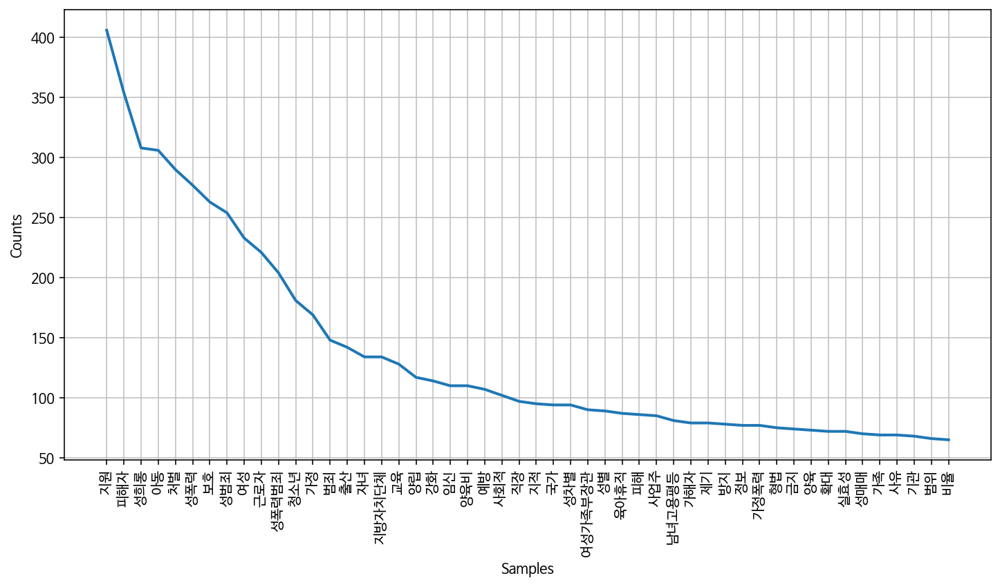

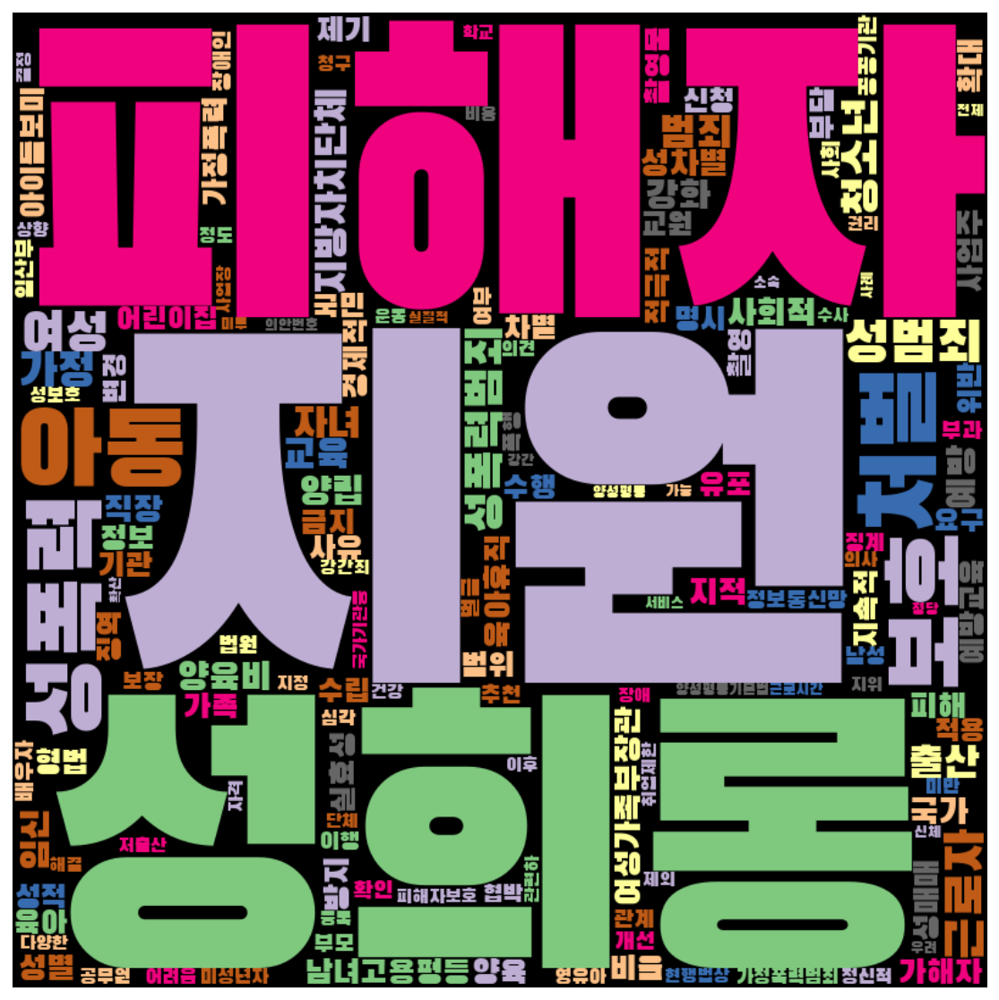

In [222]:
frewords_vis(women_word)
wordcloud_vis(women_word, 'Accent')

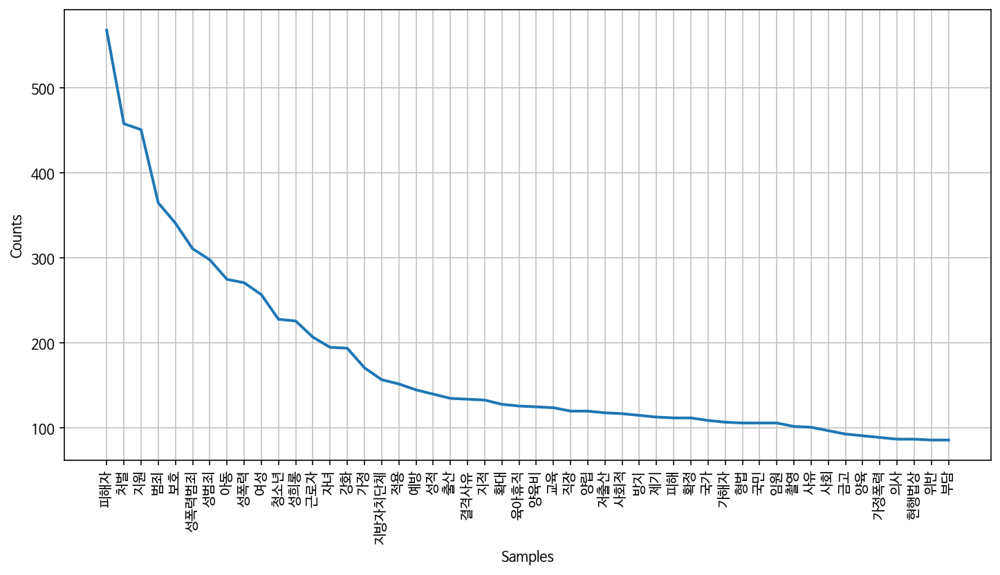

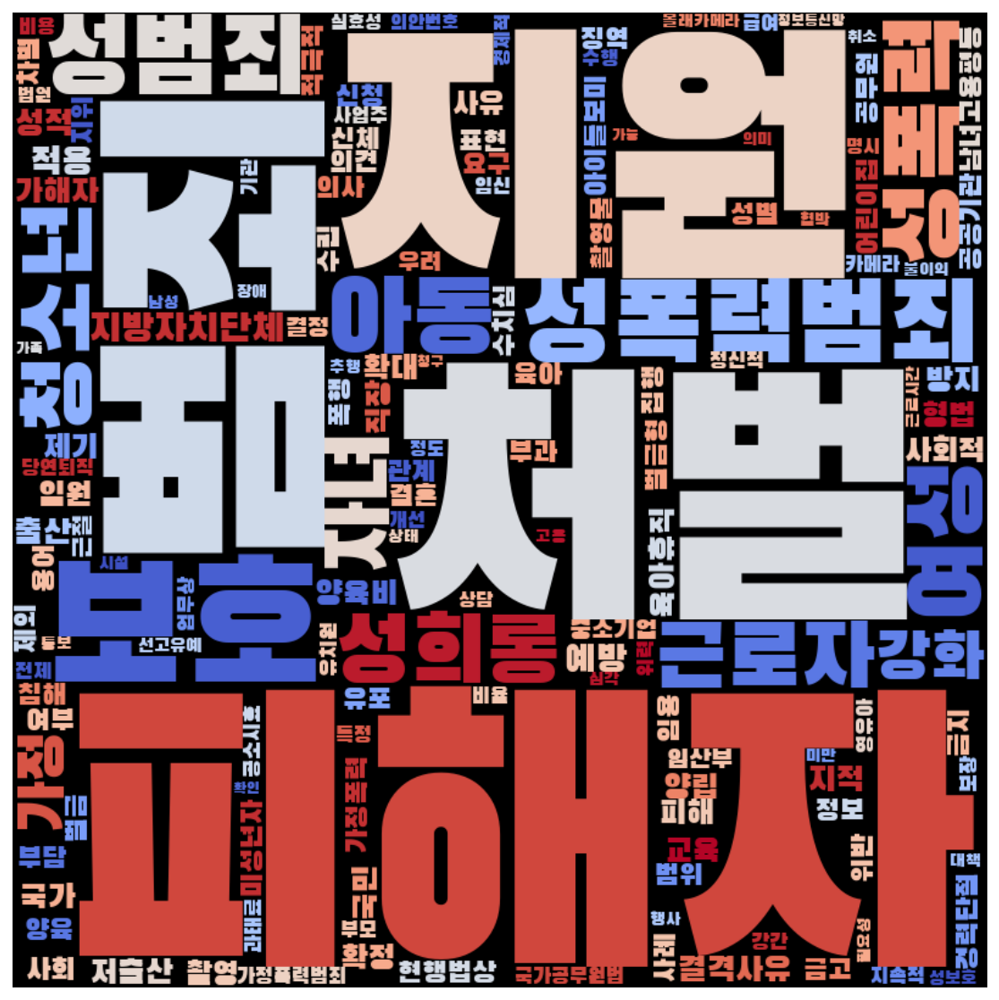

In [224]:
frewords_vis(men_word)
wordcloud_vis(men_word,'coolwarm')

In [225]:
women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))

/usr/local/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3372: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
<ipython-input-225-87b19f55aed6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['문장벡터'] = women['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_women))
<ipython-input-225-87b19f55aed6>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['문장벡터'] = men['tokens'].apply(lambda x: get_sentence_mean_vector(x, model_men))


In [228]:
women = women[women['명사수'] > 1]

# K means 수행 
word_vectors_women = women['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_women)
women['category'] = idx

<ipython-input-228-4d757fdbfe45>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  women['category'] = idx


In [229]:
women['category'].value_counts()

0    138
4    118
5    116
3     77
1     45
2     31
Name: category, dtype: int64

In [230]:
women_g1 = women[women['category'] == 0]
women_g2 = women[women['category'] == 1]
women_g3 = women[women['category'] == 2]
women_g4 = women[women['category'] == 3]
women_g5 = women[women['category'] == 4]
women_g6 = women[women['category'] == 5]

In [231]:
women_g1_tokens = total_tokens(women_g1['tokens'])
women_g2_tokens = total_tokens(women_g2['tokens'])
women_g3_tokens = total_tokens(women_g3['tokens'])
women_g4_tokens = total_tokens(women_g4['tokens'])
women_g5_tokens = total_tokens(women_g5['tokens'])
women_g6_tokens = total_tokens(women_g6['tokens'])

In [232]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
women_g1_tokens = [each_word for each_word in women_g1_tokens if each_word not in stopwords]
women_g2_tokens = [each_word for each_word in women_g2_tokens if each_word not in stopwords]
women_g3_tokens = [each_word for each_word in women_g3_tokens if each_word not in stopwords]
women_g4_tokens = [each_word for each_word in women_g4_tokens if each_word not in stopwords]
women_g5_tokens = [each_word for each_word in women_g5_tokens if each_word not in stopwords]
women_g6_tokens = [each_word for each_word in women_g6_tokens if each_word not in stopwords]

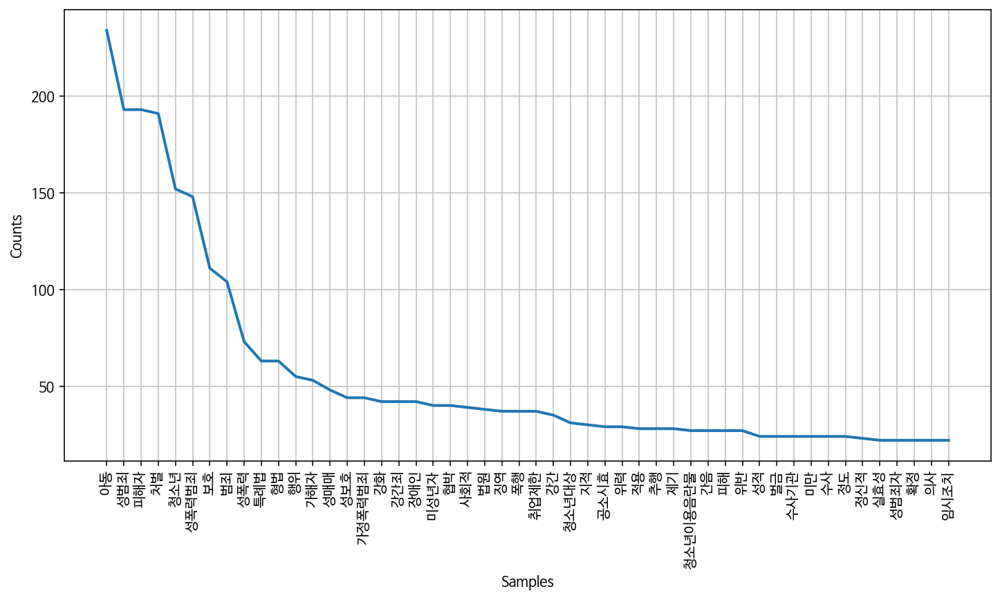

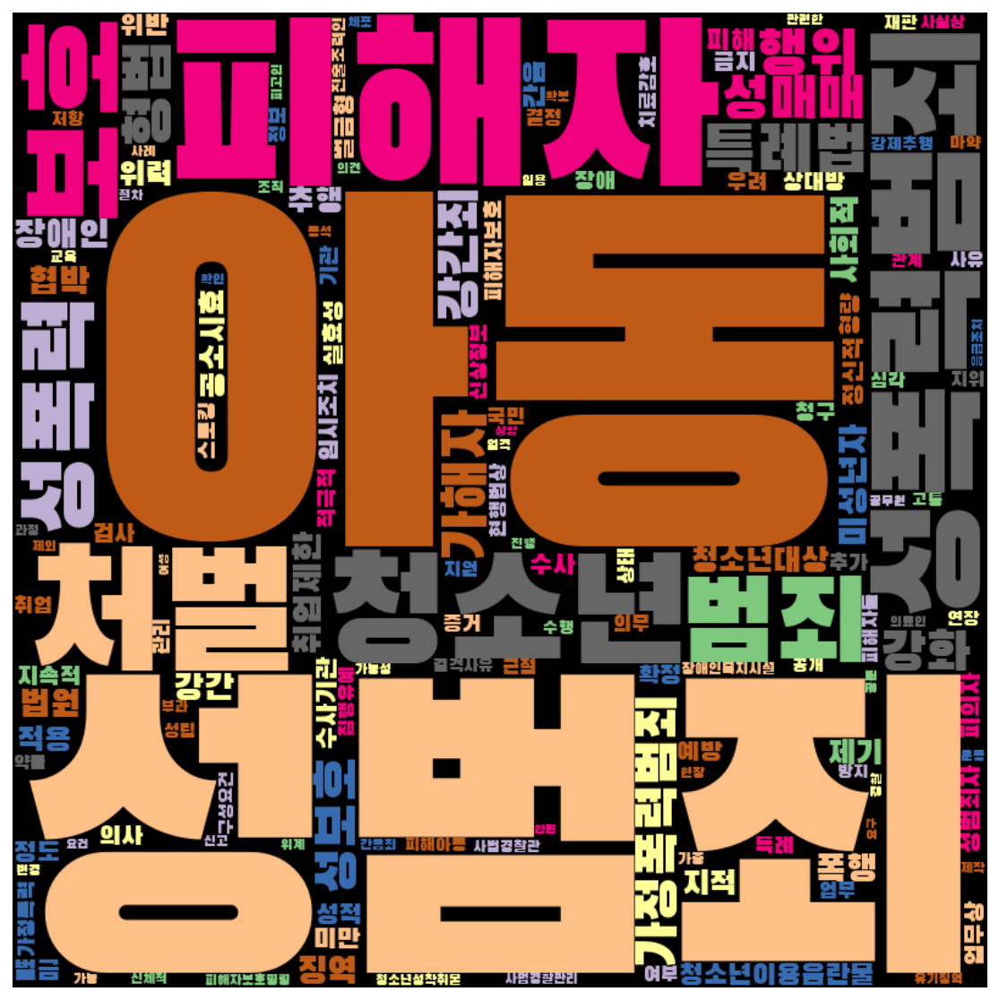

In [233]:
frewords_vis(women_g1_tokens)
wordcloud_vis(women_g1_tokens, 'Accent')

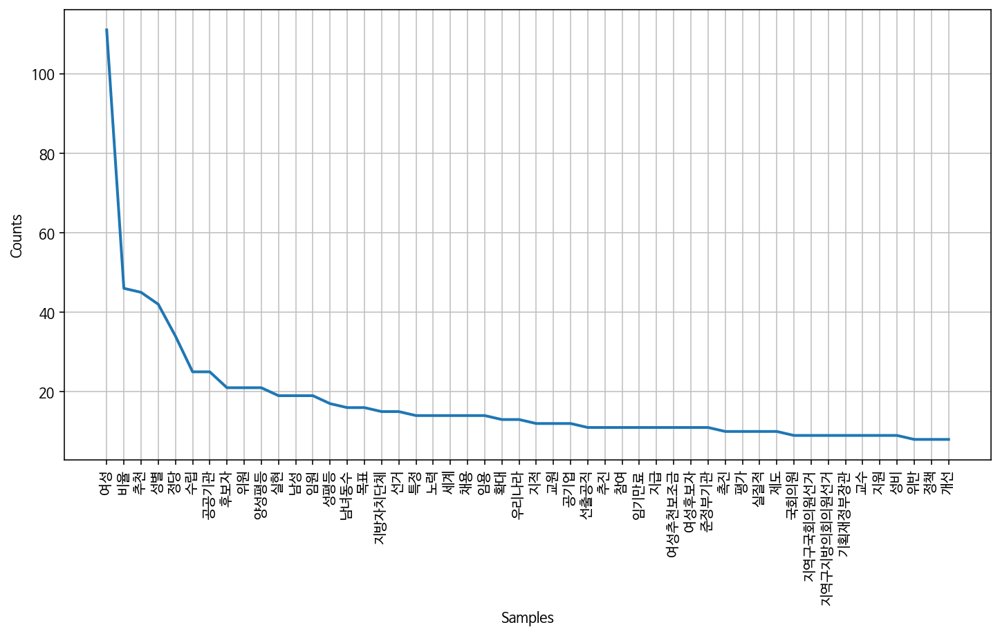

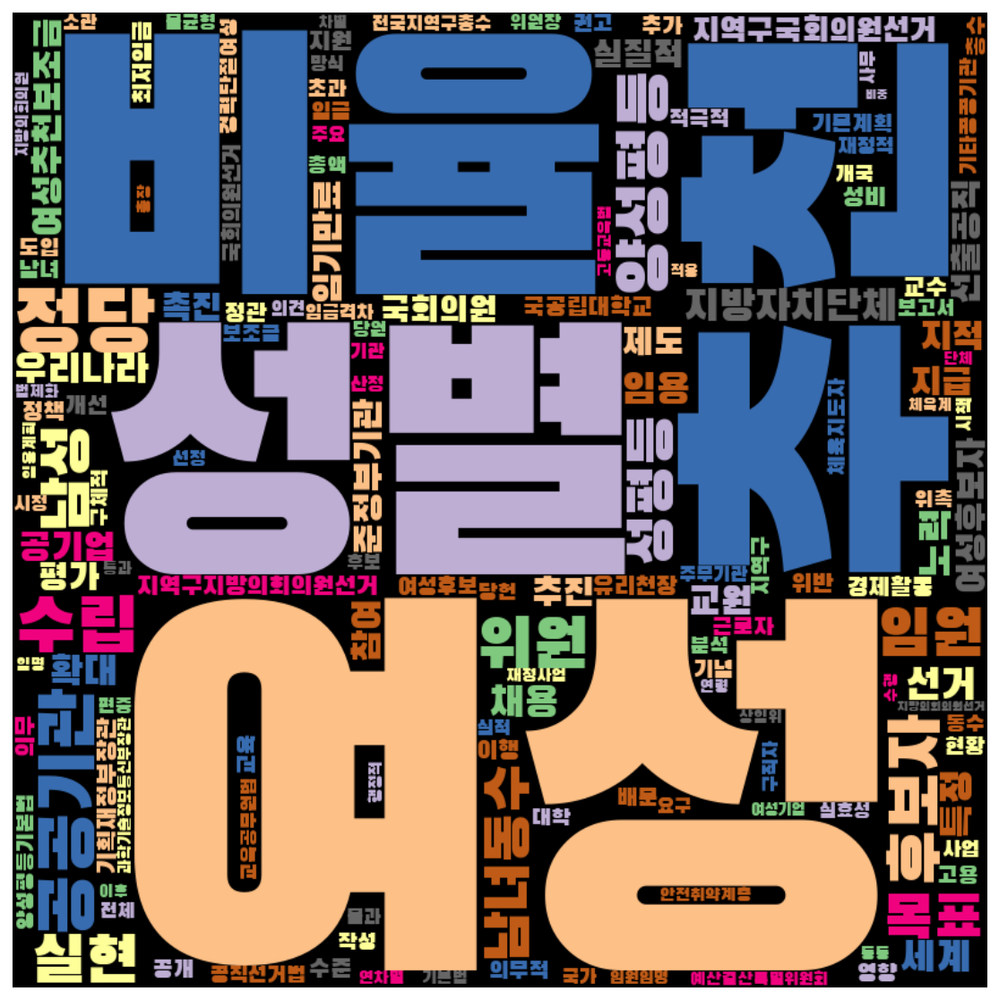

In [234]:
frewords_vis(women_g2_tokens)
wordcloud_vis(women_g2_tokens,'Accent')

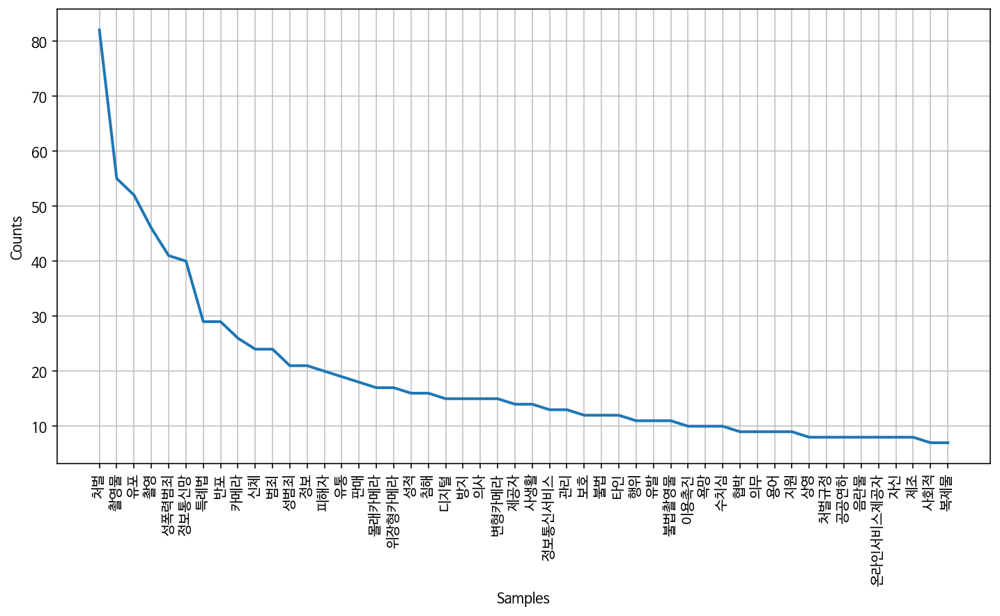

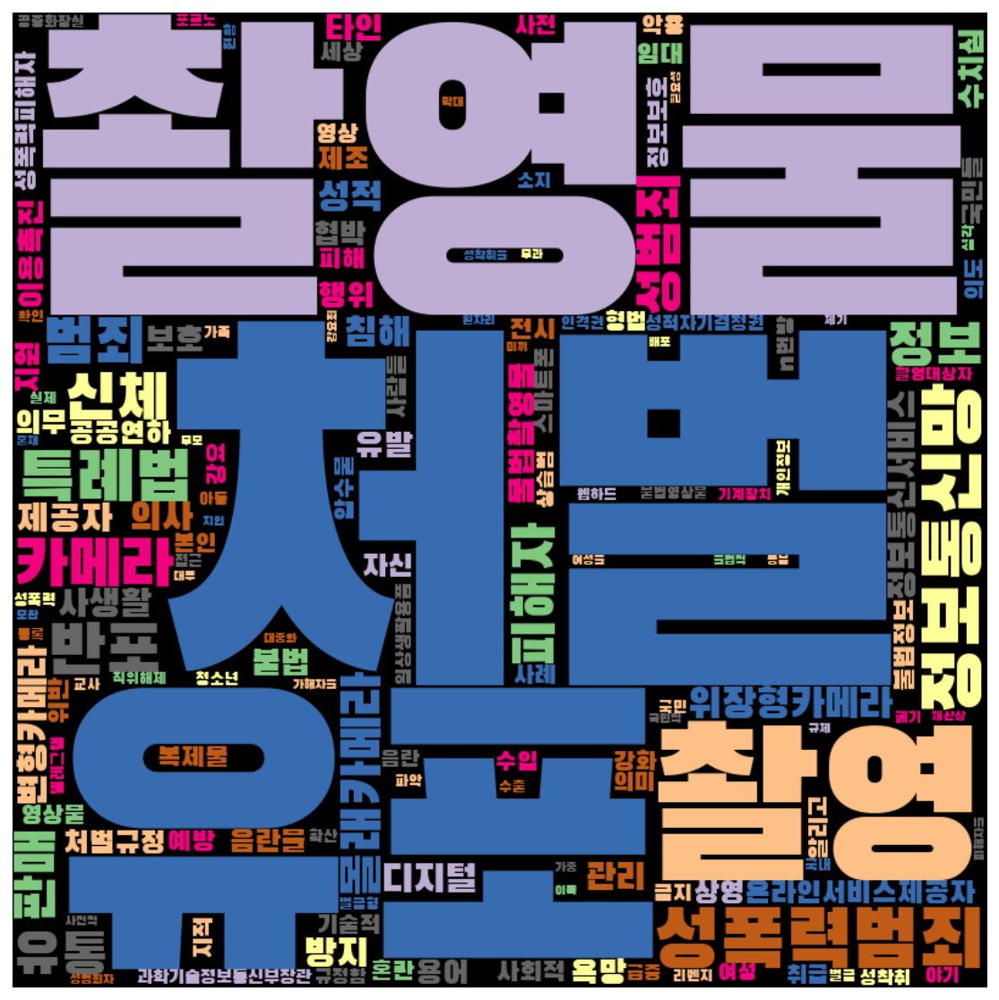

In [235]:
frewords_vis(women_g3_tokens)
wordcloud_vis(women_g3_tokens,'Accent')

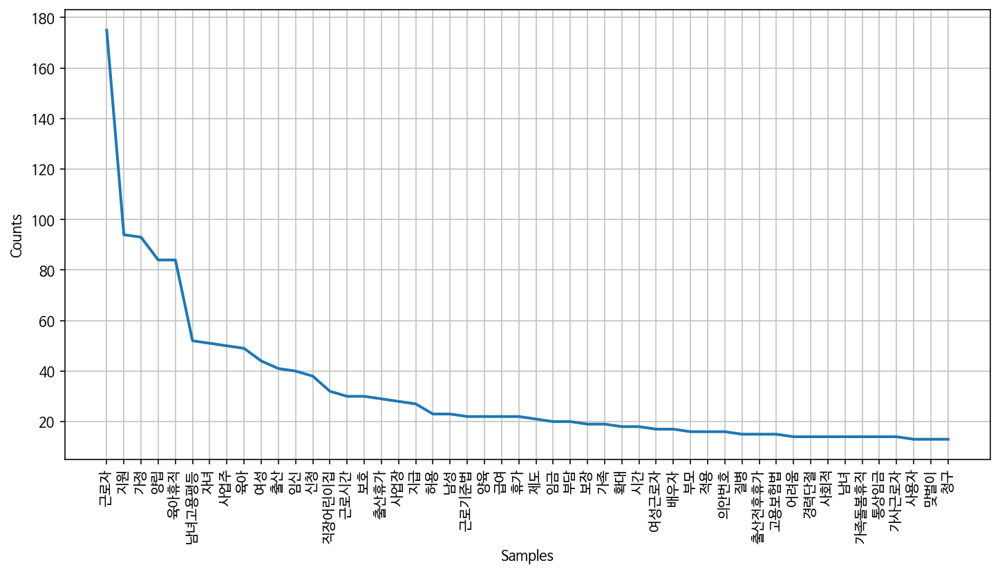

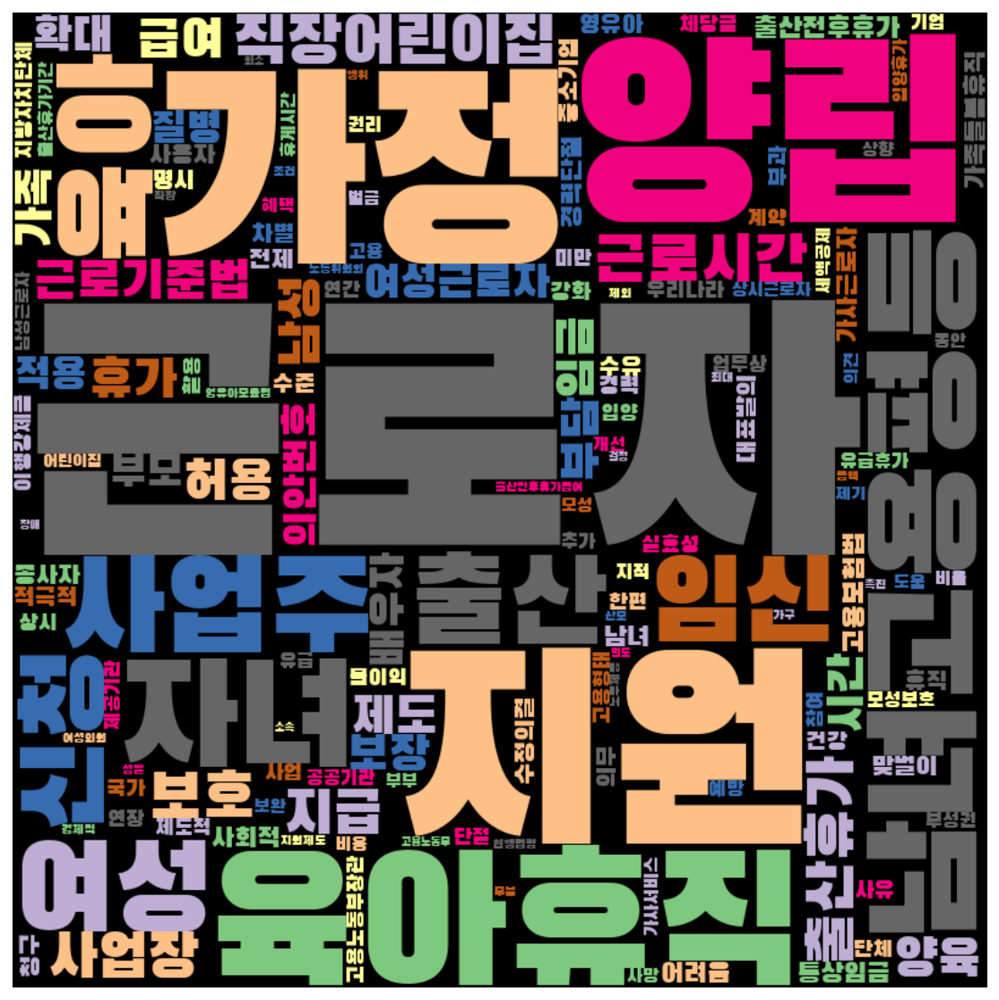

In [236]:
frewords_vis(women_g4_tokens)
wordcloud_vis(women_g4_tokens,'Accent')

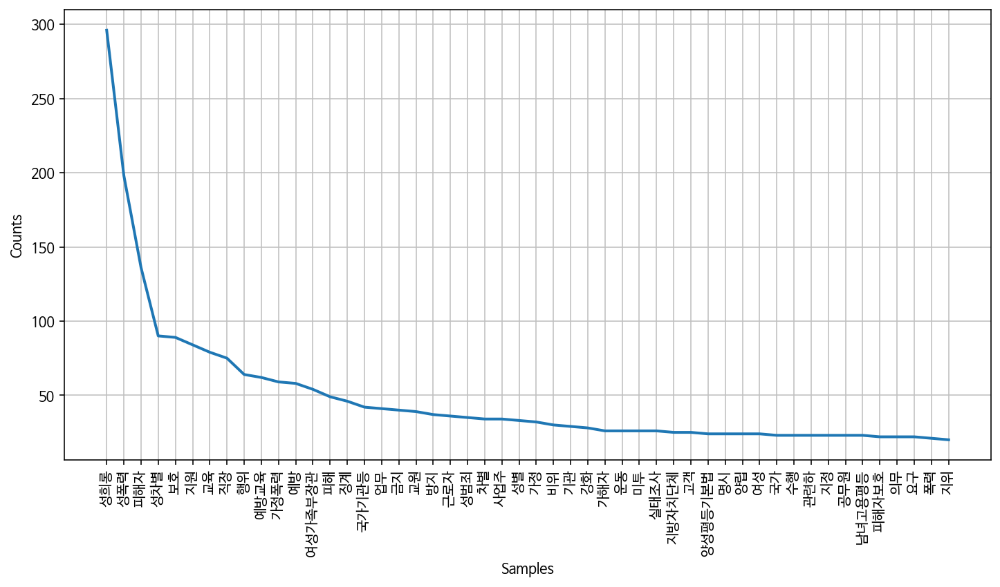

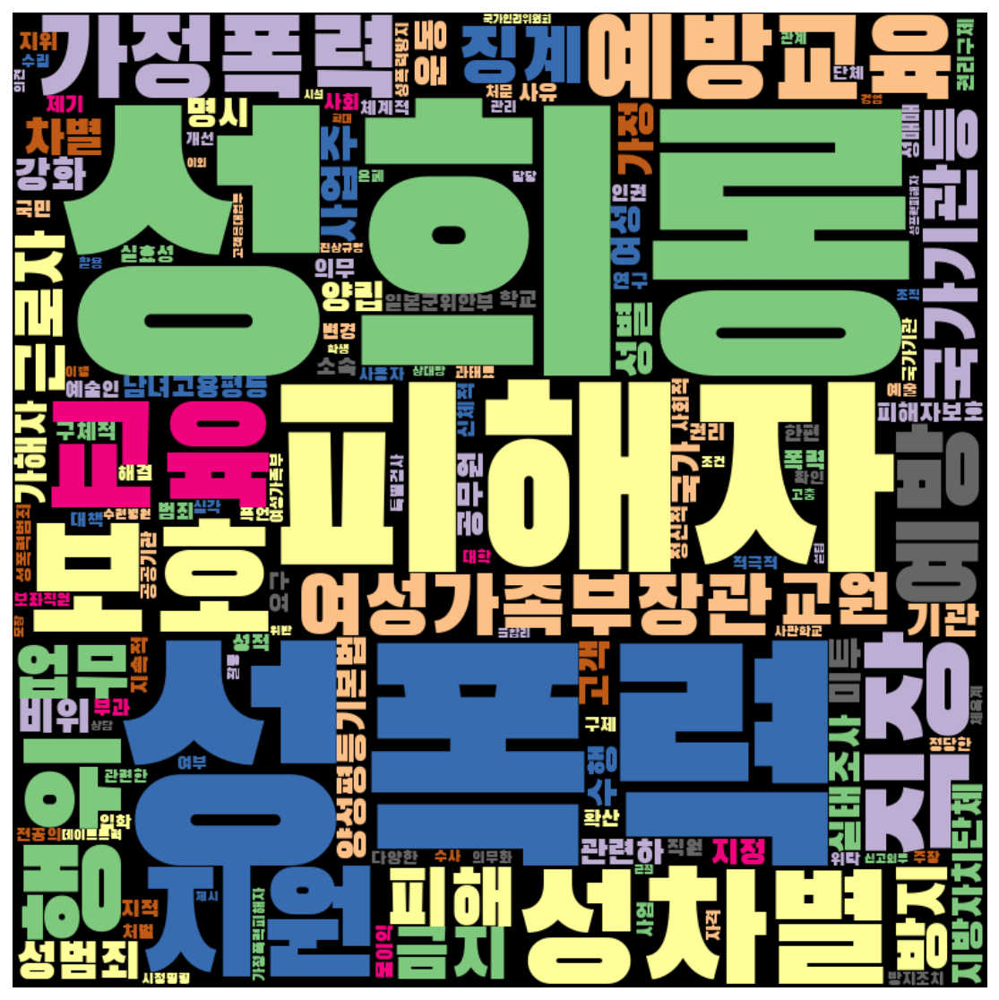

In [237]:
frewords_vis(women_g5_tokens)
wordcloud_vis(women_g5_tokens,'Accent')

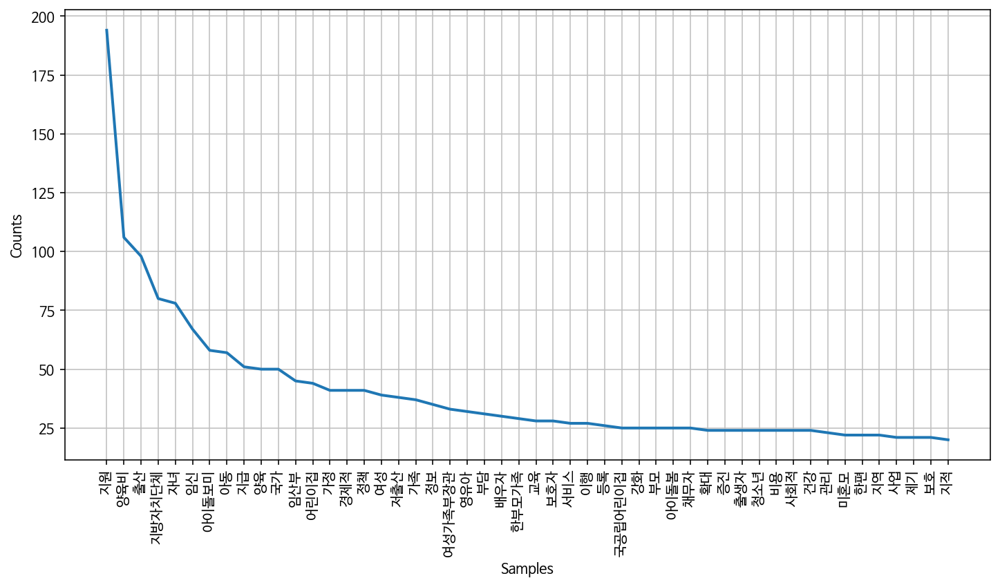

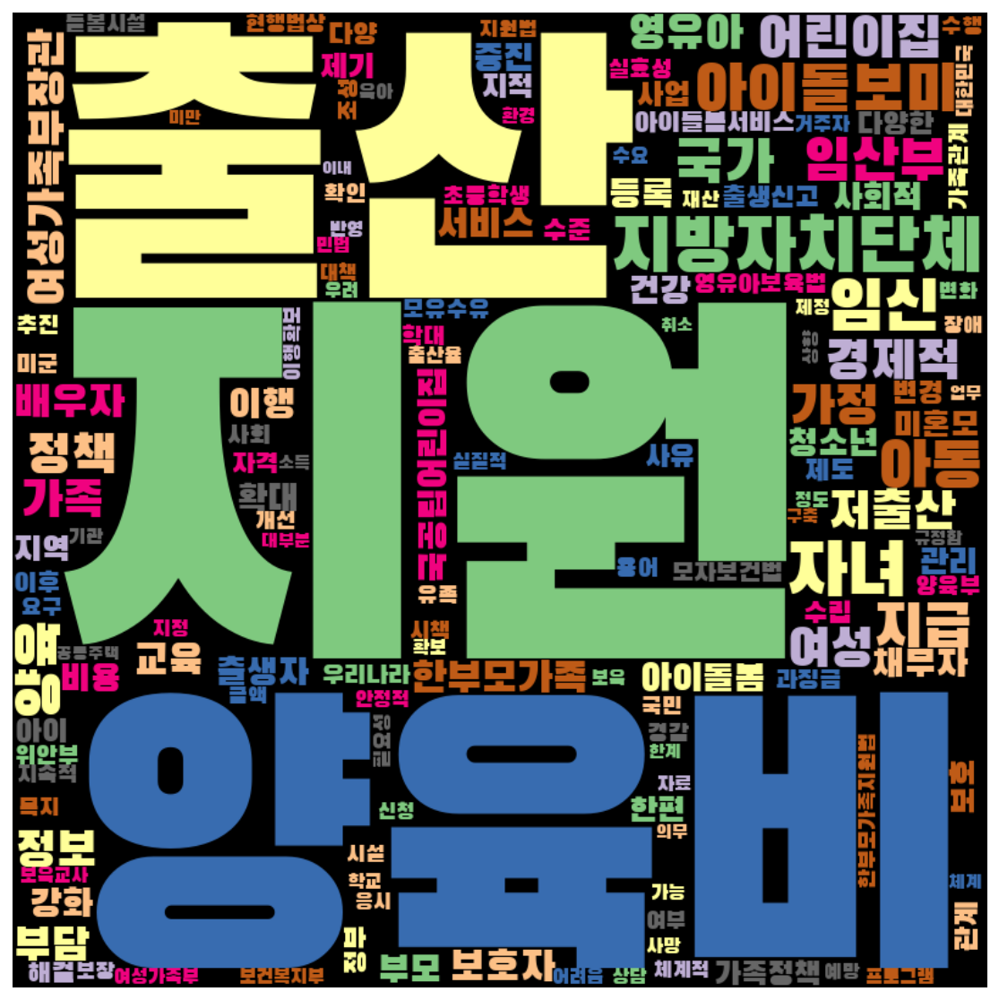

In [238]:
frewords_vis(women_g6_tokens)
wordcloud_vis(women_g6_tokens,'Accent')

In [239]:
# K means 수행 
word_vectors_men = men['문장벡터'].to_list()
num_clusters = 6

kmeans_clustering = KMeans(n_clusters = num_clusters)
idx = kmeans_clustering.fit_predict(word_vectors_men)
men['category'] = idx

<ipython-input-239-ea17c2f5c726>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  men['category'] = idx


In [240]:
men['category'].value_counts()

2    246
5    163
0    150
1     79
3     77
4     45
Name: category, dtype: int64

In [241]:
men_g1 = men[men['category'] == 0]
men_g2 = men[men['category'] == 1]
men_g3 = men[men['category'] == 2]
men_g4 = men[men['category'] == 3]
men_g5 = men[men['category'] == 4]
men_g6 = men[men['category'] == 5]

In [242]:
men_g1_tokens = total_tokens(men_g1['tokens'])
men_g2_tokens = total_tokens(men_g2['tokens'])
men_g3_tokens = total_tokens(men_g3['tokens'])
men_g4_tokens = total_tokens(men_g4['tokens'])
men_g5_tokens = total_tokens(men_g5['tokens'])
men_g6_tokens = total_tokens(men_g6['tokens'])

In [243]:
stopwords = ['조치','법률','일부개정법률안','현행법','이하','규정하','해당','사실','실시','조제','조의','발생','필요','포함','실정','상황',
            '이용','사람','사건','사항','운영','이상','선고','회국회','만원','삭제','상정','조정함','정기회','설치','규정','안제',
            '일방','법제사법위원회','정부안','임시회','촌이내','개정','구성','기타','의결','현행','본회','시행','조사','위원회','천만원',
            '의결제','조정','인정','국회','억원','부칙','본회의','제안','도지사','대통령령','감사','내용','제한','요청','통신','목적','발의',
            '가액','기준','승인','우리','결과','법률안','협의','제출','신설',
            '신설','대상','문제','제공','항제','사용','근거','불구','범위','이유','증가']
men_g1_tokens = [each_word for each_word in men_g1_tokens if each_word not in stopwords]
men_g2_tokens = [each_word for each_word in men_g2_tokens if each_word not in stopwords]
men_g3_tokens = [each_word for each_word in men_g3_tokens if each_word not in stopwords]
men_g4_tokens = [each_word for each_word in men_g4_tokens if each_word not in stopwords]
men_g5_tokens = [each_word for each_word in men_g5_tokens if each_word not in stopwords]
men_g6_tokens = [each_word for each_word in men_g6_tokens if each_word not in stopwords]

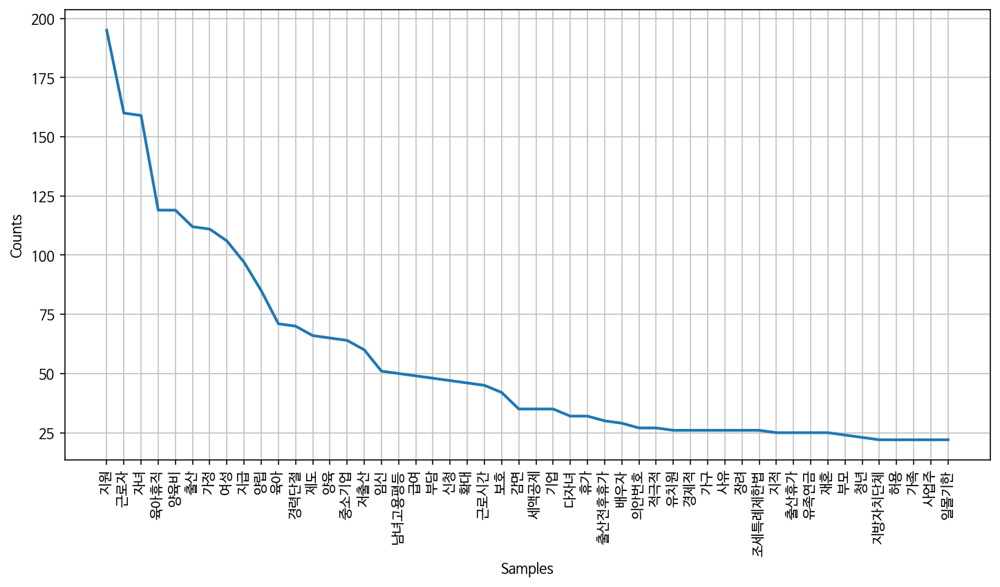

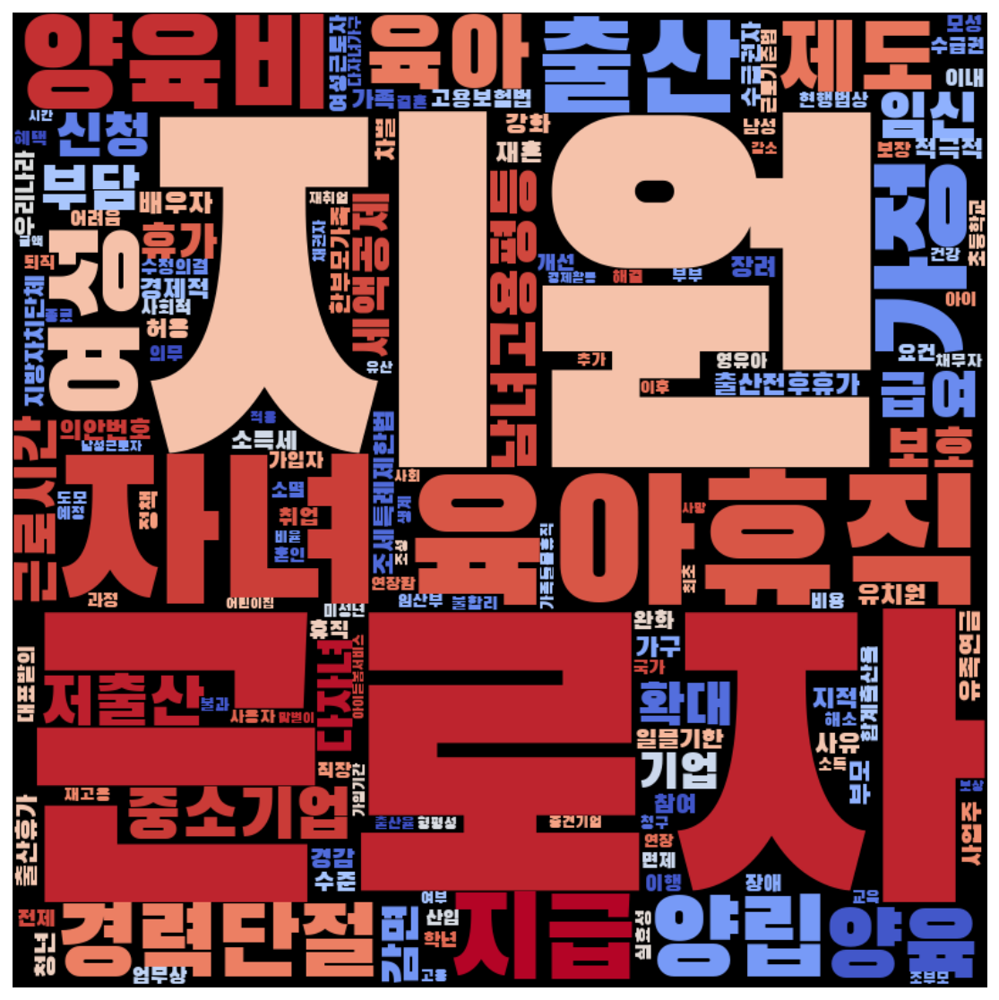

In [244]:
frewords_vis(men_g1_tokens)
wordcloud_vis(men_g1_tokens,'coolwarm')

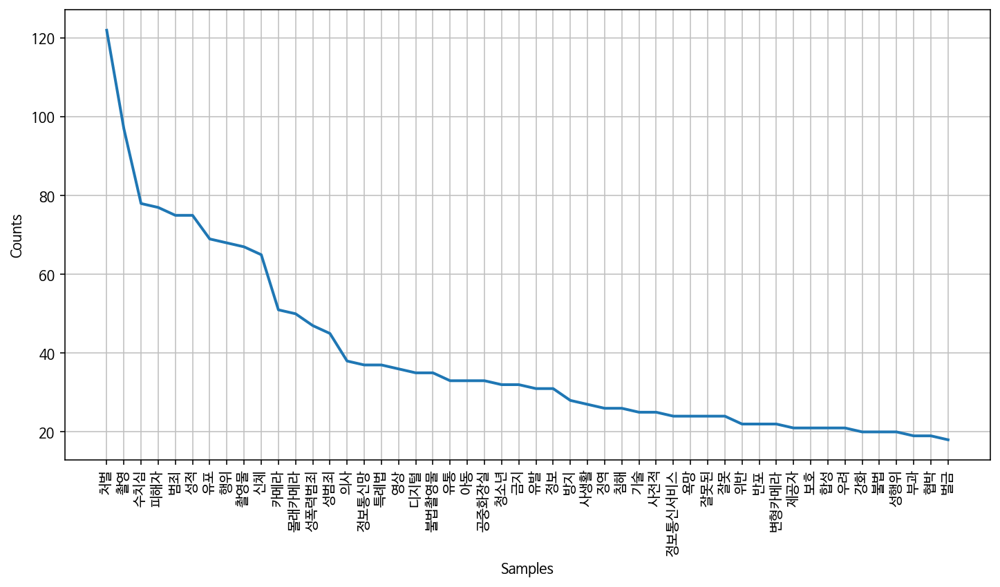

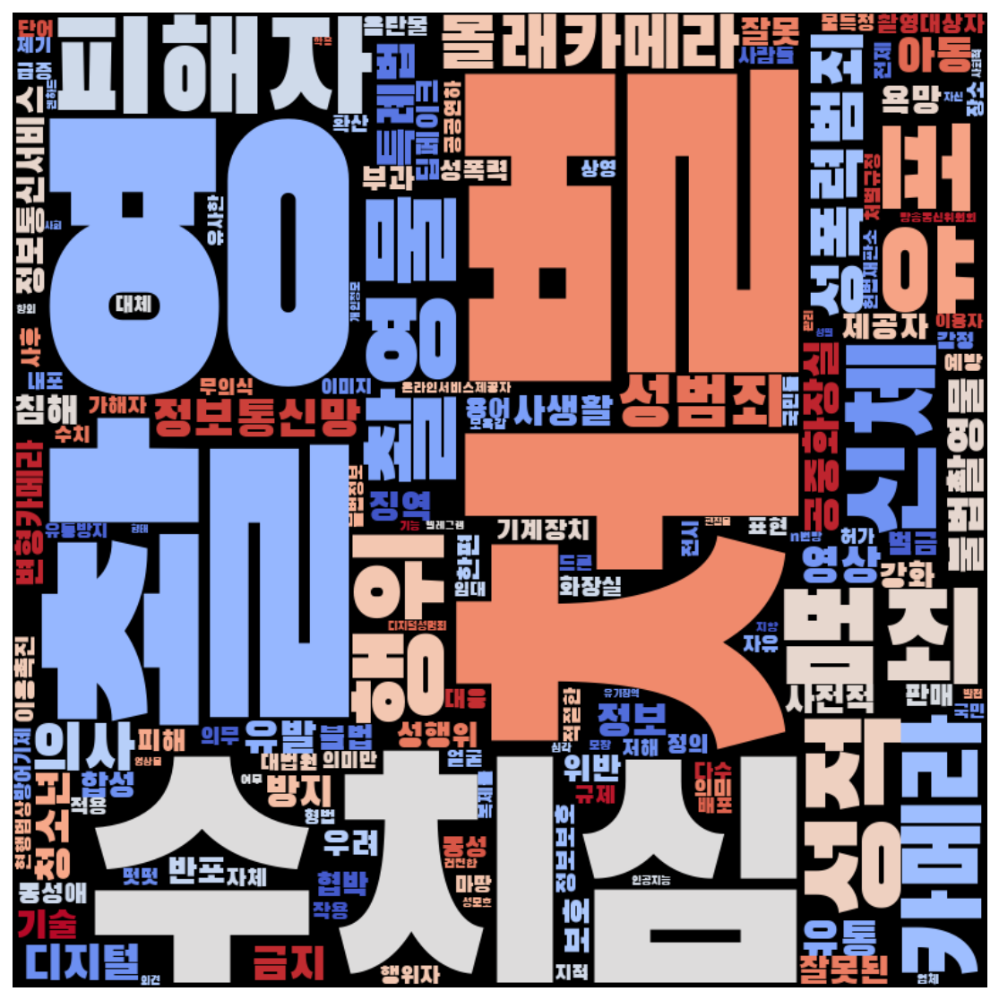

In [245]:
frewords_vis(men_g2_tokens)
wordcloud_vis(men_g2_tokens,'coolwarm')

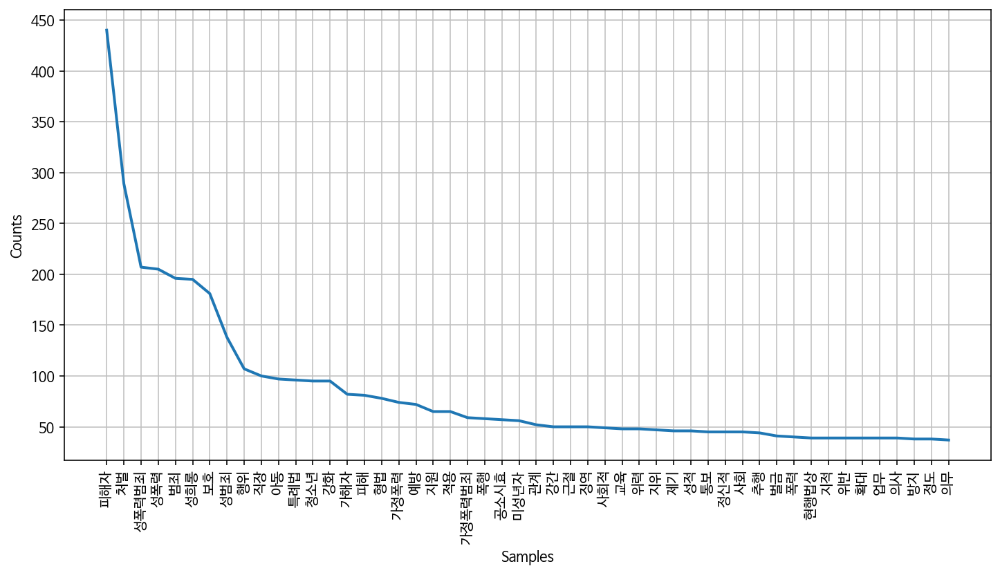

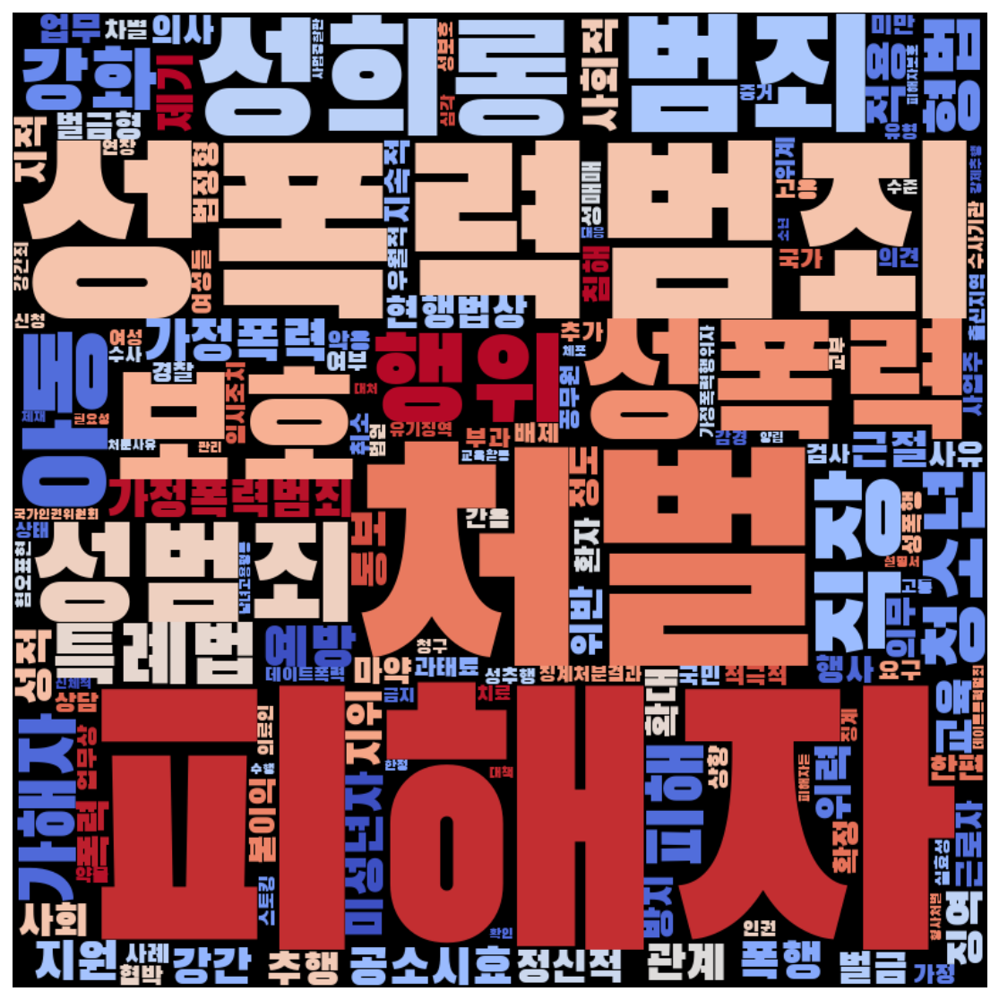

In [246]:
frewords_vis(men_g3_tokens)
wordcloud_vis(men_g3_tokens,'coolwarm')

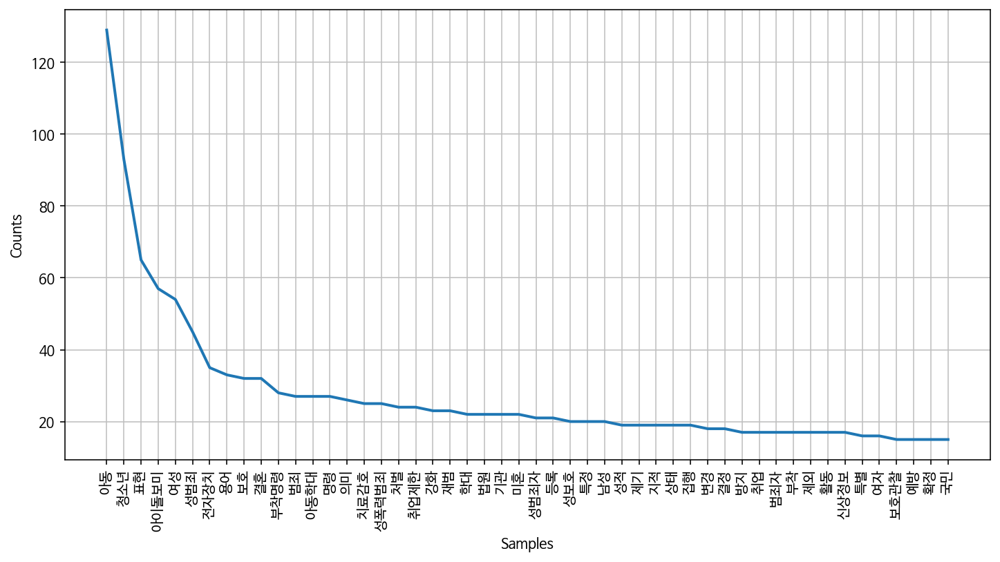

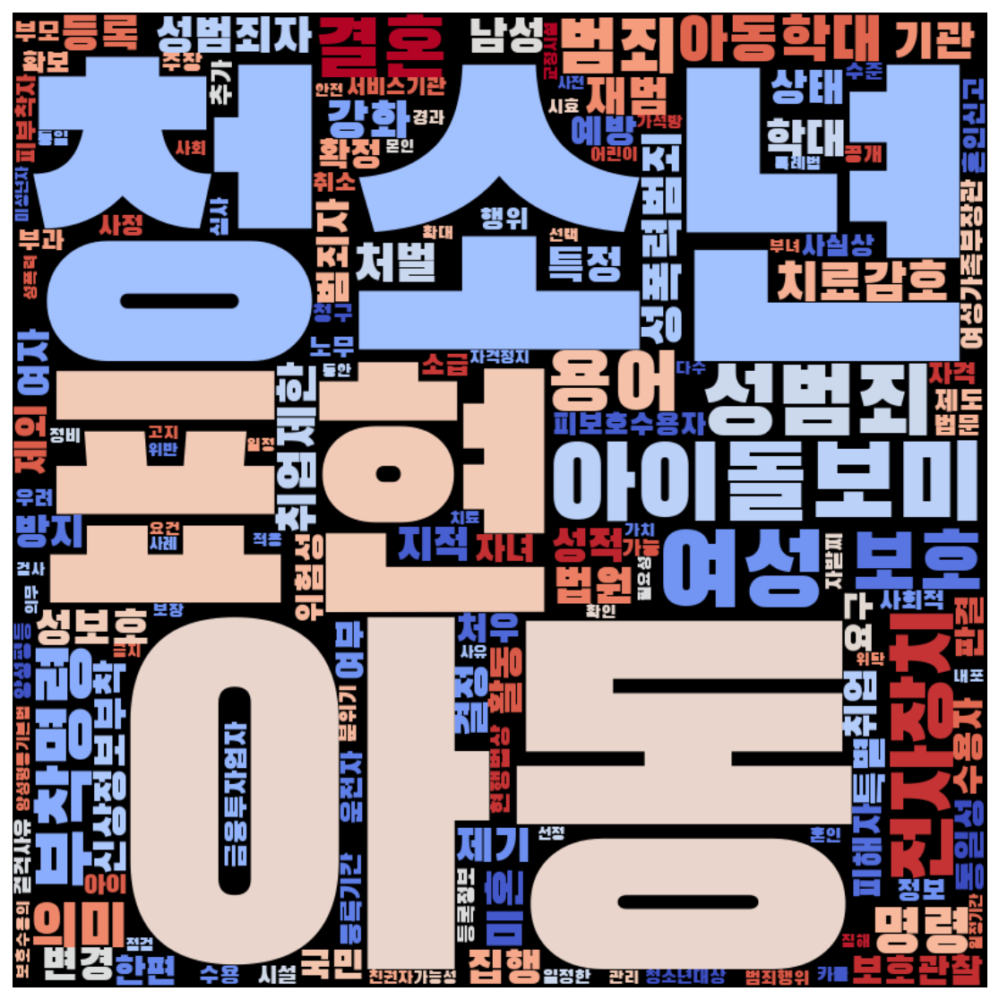

In [247]:
frewords_vis(men_g4_tokens)
wordcloud_vis(men_g4_tokens,'coolwarm')

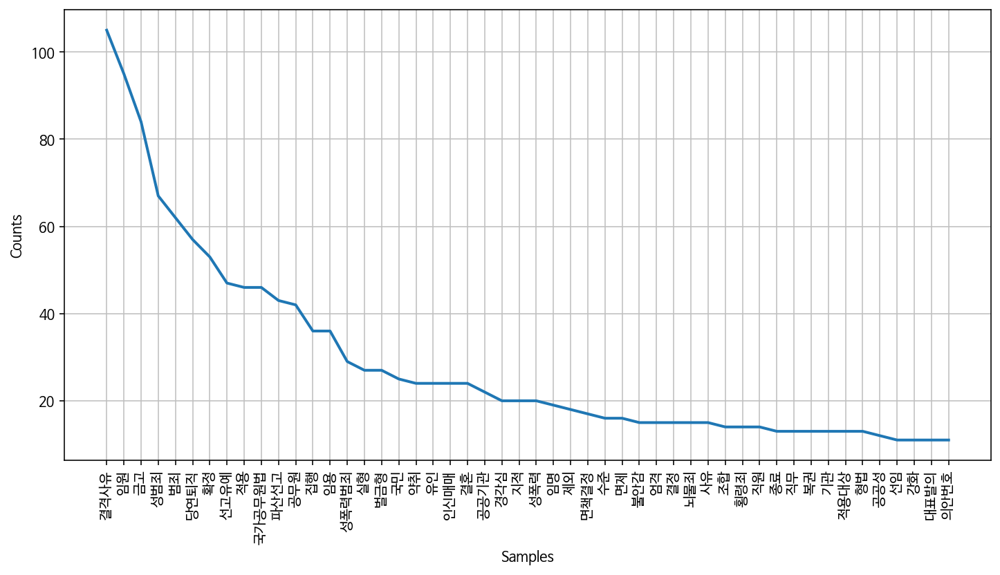

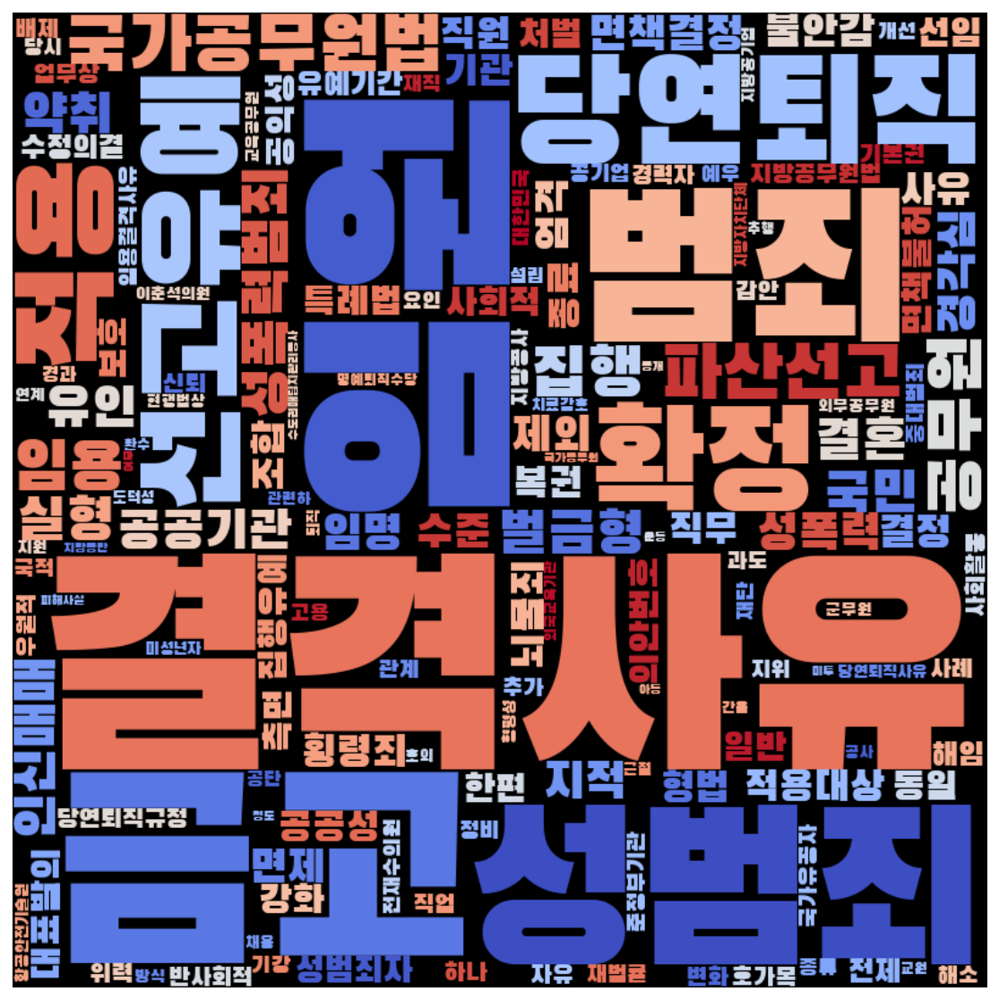

In [248]:
frewords_vis(men_g5_tokens)
wordcloud_vis(men_g5_tokens,'coolwarm')

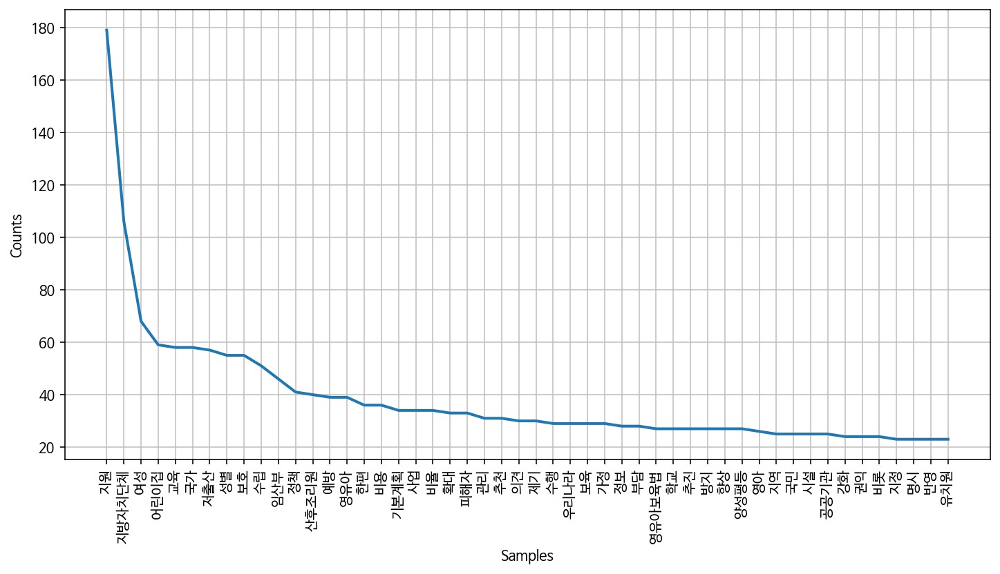

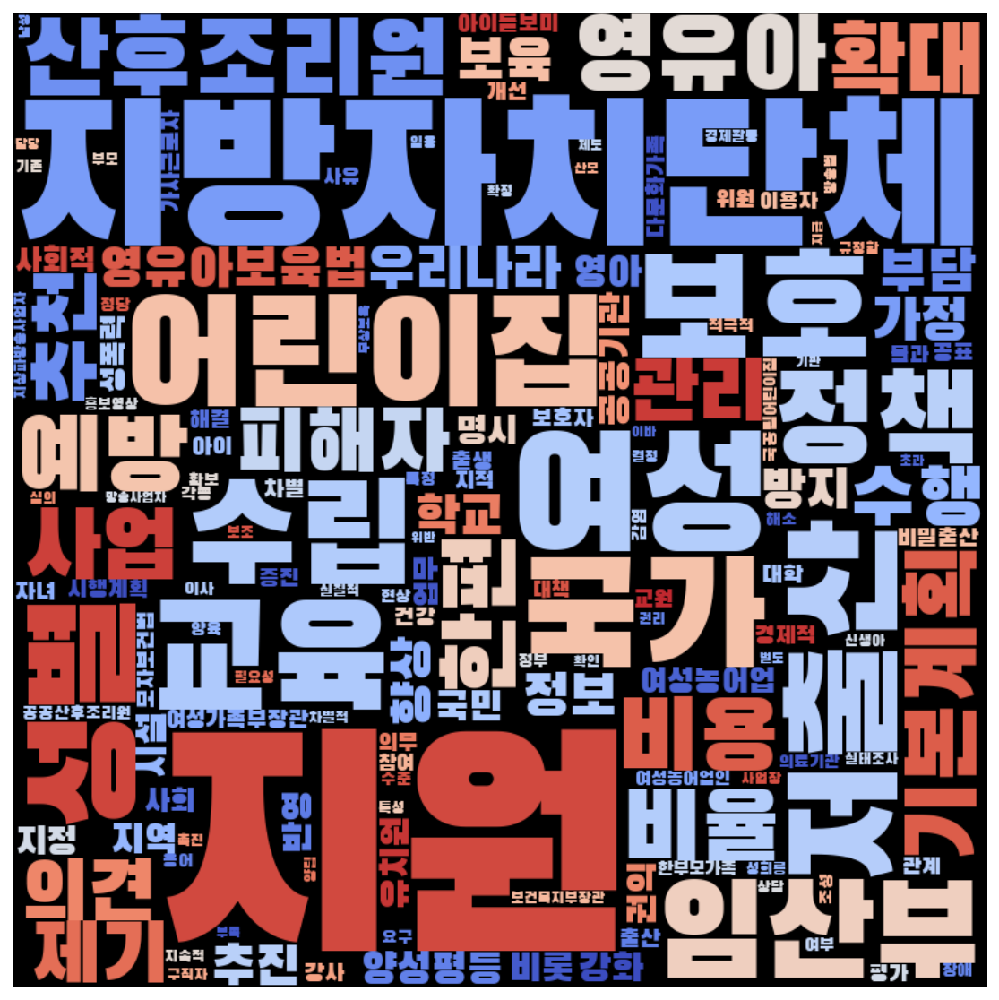

In [249]:
frewords_vis(men_g6_tokens)
wordcloud_vis(men_g6_tokens,'coolwarm')